In [5]:
# full basics with sentiment (2.0) - name = df_basic_sent
#conversations with airline all - name conv_air
#id airline all - name = id_airline
#conversations list below - name = conversations
%run import_file.ipynb

Python version is 3.7.3 (default, Mar 27 2019, 17:13:21) [MSC v.1915 64 bit (AMD64)]
Pandas version is 1.0.3
C:/Users/20193635/Documents/GitHub/DataChallenge/conversations_per_airline_all.csv
Unnamed: 0           int64
0                   object
list                object
KLM                  int64
AirFrance            int64
British Airways      int64
American Air         int64
Lufthansa            int64
AirBerlin            int64
AirBerlin_assist     int64
easyJet              int64
RyanAir              int64
SingaporeAir         int64
Qantas               int64
EtihadAirways        int64
VirginAtlantic       int64
dtype: object
Please specify your DataFrame name: conv_air
_id not found
Dtypes after transformation:
 Unnamed: 0           int64
0                   object
list                object
KLM                  int64
AirFrance            int64
British Airways      int64
American Air         int64
Lufthansa            int64
AirBerlin            int64
AirBerlin_assist     int64
eas

In [2]:
id_airline.head(2)

,Unnamed: 0,id_str,KLM,AirFrance,British Airways,American Air,Lufthansa,AirBerlin,AirBerlin_assist,easyJet,RyanAir,SingaporeAir,Qantas,EtihadAirways,VirginAtlantic
0,0,1131172858951024640,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1131172864147808256,0,0,0,0,0,0,0,0,0,0,0,0,0


In [4]:
df_basic_sent.head(2)

,created_at,id,id_str,sentiment,text,user.id_str,lang,timestamp_ms
0,Wed May 22 12:20:00 +0000 2019,1.13117e+18,1131172858951024640,0,La ruta de easyJet entre Londres y Menorca tra...,393374091,es,2019-05-22 12:20:00.406
1,Wed May 22 12:20:01 +0000 2019,1.13117e+18,1131172864147808384,1,RT @bttr_as1: @goody_tracy Here’s a list of so...,3420691215,en,2019-05-22 12:20:01.645


In [6]:
conv_air.head(2)

,Unnamed: 0,0,list,KLM,AirFrance,British Airways,American Air,Lufthansa,AirBerlin,AirBerlin_assist,easyJet,RyanAir,SingaporeAir,Qantas,EtihadAirways,VirginAtlantic
0,0,"[1131173010508062720, 1131175995321520128, [11...","['1131173010508062720', ' 1131175995321520128'...",0,0,1,0,0,0,0,0,0,0,0,0,0
1,1,"[1131173313982734336, 1131176158647717888, [11...","['1131173313982734336', ' 1131176158647717888'...",0,0,0,1,0,0,0,0,0,0,0,0,0


## conversations

In [40]:
conversations = pd.read_csv('conversations_list.txt', sep="\n", header=None)

In [41]:
def strip(string):
    string = string.replace('[', '')
    string = string.replace(']', '')
    return string.split(',')

In [42]:
conversations['list'] = conversations[0].apply(strip)
conv_air['list'] = conversations[0].apply(strip)

## make dictionary

In [10]:
dict_sent = dict(zip(df_basic_sent.id_str, df_basic_sent.sentiment))

# make dictionairies of airways
klm_tweet = id_airline[id_airline['KLM'] == 1]
dict_klm = dict(zip(klm_tweet.id_str, klm_tweet.KLM))
BA_tweet = id_airline[id_airline['British Airways'] == 1]
dict_BA = dict(zip(BA_tweet.id_str, BA_tweet['British Airways']))
AA_tweet = id_airline[id_airline['American Air'] == 1]
dict_AA = dict(zip(AA_tweet.id_str, AA_tweet['American Air']))
Lu_tweet = id_airline[id_airline['Lufthansa'] == 1]
dict_Lu = dict(zip(Lu_tweet.id_str, Lu_tweet.Lufthansa))
RA_tweet = id_airline[id_airline['RyanAir'] == 1]
dict_RA = dict(zip(RA_tweet.id_str, RA_tweet.RyanAir))

AirFrance_tweets = dict(zip(id_airline[id_airline['AirFrance'] == 1]['id_str'],id_airline[id_airline['AirFrance'] == 1]['id_str']))
AirBerlin_tweets = dict(zip(id_airline[id_airline['AirBerlin'] == 1]['id_str'],id_airline[id_airline['AirBerlin'] == 1]['id_str']))
AirBerlin_assist_tweets = dict(zip(id_airline[id_airline['AirBerlin_assist'] == 1]['id_str'],id_airline[id_airline['AirBerlin_assist'] == 1]['id_str']))
easyJet_tweets = dict(zip(id_airline[id_airline['easyJet'] == 1]['id_str'],id_airline[id_airline['easyJet'] == 1]['id_str']))

SingaporeAir_tweets = dict(zip(id_airline[id_airline['SingaporeAir'] == 1]['id_str'],id_airline[id_airline['SingaporeAir'] == 1]['id_str']))
Qantas_tweets = dict(zip(id_airline[id_airline['Qantas'] == 1]['id_str'],id_airline[id_airline['Qantas'] == 1]['id_str']))
EtihadAirways_tweets = dict(zip(id_airline[id_airline['EtihadAirways'] == 1]['id_str'],id_airline[id_airline['EtihadAirways'] == 1]['id_str']))
VirginAtlantic_tweets = dict(zip(id_airline[id_airline['VirginAtlantic'] == 1]['id_str'],id_airline[id_airline['VirginAtlantic'] == 1]['id_str']))



# Conversation
# function

In [11]:
# first reply of airline is in end sentiment
def airline(self):
    """Try to get sentiment in conversation"""
    res = []
    begin = []
    end = []
    e = 0 # nr of errors
    split = 0 # the split has been made
    change = 0 # the split should be here
    loop = 0
    for element in self['list']:

        if split == 0:
            loop = 0
            while loop == 0:
                try:
                    res.append(dict_klm[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(dict_BA[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                    
                try:
                    res.append(dict_AA[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(dict_Lu[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(dict_RA[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(AirFrance_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(AirBerlin_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(AirBerlin_assist_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(easyJet_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(SingaporeAir_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(Qantas_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1 
                try:
                    res.append(EtihadAirways_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(dict[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1
                try:
                    res.append(VirginAtlantic_tweets[float(element)])
                    print('yes. end is starting', element)
                    change = 1
                except:
                    e +=1                    
                    
                loop = 1
                    
      
        if change == 1 and split == 0:
            split = 1 ### change of split
            change = 0

        if split == 0: #change == 0 and split == 0:
            try:
                begin.append(dict_sent[float(element)])
            except:
                e += 1
        
        if split == 1: ### only if split not changed, otherwise already appended
            try:
                end.append(dict_sent[float(element)])
            except:
                print('error, not appended', element) 
        
    return [begin, end]

In [14]:
%%time
result = pd.DataFrame()
result[['begin', 'end']] = conversations.apply(airline, axis = 1, result_type= 'expand')

yes. end is starting 1131173010508062720
error, not appended 1131173010508062720
error, not appended  1131175995321520128
yes. end is starting 1131173313982734336
error, not appended  1131176158647717888
yes. end is starting 1131173345918148608
yes. end is starting 1131174768114323456
error, not appended 1131174768114323456
yes. end is starting 1131174885865205760
yes. end is starting 1131175229424852992
error, not appended  1131181072409083904
yes. end is starting 1131176007510110208
error, not appended  1131179876269084672
yes. end is starting  1131176383835721728
error, not appended  1131176383835721728
error, not appended  1131176413183262720
error, not appended  1131181992400379904
yes. end is starting 1131176200020217856
error, not appended 1131176200020217856
error, not appended  1131186272184221696
error, not appended  1131886960471973888
yes. end is starting 1131176457059938304
error, not appended 1131176457059938304
error, not appended  1131315480705327104
yes. end is startin

yes. end is starting  1131262308225757184
yes. end is starting 1131262027928936448
yes. end is starting 1131262073823027200
error, not appended  1131262796895858688
yes. end is starting 1131262287946375168
error, not appended  1131262683502784512
yes. end is starting 1131262380816490496
error, not appended 1131262380816490496
yes. end is starting 1131262816902623232
yes. end is starting 1131263061170499584
error, not appended  1131387550839529472
yes. end is starting  1131556605017903104
error, not appended  1131556605017903104
yes. end is starting 1131263609152200704
error, not appended 1131263609152200704
error, not appended  1131284059362070528
yes. end is starting 1131263609202458624
error, not appended  1131318078665629696
error, not appended  1131318346790703104
yes. end is starting 1131263689602920448
yes. end is starting 1131263784763310080
error, not appended 1131263784763310080
error, not appended  1131289948726943744
error, not appended  1131293558999343104
error, not append

error, not appended  1131355908632698880
error, not appended  1131367647189192704
error, not appended  1131368831459348480
error, not appended  1131373543491399680
error, not appended  1131364920736403456
yes. end is starting 1131342123868053504
error, not appended 1131342123868053504
error, not appended  1131621468855513088
error, not appended  1131621646702469120
yes. end is starting 1131342383377989632
error, not appended  1131373166872469504
yes. end is starting 1131342889760559104
error, not appended 1131342889760559104
error, not appended  1131343941159276544
error, not appended  1131345516762193920
yes. end is starting 1131342904176381952
yes. end is starting 1131342963555020800
error, not appended  1131349339354406912
yes. end is starting 1131343011734908928
error, not appended 1131343011734908928
yes. end is starting 1131343999032336384
error, not appended  1131402761554284544
yes. end is starting 1131344516714254336
error, not appended  1131354121968201728
error, not appended

yes. end is starting 1131472330776092672
error, not appended 1131472330776092672
error, not appended  1131486458131435520
error, not appended  1131488703560470528
yes. end is starting 1131472603867164672
error, not appended 1131472603867164672
error, not appended  1131813903023968256
yes. end is starting 1131472970117918720
error, not appended 1131472970117918720
error, not appended  1133280796582662144
yes. end is starting  1131526294405992448
yes. end is starting 1131473613285052416
error, not appended  1131899281474957312
error, not appended  1131474617007202304
error, not appended  1131490375443537920
error, not appended  1131582819732295680
yes. end is starting 1131473613687861248
error, not appended  1131475880721702912
yes. end is starting 1131473643899379712
error, not appended 1131473643899379712
error, not appended  1133347686076301312
yes. end is starting 1131474050184884224
yes. end is starting 1131474875623907328
error, not appended 1131474875623907328
error, not appended 

error, not appended  1131569439562960896
yes. end is starting 1131540929091973120
error, not appended 1131540929091973120
error, not appended  1131552763257733120
error, not appended  1131566024543920128
yes. end is starting 1131540993826840576
yes. end is starting 1131541109937541120
error, not appended 1131541109937541120
error, not appended  1131542927333908480
yes. end is starting 1131541676563083264
error, not appended  1131573671749935104
error, not appended  1131587095099789312
yes. end is starting 1131541709777756160
yes. end is starting 1131541855936454656
error, not appended 1131541855936454656
error, not appended  1131545755657707520
yes. end is starting 1131541969187086336
error, not appended  1131544909222223872
error, not appended  1131553900253896704
error, not appended  1131559542087659520
yes. end is starting 1131542490320973824
yes. end is starting 1131542707250323456
error, not appended 1131542707250323456
yes. end is starting 1131543171735924736
error, not appended 

error, not appended  1131822592556523520
yes. end is starting 1131628121663213568
error, not appended  1132069660684275712
error, not appended  1132069124748693504
yes. end is starting 1131628689115033600
error, not appended  1131785967055134720
yes. end is starting 1131629008842571776
error, not appended  1131783541979865088
yes. end is starting 1131629123196116992
yes. end is starting 1131629183296258048
error, not appended  1131655865663184896
yes. end is starting 1131629513543053312
error, not appended 1131629513543053312
error, not appended  1131629705751404544
error, not appended  1131650261422870528
error, not appended  1131649729186607104
yes. end is starting 1131629692547674112
error, not appended 1131629692547674112
error, not appended  1131637085469855744
yes. end is starting 1131629901772218368
yes. end is starting 1131630288667402240
error, not appended  1131643360240967680
yes. end is starting 1131630417826725888
error, not appended 1131630417826725888
yes. end is startin

error, not appended  1131759496269828096
yes. end is starting 1131757347964039168
error, not appended  1131768880517517312
error, not appended  1131802338451120128
error, not appended  1132111794011422720
error, not appended  1131829014077820928
yes. end is starting  1131759626242781184
yes. end is starting 1131759364564324352
error, not appended  1131766431262150656
yes. end is starting 1131759395296153600
yes. end is starting 1131760234865709056
yes. end is starting 1131760880415399936
error, not appended  1131762837603475456
yes. end is starting 1131761145000280064
error, not appended  1131821013723824128
yes. end is starting 1131761336113926144
error, not appended 1131761336113926144
error, not appended  1131789849080606720
error, not appended  1131886304151650304
yes. end is starting 1131761342875090944
yes. end is starting 1131762146864455680
error, not appended 1131762146864455680
error, not appended  1131772189538246656
yes. end is starting 1131763318031638528
error, not append

error, not appended 1131897842283491328
error, not appended  1131900064945848320
error, not appended  1131990027007942656
error, not appended  1132034892689285120
error, not appended  1132191445165793280
error, not appended  1132208169382490112
error, not appended  1132228219921420288
error, not appended  1132256872533254144
error, not appended  1132267837844860928
yes. end is starting 1131899093729435648
error, not appended  1131921377856909312
yes. end is starting 1131899120526995456
error, not appended 1131899120526995456
yes. end is starting 1131899505215979520
error, not appended 1131899505215979520
error, not appended  1131983469352034304
yes. end is starting 1131899913363697664
error, not appended  1131900127310954496
yes. end is starting  1131902059492438016
yes. end is starting 1131900650680401920
error, not appended 1131900650680401920
error, not appended  1131983349151686656
yes. end is starting 1131900820184870912
error, not appended 1131900820184870912
error, not appended 

yes. end is starting  1132193940084527104
error, not appended  1132193940084527104
error, not appended  1132204530320465920
yes. end is starting 1131981650198319104
error, not appended 1131981650198319104
yes. end is starting  1132248422554243072
error, not appended  1132248422554243072
error, not appended  1132262160569184256
yes. end is starting 1131982319366168576
error, not appended  1133799631110983680
yes. end is starting 1131982405991112704
error, not appended 1131982405991112704
yes. end is starting 1131982417240236032
error, not appended  1132718184564502528
yes. end is starting 1131983469956009984
error, not appended  1131994585876578304
yes. end is starting 1131983555595317248
error, not appended  1132015280102805504
yes. end is starting 1131983589275557888
error, not appended 1131983589275557888
error, not appended  1131991458393800704
yes. end is starting 1131983872235888640
yes. end is starting 1131984550811328512
error, not appended 1131984550811328512
error, not appende

error, not appended 1132109200354553856
yes. end is starting 1132109264103845888
error, not appended 1132109264103845888
error, not appended  1132173888576720896
yes. end is starting 1132109444001738752
yes. end is starting 1132110268719403008
error, not appended  1132164112417480704
yes. end is starting 1132110401322266624
error, not appended  1132111153964957696
error, not appended  1132113947916685312
error, not appended  1132115651747897344
yes. end is starting 1132110404426108928
error, not appended 1132110404426108928
yes. end is starting 1132111493460316160
yes. end is starting 1132113277033603072
error, not appended 1132113277033603072
error, not appended  1132126698407907328
error, not appended  1132137350849548288
error, not appended  1132185492492103680
yes. end is starting 1132113303923298304
error, not appended 1132113303923298304
error, not appended  1132415161942368256
error, not appended  1132415615363366912
yes. end is starting 1132113749865881600
error, not appended  

yes. end is starting 1132271160303980544
error, not appended 1132271160303980544
yes. end is starting 1132271191031459840
yes. end is starting 1132271336036941824
error, not appended  1132271533483855872
yes. end is starting 1132271415879753728
error, not appended 1132271415879753728
error, not appended  1132271726946070528
yes. end is starting 1132271450860216320
error, not appended 1132271450860216320
error, not appended  1132334740206432256
yes. end is starting 1132271474037936128
error, not appended 1132271474037936128
yes. end is starting 1132271590857682944
yes. end is starting 1132272123186163712
error, not appended 1132272123186163712
error, not appended  1132274384519999488
yes. end is starting 1132272839753654272
error, not appended 1132272839753654272
error, not appended  1132273186383568896
yes. end is starting 1132273302758674432
yes. end is starting 1132273346110996480
error, not appended 1132273346110996480
error, not appended  1132276953346650112
yes. end is starting 11

yes. end is starting 1132396084511297536
error, not appended  1132907671781355520
yes. end is starting 1132396191206002688
error, not appended 1132396191206002688
error, not appended  1132396401256751104
yes. end is starting 1132397034168885248
yes. end is starting 1132397748840534016
yes. end is starting 1132398198264356864
error, not appended  1132573132567580672
error, not appended  1132604342874398720
error, not appended  1132710144578641920
error, not appended  1132609612631478272
yes. end is starting 1132398360319676416
error, not appended  1132401180079022080
yes. end is starting 1132398893734518784
error, not appended  1132400425330761728
yes. end is starting 1132399110827458560
error, not appended  1132401936903430144
yes. end is starting 1132399411001253888
error, not appended 1132399411001253888
yes. end is starting  1132949205931180032
error, not appended  1132434494634508288
yes. end is starting 1132400003060838400
yes. end is starting  1132404818960502784
error, not appen

yes. end is starting  1132593868371841024
error, not appended  1132611044084473856
error, not appended  1132634289898688512
error, not appended  1132634784855941120
error, not appended  1132650086377373696
yes. end is starting 1132583095234912256
error, not appended 1132583095234912256
error, not appended  1132643611198279680
yes. end is starting 1132583201606635520
error, not appended 1132583201606635520
yes. end is starting 1132584055151714304
error, not appended 1132584055151714304
error, not appended  1132589076291493888
error, not appended  1133394726516928512
error, not appended  1133758472825331712
error, not appended  1132613296782229504
error, not appended  1132617264979742720
yes. end is starting 1132584538356498432
error, not appended  1132733363272470528
error, not appended  1132740966895542272
yes. end is starting 1132584672029024256
error, not appended 1132584672029024256
yes. end is starting 1132585271218847744
error, not appended 1132585271218847744
error, not appended 

yes. end is starting 1132720554899890176
error, not appended  1132724145668665344
yes. end is starting 1132720997679996928
error, not appended 1132720997679996928
error, not appended  1132750209447026688
error, not appended  1132732220903481344
yes. end is starting 1132721573146845184
error, not appended  1132722205232644096
yes. end is starting 1132722071925141504
error, not appended 1132722071925141504
yes. end is starting  1132722914887815168
error, not appended  1132724415446343680
yes. end is starting 1132722663028346880
error, not appended 1132722663028346880
error, not appended  1132967933230108672
yes. end is starting 1132723144886804480
error, not appended 1132723144886804480
error, not appended  1132733246020628480
yes. end is starting 1132723234200334336
error, not appended  1132724305924689920
yes. end is starting 1132723276311142400
error, not appended  1132723753618694144
yes. end is starting 1132723837588639744
error, not appended 1132723837588639744
error, not appended 

error, not appended  1132948135372906496
error, not appended  1133106907680583680
error, not appended  1133118848889229312
error, not appended  1133130931433295872
yes. end is starting 1132910404290732032
yes. end is starting 1132911278668877824
yes. end is starting 1132912159464275968
error, not appended  1132928295325110272
yes. end is starting 1132912665360306176
error, not appended  1132940494311497728
yes. end is starting 1132912718028128256
error, not appended 1132912718028128256
error, not appended  1132913664082759680
yes. end is starting 1132912801670946816
error, not appended  1132913642448609280
error, not appended  1132957047098695680
yes. end is starting  1132975581988106240
error, not appended  1132980967931568128
error, not appended  1132985943907078144
error, not appended  1133089591131549696
error, not appended  1133317891686899712
error, not appended  1133329266651934720
yes. end is starting 1132913885269434368
yes. end is starting 1132914612381331456
error, not appen

error, not appended  1133023643364134912
yes. end is starting 1133021364393271296
error, not appended 1133021364393271296
error, not appended  1133022194005663744
error, not appended  1133341209462804480
error, not appended  1133357991753920512
yes. end is starting 1133021406764126208
error, not appended  1133024910887018496
yes. end is starting 1133021572103643136
yes. end is starting 1133022357587714048
error, not appended  1133026425806774272
yes. end is starting 1133022384578072576
yes. end is starting 1133022395659370496
error, not appended 1133022395659370496
error, not appended  1133025273191043072
error, not appended  1133027718310838272
yes. end is starting 1133022457835790336
error, not appended  1133022699851268096
yes. end is starting 1133022839609733120
error, not appended 1133022839609733120
yes. end is starting 1133023091020509184
error, not appended  1133027349790953472
yes. end is starting 1133023187439149056
error, not appended  1133337128677662720
error, not appended

yes. end is starting 1133114456236593152
yes. end is starting 1133115178642542592
yes. end is starting 1133115178642542592
error, not appended  1133119597232762880
yes. end is starting 1133115609879859200
yes. end is starting 1133116094309392384
error, not appended  1133193958144774144
yes. end is starting 1133116659378610176
yes. end is starting 1133116730367238144
error, not appended 1133116730367238144
yes. end is starting 1133116810931396608
yes. end is starting 1133116923338792960
error, not appended  1133120800121212928
error, not appended  1133456394466844672
error, not appended  1133460937577586688
yes. end is starting 1133117310326018048
yes. end is starting  1133119725855215616
yes. end is starting 1133117403762700288
error, not appended 1133117403762700288
yes. end is starting 1133118207873736704
error, not appended 1133118207873736704
yes. end is starting 1133118466175787008
error, not appended  1133120022296051712
error, not appended  1133120046375608320
error, not appende

error, not appended  1133300942315634688
yes. end is starting 1133301683432431616
error, not appended  1133306145857310720
error, not appended  1133324581769551872
error, not appended  1133328825826385920
yes. end is starting 1133301874403303424
error, not appended  1133303601676378112
yes. end is starting 1133302367527612416
yes. end is starting  1133303215636852736
yes. end is starting 1133303022564585472
error, not appended 1133303022564585472
yes. end is starting 1133303190278082560
yes. end is starting 1133303290844852224
error, not appended  1135289974625046528
error, not appended  1135290754929180672
yes. end is starting 1133303449825796096
error, not appended 1133303449825796096
error, not appended  1133370853687734272
error, not appended  1133444561685098496
yes. end is starting 1133303790914953216
error, not appended  1133310089442537472
yes. end is starting  1133308021113860096
error, not appended  1133308021113860096
yes. end is starting 1133304743881842688
error, not appen

yes. end is starting  1133402725029429248
yes. end is starting  1133402725029429248
yes. end is starting 1133390747741360128
error, not appended 1133390747741360128
yes. end is starting 1133390829836484608
error, not appended  1133419812305215488
yes. end is starting 1133390832936132608
yes. end is starting 1133391170598522880
error, not appended 1133391170598522880
yes. end is starting 1133391264567693312
error, not appended 1133391264567693312
error, not appended  1133395037117648896
yes. end is starting 1133391284712988672
error, not appended 1133391284712988672
error, not appended  1133397779714400256
error, not appended  1133419875400069120
error, not appended  1133424499246997504
yes. end is starting  1133413350082269184
yes. end is starting 1133391601068326912
error, not appended 1133391601068326912
yes. end is starting 1133391722531176448
error, not appended  1133392946160635904
yes. end is starting 1133391755158720512
error, not appended 1133391755158720512
error, not appended

error, not appended 1133476512223584256
error, not appended  1133617796888375296
yes. end is starting 1133477029201031168
error, not appended  1133490012807471104
yes. end is starting 1133477286488023040
yes. end is starting 1133477716622286848
error, not appended  1133488812431237120
yes. end is starting 1133479377403031552
yes. end is starting 1133479979524796416
error, not appended  1133501592337113088
error, not appended  1133628639969456128
error, not appended  1133630910497198080
yes. end is starting 1133481257004883968
error, not appended  1133638361367949312
yes. end is starting 1133481424416387072
error, not appended 1133481424416387072
error, not appended  1133610744371732480
yes. end is starting  1133549577745752064
yes. end is starting  1133549577745752064
yes. end is starting 1133482408253247488
error, not appended 1133482408253247488
yes. end is starting 1133483838028435456
error, not appended 1133483838028435456
error, not appended  1133546192380411904
yes. end is starti

yes. end is starting 1133637145128787968
yes. end is starting 1133637464122384384
error, not appended  1133644754217050112
yes. end is starting 1133637547815575552
error, not appended  1133647551180230656
error, not appended  1133659751894720512
yes. end is starting 1133637711481442304
error, not appended 1133637711481442304
error, not appended  1133638138620829696
yes. end is starting 1133638571326263296
error, not appended 1133638571326263296
error, not appended  1133671650375983104
yes. end is starting  1133644519218536448
yes. end is starting 1133639288523038720
error, not appended 1133639288523038720
error, not appended  1133695401800982528
error, not appended  1133714373099311104
yes. end is starting 1133639811183632384
error, not appended  1133642569609621504
yes. end is starting 1133640903921418240
yes. end is starting 1133641154631819264
error, not appended  1133642093103075328
error, not appended  1133643060733206528
error, not appended  1133840282255056896
yes. end is starti

error, not appended  1133750099274809344
error, not appended  1133750348533968896
error, not appended  1133750829113118720
error, not appended  1133750832384626688
error, not appended  1133750888110153728
error, not appended  1133751038765391872
error, not appended  1133751245049671680
error, not appended  1133751953081679872
error, not appended  1133752125127888896
error, not appended  1133752159516934144
error, not appended  1133752635432034304
error, not appended  1133752672685887488
error, not appended  1133753105437417472
error, not appended  1133753113196879872
error, not appended  1133753528567181312
error, not appended  1133753673799163904
error, not appended  1133753708230172672
error, not appended  1133754017757188096
error, not appended  1133754060543287296
error, not appended  1133754152704774144
error, not appended  1133754468909113344
error, not appended  1133754677575770112
error, not appended  1133754865207922688
error, not appended  1133754877686046720
error, not appen

yes. end is starting 1133749610034421760
yes. end is starting 1133749615554191360
yes. end is starting 1133749779777949696
error, not appended 1133749779777949696
error, not appended  1133765218209796096
yes. end is starting 1133750015040663552
error, not appended  1133750503429541888
yes. end is starting 1133750118761607168
yes. end is starting 1133750275343298560
error, not appended  1133756748110733312
yes. end is starting 1133750906347036672
error, not appended 1133750906347036672
error, not appended  1133863644784201728
yes. end is starting 1133751059405582336
error, not appended  1133760579221491712
error, not appended  1133762896234729472
error, not appended  1133763773662150656
yes. end is starting 1133751764598034432
yes. end is starting 1133752017946664960
error, not appended  1133763838329987072
yes. end is starting 1133752877497888768
error, not appended  1133754080076206080
error, not appended  1134537508396703744
yes. end is starting 1133753342717513728
error, not appende

error, not appended  1133824547839303680
yes. end is starting 1133822946051538944
yes. end is starting 1133823427993903104
error, not appended 1133823427993903104
error, not appended  1134093123141824512
yes. end is starting 1133823476647833600
error, not appended  1134350064678293504
error, not appended  1134559622638067712
error, not appended  1134676525176016896
error, not appended  1134722381950390272
yes. end is starting 1133823934971940864
error, not appended  1133830944987721728
error, not appended  1136936058745118720
yes. end is starting 1133823989929922560
error, not appended  1134172940831023104
error, not appended  1134175912155590656
error, not appended  1134179611959615488
error, not appended  1134188729659269120
error, not appended  1134189711117955072
error, not appended  1133832099230834688
yes. end is starting 1133824204565090304
error, not appended 1133824204565090304
yes. end is starting 1133824383120760832
error, not appended  1133861886686982144
yes. end is starti

yes. end is starting 1133923525365026816
error, not appended  1133982282270826496
yes. end is starting 1133923685394518016
yes. end is starting 1133924601166258176
yes. end is starting 1133925074686402560
yes. end is starting 1133926407128735744
error, not appended 1133926407128735744
error, not appended  1133926662909964288
error, not appended  1133926792862023680
error, not appended  1133928393475526656
error, not appended  1133928671889285120
error, not appended  1133929176984162304
yes. end is starting 1133927253044322304
error, not appended 1133927253044322304
yes. end is starting 1133927718247194624
yes. end is starting 1133928054898610176
error, not appended  1133929648939814912
yes. end is starting 1133928201489661952
yes. end is starting 1133928209022504960
yes. end is starting 1133930008039350272
error, not appended 1133930008039350272
error, not appended  1133936409780346880
error, not appended  1133937524223516672
error, not appended  1133939930361749504
yes. end is startin

yes. end is starting 1134051393336221696
error, not appended 1134051393336221696
yes. end is starting 1134051420653674496
error, not appended 1134051420653674496
error, not appended  1134051936318185472
error, not appended  1134183757496442880
yes. end is starting 1134051507886669824
yes. end is starting 1134051558793109504
error, not appended 1134051558793109504
yes. end is starting 1134051934917353472
error, not appended 1134051934917353472
error, not appended  1134055021488824320
yes. end is starting 1134052553921048576
error, not appended  1134061878399918080
yes. end is starting 1134052570270457856
error, not appended 1134052570270457856
error, not appended  1134059273896546304
error, not appended  1134081272928772096
yes. end is starting 1134052725409439744
error, not appended 1134052725409439744
error, not appended  1134056610320568320
yes. end is starting 1134052767050477568
error, not appended  1134053256550932480
error, not appended  1134072515633061888
yes. end is starting 1

error, not appended  1134130291927216128
error, not appended  1134146398981689344
yes. end is starting 1134129621102989312
error, not appended 1134129621102989312
yes. end is starting 1134129709883637760
yes. end is starting 1134129746231681024
yes. end is starting 1134129747343171584
yes. end is starting 1134129802636664832
yes. end is starting 1134129869388943360
error, not appended  1134139455923793920
yes. end is starting 1134130725425491968
yes. end is starting 1134130790630121472
error, not appended 1134130790630121472
error, not appended  1134185468818538496
yes. end is starting 1134130923597967360
error, not appended  1134137603110969344
yes. end is starting 1134131277244899328
error, not appended 1134131277244899328
error, not appended  1134147691733295104
yes. end is starting  1134132293491146752
error, not appended  1134139429298196480
yes. end is starting 1134131490080657408
error, not appended  1134137388136112128
yes. end is starting 1134131660692307968
yes. end is starti

error, not appended 1134241788842168320
error, not appended  1134248072177958912
error, not appended  1134292879021682688
yes. end is starting 1134242083525537792
error, not appended  1134248164771409920
yes. end is starting 1134242277080162304
error, not appended 1134242277080162304
error, not appended  1134248065219682304
yes. end is starting 1134242419418030080
error, not appended 1134242419418030080
error, not appended  1134248301501587456
yes. end is starting 1134242636376788992
error, not appended  1134249476791709696
yes. end is starting 1134242788504088576
error, not appended  1134246137299427328
error, not appended  1134251143440166912
yes. end is starting 1134243230004981760
error, not appended  1134249889658015744
error, not appended  1134261941575327744
error, not appended  1134262434020102144
error, not appended  1134263025215688704
error, not appended  1134386344669487104
error, not appended  1134608405455237120
error, not appended  1134616853295161344
error, not appended

error, not appended  1134441938332131328
error, not appended  1134451334000889856
error, not appended  1134423495025274880
error, not appended  1134468198353555456
error, not appended  1134433929484742656
error, not appended  1134468601321263104
yes. end is starting 1134396417328537600
yes. end is starting 1134396599155732480
error, not appended 1134396599155732480
error, not appended  1134455811495878656
yes. end is starting 1134396664557580288
error, not appended 1134396664557580288
error, not appended  1134572090059890688
yes. end is starting 1134396795679858688
error, not appended 1134396795679858688
yes. end is starting 1134396902148050944
error, not appended  1134405804013043712
yes. end is starting 1134396929041936384
error, not appended  1134416512066998272
yes. end is starting 1134396955654799360
error, not appended  1134422125425676288
yes. end is starting 1134397035753476096
error, not appended 1134397035753476096
error, not appended  1134398263640154112
error, not appended 

yes. end is starting 1134461685329203200
error, not appended  1134541129603604480
yes. end is starting 1134461832582848512
error, not appended 1134461832582848512
error, not appended  1134474420842586112
error, not appended  1134520797752700928
yes. end is starting 1134461985318481920
error, not appended 1134461985318481920
yes. end is starting 1134462052850946048
yes. end is starting 1134462098069708800
yes. end is starting 1134462671481446400
error, not appended  1134465385737195520
error, not appended  1134477946343829504
error, not appended  1134479376282771456
yes. end is starting 1134462746857234432
error, not appended  1134654149138821120
yes. end is starting 1134463003682922496
error, not appended 1134463003682922496
yes. end is starting 1134463090584694784
error, not appended  1134475327223291904
yes. end is starting 1134463153469886464
error, not appended  1134473232504033280
yes. end is starting 1134463216002748416
yes. end is starting  1136976431785828352
error, not appende

yes. end is starting 1134537439937277952
yes. end is starting 1134538475267600384
yes. end is starting 1134539003322077184
yes. end is starting  1134539388195659776
error, not appended  1134560792068722688
error, not appended  1134585997902143488
error, not appended  1134586303574609920
error, not appended  1134586513017229312
error, not appended  1134586762058244096
yes. end is starting 1134539158666514432
yes. end is starting 1134539258608455680
error, not appended 1134539258608455680
error, not appended  1134567360390729728
yes. end is starting  1134545782382764032
yes. end is starting 1134539645050609664
error, not appended  1134549003520159744
yes. end is starting 1134539918003310592
yes. end is starting 1134540138363707392
error, not appended  1134552289358876672
yes. end is starting 1134540368563855360
error, not appended  1134550187324522496
yes. end is starting 1134540730448384000
error, not appended  1134549234424922112
yes. end is starting 1134540975420989440
error, not appe

error, not appended  1135572557145526272
error, not appended  1135609490714312704
yes. end is starting 1134660279843938304
error, not appended 1134660279843938304
error, not appended  1134662520705343488
yes. end is starting 1134660789862895616
error, not appended  1134832109573627904
error, not appended  1134840559594594304
yes. end is starting 1134660877720928256
error, not appended 1134660877720928256
error, not appended  1134720282499997696
error, not appended  1134753467921326080
yes. end is starting 1134661189479391232
yes. end is starting 1134661954939678720
error, not appended 1134661954939678720
yes. end is starting 1134661969540259840
yes. end is starting 1134662069012389888
error, not appended 1134662069012389888
error, not appended  1134671608197636096
yes. end is starting 1134662516460572672
error, not appended 1134662516460572672
yes. end is starting 1134662710845681664
yes. end is starting  1135094033133559808
yes. end is starting 1134663057240670208
error, not appended 

error, not appended  1134763364981379072
yes. end is starting 1134763317027901440
error, not appended  1134774366854684672
yes. end is starting 1134763451295907840
yes. end is starting 1134763672016957440
error, not appended  1134780856915169280
yes. end is starting 1134763702828380160
error, not appended  1134898358160711680
yes. end is starting 1134763824790114304
error, not appended 1134763824790114304
yes. end is starting 1134764463142461440
error, not appended  1134769812960370688
yes. end is starting 1134764693124501504
error, not appended 1134764693124501504
error, not appended  1134765748168077312
error, not appended  1134772127587033088
error, not appended  1134772303647117312
yes. end is starting 1134764962591776768
yes. end is starting 1134765285272117248
error, not appended  1134821583296618496
yes. end is starting 1134765722964439040
yes. end is starting 1134765746129649664
error, not appended  1135419157166604288
yes. end is starting 1134765886508797952
error, not appende

error, not appended 1134846463165571072
error, not appended  1135107852002103296
yes. end is starting 1134846972542750720
error, not appended 1134846972542750720
yes. end is starting 1134847055569051648
yes. end is starting 1134847138427527168
yes. end is starting 1134847234204418048
yes. end is starting 1134847275887259648
error, not appended  1134849695342186496
error, not appended  1134865001561305088
yes. end is starting 1134847396888875008
error, not appended  1134869087224520704
yes. end is starting 1134847517311590400
error, not appended  1134850448303841280
yes. end is starting  1134848077976748032
yes. end is starting 1134847835113971712
error, not appended 1134847835113971712
error, not appended  1134855038873083904
yes. end is starting 1134848259590107136
error, not appended  1135090675496734720
yes. end is starting 1134848413261082624
yes. end is starting 1134848438582091776
error, not appended  1134852086573744128
error, not appended  1134869380003766272
yes. end is starti

yes. end is starting 1134930016821829632
error, not appended  1134933556680171520
error, not appended  1134933892446732288
error, not appended  1134940338601246720
yes. end is starting 1134930191573237760
error, not appended  1134941462230163456
error, not appended  1134956307843231744
yes. end is starting 1134930935890231296
error, not appended 1134930935890231296
error, not appended  1134936616202592256
error, not appended  1134936913201311744
yes. end is starting 1134931210378125312
error, not appended 1134931210378125312
error, not appended  1134957668232323072
yes. end is starting 1134931583570497536
yes. end is starting 1134931772813250560
error, not appended  1134934123586437120
yes. end is starting 1134932359021780992
error, not appended  1134944001851875328
error, not appended  1134985174784122880
yes. end is starting 1134932507160432640
error, not appended  1135067866821201920
yes. end is starting 1134932526189948928
error, not appended 1134932526189948928
error, not appended

error, not appended  1135207336153366528
yes. end is starting 1135070488361938944
yes. end is starting 1135070984510353408
error, not appended  1135082248540250112
error, not appended  1135083991067975680
error, not appended  1135097767385272320
yes. end is starting 1135071194095505408
error, not appended  1135092299266965504
yes. end is starting 1135071283434016768
error, not appended  1135104889284177920
yes. end is starting 1135071510048038912
error, not appended 1135071510048038912
error, not appended  1135071992137375744
yes. end is starting  1135073576820699136
yes. end is starting 1135072338624618496
error, not appended 1135072338624618496
error, not appended  1135084545416605696
yes. end is starting 1135072386355589120
error, not appended 1135072386355589120
error, not appended  1135413643233976320
error, not appended  1135088653695406080
error, not appended  1135098706485817344
error, not appended  1135099711499788288
error, not appended  1135103478555193344
error, not appende

error, not appended  1135619557022998528
error, not appended  1135638936263565312
error, not appended  1138958495502520320
yes. end is starting 1135152997934256128
error, not appended 1135152997934256128
error, not appended  1135153996405116928
yes. end is starting 1135153037545234432
error, not appended  1135419415141507072
error, not appended  1135822038768201728
error, not appended  1135824887384289280
error, not appended  1135828546197295104
error, not appended  1136203102607032320
error, not appended  1136274044913881088
error, not appended  1136372342442082304
error, not appended  1138135078310166528
yes. end is starting 1135153091039453184
yes. end is starting 1135153959168086016
yes. end is starting 1135154259387981824
error, not appended  1135154734854225920
error, not appended  1135155911188799488
yes. end is starting 1135155461773307904
error, not appended 1135155461773307904
yes. end is starting 1135155576701198336
error, not appended  1135156337954811904
error, not appende

yes. end is starting 1135249813665177600
yes. end is starting 1135250093182001152
error, not appended  1135250095706951680
error, not appended  1135250097908920320
yes. end is starting  1137019030240448512
error, not appended  1137019030240448512
error, not appended  1137022287192965120
error, not appended  1135462207062532096
error, not appended  1135464118104862720
error, not appended  1135464782612578304
error, not appended  1135469220333051904
error, not appended  1135469607492431872
error, not appended  1135471806230532096
error, not appended  1135473793865015296
error, not appended  1135583961269395456
error, not appended  1135597322262523904
error, not appended  1135253549871329280
error, not appended  1135251167578116096
error, not appended  1135251296980742144
error, not appended  1135262925206294528
error, not appended  1135266866128183296
error, not appended  1135904454631444480
error, not appended  1135904790888800256
error, not appended  1135906162040172544
error, not appe

error, not appended  1135350251437510656
error, not appended  1135531882500612096
yes. end is starting 1135342877565902848
error, not appended  1135371047853862912
yes. end is starting 1135343269943152640
error, not appended  1135345514722054144
yes. end is starting 1135343495206428672
error, not appended 1135343495206428672
error, not appended  1135370947215724544
yes. end is starting 1135343955724447744
error, not appended 1135343955724447744
yes. end is starting 1135344078319755264
yes. end is starting 1135344360084705280
error, not appended 1135344360084705280
yes. end is starting 1135344641622986752
error, not appended  1135348241019654144
error, not appended  1135348602014904320
yes. end is starting 1135345198102269952
error, not appended  1135347286802915328
error, not appended  1135427046077632512
yes. end is starting 1135345252892651520
error, not appended 1135345252892651520
yes. end is starting 1135345390247731200
yes. end is starting 1135345393343062016
yes. end is starting

error, not appended  1135519211118194688
error, not appended  1135530672049856512
yes. end is starting 1135466866300805120
error, not appended 1135466866300805120
error, not appended  1135468265856208896
error, not appended  1135469015273312256
yes. end is starting 1135467058592976896
error, not appended 1135467058592976896
error, not appended  1135467438840135680
error, not appended  1135468366850863104
error, not appended  1135470660602515456
error, not appended  1135684249024176128
yes. end is starting 1135467409442107392
error, not appended  1135478765742673920
yes. end is starting 1135468185300471808
error, not appended  1135823871293177856
error, not appended  1135850035135033344
error, not appended  1135849367108296704
yes. end is starting 1135468257119543296
error, not appended 1135468257119543296
error, not appended  1135519165119262720
error, not appended  1135602500998967296
error, not appended  1135828173172748288
yes. end is starting 1135468470328582144
error, not appended

yes. end is starting 1135562258539528192
error, not appended  1135564994186227712
yes. end is starting  1135571475333861376
error, not appended  1135941842619551744
yes. end is starting 1135562992526004224
error, not appended  1135563419317362688
error, not appended  1138625297341829120
yes. end is starting 1135563214308200448
error, not appended  1135595301090316288
error, not appended  1135653304711753728
yes. end is starting 1135563337184534528
error, not appended 1135563337184534528
error, not appended  1135573892662251520
yes. end is starting  1135588509375447040
yes. end is starting 1135563525861101568
error, not appended  1135580606031679488
yes. end is starting 1135563679171301376
error, not appended  1135609646562054144
yes. end is starting 1135563857647284224
error, not appended  1135574505282256896
error, not appended  1135583756780232704
error, not appended  1135584873102630912
yes. end is starting 1135564043807272960
yes. end is starting 1135564124035960832
yes. end is sta

error, not appended  1135648865946951680
error, not appended  1135716969674694656
error, not appended  1135732018531196928
error, not appended  1135658797958148096
error, not appended  1135667874209574912
error, not appended  1135670764655468544
yes. end is starting 1135641403550326784
error, not appended  1135662245952798720
error, not appended  1135826616645558272
yes. end is starting 1135641500153462784
yes. end is starting 1135641581896097792
yes. end is starting 1135641859475292160
error, not appended  1135641860746166272
error, not appended  1135641862000304128
error, not appended  1135662200260108288
error, not appended  1135672791246749696
error, not appended  1135673656758165504
yes. end is starting 1135642226153926656
error, not appended 1135642226153926656
error, not appended  1135671035615961088
error, not appended  1135671295683833856
yes. end is starting 1135642227475210240
error, not appended  1135832384992108544
yes. end is starting 1135642476491018240
yes. end is start

error, not appended  1135813588776562688
error, not appended  1135814042541596672
error, not appended  1135820730850054144
error, not appended  1135820845341904896
error, not appended  1135814375279927296
error, not appended  1135811990679674880
error, not appended  1135850805091868672
error, not appended  1135853257589448704
yes. end is starting 1135802615831441408
error, not appended  1135866091094368256
yes. end is starting 1135802791362998272
error, not appended 1135802791362998272
error, not appended  1135809938872315904
error, not appended  1136017342918533120
error, not appended  1136018452043456512
yes. end is starting  1135894469075787776
yes. end is starting 1135803090295070720
error, not appended 1135803090295070720
error, not appended  1135927258588172288
yes. end is starting 1135803212181712896
error, not appended 1135803212181712896
error, not appended  1135811833921769472
yes. end is starting 1135803333665579008
error, not appended  1135832445591461888
yes. end is starti

yes. end is starting 1135923746257154048
error, not appended  1135936602247761920
yes. end is starting 1135924058275663872
error, not appended 1135924058275663872
error, not appended  1135928361266683904
error, not appended  1135977364494663680
error, not appended  1135979266154336256
error, not appended  1135989555276976128
error, not appended  1135934703104593920
yes. end is starting 1135924508508823552
error, not appended  1135938111148634112
yes. end is starting 1135924563894652928
error, not appended 1135924563894652928
yes. end is starting 1135924618139586560
error, not appended  1135929606496694272
yes. end is starting 1135924739636178944
error, not appended  1136014445832998912
yes. end is starting 1135924880367636480
error, not appended 1135924880367636480
error, not appended  1135987368127815680
yes. end is starting 1135925215374893056
error, not appended  1135963963269689344
yes. end is starting  1135932726379470848
error, not appended  1135933796975611904
error, not appende

error, not appended  1136012286676602880
error, not appended  1136036748218294272
error, not appended  1136040134443491328
yes. end is starting 1136009313523310592
error, not appended  1136033161358561280
error, not appended  1136280053585760256
error, not appended  1136282823789359104
yes. end is starting 1136009383945617408
yes. end is starting 1136009548018442240
error, not appended  1136029545281327104
yes. end is starting 1136009554662121472
error, not appended 1136009554662121472
error, not appended  1136013596935110656
yes. end is starting 1136009883046875136
yes. end is starting 1136010008888524800
yes. end is starting 1136010091386347520
error, not appended 1136010091386347520
yes. end is starting  1136015181765586944
yes. end is starting 1136010743575437312
error, not appended 1136010743575437312
yes. end is starting 1136010826001727488
error, not appended 1136010826001727488
yes. end is starting 1136011309051334656
error, not appended 1136011309051334656
yes. end is starting

error, not appended  1136585231035617280
error, not appended  1136260956948877312
error, not appended  1136319522141401088
yes. end is starting 1136193443661721600
yes. end is starting 1136193578571575296
error, not appended 1136193578571575296
error, not appended  1136199505223856128
yes. end is starting 1136194118642819072
error, not appended 1136194118642819072
error, not appended  1136199863308300288
error, not appended  1136230416866844672
yes. end is starting 1136194377741688832
error, not appended  1136200913197129728
yes. end is starting 1136194587586965504
error, not appended 1136194587586965504
error, not appended  1139656185928454144
yes. end is starting  1136204526967562240
yes. end is starting 1136194657531113472
error, not appended 1136194657531113472
error, not appended  1136205917169573888
yes. end is starting 1136194997894729728
error, not appended 1136194997894729728
error, not appended  1136219209833357312
yes. end is starting 1136195192967614464
error, not appended 

error, not appended  1136285292984512512
yes. end is starting 1136278021558669312
error, not appended 1136278021558669312
yes. end is starting 1136278201158832128
error, not appended 1136278201158832128
error, not appended  1136292657200816128
yes. end is starting  1136994449400184832
error, not appended  1137037798559670272
error, not appended  1137101311609135104
error, not appended  1136436423182102528
error, not appended  1136446612740423680
error, not appended  1136473924693254144
error, not appended  1136476854116868096
error, not appended  1136725286865788928
error, not appended  1136280053598367744
error, not appended  1136281484212314112
error, not appended  1136282367071416320
error, not appended  1136281498938630144
error, not appended  1136282414676885504
error, not appended  1136301620365598720
error, not appended  1136315571203596288
error, not appended  1136342270687551488
error, not appended  1136352260294881280
error, not appended  1136365936661995520
yes. end is start

yes. end is starting 1136358216214941696
error, not appended 1136358216214941696
yes. end is starting 1136358696672473088
error, not appended 1136358696672473088
error, not appended  1136369026018553856
error, not appended  1136388400980799488
yes. end is starting 1136358924964249600
yes. end is starting 1136359353789952000
yes. end is starting 1136359363009024000
error, not appended  1136397406814265344
yes. end is starting  1136459664487403520
error, not appended  1136459664487403520
error, not appended  1136621167060672512
yes. end is starting 1136359512221184000
yes. end is starting 1136359808964145152
yes. end is starting 1136359845676888064
yes. end is starting 1136360062639902720
error, not appended 1136360062639902720
yes. end is starting 1136360263014334464
error, not appended  1136526658280861696
yes. end is starting 1136360502437830656
error, not appended 1136360502437830656
yes. end is starting 1136360612697690112
error, not appended 1136360612697690112
yes. end is starting

error, not appended  1136785940070916096
error, not appended  1136599298248851456
error, not appended  1136595658704531456
error, not appended  1136596156744589312
error, not appended  1136930072600825856
error, not appended  1136598128126128128
error, not appended  1136598421144342528
error, not appended  1136599303336546304
error, not appended  1136601224780771328
error, not appended  1136604011547676672
error, not appended  1136605301799436288
error, not appended  1136607066238246912
error, not appended  1136742519318777856
error, not appended  1136612222182891520
error, not appended  1136615050796396544
error, not appended  1136804776883118080
error, not appended  1136646931889811456
error, not appended  1136939539706961920
error, not appended  1136662103303966720
error, not appended  1136670260260679680
error, not appended  1136719654536171520
error, not appended  1136733240641769472
error, not appended  1136760544285716480
error, not appended  1136740610872827904
error, not appen

error, not appended  1138216187999993856
yes. end is starting 1136607158370353152
yes. end is starting 1136607168969551872
error, not appended 1136607168969551872
error, not appended  1136615808719884288
error, not appended  1136621696868323328
error, not appended  1136626923264729088
yes. end is starting 1136607223491301376
error, not appended  1136617165086494720
yes. end is starting 1136607896630964224
error, not appended  1136617062653190144
error, not appended  1136628695374938112
error, not appended  1136892551674380288
yes. end is starting 1136608439738802176
error, not appended  1136611743294263296
error, not appended  1136612067006459904
error, not appended  1136614969754169344
error, not appended  1136616741864443904
yes. end is starting  1136609985822171136
yes. end is starting 1136608928953798656
error, not appended 1136608928953798656
yes. end is starting 1136609194499543040
error, not appended  1136613464753840128
yes. end is starting 1136610002268037120
error, not append

yes. end is starting 1136684170695118848
error, not appended  1136694421175582720
yes. end is starting 1136684570634522624
yes. end is starting 1136684637084946432
yes. end is starting 1136684930765922304
error, not appended 1136684930765922304
error, not appended  1136961121783623680
yes. end is starting 1136685083107168256
error, not appended 1136685083107168256
yes. end is starting 1136685409117855744
error, not appended 1136685409117855744
yes. end is starting 1136685431066628096
error, not appended 1136685431066628096
error, not appended  1136685820767875072
yes. end is starting 1136685656325992448
error, not appended  1136713894444130304
error, not appended  1136720501454323712
yes. end is starting 1136685851004538880
error, not appended 1136685851004538880
yes. end is starting  1136687093504192512
error, not appended  1136687093504192512
yes. end is starting 1136686338735071232
yes. end is starting 1136686431030710272
error, not appended 1136686431030710272
yes. end is starting 

error, not appended  1136761136127381504
yes. end is starting 1136760717904883712
error, not appended 1136760717904883712
yes. end is starting 1136761111800373248
yes. end is starting 1136761664877916160
yes. end is starting 1136761935855308800
error, not appended  1137059505240518656
error, not appended  1137087651276890112
error, not appended  1137124300304072704
error, not appended  1136762705329737728
yes. end is starting 1136762157247295488
error, not appended 1136762157247295488
error, not appended  1136767927397552128
yes. end is starting 1136762175513681920
error, not appended 1136762175513681920
yes. end is starting 1136762305356673024
error, not appended  1136879518411558912
yes. end is starting 1136762522000875520
error, not appended 1136762522000875520
yes. end is starting 1136763005587415040
yes. end is starting 1136763407926005760
yes. end is starting 1136764026309025792
error, not appended  1136769650937749504
error, not appended  1136857645854289920
error, not appended 

error, not appended  1136920510762233856
error, not appended  1136920764647727104
yes. end is starting  1136916393222430720
error, not appended  1136916393222430720
error, not appended  1136927143525584896
error, not appended  1136927165226934272
error, not appended  1136929104450768896
error, not appended  1136929699391823872
error, not appended  1136979704903274496
error, not appended  1136988721813868544
error, not appended  1137028263455481856
yes. end is starting 1136916025230970880
error, not appended 1136916025230970880
error, not appended  1136916933012611072
error, not appended  1136980004204634112
error, not appended  1136980168231309312
error, not appended  1136981257559171072
yes. end is starting 1136916518757949440
yes. end is starting 1136916574860980224
yes. end is starting 1136916830054952960
error, not appended  1137265360779001856
yes. end is starting 1136917027950645248
yes. end is starting 1136917197828132864
error, not appended  1136917815208947712
yes. end is star

error, not appended  1137000845676089344
yes. end is starting 1136994858109931520
error, not appended 1136994858109931520
error, not appended  1137032786722922496
error, not appended  1137013899801350144
error, not appended  1137016455755702272
yes. end is starting 1136995050418835456
error, not appended 1136995050418835456
error, not appended  1136997699612549120
error, not appended  1136998842807795712
error, not appended  1137005704840171520
yes. end is starting 1136995106739957760
error, not appended  1137082804485918720
yes. end is starting 1136995331067994112
error, not appended 1136995331067994112
error, not appended  1136997882630942720
yes. end is starting 1136995514065543168
error, not appended  1136999228788678656
yes. end is starting 1136995704390529024
error, not appended  1137086193110265856
yes. end is starting 1136995705896259584
error, not appended  1136998459595251712
error, not appended  1137166384687792128
yes. end is starting 1136995707292979200
yes. end is startin

yes. end is starting 1137024270083772416
error, not appended  1137027974996381696
yes. end is starting 1137024462304550912
error, not appended 1137024462304550912
yes. end is starting 1137024539723018240
error, not appended  1137027648381734912
error, not appended  1137058129793966080
error, not appended  1137082986887864320
yes. end is starting 1137024699681116160
error, not appended  1137032607475077120
yes. end is starting  1137025697178951680
error, not appended  1137025697178951680
error, not appended  1137026608282447872
error, not appended  1137030175818952704
error, not appended  1137078724208287744
error, not appended  1137029094561001472
error, not appended  1137041783249088512
error, not appended  1137050042056007680
yes. end is starting 1137024770481016832
error, not appended  1137028210904981504
error, not appended  1137028705958727680
error, not appended  1137029035719086080
yes. end is starting 1137025460251058176
error, not appended  1137114447963721728
yes. end is star

yes. end is starting 1137071425095917568
error, not appended  1137071790780506112
error, not appended  1137072104065683456
yes. end is starting 1137071544230961152
error, not appended  1137074887607181312
error, not appended  1137184933875785728
yes. end is starting 1137071747776360448
yes. end is starting 1137071754118139904
error, not appended 1137071754118139904
error, not appended  1137073947177082880
yes. end is starting 1137071819696029696
error, not appended 1137071819696029696
error, not appended  1137076125388156928
yes. end is starting 1137072168993513472
error, not appended 1137072168993513472
error, not appended  1137078889774288896
yes. end is starting 1137072224551231488
error, not appended 1137072224551231488
yes. end is starting 1137072225335545856
error, not appended 1137072225335545856
yes. end is starting 1137072335712862208
yes. end is starting 1137072502067388416
yes. end is starting 1137072818561179648
yes. end is starting 1137073271441100800
error, not appended  

error, not appended  1137151544636334080
error, not appended  1137153049644949504
error, not appended  1137153101285040128
error, not appended  1137153166032736256
error, not appended  1137153317992374272
error, not appended  1137153910584598528
error, not appended  1137153986144944128
error, not appended  1137357489291370496
error, not appended  1137155890585452544
error, not appended  1137156033489428480
error, not appended  1137156091530371072
error, not appended  1137156328995135488
error, not appended  1137156665952747520
error, not appended  1137157136247599104
error, not appended  1137157232905400320
error, not appended  1137158096038617088
error, not appended  1137159460856709120
error, not appended  1137160454004912128
error, not appended  1137161568502788096
error, not appended  1137161639537651712
error, not appended  1137172727511625728
error, not appended  1137162483544649728
error, not appended  1137162965063471104
error, not appended  1137163716955463680
error, not appen

error, not appended  1137178408998309888
error, not appended  1137178981390852096
yes. end is starting 1137169297384624128
error, not appended 1137169297384624128
error, not appended  1137185937887236096
yes. end is starting 1137169508982878208
error, not appended  1138422378508111872
yes. end is starting 1137169529962938368
error, not appended  1137171548140396544
error, not appended  1137180277602693120
yes. end is starting 1137169666160451584
yes. end is starting 1137169820888289280
error, not appended 1137169820888289280
yes. end is starting 1137170038715273216
yes. end is starting 1137170106730057728
error, not appended 1137170106730057728
yes. end is starting 1137170292021895168
error, not appended  1137178856413155328
error, not appended  1137211851488542720
error, not appended  1137212314602680320
yes. end is starting 1137170301245165568
yes. end is starting 1137170417058291712
error, not appended 1137170417058291712
error, not appended  1137175174967648256
yes. end is starting

error, not appended  1137325896761860096
error, not appended  1137326118674010112
yes. end is starting 1137315926326566912
error, not appended 1137315926326566912
error, not appended  1137325610982883328
error, not appended  1137327138850426880
error, not appended  1137327925978652672
yes. end is starting 1137316058715623424
error, not appended  1137538168687878144
yes. end is starting 1137316220464746496
error, not appended 1137316220464746496
error, not appended  1137334607421018112
yes. end is starting 1137316226957500416
error, not appended  1137317224803426304
error, not appended  1137343921649004544
error, not appended  1137317778237665280
error, not appended  1137328023018057728
error, not appended  1137373116206854144
error, not appended  1137666500410695680
error, not appended  1137698271227498496
yes. end is starting 1137316319639080960
error, not appended  1137339897835130880
yes. end is starting 1137316816202551296
error, not appended 1137316816202551296
error, not appended

yes. end is starting 1137401564052824064
error, not appended  1137422765252841472
yes. end is starting 1137402176752562176
error, not appended  1137436593873215488
yes. end is starting 1137402232033480704
error, not appended 1137402232033480704
error, not appended  1137422880575238144
yes. end is starting 1137402252350480384
error, not appended  1137403197822263296
yes. end is starting 1137402292158603264
yes. end is starting 1137402327705501696
error, not appended 1137402327705501696
yes. end is starting 1137402364246351872
error, not appended 1137402364246351872
error, not appended  1137423093574635520
yes. end is starting 1137402379689779200
error, not appended  1140959964762116096
yes. end is starting 1137402911305191424
error, not appended  1137403529075843072
yes. end is starting 1137403375992094720
error, not appended 1137403375992094720
yes. end is starting 1137403458812858368
error, not appended  1137406799102058496
yes. end is starting 1137403798551318528
error, not appended 

error, not appended 1137487780991459328
error, not appended  1137489226315046912
yes. end is starting 1137487948474212352
yes. end is starting 1137488426960326656
error, not appended 1137488426960326656
error, not appended  1137492854522208256
yes. end is starting 1137488708943405056
error, not appended  1137498319188561920
error, not appended  1137510987937046528
error, not appended  1137500638655516672
yes. end is starting 1137489014238384128
error, not appended 1137489014238384128
error, not appended  1137509183429857280
yes. end is starting 1137489026468831232
error, not appended  1137494611922948096
error, not appended  1137497261695356928
error, not appended  1137504445351120896
yes. end is starting 1137489066281357312
error, not appended 1137489066281357312
yes. end is starting 1137489208304648192
yes. end is starting 1137490160004816896
error, not appended 1137490160004816896
yes. end is starting 1137490435201556480
error, not appended 1137490435201556480
yes. end is starting 1

error, not appended  1137636682897940480
error, not appended  1137645018590486528
yes. end is starting 1137629391436034048
error, not appended  1137634147332177920
yes. end is starting  1137647413768937472
error, not appended  1137647413768937472
error, not appended  1137652044112814080
error, not appended  1137697667491008512
error, not appended  1137700204193439744
yes. end is starting 1137629968219934720
error, not appended 1137629968219934720
error, not appended  1137803079775117312
yes. end is starting 1137629971789357056
error, not appended  1137642829021417472
yes. end is starting 1137630383430950912
error, not appended 1137630383430950912
error, not appended  1137685378322915328
yes. end is starting 1137630384923955200
error, not appended  1137638186593558528
yes. end is starting  1137634247383158784
yes. end is starting  1137959967275835392
yes. end is starting 1137630462833246208
error, not appended  1137806597491740672
yes. end is starting 1137630943890612224
error, not appe

yes. end is starting  1137698866592210944
error, not appended  1137720576087351296
yes. end is starting 1137698684865581056
error, not appended  1137709544837210112
yes. end is starting  1137712863374716928
error, not appended  1137712863374716928
yes. end is starting 1137699111702937600
error, not appended  1137894700155789312
yes. end is starting 1137699461088645120
error, not appended 1137699461088645120
error, not appended  1137709817362079744
yes. end is starting 1137699473390546944
error, not appended  1137762679358185472
yes. end is starting 1137699967336886272
error, not appended 1137699967336886272
yes. end is starting 1137700018784296960
error, not appended  1137722370100211712
error, not appended  1138096988275322880
error, not appended  1138112515420958720
yes. end is starting 1137700227102720000
error, not appended  1137703020202995712
yes. end is starting 1137700609468051456
error, not appended 1137700609468051456
error, not appended  1137748855263354880
error, not append

yes. end is starting 1137807964604162048
error, not appended  1137809081211719680
error, not appended  1137811258881847296
yes. end is starting 1137808058288168960
error, not appended  1138128998591057920
error, not appended  1138129245832646656
yes. end is starting 1137808723144040448
yes. end is starting 1137808923983921152
yes. end is starting 1137809397822951424
error, not appended  1137810601667964928
yes. end is starting 1137809421969633280
error, not appended 1137809421969633280
error, not appended  1137809880998404096
yes. end is starting  1137883779861811200
yes. end is starting  1137883779861811200
error, not appended  1137840022659391488
yes. end is starting 1137809817404411904
error, not appended 1137809817404411904
error, not appended  1137817683813158912
yes. end is starting 1137809948778422272
error, not appended 1137809948778422272
yes. end is starting 1137810189212684288
error, not appended 1137810189212684288
yes. end is starting 1137810314051948544
error, not appende

yes. end is starting  1137890401656934400
error, not appended  1137891892455231488
error, not appended  1137892541385400320
error, not appended  1137892904326840320
error, not appended  1137894523047174144
error, not appended  1137895353888464896
error, not appended  1137895692402384896
yes. end is starting 1137890338817765376
yes. end is starting 1137890367305654272
error, not appended 1137890367305654272
error, not appended  1137950663055466496
yes. end is starting 1137890821020065792
yes. end is starting 1137891147978854400
error, not appended  1137898529832050688
error, not appended  1137923232797872128
error, not appended  1137936815292182528
error, not appended  1137939932477964288
error, not appended  1138097617882234880
error, not appended  1138128581991718912
yes. end is starting 1137891615417274368
error, not appended  1137999931271258112
error, not appended  1138252162935480320
yes. end is starting 1137892002845077504
error, not appended 1137892002845077504
error, not append

yes. end is starting 1137964252348715008
error, not appended  1137964452551188480
error, not appended  1137964876482207744
error, not appended  1137968177244188672
error, not appended  1137968468639211520
error, not appended  1137977146314330112
error, not appended  1137979735844294656
error, not appended  1137964459727695872
error, not appended  1137964589751111680
error, not appended  1137964604145856512
error, not appended  1137964677932232704
error, not appended  1137964705350217728
error, not appended  1137964762019450880
error, not appended  1137965918154182656
error, not appended  1137968678081712128
error, not appended  1137970083714752512
error, not appended  1137964919050055680
error, not appended  1137965064777023488
error, not appended  1137965414976184320
error, not appended  1137967085294956544
error, not appended  1137967199963045888
error, not appended  1137968012580048896
error, not appended  1137969774527492096
error, not appended  1137980399030693888
yes. end is star

error, not appended  1138065368960950272
error, not appended  1138066086178385920
error, not appended  1138072389064044544
yes. end is starting 1138061700228235264
yes. end is starting 1138061925974196224
error, not appended  1138071088787808256
error, not appended  1138071886896730112
error, not appended  1138072024830681088
yes. end is starting 1138062213636378624
error, not appended  1138086575022194688
yes. end is starting 1138062621029085184
error, not appended  1138063520858345472
yes. end is starting 1138062919034425344
error, not appended 1138062919034425344
error, not appended  1138169868166021120
error, not appended  1138209899597520896
error, not appended  1138283181881417728
yes. end is starting 1138063081731493888
error, not appended 1138063081731493888
error, not appended  1138091097614409728
error, not appended  1138072750692732928
yes. end is starting 1138063576726417408
yes. end is starting 1138063893266391040
yes. end is starting  1138243038952558592
error, not append

error, not appended  1138184949440364544
yes. end is starting 1138133322872381440
yes. end is starting 1138133322872381440
error, not appended  1138133662938124288
error, not appended  1138134339802345472
error, not appended  1138134703788232704
error, not appended  1138140593039781888
error, not appended  1138136015879753728
error, not appended  1138144122349375488
yes. end is starting 1138133355504050176
error, not appended  1138134019231670272
yes. end is starting 1138133449653592064
error, not appended  1138186035341471744
yes. end is starting 1138133760736747520
error, not appended 1138133760736747520
error, not appended  1138222503799734272
yes. end is starting  1138135239711084544
error, not appended  1138135239711084544
error, not appended  1138218484884578304
error, not appended  1138355704207749120
error, not appended  1138570065991929856
yes. end is starting 1138133939858628608
yes. end is starting  1138134518131503104
error, not appended  1138134518131503104
yes. end is sta

yes. end is starting 1138202502975897600
error, not appended  1138203026005663744
yes. end is starting 1138203428839141376
yes. end is starting  1138278277154562048
yes. end is starting 1138203820452749312
error, not appended 1138203820452749312
yes. end is starting 1138203822176841728
error, not appended 1138203822176841728
yes. end is starting 1138203907983892480
error, not appended 1138203907983892480
error, not appended  1138208208995196928
error, not appended  1138425722203267072
error, not appended  1138501230928584704
yes. end is starting 1138204152927068160
error, not appended  1138346956659535872
yes. end is starting 1138204678678859776
error, not appended  1138720101035782144
yes. end is starting 1138205040630353920
error, not appended 1138205040630353920
error, not appended  1138209497699237888
yes. end is starting 1138205101817044992
error, not appended  1138208150463680512
yes. end is starting 1138205553803399168
error, not appended  1138256365456150528
yes. end is startin

error, not appended  1138292195142668288
error, not appended  1138295339256025088
yes. end is starting 1138289371017121792
error, not appended  1138341003260309504
yes. end is starting 1138290294766444544
error, not appended 1138290294766444544
error, not appended  1138300243655532544
yes. end is starting 1138290429835796480
error, not appended 1138290429835796480
error, not appended  1138295211367571456
yes. end is starting 1138290954249605120
error, not appended 1138290954249605120
yes. end is starting 1138290988739227648
error, not appended  1138291246626041856
error, not appended  1138291608821088256
error, not appended  1138293198747590656
error, not appended  1138298391157497856
error, not appended  1138291231572860928
error, not appended  1138291267778043904
error, not appended  1138321938466480128
error, not appended  1138326357904175104
error, not appended  1138406711532933120
error, not appended  1138419125460570112
yes. end is starting 1138292004159254528
error, not appended

error, not appended  1138446880612921344
yes. end is starting  1142727489396989952
error, not appended  1138986535578210304
error, not appended  1138417740337811456
error, not appended  1138424998706606080
error, not appended  1138436084583608320
error, not appended  1138443175058694144
error, not appended  1138502867118153728
error, not appended  1138791620747284480
yes. end is starting 1138415670104875008
yes. end is starting 1138415960921190400
error, not appended  1138461551713591296
yes. end is starting 1138416480410902528
error, not appended 1138416480410902528
error, not appended  1138507231232704512
yes. end is starting 1138416829066616832
yes. end is starting 1138416912386449408
yes. end is starting 1138416957273923584
error, not appended  1138493926917267456
yes. end is starting 1138417329753268224
yes. end is starting 1138417787775389696
error, not appended 1138417787775389696
error, not appended  1138420285600874496
error, not appended  1138463311446642688
yes. end is start

error, not appended 1138500705587802112
yes. end is starting 1138500843001589760
error, not appended  1138511031221833728
yes. end is starting 1138500926736654336
yes. end is starting 1138501047826227200
yes. end is starting 1138501865056952320
error, not appended 1138501865056952320
error, not appended  1138502174323945472
yes. end is starting 1138501904487657472
error, not appended 1138501904487657472
error, not appended  1138505639842521088
yes. end is starting 1138502271896117248
error, not appended  1138503710768738304
yes. end is starting 1138502343488626688
error, not appended 1138502343488626688
yes. end is starting 1138502344847568896
error, not appended 1138502344847568896
error, not appended  1138519857316749312
yes. end is starting 1138502459041755136
yes. end is starting 1138502507787968512
error, not appended 1138502507787968512
error, not appended  1138507058502873088
yes. end is starting 1138503161885405184
error, not appended  1138506928529772544
error, not appended  1

yes. end is starting 1138656533645025280
error, not appended 1138656533645025280
yes. end is starting 1138657930809663488
error, not appended 1138657930809663488
error, not appended  1138746295793999872
error, not appended  1138769876213030912
yes. end is starting 1138658768747712512
error, not appended 1138658768747712512
error, not appended  1138712657454927872
yes. end is starting 1138659073858199552
error, not appended  1138660459589099520
error, not appended  1138672214537101312
yes. end is starting 1138659704094298112
error, not appended 1138659704094298112
yes. end is starting 1138659889239085056
error, not appended  1138663032358428672
yes. end is starting 1138660064640864256
error, not appended 1138660064640864256
error, not appended  1138837537772965888
error, not appended  1138893921508057088
yes. end is starting 1138660276847468544
error, not appended 1138660276847468544
error, not appended  1138811961788051456
yes. end is starting 1138660461359095808
error, not appended  1

error, not appended  1139310856435449856
error, not appended  1139307010967650304
yes. end is starting 1138781490064580608
error, not appended  1138782829163270144
yes. end is starting 1138781574357495808
yes. end is starting 1138781845523505152
yes. end is starting 1138781968269750272
error, not appended 1138781968269750272
error, not appended  1138788396342677504
yes. end is starting 1138782240735809536
yes. end is starting 1138782629791248384
yes. end is starting 1138782653749108736
yes. end is starting 1138782670455017472
error, not appended 1138782670455017472
yes. end is starting 1138782789371944960
yes. end is starting 1138782945848807424
error, not appended  1138795672696741888
yes. end is starting 1138783146655277056
yes. end is starting 1138783156436381696
error, not appended 1138783156436381696
error, not appended  1138787300924624896
yes. end is starting 1138783222853013504
error, not appended 1138783222853013504
error, not appended  1138809384316915712
yes. end is starting

yes. end is starting 1138848528573390848
yes. end is starting 1138848689873723392
error, not appended  1138854707911417856
error, not appended  1138861119609741312
yes. end is starting 1138849271292129280
error, not appended 1138849271292129280
error, not appended  1142169235348774912
yes. end is starting 1138849322328453120
error, not appended 1138849322328453120
yes. end is starting 1138849350380077056
error, not appended  1138851749140279296
yes. end is starting 1138849504000729088
error, not appended 1138849504000729088
yes. end is starting 1138850045409800192
yes. end is starting 1138850155392880640
error, not appended  1138852252872060928
error, not appended  1138862682390634496
yes. end is starting 1138850173738717184
error, not appended  1138851225028501504
error, not appended  1138857073771462656
error, not appended  1138857284086456320
yes. end is starting 1138851666621607936
error, not appended  1138859283947446272
yes. end is starting 1138851684493529088
error, not appended

yes. end is starting 1138933250058018816
error, not appended  1141157175353630720
error, not appended  1141159905480630272
yes. end is starting 1138933290159759360
error, not appended  1138964029706330112
yes. end is starting 1138934987183386624
yes. end is starting 1138935045236973568
yes. end is starting 1138935330516680704
error, not appended 1138935330516680704
yes. end is starting 1138935407016599552
error, not appended  1138937467057377280
yes. end is starting 1138935410128760832
yes. end is starting 1138935826187018240
yes. end is starting 1138935893941731328
error, not appended 1138935893941731328
error, not appended  1138936148942868480
yes. end is starting  1138977996524490752
error, not appended  1138944384756604928
yes. end is starting 1138936613029982208
error, not appended  1138964896656363520
yes. end is starting 1138936755586052096
error, not appended 1138936755586052096
error, not appended  1138937281102995456
error, not appended  1138938502689804288
error, not appende

yes. end is starting 1139101757819240448
yes. end is starting 1139101827079782400
error, not appended  1139127824969818112
error, not appended  1139132256268804096
yes. end is starting 1139102051990986752
yes. end is starting 1139102547287740416
error, not appended  1139106900002385920
error, not appended  1139107437179310080
yes. end is starting 1139102576882987008
error, not appended  1139122024167743488
yes. end is starting 1139103014004957184
error, not appended  1139103561692921856
yes. end is starting 1139103440972517376
yes. end is starting 1139103577190744064
error, not appended  1139343557045583872
error, not appended  1139354347945414656
error, not appended  1139355146792554496
error, not appended  1139365138216050688
error, not appended  1139109147247501312
error, not appended  1139109173226950656
error, not appended  1139109898304626688
error, not appended  1139114852230713344
error, not appended  1139116236585852928
error, not appended  1139269724297056256
error, not appen

yes. end is starting 1139185872140677120
error, not appended 1139185872140677120
error, not appended  1139189356655185920
yes. end is starting 1139186282423341056
error, not appended  1139195424189718528
error, not appended  1140155306229542912
error, not appended  1140321503327739904
yes. end is starting 1139186295920611328
error, not appended 1139186295920611328
yes. end is starting 1139186460555382784
yes. end is starting 1139186580722212864
error, not appended  1139233585888710656
yes. end is starting 1139186600980750336
yes. end is starting 1139186665602342912
error, not appended 1139186665602342912
error, not appended  1139197019468308480
error, not appended  1139197480552357888
yes. end is starting 1139186780194967552
yes. end is starting 1139187105006063616
yes. end is starting 1139187371163996160
error, not appended  1139200961585516544
error, not appended  1139201412578127872
yes. end is starting 1139187902456487936
yes. end is starting 1139188058094546944
error, not appended

error, not appended 1139259426223919104
error, not appended  1139327633718726656
error, not appended  1139338623323660288
yes. end is starting 1139259710954229760
yes. end is starting 1139260081634197504
error, not appended 1139260081634197504
error, not appended  1139315017604636672
yes. end is starting 1139260106930040832
error, not appended  1139260679821692928
yes. end is starting 1139260414246739968
error, not appended  1139261286682943488
error, not appended  1139293255621840896
yes. end is starting 1139260898902548480
error, not appended 1139260898902548480
error, not appended  1139262372986515456
yes. end is starting 1139260982805585920
error, not appended 1139260982805585920
yes. end is starting  1139281527777497088
error, not appended  1139281527777497088
yes. end is starting  1139368318802911232
error, not appended  1139607414272122880
error, not appended  1139767032558358528
error, not appended  1143471847863922688
error, not appended  1146531378282074112
error, not appende

error, not appended  1139385058416926720
error, not appended  1139397499704111104
yes. end is starting 1139369406713257984
yes. end is starting  1139605066816655360
yes. end is starting 1139370278847430656
error, not appended 1139370278847430656
yes. end is starting 1139371131964555264
yes. end is starting 1139372002190381056
yes. end is starting 1139372110395006976
yes. end is starting 1139372637241729024
error, not appended  1139467345620025344
yes. end is starting 1139374017671024640
error, not appended  1139562551920873472
yes. end is starting 1139374048348033024
error, not appended  1139396781567987712
error, not appended  1139411160325738496
yes. end is starting 1139374147681673216
error, not appended  1139374452347568128
yes. end is starting 1139375123780124672
error, not appended 1139375123780124672
yes. end is starting 1139375878448664576
error, not appended  1139397480477409280
yes. end is starting 1139376103972229120
error, not appended 1139376103972229120
yes. end is starti

error, not appended 1139501647053434880
error, not appended  1139515573149360128
yes. end is starting 1139501890293469184
yes. end is starting 1139501922577256448
error, not appended  1139505550075551744
error, not appended  1139527933155000320
error, not appended  1139606036460052480
error, not appended  1141251851712704512
error, not appended  1141625410121338880
error, not appended  1141749745532190720
error, not appended  1141776801548709888
error, not appended  1142053187182108672
yes. end is starting 1139502203016753152
yes. end is starting 1139502288622350336
yes. end is starting  1139507357589725184
error, not appended  1139512745001271296
yes. end is starting 1139502675307839488
error, not appended 1139502675307839488
yes. end is starting 1139502684158025728
error, not appended 1139502684158025728
error, not appended  1139504148431269888
error, not appended  1139947786558988288
yes. end is starting 1139502728198131712
error, not appended 1139502728198131712
yes. end is startin

error, not appended  1139577396825382912
error, not appended  1139577744864489472
error, not appended  1139578189158735872
error, not appended  1139580440677740544
error, not appended  1139580629580779520
error, not appended  1139581147459964928
error, not appended  1139581769009651712
error, not appended  1139582799508398080
error, not appended  1139585705011810304
error, not appended  1139594420599308288
error, not appended  1139707444228022272
error, not appended  1139908881780527104
error, not appended  1139585910486556672
error, not appended  1139604329055313920
error, not appended  1139621512535785472
error, not appended  1139644725844152320
error, not appended  1139645123334217728
error, not appended  1139645838702108672
error, not appended  1139647786973126656
error, not appended  1139648105756921856
error, not appended  1139667385617735680
error, not appended  1139760631928827904
error, not appended  1139680302475780096
error, not appended  1139707169278955520
error, not appen

yes. end is starting 1139659359766667264
yes. end is starting 1139659553061199872
error, not appended 1139659553061199872
error, not appended  1139661883936583680
error, not appended  1139961436933951488
yes. end is starting  1139688879600967680
yes. end is starting  1139688879600967680
error, not appended  1139688879600967680
yes. end is starting 1139659950442070016
yes. end is starting 1139660398083420160
error, not appended  1139667861549572096
yes. end is starting 1139660746424500224
yes. end is starting 1139660813596266496
error, not appended 1139660813596266496
yes. end is starting 1139661108766228480
error, not appended 1139661108766228480
error, not appended  1139662671555510272
error, not appended  1139670343411535872
error, not appended  1139674633672777728
yes. end is starting  1139661552234192896
error, not appended  1139661552234192896
error, not appended  1139689244572565504
error, not appended  1139661574598275072
error, not appended  1139665963433861120
error, not appen

error, not appended  1139847304544866304
yes. end is starting 1139825592856133632
yes. end is starting  1140344870692970496
error, not appended  1140344870692970496
yes. end is starting 1139825992380420096
error, not appended 1139825992380420096
yes. end is starting 1139826288884146176
error, not appended  1139843974867357696
yes. end is starting 1139826320370741248
yes. end is starting 1139826388284968960
yes. end is starting 1139826951596756992
error, not appended  1139833709836812288
yes. end is starting 1139827484101419008
error, not appended  1139835556245004288
yes. end is starting 1139828055579475968
yes. end is starting 1139828055579475968
error, not appended  1139830032380153856
error, not appended  1139834700380422144
error, not appended  1139833680728350720
yes. end is starting 1139828235288662016
error, not appended  1139834395420848128
yes. end is starting 1139828484300103680
error, not appended 1139828484300103680
error, not appended  1139844199388291072
yes. end is start

yes. end is starting 1139921259721056256
error, not appended 1139921259721056256
error, not appended  1139935342256185344
error, not appended  1140311621694365696
yes. end is starting 1139921584423088128
error, not appended 1139921584423088128
error, not appended  1139934167200874496
yes. end is starting 1139921930868445184
yes. end is starting 1139922131310055424
yes. end is starting 1139922334125613056
error, not appended  1139923281040089088
error, not appended  1139923936341319680
error, not appended  1139924858446450688
yes. end is starting 1139922421434212352
yes. end is starting 1139922494847148032
error, not appended  1139934692042518528
yes. end is starting  1139924052309659648
yes. end is starting 1139922742764064768
yes. end is starting 1139922870774194176
error, not appended  1139930887854972928
yes. end is starting 1139922872804270080
error, not appended 1139922872804270080
error, not appended  1139962720416149504
yes. end is starting 1139923180926230528
error, not appende

error, not appended  1140137296513183744
yes. end is starting 1139996915679092736
yes. end is starting 1139997254692102144
error, not appended 1139997254692102144
yes. end is starting 1139997607143575552
yes. end is starting 1139997810378645504
error, not appended 1139997810378645504
error, not appended  1140345889401315328
yes. end is starting 1139998403612598272
error, not appended 1139998403612598272
error, not appended  1140000962628767744
yes. end is starting 1139998413087543296
error, not appended 1139998413087543296
yes. end is starting 1139999115335671808
error, not appended  1140015820891967488
yes. end is starting 1139999375034376192
yes. end is starting 1139999422018969600
yes. end is starting 1139999513685495808
error, not appended  1140029424026509312
yes. end is starting 1140000280844677120
error, not appended 1140000280844677120
yes. end is starting 1140000323416875008
error, not appended  1140001121580343296
yes. end is starting 1140000394296332288
error, not appended 1

error, not appended  1140134593061773312
error, not appended  1140138907083952128
error, not appended  1140151604869398528
yes. end is starting 1140125557675499520
error, not appended 1140125557675499520
yes. end is starting 1140125951692427264
yes. end is starting 1140126747389640704
error, not appended 1140126747389640704
yes. end is starting 1140126971663409152
yes. end is starting 1140127538817249280
error, not appended 1140127538817249280
error, not appended  1140141813384323072
yes. end is starting 1140128292927938560
error, not appended  1140129606516826112
error, not appended  1140129810376777728
yes. end is starting 1140128335067901952
yes. end is starting 1140128372024107008
error, not appended  1140137236589137920
yes. end is starting 1140128898337923072
error, not appended 1140128898337923072
error, not appended  1140129036661866496
yes. end is starting  1140347072635461632
yes. end is starting 1140129358218051584
error, not appended  1140130349550202880
yes. end is startin

error, not appended  1140269402903973888
yes. end is starting 1140256048441450496
error, not appended 1140256048441450496
yes. end is starting 1140256311332020224
yes. end is starting 1140256552877772800
error, not appended  1140266106277498880
error, not appended  1140266609430454272
error, not appended  1140290804797382656
yes. end is starting 1140257455819153408
error, not appended  1140294428420124672
yes. end is starting  1141890887187750912
error, not appended  1141890887187750912
error, not appended  1140418725109227520
error, not appended  1140433409883430912
error, not appended  1140436519276224512
error, not appended  1140701771582468096
error, not appended  1140707977344815104
error, not appended  1140707955928698880
error, not appended  1140707902690418688
error, not appended  1140437160706924544
error, not appended  1140552680227647488
error, not appended  1140437218131136512
error, not appended  1140477884361875456
error, not appended  1140554917268074496
error, not appen

yes. end is starting 1140359772136493056
error, not appended  1140519409586462720
yes. end is starting 1140359971068157952
yes. end is starting 1140360055965007872
error, not appended 1140360055965007872
error, not appended  1140364482386026496
yes. end is starting  1140413975211008000
yes. end is starting 1140360445372465152
error, not appended  1140364604574486528
yes. end is starting  1140387560528760832
yes. end is starting 1140360889012559872
error, not appended 1140360889012559872
error, not appended  1140367210088734720
error, not appended  1140399660537929728
error, not appended  1140401035292422144
yes. end is starting 1140361124900196352
error, not appended  1140362083512520704
yes. end is starting 1140361275169562624
error, not appended  1140370845208076288
yes. end is starting 1140361373299466240
error, not appended  1140362389013106688
yes. end is starting 1140361891367272448
error, not appended  1140520533790023680
yes. end is starting 1140362126139305984
error, not appen

yes. end is starting 1140440789903978496
error, not appended 1140440789903978496
error, not appended  1140449824896114688
yes. end is starting 1140441420710289408
error, not appended  1140442258514350080
error, not appended  1140460394911338496
error, not appended  1140492851819814912
error, not appended  1140442952218509312
error, not appended  1140448158746464256
error, not appended  1140460487290867712
yes. end is starting  1140442228286005248
error, not appended  1140446382131732480
error, not appended  1140446961071468544
error, not appended  1140449559824543744
error, not appended  1140640807898271744
yes. end is starting 1140442182509137920
error, not appended 1140442182509137920
yes. end is starting 1140442243129585664
error, not appended  1140446715218137088
error, not appended  1140447323404873728
error, not appended  1140450539811065856
error, not appended  1140469089191829504
yes. end is starting 1140442513007763456
error, not appended 1140442513007763456
yes. end is starti

yes. end is starting 1140559652037566464
yes. end is starting 1140559807138664448
yes. end is starting 1140559888990519296
error, not appended 1140559888990519296
yes. end is starting 1140560132604137472
error, not appended 1140560132604137472
yes. end is starting 1140560166296805376
error, not appended  1140575493890068480
yes. end is starting 1140560360379957248
error, not appended  1140560361743142912
yes. end is starting 1140560426989527040
yes. end is starting 1140560525794906112
error, not appended 1140560525794906112
error, not appended  1140835391215407104
yes. end is starting 1140560965899104256
error, not appended 1140560965899104256
error, not appended  1140564514921996288
yes. end is starting 1140561077509459968
error, not appended  1140595312412778496
yes. end is starting 1140561282115858432
yes. end is starting 1140561397123821568
yes. end is starting 1140561457257598976
yes. end is starting  1140562181928423424
error, not appended  1140609760682815488
yes. end is startin

yes. end is starting 1140643358722973696
error, not appended 1140643358722973696
error, not appended  1141042027251077120
yes. end is starting 1140643443162648576
error, not appended  1140655694695325696
error, not appended  1140946069045612544
yes. end is starting 1140643779910787072
error, not appended 1140643779910787072
yes. end is starting 1140644306484629504
error, not appended 1140644306484629504
yes. end is starting 1140644411090456576
error, not appended  1140747476267225088
error, not appended  1140787980405268480
yes. end is starting 1140644411191300096
error, not appended 1140644411191300096
error, not appended  1140658160711163904
yes. end is starting 1140644498529247232
error, not appended  1140841796311949312
yes. end is starting 1140644868169056256
error, not appended 1140644868169056256
error, not appended  1140645249913630720
yes. end is starting 1140644897978032128
error, not appended 1140644897978032128
error, not appended  1140671797391765504
yes. end is starting 1

error, not appended  1140758785197256704
yes. end is starting 1140732440979419136
error, not appended  1140737733494788096
yes. end is starting 1140732566493913088
error, not appended 1140732566493913088
yes. end is starting 1140733211280052224
error, not appended  1140788351399813120
yes. end is starting  1140734163122712576
yes. end is starting 1140733688923267072
error, not appended 1140733688923267072
yes. end is starting 1140733722377019392
yes. end is starting 1140733790605778944
yes. end is starting 1140733844414443520
error, not appended 1140733844414443520
error, not appended  1140735710108012544
error, not appended  1140737389754822656
error, not appended  1140738897233584128
error, not appended  1140805934844768256
error, not appended  1140813350303125504
error, not appended  1140751727353827328
yes. end is starting 1140734096706101248
yes. end is starting 1140734571610292224
error, not appended  1140737504355782656
error, not appended  1140741762824187904
error, not appende

yes. end is starting 1140870853447573504
error, not appended 1140870853447573504
yes. end is starting 1140870909869187072
error, not appended 1140870909869187072
yes. end is starting 1140871417703088128
error, not appended 1140871417703088128
yes. end is starting 1140873009735045120
error, not appended 1140873009735045120
error, not appended  1140874870621818880
yes. end is starting 1140873273397452800
error, not appended  1140874037587042304
yes. end is starting 1140874458204442624
error, not appended  1140890966376759296
error, not appended  1140900750417190912
yes. end is starting 1140875093222055936
yes. end is starting 1140875247186526208
error, not appended  1141259437895770112
error, not appended  1141299009094598656
error, not appended  1141333649280909312
yes. end is starting 1140875248658550784
error, not appended  1140880047148060672
error, not appended  1140898201513254912
yes. end is starting 1140875425461108736
yes. end is starting 1140875996519907328
error, not appended 

error, not appended  1140970554750459904
yes. end is starting 1140956826718146560
error, not appended  1140971777880973312
yes. end is starting 1140957067248832512
error, not appended 1140957067248832512
yes. end is starting  1140999199456186368
error, not appended  1141089416812879872
yes. end is starting 1140957721618997248
error, not appended  1140964259603476480
yes. end is starting 1140957759447425024
error, not appended  1140964051570352128
yes. end is starting 1140957819761356800
yes. end is starting 1140957998702944256
error, not appended 1140957998702944256
error, not appended  1140986843040796672
error, not appended  1140990122965422080
yes. end is starting 1140958441206353920
error, not appended 1140958441206353920
yes. end is starting 1140958458554015744
error, not appended 1140958458554015744
yes. end is starting 1140958612497534976
yes. end is starting 1140958687932178432
error, not appended  1141078127092883456
yes. end is starting  1141456590794440704
error, not appende

yes. end is starting 1141015238734745600
yes. end is starting 1141015256971599872
error, not appended 1141015256971599872
error, not appended  1141020312676511744
yes. end is starting 1141015268426207232
error, not appended  1141017038422454272
yes. end is starting  1141022062686982144
error, not appended  1141022062686982144
yes. end is starting 1141015884724604928
error, not appended 1141015884724604928
error, not appended  1141033235293622272
error, not appended  1141034676653580288
yes. end is starting 1141015895994773504
error, not appended 1141015895994773504
error, not appended  1141018615828885504
error, not appended  1141032638481932288
yes. end is starting 1141016015721181184
yes. end is starting 1141016123342761984
error, not appended  1141352658957230080
yes. end is starting  1141018789716418560
error, not appended  1141035630522175488
error, not appended  1141018973594705920
error, not appended  1141019872866000896
error, not appended  1141056045843980288
yes. end is start

yes. end is starting 1141099294033735680
error, not appended 1141099294033735680
error, not appended  1141106398002069504
error, not appended  1141138672768704512
yes. end is starting  1141104320521396224
error, not appended  1141105013290389504
yes. end is starting 1141100735574237184
yes. end is starting 1141100838917672960
yes. end is starting 1141101523352608768
error, not appended  1141306233024131072
yes. end is starting 1141101663668903936
yes. end is starting 1141102219871150080
error, not appended 1141102219871150080
error, not appended  1141119161663414272
yes. end is starting 1141102475170029568
yes. end is starting  1141103440086495232
error, not appended  1141110505320452096
error, not appended  1141111804749393920
yes. end is starting 1141103006546632704
error, not appended 1141103006546632704
yes. end is starting 1141103418569875456
error, not appended 1141103418569875456
error, not appended  1141105230546964480
error, not appended  1141107583392071680
yes. end is starti

yes. end is starting 1141247189831888896
error, not appended 1141247189831888896
error, not appended  1141273599833202688
yes. end is starting  1141253691216977920
error, not appended  1141253691216977920
error, not appended  1141254091844280320
yes. end is starting 1141247554514014208
yes. end is starting 1141247579256045568
yes. end is starting 1141247914548711424
error, not appended  1141274137148710912
yes. end is starting 1141248072099303424
yes. end is starting 1141248307504791552
error, not appended  1141259302423973888
yes. end is starting 1141249034608435200
yes. end is starting 1141249221389148160
yes. end is starting 1141249425219735552
yes. end is starting 1141249725787754496
error, not appended 1141249725787754496
error, not appended  1141359348909785088
yes. end is starting 1141250252189515776
yes. end is starting  1141265715745427456
error, not appended  1141265715745427456
error, not appended  1141282534736781312
error, not appended  1141282588008562688
yes. end is star

error, not appended  1141353782837678080
yes. end is starting 1141334452762828800
error, not appended  1141354862720012288
yes. end is starting 1141334876966313984
error, not appended  1141379713895718912
yes. end is starting 1141335259247628288
error, not appended 1141335259247628288
error, not appended  1141337054468628480
yes. end is starting 1141335354651348992
error, not appended  1141479608510009344
error, not appended  1141594614614429696
error, not appended  1141680107674902528
yes. end is starting 1141335418333515776
yes. end is starting 1141335662878179328
error, not appended 1141335662878179328
error, not appended  1141336612820987904
yes. end is starting 1141336295517687808
error, not appended  1141441637027065856
yes. end is starting 1141336434130878464
yes. end is starting 1141336660543770624
error, not appended  1141344815877107712
yes. end is starting 1141336874805604352
yes. end is starting 1141337726375092224
error, not appended  1141374863216644096
yes. end is starti

error, not appended  1141733884129873920
error, not appended  1141369133835141120
error, not appended  1141656584034095104
error, not appended  1141363542005882880
error, not appended  1141827356606287872
error, not appended  1141365584753516544
error, not appended  1141438885286830080
error, not appended  1141413624277344256
error, not appended  1141440121637654528
error, not appended  1141368202116681728
error, not appended  1141617071203213312
error, not appended  1141423016754274304
error, not appended  1141368754875449344
error, not appended  1141446644027797504
error, not appended  1141370043793641472
error, not appended  1141370070360383488
error, not appended  1142329399821393920
error, not appended  1141656728792178688
error, not appended  1141378326474448896
error, not appended  1141378655215587328
error, not appended  1141415285863452672
error, not appended  1141546887645999104
error, not appended  1141678428384575488
error, not appended  1141412168459591680
error, not appen

error, not appended  1141377493221498880
error, not appended  1141386684619284480
yes. end is starting 1141366405486526464
yes. end is starting 1141366909922893824
yes. end is starting 1141367091867660288
error, not appended 1141367091867660288
error, not appended  1141480331322822656
yes. end is starting 1141367160574566400
yes. end is starting 1141367178387763200
error, not appended  1141487253035900928
yes. end is starting 1141367935543496704
error, not appended 1141367935543496704
yes. end is starting 1141367986063892480
error, not appended 1141367986063892480
error, not appended  1141388299313078272
yes. end is starting 1141368176606928896
error, not appended 1141368176606928896
yes. end is starting  1141501381175664640
error, not appended  1141569038906208256
error, not appended  1141385563334959104
yes. end is starting 1141368548494700544
error, not appended 1141368548494700544
error, not appended  1141473500047261696
yes. end is starting 1141368712257310720
error, not appended 

error, not appended  1141610570539515904
error, not appended  1141630483576393728
yes. end is starting 1141422679100198912
error, not appended 1141422679100198912
error, not appended  1141424277440421888
yes. end is starting 1141422729381457920
error, not appended 1141422729381457920
yes. end is starting 1141422880200302592
error, not appended  1141431502384848896
error, not appended  1141444360103481344
yes. end is starting  1141567277382414336
error, not appended  1141429583767453696
yes. end is starting 1141423232441962496
error, not appended 1141423232441962496
yes. end is starting 1141423930902810624
error, not appended  1141447576560029696
error, not appended  1141451855781908480
yes. end is starting 1141424084020080640
error, not appended  1141486229906759680
error, not appended  1141724131009990656
yes. end is starting 1141424148268367872
error, not appended 1141424148268367872
error, not appended  1141438500702699520
error, not appended  1141449023360028672
error, not appended

error, not appended 1141501423257030656
yes. end is starting 1141501675892563968
yes. end is starting 1141501835909328896
error, not appended 1141501835909328896
error, not appended  1141598120117252096
yes. end is starting 1141501841299189760
yes. end is starting 1141502976068116480
error, not appended 1141502976068116480
error, not appended  1141544376948142080
yes. end is starting 1141503063624159232
error, not appended  1141508609903398912
error, not appended  1141508736676192256
error, not appended  1141517710561615872
yes. end is starting 1141503332453928960
yes. end is starting 1141503709849034752
yes. end is starting 1141503839021010944
yes. end is starting 1141503870671060992
error, not appended  1141561837411897344
error, not appended  1141638134867718144
yes. end is starting 1141504313866539008
error, not appended  1141513551556894720
error, not appended  1141515120062783488
yes. end is starting 1141504340521377792
error, not appended  1141701405650096128
yes. end is startin

error, not appended 1141616679128043520
error, not appended  1141621005632311296
yes. end is starting  1141867142691708928
error, not appended  1141867142691708928
error, not appended  1141931978628800512
error, not appended  1141968634836869120
error, not appended  1141640105955749888
error, not appended  1141653924744581120
yes. end is starting 1141617161254899712
error, not appended 1141617161254899712
error, not appended  1141623239908585472
yes. end is starting 1141617191101632512
error, not appended 1141617191101632512
yes. end is starting 1141617230523916288
error, not appended 1141617230523916288
yes. end is starting 1141617266716553216
error, not appended  1141621473913782272
yes. end is starting 1141617300111597568
error, not appended  1141628971316109312
yes. end is starting 1141617480265113600
yes. end is starting 1141618045347082240
yes. end is starting 1141618851953725440
error, not appended  1141644301316833280
error, not appended  1141669587504832512
error, not appended

error, not appended  1141754560282857472
error, not appended  1141769815323021312
error, not appended  1141783731398676480
error, not appended  1141768657955110912
error, not appended  1141770347076825088
error, not appended  1141782470431518720
error, not appended  1141815202377273344
error, not appended  1141831962228867072
error, not appended  1141836483973849088
yes. end is starting 1141685005644685312
error, not appended 1141685005644685312
error, not appended  1141697014859804672
yes. end is starting 1141685507266662400
error, not appended  1141706263799238656
error, not appended  1141709336722444288
yes. end is starting 1141685592058736640
error, not appended  1141687896212201472
yes. end is starting 1141685679988051968
error, not appended  1141773916047892480
yes. end is starting  1141708915362684928
error, not appended  1141708915362684928
yes. end is starting 1141685736695091200
yes. end is starting 1141686582820442112
error, not appended 1141686582820442112
yes. end is start

error, not appended  1144658786419912704
error, not appended  1143045980494979072
error, not appended  1143126941496725504
error, not appended  1143127884195946496
error, not appended  1143240717701210112
error, not appended  1141760544975798272
error, not appended  1141769820221956096
error, not appended  1144211866408931328
yes. end is starting 1141756405562654720
error, not appended 1141756405562654720
error, not appended  1141795281731760128
yes. end is starting 1141756460550021120
error, not appended 1141756460550021120
error, not appended  1141756461913202688
yes. end is starting 1141756903606935552
yes. end is starting  1141762747597766656
error, not appended  1141762747597766656
yes. end is starting 1141757226580893696
error, not appended 1141757226580893696
error, not appended  1141765188816986112
yes. end is starting 1141757468982349824
error, not appended  1141776942565404672
error, not appended  1141831519616610304
yes. end is starting 1141757878124122112
error, not appende

error, not appended  1141853140498522112
yes. end is starting 1141831866019921920
error, not appended 1141831866019921920
error, not appended  1141860428382953472
yes. end is starting 1141832044814712832
error, not appended  1141840346688737280
error, not appended  1141844257608732672
yes. end is starting 1141832130235981824
error, not appended  1141836661963337728
yes. end is starting 1141832316333043712
error, not appended 1141832316333043712
error, not appended  1142120066177216512
yes. end is starting 1141832364756279296
error, not appended 1141832364756279296
yes. end is starting 1141832522306871296
error, not appended 1141832522306871296
yes. end is starting 1141832770211254272
error, not appended 1141832770211254272
yes. end is starting 1141832780118024192
error, not appended  1141985986446024704
error, not appended  1141836584804921344
yes. end is starting 1141832996917534720
error, not appended 1141832996917534720
error, not appended  1142042531271794688
error, not appended  1

yes. end is starting 1141892974256766976
yes. end is starting  1141893939445817344
error, not appended  1141893939445817344
error, not appended  1141894116802027520
yes. end is starting 1141893638823088128
error, not appended 1141893638823088128
yes. end is starting 1141894197756289024
error, not appended  1143191041476124672
yes. end is starting 1141896076133199872
error, not appended 1141896076133199872
error, not appended  1141902758259220480
yes. end is starting 1141896098254114816
error, not appended  1141896590816370688
error, not appended  1141898904801337344
error, not appended  1141919146462076928
error, not appended  1141920241104183296
error, not appended  1141920615328337920
yes. end is starting 1141896185747255296
error, not appended 1141896185747255296
error, not appended  1141921358126944256
error, not appended  1141962019953942528
error, not appended  1142023479123775488
error, not appended  1142023949187895296
error, not appended  1141902563543060480
error, not appende

error, not appended  1142010400520716288
yes. end is starting 1142003812368093184
error, not appended  1142007708083740672
error, not appended  1142022662463610880
error, not appended  1142024787549675520
error, not appended  1142021753289551872
yes. end is starting 1142004560615137280
error, not appended 1142004560615137280
error, not appended  1142014038508998656
yes. end is starting 1142004875775135744
error, not appended 1142004875775135744
yes. end is starting  1142005970257809408
yes. end is starting  1142005970257809408
error, not appended  1142008883742937088
yes. end is starting 1142005673896681472
error, not appended 1142005673896681472
yes. end is starting 1142005993217413120
error, not appended 1142005993217413120
error, not appended  1142008766394765312
yes. end is starting  1142015630482268160
error, not appended  1142022210028224512
yes. end is starting 1142006816957747200
error, not appended  1142007481847164928
error, not appended  1142009119286669312
yes. end is start

error, not appended  1142085412984197120
error, not appended  1142098644495212544
error, not appended  1142090923167440896
error, not appended  1142085419359756288
error, not appended  1142087634157785088
error, not appended  1142087940451049472
error, not appended  1142089420985851904
error, not appended  1142092864240967680
error, not appended  1142116249448734720
error, not appended  1142101047395196928
error, not appended  1142110752926572544
error, not appended  1142128447424098304
error, not appended  1142141633980489728
error, not appended  1142200758659502080
error, not appended  1142200318567956480
error, not appended  1142202996971003904
error, not appended  1142245657094303744
error, not appended  1142295873314906112
error, not appended  1142421197004709888
error, not appended  1142449969531641856
error, not appended  1142598627233132544
yes. end is starting 1142069798328832000
error, not appended  1142070070203600896
yes. end is starting 1142069835700080640
error, not appen

error, not appended  1142421774853910528
yes. end is starting 1142116440247549952
yes. end is starting 1142116624851460096
error, not appended 1142116624851460096
error, not appended  1142118684707758080
yes. end is starting 1142116667444436992
error, not appended  1142142834222329856
yes. end is starting 1142116709911924736
error, not appended  1142117218811072512
error, not appended  1142119765277904896
error, not appended  1142120967717695488
yes. end is starting 1142116812538224640
error, not appended  1142117359265734656
error, not appended  1142117783855075328
yes. end is starting 1142117186967752704
error, not appended 1142117186967752704
error, not appended  1142122480083058688
yes. end is starting 1142117700451352576
error, not appended  1142121186341662720
error, not appended  1142141629735821312
yes. end is starting 1142117733032747008
error, not appended  1142119033174728704
yes. end is starting 1142117994505670656
error, not appended 1142117994505670656
error, not appended

error, not appended 1142231757850234880
error, not appended  1142897429563371520
yes. end is starting 1142231965355126784
yes. end is starting 1142232167201853440
yes. end is starting 1142232204753477632
error, not appended  1142244197363093504
yes. end is starting  1142284919822962688
error, not appended  1142284919822962688
yes. end is starting 1142232305869688832
error, not appended  1142233094231121920
yes. end is starting 1142233061410693120
error, not appended 1142233061410693120
yes. end is starting 1142233690052997120
error, not appended 1142233690052997120
error, not appended  1142236883776413696
error, not appended  1142237120410595328
error, not appended  1142240430878339072
error, not appended  1142240160953843712
error, not appended  1142240332538662912
error, not appended  1142240495026016256
error, not appended  1142254752765530112
error, not appended  1142258114856665088
error, not appended  1142260677354168320
error, not appended  1142275925045891072
yes. end is starti

error, not appended 1142377697919852544
yes. end is starting 1142377788420366336
error, not appended  1142461418010304512
yes. end is starting  1142383891535323136
error, not appended  1142529245287190528
error, not appended  1142531951955468288
yes. end is starting 1142378716170993664
yes. end is starting 1142379097810751488
error, not appended 1142379097810751488
error, not appended  1142384773836488704
error, not appended  1142722402440417280
yes. end is starting 1142379297925058560
yes. end is starting 1142379604189089792
yes. end is starting  1142383094990688256
error, not appended  1142383094990688256
error, not appended  1142391343894814720
error, not appended  1142595005539708928
yes. end is starting 1142380279853735936
error, not appended  1142399983246860288
error, not appended  1142402067945971712
yes. end is starting 1142380381422989312
error, not appended 1142380381422989312
yes. end is starting 1142380893400698880
error, not appended 1142380893400698880
yes. end is starti

yes. end is starting 1142474342883831808
yes. end is starting 1142474589555044352
yes. end is starting 1142474817381261312
error, not appended 1142474817381261312
yes. end is starting 1142475009769857024
yes. end is starting 1142475009769857024
error, not appended  1142476339863273472
error, not appended  1142477855902896128
error, not appended  1142480052321488896
error, not appended  1142480815219257344
error, not appended  1142480018481848320
yes. end is starting  1142508540134866944
yes. end is starting 1142475117706043392
yes. end is starting 1142475414020841472
error, not appended 1142475414020841472
yes. end is starting 1142475438310264832
yes. end is starting 1142475547903053824
error, not appended  1142480527292870656
yes. end is starting 1142475609668554752
error, not appended  1142486854639468544
yes. end is starting 1142475634805018624
error, not appended  1142571241204867072
yes. end is starting 1142475636008783872
error, not appended 1142475636008783872
error, not appende

yes. end is starting 1142543721252163584
error, not appended  1142544600017592320
yes. end is starting  1142547824950894592
error, not appended  1142684967060877312
error, not appended  1142548676327481344
yes. end is starting 1142545257533497344
error, not appended 1142545257533497344
yes. end is starting  1142546378406670336
yes. end is starting 1142545803338223616
error, not appended  1142547109784240128
error, not appended  1142551290171576320
yes. end is starting 1142546224471584768
error, not appended  1142562872582660096
yes. end is starting 1142546449231749120
error, not appended 1142546449231749120
yes. end is starting 1142546463249063936
yes. end is starting 1142546936861515776
error, not appended  1142550713698070528
yes. end is starting  1145440549660479488
error, not appended  1145440549660479488
yes. end is starting 1142546983732817920
error, not appended 1142546983732817920
error, not appended  1142553087988654080
yes. end is starting 1142547192634380288
error, not appen

error, not appended  1142716512870047744
error, not appended  1142717161720467456
error, not appended  1142751540555464704
yes. end is starting 1142701882030403584
error, not appended  1142703390109179904
yes. end is starting 1142701887793303552
yes. end is starting 1142702373904769024
error, not appended  1142776338648051712
yes. end is starting 1142703252670177280
error, not appended 1142703252670177280
yes. end is starting 1142703464587223040
error, not appended  1142713539624349696
error, not appended  1142725791039381504
error, not appended  1142739063742640128
yes. end is starting 1142703690178019328
error, not appended 1142703690178019328
error, not appended  1142723140042338304
yes. end is starting  1142983396957626368
yes. end is starting 1142704344728571904
error, not appended 1142704344728571904
yes. end is starting  1152175594169425920
error, not appended  1152175594169425920
error, not appended  1144706604417343488
error, not appended  1144707069196550144
error, not append

error, not appended 1142817317912547328
error, not appended  1142818880815030272
yes. end is starting 1142817584666095616
yes. end is starting 1142817625631858688
error, not appended 1142817625631858688
error, not appended  1142947460723220480
yes. end is starting 1142817641188470784
error, not appended  1142818490203738112
yes. end is starting  1143132247299694592
error, not appended  1142936906348601344
yes. end is starting 1142817858264551424
yes. end is starting 1142818048811962368
yes. end is starting 1142819576016769024
yes. end is starting  1142861970204430336
yes. end is starting 1142819840572493824
yes. end is starting 1142819990950707200
error, not appended  1142821799207624704
yes. end is starting 1142820783753957376
yes. end is starting 1142821010774867968
error, not appended  1143082154651541504
yes. end is starting 1142821061668548608
error, not appended  1142958791954247680
yes. end is starting 1142821135123386368
error, not appended  1142826051044876288
yes. end is star

error, not appended  1142907429392396288
error, not appended  1142909970545070080
error, not appended  1142919750282092544
error, not appended  1142912566986809344
error, not appended  1142920034844463104
error, not appended  1142957085535039488
error, not appended  1142963102574682112
error, not appended  1142964505581776896
error, not appended  1142928089082552320
error, not appended  1142935219286224896
error, not appended  1142919707319648256
error, not appended  1142928441068728320
error, not appended  1142953301974982656
error, not appended  1142967885108613120
error, not appended  1143940597197213696
yes. end is starting 1142901960418443264
yes. end is starting 1142902222910607360
yes. end is starting 1142902262806790144
error, not appended 1142902262806790144
error, not appended  1143081569776787456
yes. end is starting 1142902291873185792
error, not appended  1142913338474553344
error, not appended  1142913823575121920
error, not appended  1142903793815699456
yes. end is start

error, not appended  1142997539047837696
error, not appended  1142997547503542272
error, not appended  1142997555749576704
error, not appended  1142997569414541312
error, not appended  1142997583226388480
error, not appended  1142997591233376256
error, not appended  1142997591799545856
error, not appended  1142997601144451072
error, not appended  1142997652453371904
error, not appended  1142997707306491904
error, not appended  1142997767972954112
error, not appended  1142997779964411904
error, not appended  1142997801187663872
error, not appended  1142997807391023104
error, not appended  1142997809479786496
error, not appended  1142997835048214528
error, not appended  1142997881063923712
error, not appended  1142997914983239680
error, not appended  1142997938253135872
error, not appended  1143131428839993344
error, not appended  1143170944174886912
error, not appended  1142997953222778880
error, not appended  1142997957370884096
error, not appended  1142997993626439680
error, not appen

error, not appended  1143099633784315904
error, not appended  1143112761683193856
yes. end is starting 1143093546267938816
error, not appended  1143140297024688128
yes. end is starting 1143094069691858944
error, not appended  1143099443731939328
yes. end is starting 1143094301313982464
yes. end is starting  1143117776485257216
error, not appended  1143122771356131328
error, not appended  1143169508145881088
yes. end is starting 1143094585075351552
error, not appended  1143141611171450880
error, not appended  1143200559605985280
yes. end is starting  1143109997116743680
error, not appended  1143109997116743680
yes. end is starting 1143095023958929408
error, not appended  1143233719639187456
yes. end is starting 1143095094859329536
error, not appended  1143098427389206528
yes. end is starting 1143095231740612608
error, not appended  1143220592658829312
yes. end is starting 1143096123780935680
error, not appended 1143096123780935680
error, not appended  1143097416121552896
error, not appe

error, not appended  1143225404985151488
yes. end is starting 1143173923623886848
yes. end is starting 1143174192113836032
error, not appended  1143180995795066880
yes. end is starting 1143174359340728320
error, not appended 1143174359340728320
yes. end is starting 1143174943850545152
yes. end is starting 1143174964318810112
error, not appended 1143174964318810112
error, not appended  1143175468717420544
error, not appended  1143175815573753856
error, not appended  1143185308571361280
yes. end is starting 1143175237363744768
error, not appended  1143219417972707328
yes. end is starting 1143175268745527296
error, not appended 1143175268745527296
error, not appended  1143315273157660672
error, not appended  1143378888179015680
yes. end is starting 1143175458776858624
error, not appended  1143181566094561280
error, not appended  1143218498644185088
yes. end is starting 1143175727753441280
error, not appended 1143175727753441280
error, not appended  1143219572151062528
yes. end is starting

error, not appended  1143253792122703872
error, not appended  1143254116036153344
error, not appended  1143259652542611456
error, not appended  1143260410126262272
error, not appended  1143406869697966080
error, not appended  1143408231794053120
error, not appended  1143408467199373312
error, not appended  1143426758550720512
error, not appended  1143259712982532096
error, not appended  1143257325895061504
yes. end is starting  1143253765379637248
error, not appended  1143282735697387520
error, not appended  1143559459098132480
yes. end is starting 1143248463473205248
yes. end is starting  1143512703643856896
error, not appended  1143512703643856896
yes. end is starting 1143248881825853440
yes. end is starting 1143248998813167616
error, not appended  1143256089166827520
error, not appended  1143279820912021504
error, not appended  1143437234105978880
yes. end is starting  1143250161633812480
error, not appended  1143250161633812480
error, not appended  1144512097176477696
error, not ap

yes. end is starting 1143388429352181760
error, not appended  1143389119545954304
error, not appended  1143389800487104512
error, not appended  1143395217334251520
error, not appended  1143396702998556672
yes. end is starting 1143388748555550720
error, not appended 1143388748555550720
yes. end is starting 1143389262328393728
error, not appended 1143389262328393728
yes. end is starting 1143389444353011712
error, not appended 1143389444353011712
error, not appended  1145703635516633088
error, not appended  1143392432341626880
error, not appended  1143398054189391872
error, not appended  1143404618472230912
yes. end is starting 1143389712423350272
error, not appended 1143389712423350272
error, not appended  1143395455063248896
yes. end is starting 1143389816270348288
error, not appended 1143389816270348288
error, not appended  1143413765259575296
yes. end is starting 1143389817461280768
error, not appended  1143390543826886656
yes. end is starting 1143390081576607744
error, not appended 1

error, not appended  1143539712264691712
yes. end is starting 1143498620009897984
error, not appended  1143505476640022528
error, not appended  1143510448853200896
error, not appended  1143569914923499520
yes. end is starting 1143498626758520832
yes. end is starting 1143498626758520832
error, not appended  1143501324933312512
error, not appended  1143531752843071488
error, not appended  1143538994170552320
error, not appended  1143552467159965696
yes. end is starting 1143498772229623808
error, not appended  1143528309071986688
error, not appended  1143624213070254080
yes. end is starting 1143498830681444352
error, not appended  1143518597052010496
yes. end is starting 1143499214879637504
error, not appended 1143499214879637504
error, not appended  1143520503505805312
yes. end is starting 1143499282282143744
error, not appended 1143499282282143744
error, not appended  1143613821849919488
error, not appended  1145574477222293504
error, not appended  1145714829702942720
error, not appende

yes. end is starting 1143560120917536768
yes. end is starting 1143560277948059648
error, not appended  1143572107948957696
error, not appended  1143584065225928704
yes. end is starting 1143560948185219072
error, not appended 1143560948185219072
yes. end is starting 1143561281330454528
error, not appended 1143561281330454528
yes. end is starting 1143561369939259392
yes. end is starting 1143561549409411072
error, not appended 1143561549409411072
error, not appended  1143562337145765888
error, not appended  1143565411461541888
error, not appended  1143618705215168512
error, not appended  1143622524128899072
error, not appended  1143761451624128512
error, not appended  1143792821377413120
error, not appended  1143798675296141312
yes. end is starting 1143561583693578240
error, not appended  1143573635220815872
yes. end is starting 1143561979883188224
error, not appended  1143572609591734272
yes. end is starting 1143562497007456256
error, not appended 1143562497007456256
error, not appended 

error, not appended  1143694184265596928
yes. end is starting 1143649003726417920
error, not appended 1143649003726417920
yes. end is starting 1143649033854099456
error, not appended 1143649033854099456
yes. end is starting  1144169512595546112
error, not appended  1144169512595546112
error, not appended  1144357377728294912
error, not appended  1143650622362832896
error, not appended  1143650625605046272
error, not appended  1143652063521529856
error, not appended  1143656657840431104
error, not appended  1143668771992809472
error, not appended  1143670363106230272
error, not appended  1143856647116394496
error, not appended  1143739533130960896
error, not appended  1143758472686768128
error, not appended  1143766520193081344
error, not appended  1143918179086929920
error, not appended  1143984187298537472
yes. end is starting  1143853454131179520
error, not appended  1143853454131179520
yes. end is starting  1143881437390749696
error, not appended  1143881437390749696
yes. end is sta

yes. end is starting 1143723572302626816
yes. end is starting 1143725105052127232
error, not appended  1143769646555754496
yes. end is starting 1143725572830486528
error, not appended 1143725572830486528
yes. end is starting 1143726170611097600
error, not appended  1143731060439752704
yes. end is starting 1143726744257609728
error, not appended 1143726744257609728
yes. end is starting 1143726964068384768
yes. end is starting 1143727460736884736
error, not appended  1143735143481466880
yes. end is starting 1143727829793812480
error, not appended 1143727829793812480
yes. end is starting 1143729416490459136
yes. end is starting 1143729416490459136
yes. end is starting 1143730311894917120
error, not appended 1143730311894917120
error, not appended  1144426113663414272
error, not appended  1143872819417272320
error, not appended  1143961145361018880
yes. end is starting 1143731580990566400
yes. end is starting 1143732942839136256
error, not appended 1143732942839136256
yes. end is starting 

yes. end is starting 1143858694096113664
error, not appended  1144264160068493312
yes. end is starting  1143879930536550400
yes. end is starting 1143858929685975040
error, not appended  1143859532239536128
yes. end is starting 1143859293747404800
error, not appended  1143877368974647296
yes. end is starting 1143859441600729088
error, not appended 1143859441600729088
error, not appended  1143878367395110912
error, not appended  1143882106793340928
yes. end is starting 1143859738658201600
yes. end is starting 1143859739954225152
yes. end is starting 1143860024709718016
error, not appended  1143876260688465920
error, not appended  1143881141319086080
error, not appended  1143894004846776320
yes. end is starting 1143860317115559936
error, not appended  1143869226211512320
error, not appended  1143869818468229120
yes. end is starting 1143860606568665088
error, not appended 1143860606568665088
error, not appended  1143860862215708672
error, not appended  1143866823726784512
yes. end is start

error, not appended  1144214502872879104
error, not appended  1144238164367892480
error, not appended  1144277786066137088
error, not appended  1144283442311520256
error, not appended  1144283799494303744
error, not appended  1144283865877532672
error, not appended  1144238266033590272
yes. end is starting 1143936339219492864
yes. end is starting 1143936412758216704
error, not appended 1143936412758216704
yes. end is starting 1143936636792836096
error, not appended 1143936636792836096
yes. end is starting 1143936666425548800
error, not appended  1143952519850278912
error, not appended  1143952986227564544
error, not appended  1143953773565554688
yes. end is starting 1143937002171224064
yes. end is starting 1143937187798495232
yes. end is starting 1143937239526850560
yes. end is starting 1143938134318755840
error, not appended  1143938362463723520
error, not appended  1143938543515029504
error, not appended  1144563050709704704
yes. end is starting 1143938195605852160
yes. end is starti

error, not appended  1144069949222080512
error, not appended  1144175525910335488
error, not appended  1144183329198989312
error, not appended  1144204942405754880
error, not appended  1144380602365333504
yes. end is starting 1144020145498513408
error, not appended  1144035948767961088
error, not appended  1144061458356944896
yes. end is starting  1144027132261216256
error, not appended  1144027132261216256
error, not appended  1144030123429158912
error, not appended  1144030179381190656
yes. end is starting 1144020551339532288
error, not appended 1144020551339532288
error, not appended  1144075804328042496
yes. end is starting 1144020568758468608
error, not appended  1144023564288438272
error, not appended  1144023890320089088
error, not appended  1144026102500876288
error, not appended  1144025066071609344
yes. end is starting 1144021324240752640
error, not appended  1144035980263002112
yes. end is starting 1144021452129259520
error, not appended 1144021452129259520
error, not append

error, not appended  1144626889648234496
yes. end is starting 1144181183325937664
error, not appended  1144182481463205888
error, not appended  1144182346901532672
yes. end is starting 1144181910731722752
yes. end is starting 1144182545627717632
error, not appended  1144194000838123520
error, not appended  1144293226440007680
yes. end is starting 1144182778461937664
yes. end is starting 1144182861911777280
error, not appended 1144182861911777280
error, not appended  1144186236313178112
error, not appended  1144191464030818304
error, not appended  1144197687560085504
yes. end is starting 1144183126064848896
error, not appended 1144183126064848896
yes. end is starting 1144183446102794240
error, not appended  1144188563657039872
error, not appended  1144188891064410112
yes. end is starting 1144183624922800128
error, not appended 1144183624922800128
yes. end is starting 1144183645810450432
error, not appended  1144184426844344320
error, not appended  1144185226765197312
error, not appended

yes. end is starting 1144275836545241088
error, not appended 1144275836545241088
error, not appended  1144305987052089344
yes. end is starting 1144275887669387264
error, not appended  1144275976907440128
yes. end is starting 1144276070558064640
error, not appended  1144277145629462528
error, not appended  1144291105686601728
yes. end is starting 1144276234127302656
error, not appended 1144276234127302656
yes. end is starting 1144276952402071552
yes. end is starting 1144277050523639808
error, not appended  1144278029713182720
error, not appended  1144310789341417472
yes. end is starting 1144277225501528064
yes. end is starting 1144277314521436160
yes. end is starting 1144277429764202496
error, not appended 1144277429764202496
error, not appended  1144279269570502656
yes. end is starting 1144277447376084992
error, not appended  1144287429693792256
yes. end is starting 1144277519497142272
error, not appended 1144277519497142272
error, not appended  1144278009375072256
yes. end is starting

error, not appended  1144351631280156672
error, not appended  1144351637751967744
error, not appended  1144353149764816896
error, not appended  1144353303591104512
yes. end is starting 1144351684325339136
yes. end is starting 1144352906721865728
error, not appended 1144352906721865728
yes. end is starting 1144353252751945728
error, not appended 1144353252751945728
error, not appended  1144365293755609088
error, not appended  1144413904799457280
error, not appended  1144419941086629888
yes. end is starting 1144353429504102400
yes. end is starting 1144353584219402240
error, not appended  1144371782432038912
yes. end is starting 1144353767938306048
error, not appended  1144361234579546112
yes. end is starting 1144353877124210688
error, not appended 1144353877124210688
error, not appended  1144354181765115904
error, not appended  1144359104103759872
yes. end is starting 1144354005742735360
error, not appended  1144555825857531904
yes. end is starting 1144354066723745792
yes. end is startin

error, not appended  1144494978183258112
yes. end is starting 1144477618118414336
error, not appended  1144478736097480704
error, not appended  1152102462381350912
yes. end is starting 1144477635679940608
error, not appended  1144479844022931456
yes. end is starting 1144477929037897728
error, not appended 1144477929037897728
yes. end is starting 1144478002362740736
error, not appended  1144492164266643456
yes. end is starting 1144478154376896512
error, not appended 1144478154376896512
error, not appended  1144480092204089344
yes. end is starting 1144478231539511296
error, not appended 1144478231539511296
error, not appended  1144513961615929344
error, not appended  1144520788516757504
error, not appended  1144543102943801344
yes. end is starting 1144478462989623296
error, not appended 1144478462989623296
error, not appended  1144488864209260544
yes. end is starting 1144478505628925952
yes. end is starting 1144478806893195264
yes. end is starting 1144479653559599104
error, not appended 

yes. end is starting 1144590502769152000
error, not appended  1144595009372659712
yes. end is starting 1144591145768574976
error, not appended  1144596143944470528
error, not appended  1144601444680708096
yes. end is starting 1144591222130008064
error, not appended  1144592724231905280
error, not appended  1144607319025754112
error, not appended  1144608161283870720
error, not appended  1144598848947359744
error, not appended  1144658814928662528
error, not appended  1144661578782007296
error, not appended  1144669897898831872
error, not appended  1144869654088826880
yes. end is starting 1144591450736173056
error, not appended  1144596258373414912
yes. end is starting 1144591606395351040
error, not appended  1144602699830386688
yes. end is starting 1144591697961193472
error, not appended 1144591697961193472
error, not appended  1144650891406057472
yes. end is starting 1144591923325362176
error, not appended  1144599364893061120
error, not appended  1144599944692715520
error, not append

error, not appended  1144652393088540672
error, not appended  1144663360895705088
error, not appended  1144667548874661888
error, not appended  1144671680033411072
error, not appended  1144672022041116672
error, not appended  1144674025391738880
error, not appended  1144679456105271296
error, not appended  1144684046590435328
error, not appended  1144704405624774656
error, not appended  1144711549686362112
error, not appended  1145724828923695104
error, not appended  1145728920798367744
error, not appended  1145732441899974656
error, not appended  1145739082691162112
error, not appended  1145773803773026304
error, not appended  1144776385531129856
error, not appended  1145006639784878080
error, not appended  1147740382928805888
error, not appended  1146869438349828096
error, not appended  1145888688552972288
error, not appended  1145889708775530496
error, not appended  1145890913895497728
error, not appended  1149021490530213888
error, not appended  1149022486153125888
yes. end is star

error, not appended  1144706143085846528
error, not appended  1144716057929801728
error, not appended  1144717456495304704
yes. end is starting 1144706021530701824
yes. end is starting 1144706082125824000
error, not appended  1144980178126417920
yes. end is starting 1144706480278392832
error, not appended  1144708711186862080
yes. end is starting 1144706717772636160
error, not appended  1144718652400447488
yes. end is starting 1144706920642752512
error, not appended 1144706920642752512
error, not appended  1144708889243525120
yes. end is starting 1144707362143576064
error, not appended  1144720435562594304
error, not appended  1144869514154303488
yes. end is starting 1144707697650151424
error, not appended  1144921682005635072
yes. end is starting 1144707814868344832
error, not appended  1144709373895368704
yes. end is starting 1144707903439417344
error, not appended 1144707903439417344
error, not appended  1144709022890758144
error, not appended  1144714119947440128
error, not appende

error, not appended 1144761138334314496
yes. end is starting 1144761215937318912
error, not appended 1144761215937318912
yes. end is starting 1144761627612463104
error, not appended 1144761627612463104
yes. end is starting  1144774154350137344
error, not appended  1144774154350137344
yes. end is starting 1144762069184647168
yes. end is starting 1144762397233692672
error, not appended 1144762397233692672
error, not appended  1144771692339912704
error, not appended  1144772856187932672
yes. end is starting  1144767947635924992
error, not appended  1144768474021072896
error, not appended  1144779285707796480
yes. end is starting 1144763241505030144
error, not appended 1144763241505030144
yes. end is starting 1144763345423273984
yes. end is starting 1144763360367579136
yes. end is starting 1144763606648705024
error, not appended  1144766208891379712
yes. end is starting 1144764550903947264
yes. end is starting 1144764550903947264
error, not appended  1144767380377296896
error, not appended

yes. end is starting 1144899257444524032
error, not appended  1145208896337915904
error, not appended  1145211214269767680
yes. end is starting  1145300039461494784
yes. end is starting 1144899581110566912
error, not appended 1144899581110566912
error, not appended  1144962427504738304
yes. end is starting 1144900268275961856
error, not appended 1144900268275961856
error, not appended  1144902607540039680
yes. end is starting 1144900683897999360
error, not appended  1145254200235974656
yes. end is starting 1144901347256389632
error, not appended  1148301182722564096
error, not appended  1148013670590373888
yes. end is starting 1144901378629885952
error, not appended  1145254370113667072
error, not appended  1147266188340281344
yes. end is starting 1144901426222645248
error, not appended  1144930428098359296
yes. end is starting 1144901547089944576
error, not appended  1144963718599598080
yes. end is starting 1144901846349299712
error, not appended 1144901846349299712
yes. end is starti

yes. end is starting 1144962082107883520
error, not appended 1144962082107883520
error, not appended  1144970742615990272
error, not appended  1144974425323974656
yes. end is starting 1144962104404959232
yes. end is starting 1144962182053953536
yes. end is starting 1144962390947258368
yes. end is starting 1144962723467419648
yes. end is starting 1144962812416057344
error, not appended 1144962812416057344
yes. end is starting 1144962890039988224
error, not appended  1144993246474620928
error, not appended  1144996348883886080
error, not appended  1145011839857811456
yes. end is starting 1144962983141019648
error, not appended  1144963734303100928
error, not appended  1144964981005443072
error, not appended  1144968103358554112
yes. end is starting  1144964385368158208
error, not appended  1144965824677056512
error, not appended  1144991424485740544
error, not appended  1145014924927807488
yes. end is starting 1144963647539748864
yes. end is starting 1144963658411335680
error, not append

yes. end is starting 1145038012071501824
error, not appended  1145144601063436288
yes. end is starting 1145038114722910208
error, not appended  1145263428665270272
yes. end is starting 1145038198243909632
error, not appended  1145125979813081088
yes. end is starting 1145038260105830400
error, not appended  1145298724685529088
error, not appended  1145409453522608128
yes. end is starting 1145038484152782848
error, not appended  1145050156192149504
yes. end is starting 1145038592043036672
error, not appended 1145038592043036672
yes. end is starting 1145038809437999104
error, not appended 1145038809437999104
error, not appended  1145039786442416128
yes. end is starting 1145039024182218752
error, not appended  1145049564212355072
error, not appended  1145051559983800320
error, not appended  1145081382097641472
error, not appended  1145087590686777344
error, not appended  1145088531888517120
yes. end is starting 1145039117023137792
error, not appended  1145948601878814720
yes. end is starti

error, not appended 1145136857706979328
yes. end is starting 1145137217033166848
yes. end is starting 1145138428599664640
yes. end is starting 1145138538918350848
yes. end is starting  1145169644799614976
error, not appended  1145331775276761088
yes. end is starting 1145138701309272064
yes. end is starting 1145139384343076864
error, not appended  1145153021686345728
error, not appended  1145163477993979904
yes. end is starting  1145147349863477248
yes. end is starting 1145139995411283968
yes. end is starting 1145140019620978688
error, not appended 1145140019620978688
error, not appended  1145140881835601920
error, not appended  1145152498660970496
yes. end is starting 1145140020371697664
error, not appended  1145169736830988288
error, not appended  1145169919606173696
error, not appended  1145170322519404544
error, not appended  1145176686562070528
yes. end is starting 1145140654760026112
error, not appended 1145140654760026112
error, not appended  1145328998538448896
error, not append

yes. end is starting 1145253835537113088
error, not appended 1145253835537113088
error, not appended  1145265468149817344
yes. end is starting 1145253903279280128
error, not appended 1145253903279280128
error, not appended  1145451782547615744
yes. end is starting 1145253938771443712
error, not appended 1145253938771443712
yes. end is starting 1145253969817677824
error, not appended  1145333533919141888
yes. end is starting  1145272094734868480
error, not appended  1145272094734868480
error, not appended  1145301872229662720
error, not appended  1145302650868707328
error, not appended  1145303313950433280
error, not appended  1145647851466371072
error, not appended  1145316279865286656
error, not appended  1145309419695202304
error, not appended  1145285483263680512
yes. end is starting 1145254670245515264
error, not appended  1145274990104911872
error, not appended  1145292050952282112
error, not appended  1145293805052223488
yes. end is starting 1145255023049355264
error, not appende

error, not appended  1145355896853278720
error, not appended  1149273859805368320
error, not appended  1146022457205243904
error, not appended  1145415838989717504
error, not appended  1145576008990494720
error, not appended  1145686385061482496
error, not appended  1145762339590983680
error, not appended  1145762645083115520
error, not appended  1145766036647632896
error, not appended  1145779167738388480
error, not appended  1145779909245190144
error, not appended  1145782184122490880
error, not appended  1145780152695214080
error, not appended  1145780438352506880
error, not appended  1145780917534953472
error, not appended  1145787749640888320
error, not appended  1145782251105464320
error, not appended  1145784798113337344
error, not appended  1145775006703673344
error, not appended  1145780684637843456
error, not appended  1149128532334981120
error, not appended  1149197033753862144
error, not appended  1149133508570259456
error, not appended  1149134915600048128
error, not appen

error, not appended  1145423847858102272
error, not appended  1145440084797382656
error, not appended  1145442570673242112
error, not appended  1145390437261369344
error, not appended  1145423708506525696
yes. end is starting  1145382931160096768
error, not appended  1145385505506377728
error, not appended  1145386670436601856
yes. end is starting 1145382760783273984
error, not appended  1145430749480390656
error, not appended  1145431438290018304
error, not appended  1145438869732646912
yes. end is starting 1145382881910501376
yes. end is starting 1145382889661652992
error, not appended  1145385703729258496
error, not appended  1145385928527159296
error, not appended  1145687489258168320
error, not appended  1145726097356726272
yes. end is starting 1145382959836520448
error, not appended  1145451332251398144
yes. end is starting  1145385604462587904
error, not appended  1145385604462587904
error, not appended  1145389616150790144
yes. end is starting 1145383424733175808
yes. end is st

error, not appended  1145485204783542272
yes. end is starting 1145483970814939136
yes. end is starting 1145483970814939136
yes. end is starting 1145484012695314432
yes. end is starting 1145484080844161024
error, not appended  1145655557216448512
yes. end is starting 1145484100603658240
error, not appended  1145491773113937920
yes. end is starting  1145586023574986752
yes. end is starting  1145484891695415296
error, not appended  1145484891695415296
error, not appended  1145486515465646080
error, not appended  1145545726857887744
yes. end is starting 1145484348361252864
yes. end is starting 1145484583464402944
yes. end is starting 1145484715241222144
error, not appended 1145484715241222144
error, not appended  1145525931257339904
error, not appended  1145529119335206912
error, not appended  1145530173720342528
error, not appended  1145535607474708480
yes. end is starting 1145484719875940352
error, not appended  1145494406541299712
error, not appended  1145827073426169856
yes. end is sta

error, not appended  1148914106197585920
error, not appended  1146643193502588928
error, not appended  1146757177136287744
error, not appended  1146913026483920896
error, not appended  1148637508214960128
error, not appended  1148645892544585728
error, not appended  1148909775213727744
error, not appended  1149106507285327872
error, not appended  1149108599618232320
error, not appended  1149110015816622080
error, not appended  1149118556119949312
error, not appended  1149120668924956672
error, not appended  1149121528610590720
error, not appended  1149124488287662080
error, not appended  1149132317849477120
error, not appended  1149133658474680320
error, not appended  1149135453955776512
error, not appended  1149138084874858496
error, not appended  1149332531784880128
error, not appended  1149371005942583296
error, not appended  1149374800479039488
error, not appended  1149144975638224896
error, not appended  1149145773407236096
error, not appended  1149146337675362304
error, not appen

error, not appended  1148921027499626496
error, not appended  1148921188460191744
error, not appended  1148922164575424512
error, not appended  1148922556444864512
error, not appended  1148923586117328896
error, not appended  1148924138200768512
error, not appended  1148925902379601920
error, not appended  1148926167312977920
error, not appended  1148927701216038912
error, not appended  1148928606640508928
error, not appended  1148928941236858880
error, not appended  1149237057522425856
error, not appended  1148929543396372480
error, not appended  1148930197028253696
error, not appended  1148930547944529920
error, not appended  1148930949175889920
error, not appended  1148931273055850496
error, not appended  1148931477708652544
error, not appended  1148932010649382912
error, not appended  1148933503695765504
error, not appended  1148934088612560896
error, not appended  1148937246134812672
error, not appended  1148938746697400320
error, not appended  1148940094302281728
error, not appen

yes. end is starting 1145608292040880128
error, not appended 1145608292040880128
error, not appended  1145613313449107456
error, not appended  1145674290513293312
yes. end is starting 1145608314140725248
error, not appended  1145699029625593856
yes. end is starting 1145608360621936640
yes. end is starting 1145608806023487488
error, not appended 1145608806023487488
yes. end is starting 1145608861795176448
error, not appended  1145632881345273856
error, not appended  1145640598172524544
error, not appended  1145768920521084928
error, not appended  1145947261307891712
yes. end is starting 1145609370635579392
yes. end is starting 1145609450163703808
error, not appended  1145667299795451904
yes. end is starting 1145609504664539136
yes. end is starting 1145609817274441728
error, not appended 1145609817274441728
error, not appended  1145688591118585856
yes. end is starting 1145609855719395328
error, not appended 1145609855719395328
error, not appended  1145797183570096128
yes. end is starting

yes. end is starting 1145670253512445952
error, not appended  1145685913550426112
yes. end is starting 1145670379689644032
error, not appended  1145671603801509888
error, not appended  1145687606379855872
yes. end is starting 1145670722167156736
error, not appended  1145686624065507328
yes. end is starting 1145670806808252416
error, not appended  1145682657008902144
yes. end is starting 1145670879273263104
error, not appended 1145670879273263104
error, not appended  1145674909634445312
error, not appended  1145688279041359872
yes. end is starting 1145670892506275840
yes. end is starting 1145670960936366080
error, not appended 1145670960936366080
yes. end is starting 1145670990690738176
error, not appended  1145699052073476096
yes. end is starting 1145671041836113920
error, not appended 1145671041836113920
yes. end is starting 1145671199994892288
error, not appended 1145671199994892288
error, not appended  1145676010588950528
yes. end is starting  1145672459728932864
error, not appended

error, not appended  1145724755544350720
yes. end is starting 1145719259668131840
error, not appended  1145723388356415488
error, not appended  1145720978842030080
yes. end is starting 1145719445463228416
error, not appended  1145854022001352704
error, not appended  1146004673373102080
yes. end is starting 1145719681803833344
error, not appended 1145719681803833344
yes. end is starting 1145719928856752128
error, not appended 1145719928856752128
error, not appended  1145725877394784256
error, not appended  1145726785520377856
error, not appended  1145728880529018880
yes. end is starting 1145720320197832704
error, not appended 1145720320197832704
yes. end is starting 1145720441996218368
error, not appended  1145847719946346496
yes. end is starting 1145720458320449536
yes. end is starting 1145720577681960960
error, not appended  1145737918553690112
yes. end is starting 1145720650897735680
error, not appended 1145720650897735680
error, not appended  1146161072258334720
error, not appended 

error, not appended  1146056050056896512
error, not appended  1146057809680711680
error, not appended  1146104533694783488
error, not appended  1146060552369668096
error, not appended  1146093593721016320
error, not appended  1146099428740255744
error, not appended  1146137877950152704
error, not appended  1146195833387388928
error, not appended  1146222828699705344
error, not appended  1146315573363654656
error, not appended  1146347328800006144
error, not appended  1148901979105763328
error, not appended  1146066859231338496
error, not appended  1146089692082950144
error, not appended  1146164122071027712
error, not appended  1147907491981922304
error, not appended  1148523540746031104
error, not appended  1148523931088883712
error, not appended  1147975504689094656
error, not appended  1148000687499960320
error, not appended  1147453986204729344
error, not appended  1147462238552428544
error, not appended  1147903599424524288
error, not appended  1147904028216582144
error, not appen

error, not appended  1145788153053306880
error, not appended  1145800658722938880
error, not appended  1145937909469667328
yes. end is starting 1145784184025362432
yes. end is starting 1145784475034558464
yes. end is starting 1145784685152391168
yes. end is starting 1145784765036912640
yes. end is starting 1145784998265536512
error, not appended 1145784998265536512
error, not appended  1145929135350583296
yes. end is starting 1145785019199315968
error, not appended  1145832338376613888
yes. end is starting 1145785248254480384
error, not appended  1145917662603763712
yes. end is starting 1145785317565390848
yes. end is starting 1145785341724561408
yes. end is starting 1145785492790751232
error, not appended  1145791867960905728
yes. end is starting 1145785659656986624
error, not appended  1147147585695543296
yes. end is starting 1145785666841776128
error, not appended 1145785666841776128
yes. end is starting 1145786018949488640
yes. end is starting 1145786315402874880
error, not appende

error, not appended  1145819554364514304
error, not appended  1145819559523434496
error, not appended  1145819561498959872
error, not appended  1145819566402129920
error, not appended  1145819575436447744
error, not appended  1145819576762032128
error, not appended  1145819580729843712
error, not appended  1146270604527644672
error, not appended  1146405417876099072
error, not appended  1145819595758084096
error, not appended  1145819596580151296
error, not appended  1145819595359567872
error, not appended  1145819594579427328
error, not appended  1145819599583289344
error, not appended  1145819607841873920
error, not appended  1145819617069281280
error, not appended  1145819621469110272
error, not appended  1145819621657862144
error, not appended  1145819622098317312
error, not appended  1145821100896653312
error, not appended  1145872898785103872
error, not appended  1145819638107975680
error, not appended  1145819646483996672
error, not appended  1145819667409145856
error, not appen

error, not appended  1146495300854591488
error, not appended  1146551769234886656
error, not appended  1146127347440992256
error, not appended  1146132536952860672
error, not appended  1146166799219724288
error, not appended  1146339837970145280
error, not appended  1146094023511334912
error, not appended  1146099132936777728
error, not appended  1146133223820419072
error, not appended  1146171350064738304
error, not appended  1146182503671173120
error, not appended  1148612592660860928
error, not appended  1146303832722411520
error, not appended  1145945064935317504
error, not appended  1145945340413120512
error, not appended  1145945730600902656
error, not appended  1145946793894711296
error, not appended  1145947753899540480
error, not appended  1145949690619412480
error, not appended  1145951350200520704
error, not appended  1145951490781171712
error, not appended  1145952606398775296
error, not appended  1145952866839990272
error, not appended  1145953629989457920
error, not appen

yes. end is starting  1145959717916696576
yes. end is starting 1145897927430119424
error, not appended  1145909080915161088
yes. end is starting 1145898144791576576
error, not appended  1145914186318278656
yes. end is starting 1145898300245270528
error, not appended 1145898300245270528
error, not appended  1146002182107516928
yes. end is starting 1145898584732131328
error, not appended 1145898584732131328
yes. end is starting 1145898946780250112
error, not appended 1145898946780250112
error, not appended  1145899699989295104
error, not appended  1145959237547225088
error, not appended  1145959879250710528
yes. end is starting 1145899297226932224
error, not appended  1145904429989711872
error, not appended  1145904810404671488
error, not appended  1145905695469948928
error, not appended  1146039920353513472
error, not appended  1146046605881151488
yes. end is starting 1145899674886389760
yes. end is starting 1145900746728067072
error, not appended 1145900746728067072
yes. end is startin

error, not appended  1146005091176128512
yes. end is starting 1145995252328730624
error, not appended  1146337192152895488
yes. end is starting 1145995565269954560
error, not appended  1146014236272992256
yes. end is starting 1145995573167820800
yes. end is starting 1145995686527275008
error, not appended  1146000324890714112
error, not appended  1146033196859056128
error, not appended  1146034107065032704
error, not appended  1146045680298934272
error, not appended  1146013843019173888
yes. end is starting 1145995720710926336
error, not appended  1146038750226649088
yes. end is starting 1145995828127043584
yes. end is starting 1145995963884027904
error, not appended 1145995963884027904
error, not appended  1146044694981414912
yes. end is starting 1145996148383059968
error, not appended  1145998829906530304
error, not appended  1146006106537414656
error, not appended  1146373126164492288
yes. end is starting 1145996160315908096
error, not appended 1145996160315908096
error, not appende

error, not appended  1147628940204412928
error, not appended  1147657739948052480
error, not appended  1147907478010490880
error, not appended  1149655335516291072
error, not appended  1149291755143086080
error, not appended  1149346616601542656
error, not appended  1149369507665891328
error, not appended  1146071318179143680
error, not appended  1146128780219387904
error, not appended  1146143564302151680
error, not appended  1146163241439117312
error, not appended  1148538128300462080
error, not appended  1148606075408703488
error, not appended  1146216237204217856
error, not appended  1146539944917139456
error, not appended  1146545606296391680
error, not appended  1148753637868548096
yes. end is starting 1146056378353618944
yes. end is starting  1146061486814445568
error, not appended  1146077273243754496
error, not appended  1146077598046457856
yes. end is starting 1146057204568473600
error, not appended  1146684341663219712
error, not appended  1146065150664826880
error, not appe

error, not appended  1146540932780777472
error, not appended  1146560011583270912
yes. end is starting 1146130162049830912
error, not appended 1146130162049830912
yes. end is starting 1146130262948007936
error, not appended  1146461118573043712
yes. end is starting 1146130273588977664
error, not appended  1146148873225850880
error, not appended  1146160747313029120
yes. end is starting 1146130331709399040
error, not appended  1146147008673173504
yes. end is starting 1146130363032494080
error, not appended 1146130363032494080
error, not appended  1146139827215261696
yes. end is starting 1146130583145394176
error, not appended  1146208881825189888
error, not appended  1146327468212654080
error, not appended  1146421131383119872
yes. end is starting 1146130648475865088
error, not appended 1146130648475865088
error, not appended  1146136720389414912
yes. end is starting 1146130761235488768
error, not appended  1146140861497040896
error, not appended  1146174663346794496
yes. end is startin

error, not appended  1146221819780894720
error, not appended  1146218122342522880
error, not appended  1146218372973154304
error, not appended  1146218276399116288
error, not appended  1146218591395733504
error, not appended  1146220814964015104
error, not appended  1146221780069158912
error, not appended  1146222026895417344
error, not appended  1146225955095973888
error, not appended  1146230043389190144
error, not appended  1146232122232803328
error, not appended  1146223797390970880
error, not appended  1146220580959653888
error, not appended  1146232842650697728
error, not appended  1146234348368252928
error, not appended  1146220209675653120
error, not appended  1146220642032730112
error, not appended  1146222581248249856
error, not appended  1146223835001184256
error, not appended  1146224667553882112
error, not appended  1146227402831474688
error, not appended  1146238199079034880
error, not appended  1146243150001967104
error, not appended  1146250257086451712
error, not appen

error, not appended  1147148656698646528
error, not appended  1146391033493766144
yes. end is starting 1146342951183949824
error, not appended  1146343573660590080
yes. end is starting 1146343534234144768
error, not appended  1146473502687551488
yes. end is starting 1146343989379031040
yes. end is starting 1146344850209591296
error, not appended 1146344850209591296
yes. end is starting 1146344951686619136
error, not appended  1146367643689074688
error, not appended  1146372884996218880
error, not appended  1148285846958854144
yes. end is starting 1146345180137775104
error, not appended 1146345180137775104
error, not appended  1146349107092570112
yes. end is starting 1146345222688911360
error, not appended  1146345532958400512
yes. end is starting 1146345256469725184
yes. end is starting 1146345307527159808
yes. end is starting  1147214972713390080
error, not appended  1147214972713390080
error, not appended  1146355940452646912
yes. end is starting 1146345789376978944
error, not append

error, not appended  1146433053574778880
yes. end is starting 1146429146714783744
error, not appended 1146429146714783744
error, not appended  1146431716728496128
error, not appended  1146464581272973312
error, not appended  1146464582933909504
error, not appended  1146531479679381504
yes. end is starting 1146429477465055232
error, not appended  1146431459076517888
error, not appended  1146690281431019520
yes. end is starting 1146429654892498944
yes. end is starting 1146429716527812608
yes. end is starting 1146430153565835264
yes. end is starting 1146430174113738752
yes. end is starting  1146430600305418240
error, not appended  1146430754429263872
error, not appended  1146432117842358272
error, not appended  1146431048546308096
error, not appended  1146431229526499328
error, not appended  1146431324615368704
error, not appended  1146431328189145088
error, not appended  1146431548515741696
error, not appended  1146431618720182272
error, not appended  1146431728128540672
error, not appen

yes. end is starting 1146505633988009984
yes. end is starting 1146505987794329600
yes. end is starting  1146515488576540672
error, not appended  1146515488576540672
error, not appended  1146518029104275456
yes. end is starting 1146506105859780608
error, not appended  1146506859605610496
error, not appended  1146507794578837504
error, not appended  1146507810051674112
yes. end is starting 1146506223019278336
error, not appended  1146742315102494720
yes. end is starting 1146506345300058112
error, not appended 1146506345300058112
error, not appended  1146508718122643456
error, not appended  1146514837532487680
error, not appended  1146516697874145280
yes. end is starting 1146506552385376256
error, not appended 1146506552385376256
yes. end is starting 1146506798289096704
error, not appended 1146506798289096704
yes. end is starting  1146511757512511488
error, not appended  1146511757512511488
error, not appended  1146512929933725696
yes. end is starting 1146506896519684096
error, not append

error, not appended  1146582010842013696
yes. end is starting 1146547216582139904
error, not appended 1146547216582139904
yes. end is starting 1146547633147863040
error, not appended  1146795517600550912
yes. end is starting 1146548248305393664
yes. end is starting 1146549476951252992
yes. end is starting 1146549603363217408
yes. end is starting 1146549700335742976
error, not appended  1146551166127484928
yes. end is starting 1146549811023351808
yes. end is starting 1146550822064545792
yes. end is starting 1146550940234915840
yes. end is starting 1146551028092952576
error, not appended  1146565946988879872
yes. end is starting 1146551136775745536
yes. end is starting 1146551596786028544
error, not appended 1146551596786028544
yes. end is starting 1146551946578468864
error, not appended  1146700914859941888
error, not appended  1146704877978030080
error, not appended  1146825494379319296
error, not appended  1146882540613132288
yes. end is starting 1146553839857782784
yes. end is starti

yes. end is starting 1146682050205933568
error, not appended  1146685909028483072
error, not appended  1146700563419209728
yes. end is starting 1146682201871769600
yes. end is starting 1146682389013417984
yes. end is starting 1146682417601757184
yes. end is starting  1146684612598489088
error, not appended  1146684612598489088
yes. end is starting 1146683696432500736
error, not appended  1146684571683041280
yes. end is starting 1146683793291526144
error, not appended 1146683793291526144
yes. end is starting 1146684503118745600
yes. end is starting 1146685195749384192
error, not appended  1146689095281889280
yes. end is starting 1146685879681015808
yes. end is starting 1146685971712368640
error, not appended  1146692898106347520
yes. end is starting 1146686394825412608
yes. end is starting 1146686536676728832
yes. end is starting 1146686875777884160
error, not appended  1146697671106863104
yes. end is starting 1146687163976900608
error, not appended  1146830233305305088
yes. end is star

yes. end is starting  1146757502408830976
error, not appended  1146758468889657344
error, not appended  1146759530677788672
error, not appended  1146760741401374720
error, not appended  1146763669839253504
error, not appended  1146766404940652544
error, not appended  1146763167906914304
yes. end is starting 1146756802538803200
error, not appended  1146847151991001088
yes. end is starting 1146757030373232640
yes. end is starting 1146757052175462400
yes. end is starting 1146757074472316928
error, not appended 1146757074472316928
yes. end is starting 1146757698110873600
yes. end is starting  1146787683852857344
error, not appended  1146787683852857344
yes. end is starting 1146758104945762304
error, not appended 1146758104945762304
error, not appended  1147052762921885696
yes. end is starting  1146779798842302464
yes. end is starting 1146758353722515456
error, not appended 1146758353722515456
error, not appended  1146760408767840256
error, not appended  1146761127713488896
error, not appen

error, not appended 1146814728515280896
error, not appended  1146816218097209344
yes. end is starting 1146814778678972416
yes. end is starting 1146814882697924608
error, not appended  1147026133763989504
yes. end is starting 1146815321661169664
yes. end is starting 1146815660615458816
yes. end is starting 1146815672950898688
error, not appended 1146815672950898688
error, not appended  1146887558380642304
yes. end is starting 1146816114682470400
yes. end is starting 1146816319318306816
yes. end is starting 1146816445084516352
error, not appended  1146839090568093696
error, not appended  1146844454332063744
error, not appended  1146849653335326720
error, not appended  1146845332258598912
yes. end is starting 1146816462436413440
yes. end is starting 1146816691160133632
yes. end is starting 1146816702266716160
error, not appended  1146825380164186112
error, not appended  1146831938063175680
error, not appended  1146832090345988096
yes. end is starting 1146817219160104960
yes. end is starti

yes. end is starting 1146874726746415104
error, not appended 1146874726746415104
error, not appended  1146882989919559680
yes. end is starting 1146874954199326720
error, not appended 1146874954199326720
yes. end is starting 1146874979033800704
error, not appended 1146874979033800704
yes. end is starting 1146875146193559552
yes. end is starting 1146875492085186560
error, not appended  1147133983630725120
error, not appended  1147156307218182144
error, not appended  1147166744471068672
yes. end is starting 1146875704216346624
error, not appended  1146914906740015104
error, not appended  1147023412231069696
yes. end is starting 1146876127685894144
error, not appended 1146876127685894144
error, not appended  1146881635276742656
error, not appended  1146883159570767872
yes. end is starting 1146876340970409984
error, not appended  1146878140918243328
yes. end is starting 1146876566217089024
error, not appended  1146940847012945920
error, not appended  1146884467983900672
yes. end is starting

yes. end is starting 1146950812075249664
yes. end is starting 1146951001452306432
error, not appended  1146952029627191296
yes. end is starting 1146951082175676416
yes. end is starting 1146951819094048768
error, not appended  1146972997380526080
yes. end is starting 1146951879148134400
yes. end is starting 1146951893064663040
error, not appended  1146962198628978688
error, not appended  1146973121716662272
yes. end is starting 1146952062363717632
yes. end is starting 1146952463041355776
yes. end is starting 1146952775852445696
error, not appended 1146952775852445696
error, not appended  1146962468373192704
yes. end is starting 1146953074168217600
error, not appended  1146954724379430912
yes. end is starting 1146953641745616896
error, not appended 1146953641745616896
error, not appended  1146956422393057280
yes. end is starting 1146953816220323840
yes. end is starting 1146953917550346240
error, not appended  1146967623881543680
yes. end is starting 1146954051688419328
error, not appende

error, not appended  1147116297257398272
error, not appended  1147125486679666688
yes. end is starting 1147066090289344512
error, not appended 1147066090289344512
error, not appended  1147066249651859456
yes. end is starting 1147066299584876544
error, not appended 1147066299584876544
yes. end is starting 1147066490300055552
error, not appended  1147809726589280256
yes. end is starting  1147071873756356608
error, not appended  1147155074474553344
yes. end is starting 1147066858601930752
error, not appended  1147080760089878528
yes. end is starting 1147066938956439552
error, not appended  1148131055670636544
error, not appended  1148160862349402112
yes. end is starting 1147067101439508480
error, not appended 1147067101439508480
error, not appended  1147068395155673088
yes. end is starting 1147067178006601728
error, not appended 1147067178006601728
yes. end is starting 1147067280955793408
error, not appended  1147069051367239680
yes. end is starting 1147067993567977472
error, not appended

error, not appended  1147489711872729088
error, not appended  1147500458266832896
error, not appended  1147729379562098688
yes. end is starting 1147125911298486272
error, not appended 1147125911298486272
yes. end is starting 1147125956420747264
yes. end is starting 1147126175090794496
error, not appended 1147126175090794496
yes. end is starting 1147126312525541376
error, not appended  1147136284869218304
error, not appended  1147187774908506112
yes. end is starting 1147126357635293184
error, not appended  1147128112074899456
yes. end is starting 1147126953524285440
error, not appended  1147130197591887872
yes. end is starting 1147127096705265664
error, not appended  1147231860994580480
yes. end is starting  1147131197098790912
error, not appended  1147131197098790912
yes. end is starting 1147127982495956992
error, not appended  1147144468845305856
yes. end is starting 1147128158732390400
error, not appended  1147129393736761344
error, not appended  1147241719194431488
yes. end is start

yes. end is starting 1147196525908504576
error, not appended  1147203706028548096
yes. end is starting  1148199973001072640
error, not appended  1148244101835513856
yes. end is starting 1147196742884122624
error, not appended  1147209042693148672
error, not appended  1147209513294073856
yes. end is starting 1147196744779935744
error, not appended 1147196744779935744
yes. end is starting 1147197642402926592
error, not appended  1147201800874987520
yes. end is starting 1147198519373115392
error, not appended  1147199093846020096
yes. end is starting 1147198765532688384
yes. end is starting 1147198806859161600
yes. end is starting 1147199186980487168
error, not appended  1147199811965325312
yes. end is starting 1147199229930033152
yes. end is starting 1147199505357508608
yes. end is starting 1147200129121837056
error, not appended  1147217872747413504
yes. end is starting 1147200171073253376
error, not appended  1147204584349360128
yes. end is starting 1147200463730860032
error, not appen

error, not appended  1148675279700791296
yes. end is starting 1147253218885476352
error, not appended  1147256439343321088
yes. end is starting 1147254079535628288
error, not appended 1147254079535628288
error, not appended  1147255389714563072
yes. end is starting 1147255111246340096
error, not appended 1147255111246340096
error, not appended  1147265703168397312
yes. end is starting 1147255129936138240
error, not appended  1147257309774655488
error, not appended  1147289825663430656
yes. end is starting 1147255156876173312
error, not appended 1147255156876173312
error, not appended  1147258167904149504
yes. end is starting 1147255658716237824
yes. end is starting 1147255900182372352
yes. end is starting 1147256042117464064
yes. end is starting 1147256201136214016
yes. end is starting 1147256351250354176
error, not appended  1147260276108140544
yes. end is starting 1147256571312967680
error, not appended 1147256571312967680
error, not appended  1147457659907510272
yes. end is starting

yes. end is starting 1147397097727123456
error, not appended 1147397097727123456
error, not appended  1147468609356275712
yes. end is starting 1147397426682236928
error, not appended 1147397426682236928
yes. end is starting 1147397453802610688
error, not appended 1147397453802610688
yes. end is starting  1147403487015292928
error, not appended  1147403487015292928
yes. end is starting 1147399251724517376
yes. end is starting 1147399781649649664
error, not appended  1147534961383223296
yes. end is starting 1147400135162454016
yes. end is starting 1147400268495151104
error, not appended 1147400268495151104
error, not appended  1147464968465465344
yes. end is starting 1147400327219613696
error, not appended 1147400327219613696
yes. end is starting 1147400435088658432
error, not appended  1147474007580651520
yes. end is starting 1147401291691417600
error, not appended  1147407494807019520
yes. end is starting 1147402233614675968
error, not appended  1147517071502262272
yes. end is starting

error, not appended 1147473538254852096
error, not appended  1147477178159902720
yes. end is starting 1147473550909030400
error, not appended  1147738517646262272
yes. end is starting 1147473777678323712
error, not appended 1147473777678323712
yes. end is starting 1147474420220473344
error, not appended 1147474420220473344
error, not appended  1147515871557910528
yes. end is starting 1147474434162339840
yes. end is starting 1147474683601838080
error, not appended 1147474683601838080
yes. end is starting 1147474702748803072
error, not appended 1147474702748803072
error, not appended  1147537151271342080
yes. end is starting 1147474747879579648
error, not appended  1147536302482608128
error, not appended  1147537063287369728
yes. end is starting 1147474990389968896
error, not appended 1147474990389968896
yes. end is starting 1147475149073133568
error, not appended  1147724564056674304
yes. end is starting 1147475249790779392
error, not appended  1147481755735035904
error, not appended  1

yes. end is starting 1147548147553640448
error, not appended  1147567382006771712
yes. end is starting 1147548151269810176
error, not appended  1147548863294791680
error, not appended  1147564255857840128
error, not appended  1147629108584767488
yes. end is starting 1147548536856338432
yes. end is starting 1147548702132899840
error, not appended  1147568682308186112
yes. end is starting 1147548734055731200
yes. end is starting 1147548793686171648
error, not appended  1147549399276539904
error, not appended  1147629650862051328
error, not appended  1147700094470201344
error, not appended  1147752256374267904
error, not appended  1147753379692601344
yes. end is starting 1147548805744734208
yes. end is starting 1147548846341402624
yes. end is starting 1147549097282494464
error, not appended  1148674293930364928
yes. end is starting 1147549213255000064
error, not appended  1147931024938209280
yes. end is starting 1147549311904993280
error, not appended 1147549311904993280
error, not append

error, not appended  1147644988831993856
yes. end is starting  1147900311396376576
yes. end is starting  1147630921887232000
yes. end is starting 1147620369576185856
error, not appended 1147620369576185856
error, not appended  1147626666883256320
yes. end is starting 1147621003855577088
error, not appended 1147621003855577088
error, not appended  1147653031481229312
yes. end is starting 1147621375257059328
error, not appended 1147621375257059328
error, not appended  1147622155343007744
error, not appended  1147622630259929088
error, not appended  1147622853052915712
yes. end is starting 1147621608175132672
error, not appended 1147621608175132672
yes. end is starting 1147621772411441152
error, not appended  1147805507304009728
yes. end is starting 1147623459184414720
error, not appended 1147623459184414720
error, not appended  1147685988178845696
yes. end is starting 1147623463835901952
error, not appended  1148608668549754880
yes. end is starting 1147623717591298048
error, not appended

error, not appended  1147734972326916096
yes. end is starting 1147710744735170560
error, not appended  1148011816552939520
error, not appended  1148058402171568128
yes. end is starting 1147710920753209344
error, not appended 1147710920753209344
error, not appended  1148067832510537728
yes. end is starting 1147711200022671360
error, not appended  1147908744786915328
error, not appended  1147909011720851456
yes. end is starting 1147711488423055360
error, not appended  1147714204905791488
error, not appended  1147714296274726912
error, not appended  1147715371312353280
error, not appended  1147716276908941312
yes. end is starting  1147753144128069632
error, not appended  1147823101448732672
error, not appended  1147858978686287872
yes. end is starting 1147712174262853632
error, not appended  1147760185827631104
error, not appended  1147798204856954880
yes. end is starting 1147712720940261376
error, not appended  1147713091376943104
yes. end is starting 1147712776871305216
error, not appen

yes. end is starting  1147797535379132416
yes. end is starting 1147794316036890624
error, not appended  1147800317603528704
error, not appended  1147800918487982080
error, not appended  1147802484284547072
error, not appended  1147829109097152512
error, not appended  1147845333730435072
error, not appended  1147853037261795328
yes. end is starting 1147794361289248768
error, not appended  1148246178586345472
yes. end is starting 1147794980544688128
error, not appended 1147794980544688128
yes. end is starting 1147795005161005056
error, not appended  1147795690619396096
yes. end is starting 1147795018641477632
yes. end is starting 1147795430257942528
error, not appended 1147795430257942528
error, not appended  1147839223732613120
yes. end is starting 1147795752334368768
yes. end is starting 1147795958203322368
error, not appended  1148334472405901312
yes. end is starting  1148056800006213632
error, not appended  1148245213892218880
error, not appended  1147863654416695296
error, not appen

error, not appended  1147870170112823296
error, not appended  1147876489406365696
error, not appended  1147877788424314880
error, not appended  1147884840588496896
yes. end is starting 1147867522299039744
error, not appended 1147867522299039744
yes. end is starting 1147867538983968768
yes. end is starting 1147867543174074368
yes. end is starting 1147867812955938816
error, not appended  1147869737877168128
error, not appended  1147870761639657472
yes. end is starting 1147867926160166912
error, not appended 1147867926160166912
error, not appended  1148062913476911104
error, not appended  1147871969339199488
yes. end is starting 1147868520950243328
error, not appended 1147868520950243328
error, not appended  1147869200993701888
yes. end is starting 1147868892481642496
error, not appended 1147868892481642496
error, not appended  1148116609367777280
error, not appended  1147900587566075904
error, not appended  1147906804669648896
error, not appended  1147906936148508672
yes. end is starting

error, not appended  1148171150343778304
error, not appended  1148194382069338112
error, not appended  1148286961750294528
yes. end is starting 1147927533016559616
yes. end is starting 1147927829192986624
error, not appended  1147930187142746112
error, not appended  1147935569130995712
yes. end is starting 1147927904820637696
error, not appended 1147927904820637696
error, not appended  1148535247279202304
yes. end is starting 1147928230487347200
error, not appended  1148122236269793280
error, not appended  1148228928802361344
error, not appended  1148233805460910080
error, not appended  1148234217748357120
error, not appended  1148238479345762304
error, not appended  1148239254683881472
error, not appended  1148239283750395904
error, not appended  1148293528059097088
error, not appended  1148274909556203520
error, not appended  1148290860477571072
error, not appended  1148255885082398720
error, not appended  1148266694126776320
error, not appended  1148688725934825472
error, not append

yes. end is starting 1147997019061006336
yes. end is starting 1147997536357101568
error, not appended  1148185051554897920
yes. end is starting 1147997588316143616
error, not appended  1148019760342405120
yes. end is starting 1147997614870159360
error, not appended  1148011280143441920
yes. end is starting 1147997648818966528
error, not appended 1147997648818966528
error, not appended  1148010179868471296
error, not appended  1148058471918723072
error, not appended  1148102137244786688
yes. end is starting 1147998078999437312
error, not appended 1147998078999437312
error, not appended  1148173328269631488
error, not appended  1148174909081825280
error, not appended  1148253620988710912
error, not appended  1148257778848456704
error, not appended  1148276115838066688
error, not appended  1148279903055466496
error, not appended  1148280575318548480
yes. end is starting  1148100539873280000
yes. end is starting 1147998321404985344
error, not appended 1147998321404985344
yes. end is starti

error, not appended  1148212334000857088
error, not appended  1148203087326265344
yes. end is starting 1148121364899028992
error, not appended  1148124654671994880
error, not appended  1148262256796471296
error, not appended  1148262635294605312
yes. end is starting  1148133765367177216
yes. end is starting  1148287162460364800
yes. end is starting 1148121998457024512
error, not appended 1148121998457024512
error, not appended  1148124935073804288
error, not appended  1148305021186052096
yes. end is starting 1148122544857321472
error, not appended 1148122544857321472
error, not appended  1148124035571769344
yes. end is starting 1148122905643032576
yes. end is starting 1148123060442189824
error, not appended  1148526397587169280
yes. end is starting 1148123236141584384
yes. end is starting 1148123944249171968
error, not appended  1148127128468279296
yes. end is starting  1148142418782576640
yes. end is starting 1148124869969764352
error, not appended  1148144514533662720
yes. end is sta

error, not appended  1148227687422537728
error, not appended  1148235901996343296
error, not appended  1148377722688815104
error, not appended  1148225826216955904
error, not appended  1148226597251665920
error, not appended  1148220083392659456
yes. end is starting 1148182947146665984
error, not appended  1148191536900972544
error, not appended  1148224496144474112
error, not appended  1148238788411449344
yes. end is starting 1148183323686178816
error, not appended  1148237906101669888
yes. end is starting 1148183380275716096
error, not appended 1148183380275716096
error, not appended  1148404226038685696
yes. end is starting 1148183618445033472
error, not appended 1148183618445033472
error, not appended  1148196938489245696
error, not appended  1148198470639132672
error, not appended  1148199244102344704
error, not appended  1148218072844701696
yes. end is starting 1148183656055365632
error, not appended  1148234372690120704
yes. end is starting 1148183831368937472
error, not appende

error, not appended  1148255130422300672
error, not appended  1148255179143180288
error, not appended  1148255404033478656
error, not appended  1148255739858886656
error, not appended  1148255766324928512
error, not appended  1148255969660547072
error, not appended  1148256142583369728
error, not appended  1148256554707238912
error, not appended  1148256617797959680
error, not appended  1148256825344712704
error, not appended  1148256966931861504
error, not appended  1148257100184862720
error, not appended  1148257239720955904
error, not appended  1148257245039398912
error, not appended  1148257411771371520
error, not appended  1148257567019286528
error, not appended  1148257605359456256
error, not appended  1148257608706547712
error, not appended  1148257666705350656
error, not appended  1148257871794188288
error, not appended  1148257881831223296
error, not appended  1148257919974150144
error, not appended  1148258024710201344
error, not appended  1148258131832647680
error, not appen

yes. end is starting 1148237662572224512
error, not appended 1148237662572224512
yes. end is starting 1148237784173424640
yes. end is starting 1148237970509565952
yes. end is starting 1148238086356307968
error, not appended  1148241910093504512
yes. end is starting  1148404325909225472
error, not appended  1148404325909225472
yes. end is starting  1148252430158766080
error, not appended  1148252430158766080
yes. end is starting 1148238880551968768
error, not appended  1148242820618227712
yes. end is starting 1148239250791571456
error, not appended 1148239250791571456
error, not appended  1148253754010902528
yes. end is starting 1148239357490286592
error, not appended  1148239693231865856
yes. end is starting 1148239393016209408
error, not appended  1148262015917539328
yes. end is starting 1148239603545071616
error, not appended  1148265951239872512
error, not appended  1148266391071526912
yes. end is starting 1148239678103064576
yes. end is starting 1148239864531509248
error, not appen

error, not appended  1148667077005316096
yes. end is starting 1148310575329554432
yes. end is starting 1148310711749218304
error, not appended 1148310711749218304
error, not appended  1148313856743264256
error, not appended  1148543524339691520
yes. end is starting 1148310770205319168
yes. end is starting  1148312481451917312
error, not appended  1148312481451917312
error, not appended  1148326435129647104
yes. end is starting 1148311089819635712
error, not appended 1148311089819635712
yes. end is starting 1148311964633972736
error, not appended  1148318919087808512
yes. end is starting 1148312119613513728
yes. end is starting 1148312119613513728
error, not appended 1148312119613513728
error, not appended  1148333548153245696
yes. end is starting 1148312403169484800
error, not appended  1148313492878962688
error, not appended  1148337360213610496
yes. end is starting 1148312446320500736
error, not appended  1148616116283039744
yes. end is starting 1148312718702710784
error, not appende

error, not appended  1148531946030604288
yes. end is starting 1148340158212820992
yes. end is starting 1148340580520476672
error, not appended 1148340580520476672
error, not appended  1148342509015375872
yes. end is starting 1148340727451181056
yes. end is starting 1148341084998778880
error, not appended 1148341084998778880
error, not appended  1148344155338354688
error, not appended  1148358313672937472
error, not appended  1148565045078609920
yes. end is starting 1148341513283395584
error, not appended  1148415236728348672
yes. end is starting 1148341649057177600
error, not appended  1148574411458580480
error, not appended  1150341253747347456
error, not appended  1153171740907974656
yes. end is starting 1148341651150127104
error, not appended 1148341651150127104
error, not appended  1149792326958477312
error, not appended  1148346526588166144
error, not appended  1148618177217273856
yes. end is starting 1148341793311928320
error, not appended 1148341793311928320
error, not appended 

error, not appended  1148457139775688704
error, not appended  1148462411340505088
error, not appended  1148459543057317888
yes. end is starting 1148450757051670528
error, not appended 1148450757051670528
error, not appended  1148452326950105088
yes. end is starting 1148450768569217024
error, not appended  1148452113674055680
error, not appended  1148452287221764096
yes. end is starting 1148450902669316096
error, not appended 1148450902669316096
error, not appended  1148469134059081728
error, not appended  1148477953375969280
error, not appended  1148491867786371072
error, not appended  1148552783211225088
yes. end is starting 1148451123243683840
yes. end is starting 1148452779482144768
yes. end is starting 1148453137059127296
error, not appended 1148453137059127296
error, not appended  1148456941108236288
yes. end is starting 1148453698663854080
error, not appended 1148453698663854080
error, not appended  1148455021127905280
yes. end is starting 1148454041225064448
error, not appended 

yes. end is starting 1148552373758939136
error, not appended  1148572003814780928
yes. end is starting 1148552386753044480
error, not appended 1148552386753044480
error, not appended  1148554739338141696
yes. end is starting 1148552408022302720
error, not appended 1148552408022302720
yes. end is starting 1148552744661336064
yes. end is starting 1148552828631183360
yes. end is starting 1148553136610729984
error, not appended  1148575284846895104
error, not appended  1148579406992105472
yes. end is starting 1148553207750283264
yes. end is starting  1148553749981384704
error, not appended  1148553749981384704
yes. end is starting 1148553686181994496
error, not appended 1148553686181994496
yes. end is starting 1148553688841146368
yes. end is starting 1148553905208549376
error, not appended  1148576831014166528
error, not appended  1148577189971075072
error, not appended  1148709529867182080
yes. end is starting 1148553974817144832
error, not appended  1148558849537957888
error, not appende

error, not appended 1148616560065634304
yes. end is starting 1148616560124268544
error, not appended 1148616560124268544
yes. end is starting 1148616744107487232
yes. end is starting 1148616775963160576
yes. end is starting 1148616775963160576
yes. end is starting 1148617462579179520
error, not appended 1148617462579179520
error, not appended  1148620490870857728
yes. end is starting  1148658219293773824
yes. end is starting 1148617668716404736
yes. end is starting 1148617960904437760
yes. end is starting 1148618032656371712
error, not appended 1148618032656371712
error, not appended  1148654919177723904
error, not appended  1148676167995744256
yes. end is starting 1148618145952915456
error, not appended 1148618145952915456
error, not appended  1148620541093396480
yes. end is starting  1148654379324432384
yes. end is starting 1148618896825602048
error, not appended  1148619523907641344
error, not appended  1148619792707989504
error, not appended  1148627657120276480
error, not appended

error, not appended  1148734306824708096
error, not appended  1148815622471606272
error, not appended  1148818900613832704
error, not appended  1148819739453657088
error, not appended  1148820789178884096
error, not appended  1148821157463957504
error, not appended  1148821598180433920
error, not appended  1148861064957894656
error, not appended  1148867729585266688
error, not appended  1148848733154684928
yes. end is starting 1148703443172896768
error, not appended  1148743247616806912
yes. end is starting 1148703552669401088
error, not appended 1148703552669401088
error, not appended  1148704191424192512
error, not appended  1148705204998746112
error, not appended  1148705419294126080
yes. end is starting 1148703805304913920
error, not appended 1148703805304913920
yes. end is starting 1148703998754656256
error, not appended 1148703998754656256
yes. end is starting 1148704197342351360
yes. end is starting 1148704254334517248
error, not appended  1148717300503273472
yes. end is startin

yes. end is starting 1148832599613345792
error, not appended  1148857769098928128
yes. end is starting 1148832622937694208
error, not appended  1148840566580535296
yes. end is starting 1148832731318693888
error, not appended 1148832731318693888
yes. end is starting  1148839297371369472
error, not appended  1148839297371369472
yes. end is starting 1148833063620816896
error, not appended 1148833063620816896
yes. end is starting 1148833301387468800
error, not appended  1148854842753814528
error, not appended  1148989194951258112
yes. end is starting  1150712806561517568
error, not appended  1149156532384227328
error, not appended  1148962849386926080
yes. end is starting  1148840991878766592
error, not appended  1148859044846886912
error, not appended  1148886300692484096
error, not appended  1148905717719556096
yes. end is starting  1149324755285291008
yes. end is starting 1148834303352008704
error, not appended 1148834303352008704
error, not appended  1148837980972429312
yes. end is sta

error, not appended  1148930888945872896
yes. end is starting 1148927004718223360
error, not appended  1148929494859866112
error, not appended  1148929788825833472
error, not appended  1148934717326204928
yes. end is starting 1148927621599834112
error, not appended 1148927621599834112
error, not appended  1148998122091114496
error, not appended  1149025276749213696
error, not appended  1149089139184156672
yes. end is starting 1148927863711817728
error, not appended 1148927863711817728
yes. end is starting 1148928352969003008
error, not appended  1148941688854982656
error, not appended  1148942499894968320
yes. end is starting 1148928513405259776
error, not appended  1148929469320708096
error, not appended  1148929944724082688
error, not appended  1148930403375431680
error, not appended  1148954183879598080
error, not appended  1148967482985766912
error, not appended  1148968472279494656
error, not appended  1148968715406512128
error, not appended  1149286681205497856
yes. end is starti

yes. end is starting 1149012130223595520
error, not appended 1149012130223595520
error, not appended  1149019001449799680
error, not appended  1149268227643576320
yes. end is starting  1149013422169833472
error, not appended  1149013422169833472
yes. end is starting 1149012718827032576
yes. end is starting 1149012804025929728
error, not appended 1149012804025929728
yes. end is starting 1149013201750831104
error, not appended 1149013201750831104
yes. end is starting 1149013310043410432
error, not appended  1149017811458633728
yes. end is starting 1149013487206719488
error, not appended 1149013487206719488
yes. end is starting 1149013495809224704
error, not appended 1149013495809224704
error, not appended  1149365213369647104
yes. end is starting 1149013545578881024
yes. end is starting 1149013570388221952
error, not appended  1149050630897582080
yes. end is starting 1149013950220124160
error, not appended  1149052363824652288
yes. end is starting 1149014085394149376
yes. end is starting

yes. end is starting 1149075948760961024
yes. end is starting 1149076480686776320
error, not appended 1149076480686776320
error, not appended  1149213530400448512
yes. end is starting 1149076824753881088
error, not appended 1149076824753881088
error, not appended  1149267674150703104
yes. end is starting 1149076932958543872
error, not appended 1149076932958543872
yes. end is starting 1149077000734142464
error, not appended  1149083079496982528
error, not appended  1149092469642092544
yes. end is starting 1149077102995619840
error, not appended  1149384569214382080
yes. end is starting 1149077215906336768
yes. end is starting 1149077313822371840
error, not appended  1149236151158550528
error, not appended  1149078628199804928
error, not appended  1149085999118655488
yes. end is starting 1149077520660254720
error, not appended 1149077520660254720
yes. end is starting 1149077586909118464
error, not appended  1149344807405461504
error, not appended  1149355815825899520
error, not appended 

error, not appended  1149235065311903744
error, not appended  1149235677046796288
error, not appended  1149238325045321728
yes. end is starting 1149231087006212096
error, not appended 1149231087006212096
yes. end is starting 1149231105775718400
error, not appended  1149247124661559296
yes. end is starting 1149231615538847744
error, not appended 1149231615538847744
error, not appended  1149359339611840512
yes. end is starting 1149231933957844992
yes. end is starting 1149232318453653504
error, not appended 1149232318453653504
error, not appended  1149233851950075904
yes. end is starting 1149232572578390016
yes. end is starting 1149232686617309184
yes. end is starting 1149232734310666240
yes. end is starting 1149233996850585600
error, not appended  1149240307403259904
error, not appended  1149246162471309312
error, not appended  1149270400033071104
error, not appended  1149273716242767872
error, not appended  1149322061430419456
yes. end is starting 1149234114995920896
error, not appended

error, not appended 1149293240115519488
error, not appended  1149307090877460480
error, not appended  1149650659198656512
yes. end is starting 1149293346831196160
error, not appended  1149316718625513472
yes. end is starting 1149293535822327808
yes. end is starting 1149293685391155200
error, not appended  1149305825942548480
error, not appended  1149319637802389504
yes. end is starting  1149304535569108992
yes. end is starting 1149294024500625408
yes. end is starting 1149294936954531840
error, not appended  1149299119892176896
yes. end is starting  1149296243463655424
yes. end is starting 1149295163417747456
error, not appended 1149295163417747456
error, not appended  1149304784291340288
yes. end is starting 1149295781855277056
error, not appended  1149423899513434112
yes. end is starting 1149295792299106304
error, not appended 1149295792299106304
yes. end is starting 1149295807742566400
error, not appended  1149300935551672320
error, not appended  1149311730360750080
yes. end is start

yes. end is starting  1150130591905603584
error, not appended  1150133917942464512
yes. end is starting  1149382397433131008
error, not appended  1149382628858089472
yes. end is starting 1149382221486276608
yes. end is starting 1149382221985452032
error, not appended  1149695634586447872
error, not appended  1149426840404144128
yes. end is starting 1149382234568384512
error, not appended 1149382234568384512
yes. end is starting  1149412612112822272
error, not appended  1149412612112822272
yes. end is starting 1149383372491374592
yes. end is starting 1149383718261448704
error, not appended 1149383718261448704
error, not appended  1149418589293895680
yes. end is starting 1149383813686054912
error, not appended 1149383813686054912
yes. end is starting 1149384254989766656
error, not appended 1149384254989766656
yes. end is starting 1149384268335869952
yes. end is starting 1149384523781722112
error, not appended 1149384523781722112
yes. end is starting 1149385407999741952
yes. end is starti

yes. end is starting 1149481836852027392
yes. end is starting 1149481996575363072
error, not appended 1149481996575363072
yes. end is starting 1149482158949408768
error, not appended  1149483218334126080
error, not appended  1149483581451857920
error, not appended  1149503556472299520
yes. end is starting 1149482529293946880
error, not appended 1149482529293946880
error, not appended  1149483571045789696
error, not appended  1149513695619272704
yes. end is starting 1149482776569061376
error, not appended  1149503828510662656
yes. end is starting 1149483033147273216
yes. end is starting 1149483103569584128
error, not appended 1149483103569584128
error, not appended  1149497533808304128
error, not appended  1149884529475248128
error, not appended  1149888598373797888
yes. end is starting 1149483820023861248
error, not appended  1149485998855708672
error, not appended  1149496640509624320
error, not appended  1149499495672979456
error, not appended  1149496681743843328
error, not appended

error, not appended  1149627385110601728
error, not appended  1149630938558562304
error, not appended  1149637305113595904
error, not appended  1149637382892691456
error, not appended  1149637507392217088
error, not appended  1149640797735624704
error, not appended  1149645060192890880
error, not appended  1150228041962074112
yes. end is starting 1149623408419725312
error, not appended 1149623408419725312
yes. end is starting 1149623886876512256
error, not appended 1149623886876512256
error, not appended  1149632463330615296
error, not appended  1149640190253625344
yes. end is starting 1149623943151550464
yes. end is starting 1149624362489659392
error, not appended  1149626082338803712
error, not appended  1149626998001504256
error, not appended  1149628651203203072
error, not appended  1149628097727123456
error, not appended  1149632256224268288
yes. end is starting 1149624405833609216
yes. end is starting 1149624701011947520
error, not appended 1149624701011947520
error, not appended

yes. end is starting 1149701038477402112
error, not appended 1149701038477402112
yes. end is starting  1149704190261977088
error, not appended  1149704190261977088
error, not appended  1149721684099948544
yes. end is starting 1149701508637888512
error, not appended 1149701508637888512
error, not appended  1149702819622064128
error, not appended  1149723649483653120
yes. end is starting 1149701644759830528
error, not appended 1149701644759830528
error, not appended  1149702226585296896
error, not appended  1149705512214302720
error, not appended  1149730127628197888
error, not appended  1149708190910578688
error, not appended  1149869720310550528
error, not appended  1149881648026021888
error, not appended  1150092314846646272
error, not appended  1150092619185360896
error, not appended  1150389336866607104
yes. end is starting 1149701755330093056
error, not appended  1149704910772101120
error, not appended  1149710217531285504
yes. end is starting  1149713865200078848
error, not append

error, not appended  1149817144575766528
yes. end is starting 1149784590309085184
error, not appended  1149805134093983744
error, not appended  1149858020446408704
error, not appended  1149858050720841728
error, not appended  1150211779513016320
yes. end is starting 1149784960691331072
error, not appended 1149784960691331072
yes. end is starting 1149785000931467264
error, not appended  1149787519413817344
error, not appended  1149789651324088320
error, not appended  1150017983357554688
error, not appended  1149811602708996096
error, not appended  1149816148030083072
error, not appended  1149818235220561920
error, not appended  1149823977956806656
error, not appended  1149828194851270656
error, not appended  1149838463455227904
error, not appended  1149848085721305088
error, not appended  1149950968340987904
error, not appended  1149851154316062720
error, not appended  1149858618121920512
error, not appended  1149931094990393344
error, not appended  1150011391648174080
error, not append

yes. end is starting  1150309873164308480
error, not appended  1150309873164308480
yes. end is starting 1149904403236868096
error, not appended 1149904403236868096
error, not appended  1149933652043796480
error, not appended  1150505865289568256
error, not appended  1150645009215082496
error, not appended  1150870143796424704
error, not appended  1151897661974437888
error, not appended  1152108305617231872
error, not appended  1152866018336882688
error, not appended  1152881435881160704
yes. end is starting 1149905940252020736
error, not appended  1149905942227513344
yes. end is starting 1149906604797628416
error, not appended  1149916824722640896
yes. end is starting 1149907005034754048
yes. end is starting 1149907444753022976
error, not appended  1149918205495906304
error, not appended  1150272298064261120
error, not appended  1150275122454044672
error, not appended  1150302631421546496
error, not appended  1150571411905421312
yes. end is starting 1149907803680706560
yes. end is star

error, not appended  1150158648104095744
yes. end is starting 1149993473111670784
error, not appended  1149994087023611904
error, not appended  1150056270449131520
yes. end is starting 1149993926767415296
error, not appended 1149993926767415296
yes. end is starting 1149993995101253632
error, not appended  1150156738517176320
yes. end is starting 1149995011930562560
error, not appended  1149999370907062272
yes. end is starting 1149995174518546432
error, not appended  1150144908533141504
yes. end is starting 1149995180843524096
error, not appended 1149995180843524096
yes. end is starting 1149995394715332608
yes. end is starting 1149995726426058752
error, not appended  1150017082228117504
yes. end is starting 1149996238588305408
error, not appended  1149998490849820672
yes. end is starting 1149996822477377536
error, not appended  1149997581520506880
yes. end is starting 1149996864525262848
yes. end is starting 1149996933190160384
error, not appended  1150016576688721920
yes. end is starti

yes. end is starting 1150049857366835200
error, not appended  1150076416568041472
error, not appended  1150167325703856128
error, not appended  1150174717686534144
error, not appended  1150265889268424704
yes. end is starting 1150049905391652864
yes. end is starting 1150049980872351744
error, not appended 1150049980872351744
error, not appended  1150103178286944256
yes. end is starting 1150050138070687744
error, not appended 1150050138070687744
error, not appended  1150085576151973888
yes. end is starting 1150050662937485312
error, not appended 1150050662937485312
yes. end is starting 1150051082426441728
error, not appended 1150051082426441728
error, not appended  1150082860491182080
yes. end is starting 1150051194129264640
yes. end is starting 1150051250244870144
error, not appended 1150051250244870144
yes. end is starting 1150051475877273600
error, not appended  1150103341017587712
yes. end is starting 1150051496752537600
error, not appended  1150139991630073856
error, not appended  

yes. end is starting 1150158774314967040
yes. end is starting 1150158835694411776
error, not appended  1150284506215137280
error, not appended  1150284659588288512
error, not appended  1150293023529545728
yes. end is starting  1150166390093045760
yes. end is starting 1150159385924186112
error, not appended 1150159385924186112
error, not appended  1150192588458209280
yes. end is starting 1150159586277699584
error, not appended  1150234830824775680
yes. end is starting 1150160850625413120
error, not appended 1150160850625413120
error, not appended  1150406846378909696
error, not appended  1150418572524564480
error, not appended  1150583042605555712
yes. end is starting 1150160980778897408
error, not appended  1150169923265736704
error, not appended  1150196197761658880
error, not appended  1150204799251603456
yes. end is starting 1150160999527395328
error, not appended 1150160999527395328
error, not appended  1150174940156616704
yes. end is starting 1150161307699515392
error, not appende

error, not appended  1151505728793747456
yes. end is starting 1150281097751777280
error, not appended 1150281097751777280
error, not appended  1150455847664967680
yes. end is starting 1150281113149026304
error, not appended 1150281113149026304
error, not appended  1150282174496559104
yes. end is starting  1150359775718400000
yes. end is starting 1150282425009868800
error, not appended  1150283952151760896
yes. end is starting 1150283471635587072
error, not appended 1150283471635587072
yes. end is starting 1150284189473890304
error, not appended 1150284189473890304
error, not appended  1150287670435819520
error, not appended  1150309752024588288
yes. end is starting 1150285213546819584
yes. end is starting 1150285978566709248
error, not appended  1150665960321376256
yes. end is starting  1150323050975551488
error, not appended  1150323050975551488
error, not appended  1150377562914394112
error, not appended  1150501865353875456
yes. end is starting 1150286994074943488
error, not appende

yes. end is starting 1150393486987931648
error, not appended  1150562567682777088
yes. end is starting 1150393688637546496
error, not appended 1150393688637546496
error, not appended  1150449583102844928
yes. end is starting 1150393751304626176
yes. end is starting 1150393879973322752
yes. end is starting 1150393962261336064
error, not appended  1150397912146427904
yes. end is starting 1150394181204025344
error, not appended 1150394181204025344
yes. end is starting 1150394231367905280
error, not appended 1150394231367905280
error, not appended  1150421126620897280
yes. end is starting 1150395140470652928
error, not appended 1150395140470652928
error, not appended  1150395423829286912
yes. end is starting 1150395363062353920
error, not appended 1150395363062353920
yes. end is starting 1150395489369690112
error, not appended 1150395489369690112
error, not appended  1150395934745989120
yes. end is starting 1150395852277633024
error, not appended  1150480960858644480
error, not appended  1

error, not appended  1151347614195093504
yes. end is starting 1150482709354991616
yes. end is starting 1150482713830395904
error, not appended 1150482713830395904
yes. end is starting 1150482760336723968
yes. end is starting 1150482791743873024
yes. end is starting 1150483049064423424
yes. end is starting 1150483184477511680
error, not appended 1150483184477511680
error, not appended  1150483745918656512
error, not appended  1150493329190207488
yes. end is starting 1150483239095734272
error, not appended 1150483239095734272
error, not appended  1154656678278815744
error, not appended  1150741243879710720
error, not appended  1150744410931519488
yes. end is starting 1150483449314238464
error, not appended  1150572794033377280
yes. end is starting 1150483507405295616
error, not appended  1150486992750297088
yes. end is starting 1150483603215781888
error, not appended 1150483603215781888
error, not appended  1150493578537381888
yes. end is starting 1150483641887125504
error, not appended 

yes. end is starting 1150551105224491008
error, not appended  1150590325355884544
error, not appended  1150551877353988096
yes. end is starting  1150608178956197888
error, not appended  1150608178956197888
error, not appended  1150554288629977088
error, not appended  1150555065092100096
yes. end is starting 1150551229333983232
error, not appended  1150553489564524544
yes. end is starting 1150551251743961088
error, not appended 1150551251743961088
yes. end is starting 1150551251865591808
error, not appended  1150585945646870528
error, not appended  1150597279994253312
error, not appended  1150605415484395520
error, not appended  1150617746444410880
yes. end is starting 1150551533454540800
yes. end is starting 1150551756105015296
error, not appended 1150551756105015296
error, not appended  1150656926797221888
error, not appended  1150721864693628928
yes. end is starting 1150552667485286400
yes. end is starting 1150553294718283776
error, not appended  1150559349347143680
error, not append

error, not appended 1150706713462489088
error, not appended  1150793519222710272
yes. end is starting 1150706798170726400
yes. end is starting 1150706937853616128
error, not appended 1150706937853616128
error, not appended  1150790684061904896
yes. end is starting  1150804714239344640
yes. end is starting 1150707127738150912
error, not appended 1150707127738150912
yes. end is starting 1150707572414058496
error, not appended 1150707572414058496
error, not appended  1150725136158535680
error, not appended  1150725292178231296
error, not appended  1150762403480707072
yes. end is starting 1150707723249565696
error, not appended 1150707723249565696
error, not appended  1150710991845380096
yes. end is starting 1150708100455907328
error, not appended 1150708100455907328
yes. end is starting 1150708214369005568
error, not appended  1150709974797914112
yes. end is starting 1150708509815840768
error, not appended  1150719406433062912
yes. end is starting 1150708838255005696
error, not appended 1

yes. end is starting 1150788430646960128
error, not appended 1150788430646960128
error, not appended  1150799158133047296
yes. end is starting 1150788579922272256
error, not appended 1150788579922272256
error, not appended  1150792977947746304
yes. end is starting 1150788987189104640
yes. end is starting 1150789091488755712
error, not appended 1150789091488755712
yes. end is starting 1150789271189622784
error, not appended  1150789693149274112
yes. end is starting 1150789288113647616
error, not appended  1150790155730657280
error, not appended  1150790436333727744
error, not appended  1150791852456665088
error, not appended  1150793064023318528
error, not appended  1150794129883967488
error, not appended  1150797537441472512
error, not appended  1150826211653967872
error, not appended  1151052581982134272
yes. end is starting 1150789354673049600
error, not appended  1150816771416502272
error, not appended  1150833489358544896
yes. end is starting 1150789428320845824
error, not appended

error, not appended 1150863527302684672
yes. end is starting 1150863718877749248
error, not appended  1150889085701148672
yes. end is starting 1150864139964899328
error, not appended 1150864139964899328
error, not appended  1150873612661882880
yes. end is starting 1150864195874897920
error, not appended 1150864195874897920
error, not appended  1150865010043883520
yes. end is starting 1150864223196594176
error, not appended  1150899119860457472
yes. end is starting 1150864260010008576
yes. end is starting 1150865307319357440
yes. end is starting 1150865500626460672
error, not appended 1150865500626460672
yes. end is starting 1150865639998967808
yes. end is starting 1150866255328378880
error, not appended 1150866255328378880
yes. end is starting 1150866333061582848
error, not appended  1150875353096818688
error, not appended  1150877981012877312
error, not appended  1151663272539643904
error, not appended  1151177716135333888
error, not appended  1151179085344890880
error, not appended  

error, not appended  1152137720711589888
error, not appended  1152117709724950528
error, not appended  1152125643968208896
error, not appended  1152514901514117120
error, not appended  1152598734959730688
error, not appended  1152083923515498496
error, not appended  1152084879850389504
error, not appended  1152090250879152128
error, not appended  1152099088688721920
error, not appended  1152097388418478080
error, not appended  1152100212439232512
error, not appended  1152100946186575872
error, not appended  1152103147659235328
error, not appended  1152103194534797312
error, not appended  1152106656152657920
error, not appended  1152137998705864704
error, not appended  1152103858996486144
error, not appended  1152104196700872704
error, not appended  1152107484284428288
error, not appended  1152108741938044928
error, not appended  1152108823815045120
error, not appended  1152110232321036288
error, not appended  1152111155592273920
error, not appended  1152112344526442496
error, not appen

error, not appended  1152209347059040256
error, not appended  1151941239861907456
error, not appended  1151943558414393344
error, not appended  1151943814912892928
error, not appended  1151944879272058880
error, not appended  1151945390473850880
error, not appended  1151945459335880704
error, not appended  1151947015640768512
error, not appended  1151954276098486272
error, not appended  1152110297756438528
error, not appended  1151967795183280128
error, not appended  1151968578964467712
error, not appended  1151970358448275456
error, not appended  1151971700881465344
error, not appended  1151973505522708480
error, not appended  1151949195928068096
error, not appended  1151949406700232704
error, not appended  1151950131069145088
error, not appended  1151956698157998080
error, not appended  1151950799716671488
error, not appended  1151951363921862656
error, not appended  1151952050080636928
error, not appended  1151954976094203904
error, not appended  1151954978401148928
error, not appen

error, not appended  1151196360953270272
error, not appended  1151223975864750080
error, not appended  1151607476678275072
error, not appended  1151373589167390720
error, not appended  1151543617430917120
error, not appended  1151400660878970880
error, not appended  1151419314500722688
error, not appended  1151557358348316672
error, not appended  1151495435024048128
error, not appended  1151529711799062528
error, not appended  1151625926423318528
error, not appended  1151626507279851520
error, not appended  1151626683532947456
error, not appended  1151627545575600128
error, not appended  1151771828119060480
error, not appended  1151820131716218880
error, not appended  1151821350329364480
error, not appended  1151843184856768512
error, not appended  1151886509458513920
error, not appended  1151772853781577728
error, not appended  1151628668772528128
error, not appended  1151629086021881856
error, not appended  1151628374294585344
error, not appended  1151629810126458880
error, not appen

error, not appended  1151582544489529344
error, not appended  1151612057520889856
error, not appended  1151582657433747456
error, not appended  1151583230505697280
error, not appended  1151583240031014912
error, not appended  1151583711877619712
error, not appended  1151583778739052544
error, not appended  1151584201910693888
error, not appended  1151584696284921856
error, not appended  1151587523245879296
error, not appended  1151585939564703744
error, not appended  1151586132775190528
error, not appended  1151586348291297280
error, not appended  1151586359175503872
error, not appended  1151586587978928128
error, not appended  1151586623043375104
error, not appended  1151586896629370880
error, not appended  1151587116209659904
error, not appended  1151587123453206528
error, not appended  1151587225592913920
error, not appended  1151587380526297088
error, not appended  1151587736735891456
error, not appended  1152849517156425728
error, not appended  1152853504010141696
error, not appen

yes. end is starting 1151089217620959232
error, not appended  1151100149302812672
error, not appended  1151101125380075520
error, not appended  1151110914273189888
error, not appended  1151119226561683456
error, not appended  1151186147130789888
yes. end is starting 1151089302534643712
error, not appended 1151089302534643712
error, not appended  1151124195037929472
error, not appended  1151325848294719488
error, not appended  1151345704285196288
error, not appended  1151412397191487488
yes. end is starting 1151089697189486592
yes. end is starting 1151089697378197504
error, not appended 1151089697378197504
yes. end is starting 1151089742676672512
error, not appended 1151089742676672512
yes. end is starting  1151100416521908224
yes. end is starting 1151091046497079296
error, not appended 1151091046497079296
yes. end is starting 1151092016442486784
error, not appended  1151092017977577472
yes. end is starting 1151092103537143808
yes. end is starting 1151092137934630912
error, not appended

yes. end is starting 1151157167367622656
error, not appended 1151157167367622656
yes. end is starting 1151157573825044480
error, not appended 1151157573825044480
error, not appended  1151772355078889472
yes. end is starting 1151157616267202560
error, not appended  1151158814764359680
error, not appended  1151162172476727296
yes. end is starting 1151157727504273408
error, not appended  1151213642127482880
yes. end is starting 1151159103747698688
error, not appended 1151159103747698688
error, not appended  1151163186973945856
yes. end is starting 1151159364096385024
error, not appended  1151166331825414144
yes. end is starting 1151159554442502144
error, not appended 1151159554442502144
error, not appended  1151160273992134656
error, not appended  1151163478272593920
error, not appended  1151165070170345472
error, not appended  1151167128998940672
error, not appended  1151174944216289280
error, not appended  1151177043314454528
error, not appended  1151234979843715072
error, not appended 

error, not appended  1151221188519239680
yes. end is starting 1151214035947405312
error, not appended 1151214035947405312
error, not appended  1151225209065791488
yes. end is starting 1151214106952683520
error, not appended 1151214106952683520
yes. end is starting 1151214108685012992
error, not appended  1151218892691427328
error, not appended  1151293294338564096
error, not appended  1151380654518652928
yes. end is starting 1151214161923334144
error, not appended 1151214161923334144
yes. end is starting 1151214225588707328
error, not appended 1151214225588707328
error, not appended  1152230859740786688
yes. end is starting  1151678976991125504
error, not appended  1151678976991125504
error, not appended  1151240417343467520
yes. end is starting 1151214884107051008
yes. end is starting 1151215117326925824
error, not appended  1151238045904994304
yes. end is starting 1151215149967204352
error, not appended  1151400010577260544
yes. end is starting 1151215171425185792
yes. end is startin

error, not appended  1151591777444536320
yes. end is starting 1151306824995364864
error, not appended  1151330291828645888
yes. end is starting 1151308397637070848
error, not appended  1151314216994914304
yes. end is starting 1151308541074038784
error, not appended  1151312959190310912
error, not appended  1151317852017872896
yes. end is starting 1151308746850590720
error, not appended 1151308746850590720
error, not appended  1151309290214498304
yes. end is starting 1151308753163231232
yes. end is starting 1151308757005230080
error, not appended 1151308757005230080
error, not appended  1151311930231070720
error, not appended  1151317612326002688
yes. end is starting 1151308759819591680
error, not appended 1151308759819591680
error, not appended  1151310604986175488
yes. end is starting 1151309592950902784
error, not appended  1151314042021175296
yes. end is starting 1151310048699781120
error, not appended 1151310048699781120
error, not appended  1151314801186025472
yes. end is starting

error, not appended  1151583662321872896
error, not appended  1151583876583702528
error, not appended  1151586104962949120
error, not appended  1151586630765035520
error, not appended  1151587276956282880
error, not appended  1151438410822950912
error, not appended  1151577041206173696
yes. end is starting 1151432348203933696
error, not appended 1151432348203933696
error, not appended  1151446083408670720
yes. end is starting 1151432890791747584
error, not appended  1151433719607173120
yes. end is starting 1151433195855994880
error, not appended 1151433195855994880
error, not appended  1151461796059975680
error, not appended  1151462425536933888
yes. end is starting 1151433255331254272
error, not appended 1151433255331254272
yes. end is starting 1151433816675946496
error, not appended 1151433816675946496
error, not appended  1151706781388873728
error, not appended  1151713195599568896
error, not appended  1151724815461638144
error, not appended  1151739585967329280
error, not appended 

error, not appended  1151529374178521088
yes. end is starting 1151492325690007552
yes. end is starting 1151492375266713600
yes. end is starting 1151492417960501248
yes. end is starting 1151492481860689920
error, not appended 1151492481860689920
error, not appended  1151493665199722496
yes. end is starting 1151492589486518272
error, not appended 1151492589486518272
yes. end is starting 1151492810064969728
error, not appended 1151492810064969728
error, not appended  1151756510420074496
yes. end is starting  1151522699841331200
yes. end is starting 1151493063845527552
error, not appended  1151498729226211328
yes. end is starting 1151493310860660736
error, not appended  1151497012250107904
error, not appended  1151509244446937088
error, not appended  1151527141814804480
yes. end is starting 1151493505685966848
yes. end is starting  1151494410607222784
yes. end is starting  1151494410607222784
yes. end is starting 1151493601635049472
error, not appended 1151493601635049472
error, not append

error, not appended  1151557720492924928
yes. end is starting 1151549971679854592
error, not appended  1151654627256889344
yes. end is starting 1151550175971667968
error, not appended  1151568018956308480
yes. end is starting 1151550675765141504
error, not appended 1151550675765141504
error, not appended  1151550676503343104
error, not appended  1151551152611348480
error, not appended  1151552675500240896
error, not appended  1151553291316355072
yes. end is starting 1151550873379778560
error, not appended  1151551442769104896
yes. end is starting 1151550948059353088
error, not appended 1151550948059353088
error, not appended  1151553530374905856
yes. end is starting 1151551061427138560
error, not appended  1151849227204595712
yes. end is starting 1151551110538301440
yes. end is starting  1151554472084234240
yes. end is starting 1151551279090536448
yes. end is starting  1151830634006028288
error, not appended  1151830634006028288
error, not appended  1151862655226994688
error, not appen

yes. end is starting 1151585516351082496
error, not appended 1151585516351082496
error, not appended  1151672790698926080
error, not appended  1151682114619924480
error, not appended  1151695343060475904
yes. end is starting 1151585519064756224
yes. end is starting 1151585903363710976
error, not appended  1151588430788399104
yes. end is starting  1151589865739497472
error, not appended  1151589865739497472
yes. end is starting 1151586470869839872
error, not appended 1151586470869839872
yes. end is starting 1151586504172625920
error, not appended 1151586504172625920
yes. end is starting 1151586569364676608
error, not appended  1151649663633829888
error, not appended  1151651672449531904
error, not appended  1152182700306026496
yes. end is starting 1151586572036263936
error, not appended  1151586574804500480
yes. end is starting 1151587023188353024
error, not appended  1151843146155745280
yes. end is starting  1151600841360412672
yes. end is starting  1151600841360412672
error, not appen

error, not appended  1151713433374646272
yes. end is starting 1151695844653113344
error, not appended 1151695844653113344
yes. end is starting 1151696116519460864
yes. end is starting 1151696289316397056
error, not appended  1151713435308216320
yes. end is starting 1151696733065363456
error, not appended 1151696733065363456
error, not appended  1151697854337097728
error, not appended  1151793403795034112
error, not appended  1151843565590470656
yes. end is starting 1151696773947129856
error, not appended 1151696773947129856
error, not appended  1151708862908702720
error, not appended  1151837640343392256
yes. end is starting 1151696842872295424
yes. end is starting 1151697192828227584
yes. end is starting 1151697356846489600
yes. end is starting 1151697434919264256
error, not appended 1151697434919264256
error, not appended  1151711046895321088
error, not appended  1151711240177299456
yes. end is starting 1151697599574884352
error, not appended  1151938636411260928
error, not appended 

error, not appended  1151900155324641280
yes. end is starting  1151757388992712704
error, not appended  1151757388992712704
error, not appended  1151763618448465920
yes. end is starting 1151754532399042560
yes. end is starting 1151754917347901440
yes. end is starting 1151754958229901312
error, not appended 1151754958229901312
yes. end is starting 1151755329614598144
error, not appended 1151755329614598144
yes. end is starting 1151755457943539712
error, not appended 1151755457943539712
yes. end is starting  1151913575499411456
error, not appended  1151913575499411456
yes. end is starting 1151755548200710144
error, not appended 1151755548200710144
yes. end is starting 1151755775460749312
error, not appended 1151755775460749312
error, not appended  1151818889820614656
yes. end is starting 1151755804829265920
error, not appended 1151755804829265920
error, not appended  1151758003831394304
yes. end is starting 1151756208057004032
yes. end is starting 1151756532486463488
error, not appended 

yes. end is starting 1151801207972913152
error, not appended  1152131559044124672
error, not appended  1152258220813164544
yes. end is starting 1151801311031177216
yes. end is starting 1151801378488143872
error, not appended 1151801378488143872
yes. end is starting 1151801503583232000
error, not appended  1151802254619549696
error, not appended  1151804711953215488
error, not appended  1151812168989495296
error, not appended  1151906339872022528
yes. end is starting  1151814346525122560
yes. end is starting 1151801626140839936
error, not appended  1151821838785359872
error, not appended  1151822554170089472
error, not appended  1151815761800912896
error, not appended  1151816462622842880
yes. end is starting 1151801676275363840
error, not appended  1151927747096326144
error, not appended  1152254320911347712
error, not appended  1152255353205268480
yes. end is starting 1151802006086082560
error, not appended  1151808246325268480
yes. end is starting 1151802048826023936
error, not appen

yes. end is starting 1151843537337618432
yes. end is starting 1151843986530807808
error, not appended  1151846201299365888
yes. end is starting 1151844224914116608
error, not appended  1151854614951735296
yes. end is starting 1151844229322293248
error, not appended  1151848367867269120
error, not appended  1151884462881480704
error, not appended  1151884569177722880
error, not appended  1151885897689903104
error, not appended  1151854033340182528
yes. end is starting 1151844252101545984
error, not appended  1152072374205837312
error, not appended  1152889935923503104
yes. end is starting 1151844294082404352
error, not appended  1152073434660102144
yes. end is starting  1153362995193495552
yes. end is starting 1151844948666273792
error, not appended  1151849362886021120
yes. end is starting 1151845392830611456
error, not appended 1151845392830611456
yes. end is starting 1151845639782723584
error, not appended  1151852876823556096
yes. end is starting 1151845897740988416
error, not appen

error, not appended  1151887320460795904
error, not appended  1152004836293935104
yes. end is starting 1151883902216298496
error, not appended 1151883902216298496
error, not appended  1151895964472528896
error, not appended  1151896043212156928
error, not appended  1151896087399206912
yes. end is starting 1151884103437996032
yes. end is starting  1158300094480965632
yes. end is starting 1151884667068526592
error, not appended  1151885050239160320
error, not appended  1151887592276860928
error, not appended  1151895588281159680
error, not appended  1151900489119936512
error, not appended  1151888097510088704
error, not appended  1151898818385993728
error, not appended  1151912395398352896
error, not appended  1151928005016657920
error, not appended  1151944942547349504
yes. end is starting 1151884900125093888
error, not appended 1151884900125093888
yes. end is starting 1151884959642243072
error, not appended 1151884959642243072
yes. end is starting 1151885011748032512
error, not appende

error, not appended  1151954843243831296
error, not appended  1151980153146347520
yes. end is starting 1151949643783254016
error, not appended  1151954319899385856
error, not appended  1151956880257900544
error, not appended  1151962090824982528
error, not appended  1151962430400028672
error, not appended  1151963952118505472
error, not appended  1151964779801542656
error, not appended  1151989764255440896
yes. end is starting 1151949759654977536
error, not appended  1151956648509837312
yes. end is starting 1151950128879677440
error, not appended  1151951431743807488
error, not appended  1151963267327254528
yes. end is starting 1151950274900189184
yes. end is starting 1151950723342618624
yes. end is starting 1151950941177962496
error, not appended 1151950941177962496
error, not appended  1151951630855786496
error, not appended  1151951915074412544
yes. end is starting 1151951034891161600
error, not appended  1151952729549545472
error, not appended  1151952797807587328
error, not append

yes. end is starting 1151994882388447232
error, not appended  1151998709728550912
yes. end is starting 1151994935794470912
error, not appended 1151994935794470912
error, not appended  1151997848860291072
yes. end is starting 1151995100093800448
yes. end is starting 1151995115939848192
error, not appended  1152025572979068928
error, not appended  1152174839630835712
error, not appended  1152199314149654528
error, not appended  1152199790240915456
error, not appended  1152006024066265088
yes. end is starting 1151995311289618432
error, not appended  1152290505906118656
error, not appended  1152328873025122304
yes. end is starting 1151995324681998336
error, not appended  1152144328384319488
error, not appended  1152085742698553344
yes. end is starting 1151995335926931456
error, not appended 1151995335926931456
error, not appended  1151997541581332480
yes. end is starting 1151995625807831040
error, not appended  1152004327256444928
yes. end is starting 1151995752492650496
error, not appende

error, not appended  1152129370963742720
error, not appended  1152137394818359296
error, not appended  1152140471403208704
yes. end is starting 1152129613251960832
error, not appended  1152147874735673344
yes. end is starting 1152129962599731200
error, not appended  1152131855086444544
yes. end is starting  1152134310754967552
error, not appended  1152201045390630912
error, not appended  1152227763958550528
error, not appended  1152230092145401856
error, not appended  1152375613153513472
yes. end is starting  1152131487036334080
error, not appended  1152131487036334080
error, not appended  1152234422734938112
error, not appended  1152140800324722688
error, not appended  1152210833369440256
error, not appended  1152229686673641472
error, not appended  1152249161611395072
error, not appended  1152250658013290496
yes. end is starting 1152131039730589696
error, not appended 1152131039730589696
yes. end is starting 1152131387761315840
yes. end is starting 1152131396976218112
error, not appe

yes. end is starting 1152206579531493376
yes. end is starting 1152206639912640512
error, not appended 1152206639912640512
yes. end is starting 1152206724356562944
error, not appended  1152209808977813504
yes. end is starting 1152206733789532160
error, not appended  1152218807018106880
yes. end is starting 1152206741721030656
error, not appended 1152206741721030656
error, not appended  1152208967965257728
error, not appended  1152209709371396096
yes. end is starting 1152206768153362432
error, not appended  1152215228949704704
yes. end is starting 1152206964992221184
error, not appended  1152207764996972544
error, not appended  1152207988993744896
error, not appended  1152218593716834304
yes. end is starting 1152207182865272832
yes. end is starting 1152207229317255168
error, not appended  1152250555466756096
yes. end is starting 1152207416290947072
error, not appended 1152207416290947072
error, not appended  1152207786878689280
yes. end is starting 1152207445705592832
yes. end is startin

yes. end is starting 1152272046036017152
error, not appended  1152282381182742528
yes. end is starting 1152272282959654912
error, not appended 1152272282959654912
error, not appended  1153748351747334144
yes. end is starting  1152279841225543680
error, not appended  1152279841225543680
error, not appended  1152296248373907456
error, not appended  1152571694856441856
error, not appended  1152574665350635520
yes. end is starting 1152272345769361408
yes. end is starting 1152272384675782656
error, not appended 1152272384675782656
yes. end is starting  1152274547254521856
error, not appended  1152274547254521856
error, not appended  1152280095274311680
yes. end is starting 1152272509351485440
yes. end is starting 1152272868690018304
error, not appended 1152272868690018304
error, not appended  1152274845306167296
yes. end is starting 1152272900138758144
yes. end is starting 1152272900138758144
error, not appended 1152272900138758144
error, not appended  1152521436998918144
yes. end is starti

error, not appended  1152353627178246144
error, not appended  1152657451176595456
yes. end is starting 1152349891219394560
error, not appended  1152398023630213120
error, not appended  1152398656655568896
error, not appended  1152409893921599488
yes. end is starting 1152350031481118720
error, not appended 1152350031481118720
error, not appended  1152374350458294272
yes. end is starting 1152350472445014016
error, not appended  1152351518131142656
yes. end is starting 1152351113489731584
yes. end is starting 1152351862697295872
error, not appended 1152351862697295872
yes. end is starting 1152352838095429632
error, not appended  1152392827474710528
yes. end is starting 1152352843141197824
error, not appended  1152361760906723328
yes. end is starting 1152352997701226496
error, not appended 1152352997701226496
yes. end is starting 1152353239771336704
error, not appended 1152353239771336704
error, not appended  1152643329089105920
error, not appended  1152744647887749120
yes. end is starting

error, not appended  1152506059917025280
yes. end is starting 1152485723758448640
error, not appended  1152493664041672704
yes. end is starting 1152485815806652416
yes. end is starting 1152485879241461760
yes. end is starting 1152486123375157248
error, not appended  1152506728174501888
error, not appended  1152567272105553920
yes. end is starting 1152487009623183360
error, not appended  1152492774136041472
yes. end is starting 1152487088056668160
error, not appended  1152508676948860928
error, not appended  1152517255474950144
yes. end is starting 1152487124693868544
error, not appended 1152487124693868544
error, not appended  1152506783707140096
yes. end is starting 1152487292432506880
error, not appended 1152487292432506880
yes. end is starting 1152487590127423488
error, not appended 1152487590127423488
error, not appended  1152490016511340544
error, not appended  1152507043514900480
error, not appended  1152661015173242880
yes. end is starting 1152487602718687232
error, not appended

yes. end is starting 1152547978634248192
error, not appended  1152554817996435456
yes. end is starting 1152548245010341888
error, not appended 1152548245010341888
yes. end is starting 1152548322642522112
error, not appended 1152548322642522112
error, not appended  1152559430006915072
error, not appended  1152562127862812672
error, not appended  1152588158275477504
error, not appended  1152588395412987904
yes. end is starting 1152548484849053696
error, not appended 1152548484849053696
error, not appended  1152556953132052480
yes. end is starting 1152548505367601152
yes. end is starting 1152548739292291072
error, not appended 1152548739292291072
yes. end is starting 1152548758963576832
error, not appended  1152556224132603904
yes. end is starting 1152548832351268864
error, not appended  1152552341008089088
yes. end is starting 1152549094822486016
error, not appended  1152568154570125312
error, not appended  1152627846948544512
error, not appended  1152635618637307904
error, not appended 

error, not appended  1152630251610169344
error, not appended  1152627263025897472
error, not appended  1152687790485901312
error, not appended  1152753969011331072
error, not appended  1152699740708102144
error, not appended  1152719782678073344
error, not appended  1152864462795411456
yes. end is starting 1152619860972773376
yes. end is starting 1152619867587207168
error, not appended  1152641733479555072
yes. end is starting 1152619883894640640
error, not appended  1152629823103295488
yes. end is starting 1152620195162312704
error, not appended 1152620195162312704
yes. end is starting 1152620281598500864
yes. end is starting  1152626388387713024
yes. end is starting 1152620726115082240
error, not appended  1152624577270505472
yes. end is starting 1152620748822982656
error, not appended 1152620748822982656
error, not appended  1152624511537360896
yes. end is starting 1152621283487731712
error, not appended 1152621283487731712
yes. end is starting  1152622067822616576
yes. end is start

yes. end is starting 1152690226369835008
error, not appended  1152690737391296512
yes. end is starting 1152690353469702144
error, not appended 1152690353469702144
error, not appended  1152706202763087872
error, not appended  1152744964562051072
yes. end is starting 1152690394146254848
yes. end is starting  1152693505774510080
error, not appended  1152693505774510080
yes. end is starting 1152690973148897280
error, not appended 1152690973148897280
error, not appended  1152723649633378304
yes. end is starting 1152691090270695424
yes. end is starting 1152691281455439872
error, not appended 1152691281455439872
yes. end is starting 1152691491581698048
yes. end is starting 1152691865650700288
error, not appended 1152691865650700288
error, not appended  1152729688646832128
error, not appended  1152735503789232128
error, not appended  1152760240988966912
error, not appended  1152760318512259072
error, not appended  1152772145954598912
error, not appended  1152772525656555520
yes. end is startin

error, not appended  1152833296260313088
yes. end is starting 1152832054209523712
error, not appended 1152832054209523712
yes. end is starting 1152832057913094144
error, not appended 1152832057913094144
yes. end is starting 1152832359533858816
yes. end is starting 1152832790238339072
error, not appended 1152832790238339072
yes. end is starting  1152839791731453952
yes. end is starting 1152834036810878976
yes. end is starting 1152834209263869952
yes. end is starting 1152834463983906816
yes. end is starting 1152834576722481152
yes. end is starting 1152834904390098944
error, not appended  1152848808298106880
error, not appended  1152862821757136896
yes. end is starting 1152835555543044096
error, not appended 1152835555543044096
yes. end is starting 1152835853942710272
error, not appended 1152835853942710272
error, not appended  1152848121979908096
yes. end is starting 1152835987992698880
error, not appended 1152835987992698880
yes. end is starting 1152836008401965056
yes. end is starting 

yes. end is starting 1152935644936790016
yes. end is starting 1152935688339202048
yes. end is starting 1152935830949945344
error, not appended 1152935830949945344
error, not appended  1152939386771820544
yes. end is starting 1152935893520584704
yes. end is starting 1152936235402452992
yes. end is starting  1152939088183476224
error, not appended  1152943201453510656
yes. end is starting 1152936545944506368
yes. end is starting 1152936623488806912
yes. end is starting 1152937148439519232
yes. end is starting 1152938393753575424
error, not appended  1152957032154054656
yes. end is starting 1152938665632555008
yes. end is starting 1152938820662366208
yes. end is starting 1152938874462601216
yes. end is starting 1152939148317093888
yes. end is starting 1152939181582065664
yes. end is starting  1153120100876111872
error, not appended  1153184667442528256
error, not appended  1153119447210758144
yes. end is starting  1152939891279454208
error, not appended  1152943714941177856
yes. end is st

yes. end is starting 1153064378008256512
yes. end is starting 1153065292681142272
yes. end is starting 1153065426118742016
yes. end is starting 1153065948728848384
yes. end is starting 1153066214719180800
error, not appended  1153080255055200256
yes. end is starting 1153066341206831104
yes. end is starting 1153066422907654144
error, not appended 1153066422907654144
yes. end is starting 1153066474388541440
yes. end is starting 1153066507850670080
error, not appended  1153070004776198144
yes. end is starting 1153066844535906304
yes. end is starting 1153067212850311168
yes. end is starting 1153067398993457152
yes. end is starting 1153067809217421312
error, not appended  1153072961672351744
yes. end is starting 1153067976599515136
yes. end is starting 1153068116051501056
yes. end is starting 1153068223295889408
yes. end is starting  1153094937434607616
yes. end is starting 1153068846695243776
yes. end is starting  1153072574005415936
yes. end is starting 1153069484711636992
yes. end is sta

error, not appended  1153270427172704256
yes. end is starting 1153260332376363008
yes. end is starting 1153260393009176576
yes. end is starting 1153260473133015040
yes. end is starting 1153260520046305280
yes. end is starting 1153260557794992128
yes. end is starting 1153260762523152384
error, not appended  1153262186963308544
yes. end is starting 1153260786208464896
yes. end is starting 1153260786355232768
yes. end is starting  1153268769441177600
yes. end is starting 1153261656438448128
yes. end is starting 1153261912198529024
yes. end is starting  1153639928393322496
yes. end is starting 1153262101454098432
yes. end is starting 1153262170232250368
yes. end is starting 1153262200905195520
yes. end is starting 1153262936036663296
error, not appended  1153273065385734144
yes. end is starting  1153950717620576256
error, not appended  1153950717620576256
yes. end is starting 1153263389466136576
yes. end is starting  1153272086066057216
yes. end is starting 1153264142243024896
yes. end is 

yes. end is starting  1153362582755057664
yes. end is starting  1153362582755057664
yes. end is starting 1153362367822127104
yes. end is starting  1153363197283512320
yes. end is starting 1153363173543763968
yes. end is starting 1153363340196007936
yes. end is starting  1153455486387281920
yes. end is starting 1153364032348459008
yes. end is starting 1153364125646544896
yes. end is starting 1153364762505482240
yes. end is starting 1153364788552110080
yes. end is starting 1153365754701651968
yes. end is starting 1153365943411761152
yes. end is starting 1153366262019493888
yes. end is starting 1153366335147192320
error, not appended  1153368654358175744
yes. end is starting 1153366386518974464
yes. end is starting 1153366690878631936
yes. end is starting 1153366788153008128
yes. end is starting 1153366843064639488
yes. end is starting 1153367030948663296
yes. end is starting 1153367293721751552
yes. end is starting 1153367614716076032
yes. end is starting 1153367691421523968
yes. end is 

yes. end is starting 1153599105760993280
error, not appended  1154769571674566656
error, not appended  1154682560875769856
error, not appended  1154772606354169856
error, not appended  1154769549880889344
yes. end is starting 1153599254662979584
yes. end is starting 1153599583337009152
error, not appended  1153610033944518656
yes. end is starting 1153599661242036224
yes. end is starting 1153600135298977792
yes. end is starting 1153600674774618112
error, not appended  1153616323475398656
yes. end is starting 1153600771486900224
yes. end is starting 1153600983135662080
yes. end is starting 1153602112489738240
yes. end is starting  1153612717334417408
yes. end is starting 1153602797662867456
error, not appended 1153602797662867456
yes. end is starting 1153602809041969152
yes. end is starting 1153602997160730624
yes. end is starting 1153603545087827968
yes. end is starting 1153603640931827712
yes. end is starting 1153603654974394368
yes. end is starting  1153626173886386176
yes. end is sta

yes. end is starting 1153735642595115008
yes. end is starting  1153736667662094336
yes. end is starting 1153736522526539776
yes. end is starting 1153736872444792832
yes. end is starting 1153737093941727232
yes. end is starting 1153737209389993984
error, not appended  1153754536097529856
yes. end is starting 1153737222274932736
yes. end is starting 1153737581970042880
yes. end is starting 1153737810718994432
yes. end is starting 1153737846315991040
error, not appended  1155418551324422144
yes. end is starting 1153738114495422464
yes. end is starting 1153738151459823616
error, not appended  1153814175497375744
yes. end is starting 1153738389197414400
yes. end is starting 1153739377136345088
yes. end is starting 1153739377136345088
yes. end is starting 1153739377136345088
yes. end is starting 1153739377136345088
error, not appended  1153743665233350656
yes. end is starting 1153739753117892608
yes. end is starting 1153739790279483392
yes. end is starting 1153739911398395904
yes. end is sta

yes. end is starting 1153942823248568320
yes. end is starting 1153943059257839616
yes. end is starting 1153943351508385792
yes. end is starting 1153943351508385792
yes. end is starting 1153943660716797952
yes. end is starting 1153943677707923456
error, not appended 1153943677707923456
error, not appended  1153948611132166144
yes. end is starting 1153943752521596928
error, not appended  1153944632914579456
yes. end is starting 1153944302134931456
error, not appended 1153944302134931456
yes. end is starting 1153944588773679104
yes. end is starting  1153954424303190016
yes. end is starting  1153954424303190016
yes. end is starting  1153954424303190016
yes. end is starting 1153945153381568512
yes. end is starting 1153945404599349248
yes. end is starting  1153949770244743168
yes. end is starting 1153945659470487552
yes. end is starting  1153948302506954752
yes. end is starting 1153946294634737664
yes. end is starting 1153947146409959424
yes. end is starting 1153947793838542848
yes. end is s

error, not appended 1154084329347321856
yes. end is starting 1154084453980999680
yes. end is starting 1154084966097178624
yes. end is starting 1154085002038128640
yes. end is starting  1156614799398191104
yes. end is starting 1154085409749704704
yes. end is starting 1154085454851055616
error, not appended  1154096378764652544
yes. end is starting 1154085497691656192
error, not appended  1154289644550406144
yes. end is starting 1154085657347809280
yes. end is starting 1154085868547846144
error, not appended 1154085868547846144
yes. end is starting 1154085899946397696
yes. end is starting 1154086083484930048
yes. end is starting  1154090482986868736
yes. end is starting 1154086320320524288
yes. end is starting 1154086416462336000
yes. end is starting 1154086453552517120
yes. end is starting 1154087163153321984
yes. end is starting 1154087278303690752
yes. end is starting 1154087487272300544
error, not appended 1154087487272300544
yes. end is starting 1154087511750250496
error, not append

error, not appended  1154560920170848256
error, not appended  1155983555937222656
error, not appended  1155314961217990656
error, not appended  1166978669727891456
error, not appended  1154474257079865344
error, not appended  1154517177728262144
yes. end is starting 1154187631368052736
yes. end is starting 1154187840256905216
error, not appended  1154188353107091456
yes. end is starting 1154188463916376064
yes. end is starting 1154189176776134656
error, not appended 1154189176776134656
yes. end is starting  1154467248834142208
yes. end is starting 1154189540698968064
yes. end is starting  1154282197152600064
yes. end is starting 1154189600908349440
error, not appended  1154281112874758144
yes. end is starting 1154190295380234240
yes. end is starting 1154191147163693056
yes. end is starting 1154191234333904896
error, not appended  1154200965391814656
yes. end is starting 1154191690426548224
yes. end is starting 1154192066827571200
yes. end is starting 1154192705511202816
yes. end is sta

error, not appended  1154419716754169856
yes. end is starting 1154367186259107840
yes. end is starting 1154367343042023424
yes. end is starting 1154367921713496064
error, not appended  1157171085533536256
yes. end is starting 1154368560845791232
yes. end is starting 1154368741322502144
error, not appended 1154368741322502144
yes. end is starting 1154368885648437248
yes. end is starting  1154687077705011200
yes. end is starting 1154369811142631424
error, not appended  1154374915996422144
yes. end is starting 1154370383249911808
yes. end is starting 1154370562505900032
yes. end is starting 1154370640536846336
yes. end is starting 1154371366575136768
error, not appended  1154409619630022656
yes. end is starting 1154371724277886976
yes. end is starting 1154372021335334912
yes. end is starting 1154372041899950080
yes. end is starting 1154372521946304512
yes. end is starting 1154372757813190656
error, not appended 1154372757813190656
yes. end is starting  1154375139561267200
yes. end is star

error, not appended  1154478087872159744
yes. end is starting 1154473074244444160
yes. end is starting 1154473193534418944
error, not appended  1154525158461382656
yes. end is starting  1154560973891489792
yes. end is starting 1154473432987373568
yes. end is starting 1154473468873838592
error, not appended  1154474913324908544
yes. end is starting 1154473507742519296
yes. end is starting 1154473540298477568
yes. end is starting 1154473610838335488
yes. end is starting 1154473644325666816
yes. end is starting 1154473705654771712
yes. end is starting 1154473851377483776
yes. end is starting 1154473999038107648
yes. end is starting 1154474037298552832
yes. end is starting 1154474176675139584
yes. end is starting  1154488198451646464
yes. end is starting 1154474425053413376
yes. end is starting 1154474468531671040
yes. end is starting 1154474471627137024
yes. end is starting 1154474476379070464
yes. end is starting 1154474504019558400
yes. end is starting 1154474504019558400
yes. end is st

yes. end is starting 1154525098562351104
yes. end is starting 1154525102463160320
yes. end is starting 1154525210579800064
yes. end is starting 1154525435645976576
yes. end is starting 1154525539039924224
yes. end is starting 1154525756619255808
yes. end is starting 1154525941055361024
yes. end is starting 1154526440559468544
error, not appended 1154526440559468544
yes. end is starting 1154526475057545216
yes. end is starting 1154526626928947200
yes. end is starting 1154526706897772544
error, not appended 1154526706897772544
yes. end is starting 1154526897214148608
error, not appended  1154534352291680256
yes. end is starting 1154526914926637056
yes. end is starting 1154527095302873088
error, not appended  1154725846676115456
yes. end is starting 1154527205499781120
yes. end is starting 1154527290564284416
yes. end is starting 1154527528070991872
error, not appended  1154731637747462144
yes. end is starting  1154884172131033088
yes. end is starting 1154528511345905664
yes. end is start

error, not appended  1154764473212768256
yes. end is starting 1154643265410469888
yes. end is starting 1154643608886218752
yes. end is starting 1154643861353967616
error, not appended  1154654598080159744
yes. end is starting 1154643874981302272
yes. end is starting 1154643880903680000
error, not appended  1154689896298233856
yes. end is starting 1154643970900877312
yes. end is starting 1154644350338588672
yes. end is starting 1154644362359386112
yes. end is starting  1154729989230563328
yes. end is starting 1154644395876073472
error, not appended  1154674830551199744
yes. end is starting 1154644810508034048
error, not appended  1154645225614086144
yes. end is starting 1154644865210359808
yes. end is starting 1154644889734385664
yes. end is starting 1154644984089456640
error, not appended  1154646421859180544
yes. end is starting  1154702189736136704
error, not appended  1154707697490694144
yes. end is starting 1154645238608289792
error, not appended  1154784705289568256
yes. end is st

error, not appended  1155014600699654144
yes. end is starting 1154680535136030720
yes. end is starting 1154680827256725504
yes. end is starting 1154681243063201792
error, not appended  1154777398036127744
yes. end is starting 1154681382054060032
yes. end is starting 1154681401276583936
yes. end is starting 1154681489742860288
yes. end is starting 1154681985681580032
yes. end is starting 1154682003285061632
yes. end is starting 1154682433276710912
yes. end is starting  1154696948961726464
yes. end is starting 1154682809128300544
error, not appended 1154682809128300544
yes. end is starting 1154682927927611392
yes. end is starting 1154683047687725056
yes. end is starting 1154683124409913344
error, not appended 1154683124409913344
error, not appended  1155141452076396544
yes. end is starting 1154683372532379648
yes. end is starting 1154683491885420544
error, not appended 1154683491885420544
yes. end is starting 1154684355320733696
yes. end is starting 1154684694132228096
yes. end is starti

yes. end is starting 1154768590454906880
yes. end is starting 1154768591583137792
error, not appended  1154773631949561856
yes. end is starting 1154768676681392128
yes. end is starting 1154768715247955968
yes. end is starting 1154768756318658560
yes. end is starting 1154768907691077632
error, not appended  1154838992644448256
yes. end is starting 1154769296737873920
yes. end is starting 1154769394670743552
yes. end is starting 1154769399657783296
yes. end is starting 1154769450857455616
yes. end is starting  1154799453615923200
error, not appended  1155413311963488256
yes. end is starting 1154769766797778944
yes. end is starting 1154770140229263360
yes. end is starting 1154770399298641920
yes. end is starting 1154770576130498560
yes. end is starting 1154770715809390592
yes. end is starting 1154770750085193728
error, not appended  1155027690505887744
yes. end is starting 1154770839117729792
yes. end is starting 1154770888526483456
error, not appended 1154770888526483456
yes. end is star

yes. end is starting 1154856422536073216
yes. end is starting 1154856589611769856
error, not appended 1154856589611769856
yes. end is starting 1154856836832432128
yes. end is starting 1154856893636063232
yes. end is starting  1154862960948514816
yes. end is starting 1154856973768241152
yes. end is starting 1154857331970076672
error, not appended  1154916850234527744
yes. end is starting 1154857951011770368
error, not appended  1154858937805676544
yes. end is starting 1154857951238086656
error, not appended 1154857951238086656
yes. end is starting 1154858084059111424
yes. end is starting 1154858315832184832
yes. end is starting 1154858656636243968
yes. end is starting 1154858847665872896
yes. end is starting 1154859307156070400
yes. end is starting 1154859395450310656
error, not appended 1154859395450310656
yes. end is starting 1154859407886471168
yes. end is starting 1154859444880191488
yes. end is starting 1154859683506728960
yes. end is starting 1154859958292422656
error, not appende

yes. end is starting 1155040420142952448
yes. end is starting 1155040628436283392
yes. end is starting 1155041537270661120
yes. end is starting 1155041659408867328
yes. end is starting 1155041735048867840
yes. end is starting 1155041983532097536
yes. end is starting 1155042100993548288
yes. end is starting  1155044989249949696
yes. end is starting 1155042846984065024
yes. end is starting 1155043323310223360
error, not appended  1155559933527711744
yes. end is starting 1155043480017801216
yes. end is starting 1155043559516659712
yes. end is starting 1155043839096315904
yes. end is starting 1155044784588972032
yes. end is starting 1155044784840597504
yes. end is starting 1155044877488533504
yes. end is starting 1155044994945703936
error, not appended  1155132952222867456
yes. end is starting 1155045159832346624
yes. end is starting 1155045236600532992
yes. end is starting 1155045684346834944
yes. end is starting 1155045688268546048
yes. end is starting 1155045744774197248
error, not appe

yes. end is starting 1155156532964839424
error, not appended  1155162976627961856
yes. end is starting 1155156629937119232
yes. end is starting 1155156721578496000
yes. end is starting 1155157231995936768
yes. end is starting 1155157234948722688
yes. end is starting 1155157280947499008
yes. end is starting 1155157941286133760
error, not appended  1155159868153708544
yes. end is starting  1155166040923496448
yes. end is starting 1155158422830112768
yes. end is starting 1155158422830112768
yes. end is starting 1155158594754633728
yes. end is starting 1155158788867076096
yes. end is starting 1155159258519891968
yes. end is starting 1155159858418728960
yes. end is starting 1155159992946892800
yes. end is starting 1155160184723050496
yes. end is starting 1155160250447798272
yes. end is starting 1155160288536289280
error, not appended  1155214459260063744
yes. end is starting 1155160672793243648
error, not appended  1155183688289849344
error, not appended  1155191155094687744
error, not appe

yes. end is starting 1155294429273645056
yes. end is starting 1155294704528871424
error, not appended  1155641461741932544
yes. end is starting 1155295577934090240
yes. end is starting 1155295779717668864
yes. end is starting 1155296477125718016
yes. end is starting  1155648204790104064
yes. end is starting 1155297468516577280
yes. end is starting 1155297609046560768
yes. end is starting 1155297748435947520
yes. end is starting  1155304038214361088
yes. end is starting 1155301939434991616
yes. end is starting 1155302171015077888
yes. end is starting 1155303704884588544
error, not appended 1155303704884588544
yes. end is starting 1155303853815996416
yes. end is starting 1155304220767281152
yes. end is starting 1155304407065608192
yes. end is starting 1155304597423980544
error, not appended 1155304597423980544
yes. end is starting 1155305051172167680
error, not appended  1155305827848339456
yes. end is starting 1155305764216553472
yes. end is starting 1155306023705444352
yes. end is star

yes. end is starting 1155461254225547264
yes. end is starting 1155461427085357056
yes. end is starting 1155461533914337280
yes. end is starting 1155461711031406592
yes. end is starting 1155461873967489024
yes. end is starting 1155462139919966208
yes. end is starting 1155462264964689920
error, not appended  1155505056130707456
error, not appended  1155506570027065344
yes. end is starting 1155462490601459712
error, not appended  1155525831181164544
yes. end is starting  1155558927406444544
error, not appended  1155558927406444544
yes. end is starting 1155463072150171648
yes. end is starting 1155463138839531520
yes. end is starting 1155463226261409792
yes. end is starting 1155463495749709824
yes. end is starting 1155463504922591232
yes. end is starting 1155463514347229184
yes. end is starting 1155463822590611456
error, not appended 1155463822590611456
yes. end is starting 1155464014635438080
yes. end is starting 1155464026299781120
yes. end is starting 1155464043240534016
yes. end is star

yes. end is starting  1155845421052432384
yes. end is starting 1155560697952186368
yes. end is starting 1155560942375198720
yes. end is starting 1155561009395974144
error, not appended 1155561009395974144
yes. end is starting  1155828332958797824
yes. end is starting 1155561248676864000
yes. end is starting 1155561500343439360
error, not appended  1155569121297350656
error, not appended  1155574445286854656
yes. end is starting 1155561698687889408
yes. end is starting 1155561959116480512
yes. end is starting 1155561970176790528
yes. end is starting 1155562611150393344
error, not appended 1155562611150393344
yes. end is starting 1155562779106877440
yes. end is starting 1155562903422066688
yes. end is starting 1155562910900457472
yes. end is starting 1155562942148091904
yes. end is starting 1155563017549090816
yes. end is starting 1155563136205803520
yes. end is starting 1155563190769659904
yes. end is starting 1155563263809196032
yes. end is starting 1155563342083383296
yes. end is star

yes. end is starting 1155745057313419264
error, not appended  1155749575535353856
yes. end is starting 1155745099994816512
yes. end is starting 1155745491734401024
yes. end is starting 1155745511430860800
yes. end is starting 1155745548453994496
yes. end is starting 1155745562995486720
yes. end is starting 1155745793304858624
yes. end is starting 1155745864280879104
yes. end is starting 1155746035710472192
yes. end is starting 1155746047173505024
yes. end is starting 1155746075850022912
yes. end is starting 1155746087870902272
yes. end is starting 1155746372701872128
yes. end is starting 1155746624469180416
yes. end is starting 1155746647881715712
yes. end is starting  1155760227171610624
yes. end is starting 1155747614144499712
error, not appended  1155748661806227456
yes. end is starting 1155747882214936576
yes. end is starting 1155747961915228160
yes. end is starting 1155748359786962944
yes. end is starting 1155748506218483712
yes. end is starting 1155748968296538112
yes. end is sta

yes. end is starting 1155863731487825920
yes. end is starting 1155864310536708096
error, not appended  1156294084614598656
yes. end is starting 1155864340702158848
yes. end is starting 1155864348843302912
yes. end is starting 1155864858325409792
yes. end is starting 1155865055017209856
error, not appended 1155865055017209856
yes. end is starting 1155865069462466560
yes. end is starting 1155865277894184960
yes. end is starting 1155865666735550464
yes. end is starting 1155865851653951488
yes. end is starting 1155865918574157824
yes. end is starting 1155865969409089536
yes. end is starting 1155866023003922432
yes. end is starting 1155866426718208000
yes. end is starting 1155866600484024320
yes. end is starting 1155866951073325056
yes. end is starting 1155867118040223744
error, not appended 1155867118040223744
yes. end is starting 1155867314383966208
yes. end is starting 1155867323716308992
yes. end is starting 1155867634048483328
yes. end is starting 1155867850902577152
yes. end is starti

error, not appended  1156023513905414144
yes. end is starting 1155984781605163008
yes. end is starting 1155985172224827392
yes. end is starting 1155985480908804096
yes. end is starting 1155985607522263040
error, not appended  1155988056744185856
yes. end is starting 1155986109584695296
yes. end is starting 1155986219366416384
yes. end is starting 1155986378871595008
yes. end is starting 1155986470043209728
error, not appended  1155987808487481344
yes. end is starting 1155986478486265856
error, not appended 1155986478486265856
yes. end is starting 1155986509511577600
yes. end is starting 1155986680555302912
yes. end is starting  1155988143809544192
yes. end is starting 1155986735462936576
yes. end is starting 1155987148534714368
yes. end is starting 1155987741378658304
yes. end is starting 1155989051196887040
yes. end is starting 1155989101914406912
error, not appended  1156024466234732544
yes. end is starting 1155989519583199232
yes. end is starting 1155989619105648640
yes. end is star

yes. end is starting 1156167486640775168
error, not appended  1156181568098054144
yes. end is starting 1156167680317169664
yes. end is starting 1156167950203858944
yes. end is starting 1156168021649645568
yes. end is starting 1156168196803715072
yes. end is starting 1156168986435956736
yes. end is starting 1156169031881297920
yes. end is starting 1156169191688482816
yes. end is starting 1156169266128986112
yes. end is starting 1156169322357825536
yes. end is starting 1156169493527388160
yes. end is starting 1156169607658573824
yes. end is starting 1156169814370594816
yes. end is starting 1156169865465651200
yes. end is starting 1156170222098931712
yes. end is starting 1156170226049912832
error, not appended  1156202350824083456
yes. end is starting 1156170560742842368
yes. end is starting 1156170782977986560
yes. end is starting 1156171097055870976
yes. end is starting 1156171326396260352
yes. end is starting 1156171336353505280
yes. end is starting 1156171339797016576
yes. end is star

yes. end is starting 1156283363189301248
yes. end is starting 1156283425227247616
error, not appended  1156284036102393856
yes. end is starting 1156283539857522688
yes. end is starting 1156283543129133056
yes. end is starting 1156283976010649600
yes. end is starting 1156284170550816768
yes. end is starting 1156284296702902272
yes. end is starting 1156284533815353344
error, not appended 1156284533815353344
yes. end is starting 1156284824333762560
error, not appended  1156307784775827456
yes. end is starting 1156284833376669696
yes. end is starting 1156284880705216512
yes. end is starting 1156284994458980352
error, not appended  1156332408788127744
yes. end is starting 1156285006542778368
yes. end is starting 1156285458147676160
yes. end is starting 1156285555715575808
error, not appended  1158665951619014656
yes. end is starting 1156285617661272064
yes. end is starting 1156285856136564736
error, not appended  1156339974809235456
yes. end is starting 1156286300070326272
yes. end is start

yes. end is starting 1156470777253941248
yes. end is starting 1156471019030417408
yes. end is starting 1156471909661286400
error, not appended  1156594562816761856
yes. end is starting 1156472414739419136
yes. end is starting 1156472498596274176
yes. end is starting 1156472568494379008
yes. end is starting 1156473197426028544
error, not appended 1156473197426028544
error, not appended  1156485728223801344
yes. end is starting 1156473744157794304
yes. end is starting 1156473844431040512
yes. end is starting  1156474680384954368
yes. end is starting 1156474266734538752
yes. end is starting 1156474446972096512
yes. end is starting  1157238709726507008
yes. end is starting 1156474701671063552
yes. end is starting 1156474759477153792
yes. end is starting 1156475141682913280
yes. end is starting 1156476016015093760
yes. end is starting 1156476103080468480
yes. end is starting 1156476130423005184
yes. end is starting 1156476293963243520
error, not appended  1156476418978656256
yes. end is sta

yes. end is starting 1156578347222274048
yes. end is starting 1156578397801328640
yes. end is starting 1156578484401188864
yes. end is starting 1156578490118000640
yes. end is starting 1156578509244026880
yes. end is starting 1156578763062358016
yes. end is starting 1156578873288663040
yes. end is starting 1156578919736385536
yes. end is starting 1156579046643372032
error, not appended  1157016940466118656
yes. end is starting 1156579197806096384
yes. end is starting  1156615591433842688
yes. end is starting 1156579320099418112
yes. end is starting 1156579350034210816
yes. end is starting 1156579518678732800
yes. end is starting  1156819262125813760
yes. end is starting  1156582648376172544
yes. end is starting  1156582648376172544
yes. end is starting  1156582648376172544
error, not appended  1156582648376172544
error, not appended  1156645416538169344
error, not appended  1157063447097593856
yes. end is starting 1156579689802215424
yes. end is starting 1156579729069301760
yes. end is

error, not appended  1156716236228767744
yes. end is starting  1156852256165310464
yes. end is starting 1156682710687145984
yes. end is starting  1156781271307018240
yes. end is starting 1156683155379773440
yes. end is starting 1156683215081545728
yes. end is starting 1156683257519452160
yes. end is starting 1156683564248756224
yes. end is starting 1156683604509937664
yes. end is starting 1156683646801207296
yes. end is starting 1156683691462135808
yes. end is starting 1156683970966413312
yes. end is starting 1156684011806306304
yes. end is starting 1156684656869367808
yes. end is starting 1156685222886498304
yes. end is starting 1156685237214154752
yes. end is starting 1156685488549453824
yes. end is starting  1156925962560385024
yes. end is starting 1156685722751029248
yes. end is starting 1156686295340650496
yes. end is starting 1156686425322115072
yes. end is starting 1156686667765485568
error, not appended  1156691560144224256
yes. end is starting 1156687143151910912
yes. end is s

yes. end is starting 1156882264267067392
yes. end is starting 1156882598859280384
yes. end is starting 1156882632438898688
yes. end is starting 1156882988430516224
yes. end is starting 1156883062422036480
yes. end is starting 1156883076133220352
yes. end is starting 1156883179803987968
yes. end is starting 1156883189408948224
yes. end is starting 1156883494708097024
yes. end is starting 1156883551662592000
yes. end is starting 1156883596717613056
error, not appended  1156954203098476544
yes. end is starting 1156884069436809216
error, not appended  1156918337416454144
yes. end is starting 1156884089858875392
error, not appended  1156891079465209856
yes. end is starting  1156927012935614464
yes. end is starting 1156884691796074496
error, not appended  1156924918803718144
yes. end is starting 1156884778077032448
yes. end is starting 1156884794732625920
yes. end is starting 1156885040330084352
error, not appended  1156956386762399744
error, not appended  1157044004283961344
yes. end is sta

yes. end is starting 1156989752173912064
yes. end is starting 1156989777180315648
error, not appended  1157003621998854144
yes. end is starting 1156989818745655296
yes. end is starting 1156989822743056384
yes. end is starting 1156990090347810816
yes. end is starting 1156990274943553536
yes. end is starting 1156990543123111936
yes. end is starting 1156991544571809792
error, not appended  1157400832326815744
yes. end is starting 1156992142604230656
error, not appended 1156992142604230656
yes. end is starting  1156993856942084096
yes. end is starting 1156992507487641600
yes. end is starting 1156992920068808704
error, not appended  1157013475337670656
yes. end is starting 1156992987659952128
yes. end is starting 1156993210662739968
yes. end is starting 1156993293739352064
yes. end is starting 1156993722502004736
yes. end is starting 1156994229975035904
yes. end is starting 1156994475916431360
yes. end is starting 1156994585014472704
yes. end is starting 1156994757329072128
yes. end is star

yes. end is starting 1157119233479892992
error, not appended  1157459267148025856
yes. end is starting  1157124360890507264
yes. end is starting  1157282832542326784
yes. end is starting 1157120518954393600
yes. end is starting 1157121409501388800
yes. end is starting 1157121735407362048
yes. end is starting 1157122763548741632
error, not appended  1157122764781817856
yes. end is starting 1157122818800279552
yes. end is starting 1157122829759983616
yes. end is starting 1157123305343791104
yes. end is starting 1157123518204694528
yes. end is starting 1157123575209500672
yes. end is starting 1157123870123614208
yes. end is starting 1157124206947196928
yes. end is starting  1157124458316029952
error, not appended  1157124597747257344
error, not appended  1157124672510726144
error, not appended  1157130983478636544
error, not appended  1157131313037676544
error, not appended  1157166948506988544
error, not appended  1157181928312889344
error, not appended  1157252958230368256
error, not ap

error, not appended 1157258984765702144
yes. end is starting 1157259195332341760
yes. end is starting 1157259203871985664
error, not appended  1157279732305670144
yes. end is starting 1157259211820212224
yes. end is starting 1157259642319200256
error, not appended 1157259642319200256
yes. end is starting 1157259733864243200
error, not appended  1159876492135993344
yes. end is starting 1157259855759138816
yes. end is starting 1157259932061724672
yes. end is starting 1157260306554466304
error, not appended  1157260802367340544
yes. end is starting 1157260742996967424
yes. end is starting 1157260963630014464
yes. end is starting 1157261028637519872
yes. end is starting 1157261075517255680
error, not appended  1157264059844255744
yes. end is starting 1157261098594328576
yes. end is starting 1157261156853198848
yes. end is starting 1157261180727177216
yes. end is starting 1157261775995318272
yes. end is starting 1157261793649201152
yes. end is starting 1157261843464970240
yes. end is starti

error, not appended 1157349044756320256
error, not appended  1157646400588537856
error, not appended  1157651137585209344
yes. end is starting 1157349116982284288
error, not appended  1157385906032185344
yes. end is starting 1157349446180659200
yes. end is starting 1157349536995713024
yes. end is starting 1157349661415485440
yes. end is starting 1157349681959190528
yes. end is starting 1157349852059176960
yes. end is starting 1157350195480293376
yes. end is starting 1157350391429980160
yes. end is starting  1157367982114385920
yes. end is starting 1157350760646094848
yes. end is starting 1157351061495193600
yes. end is starting 1157351107468910592
yes. end is starting 1157351108697841664
error, not appended  1157575210863878144
yes. end is starting 1157351140935241728
yes. end is starting 1157351202583195648
yes. end is starting 1157351305792380928
yes. end is starting  1157366356695797760
yes. end is starting 1157351956932939776
yes. end is starting 1157352303692832768
yes. end is sta

yes. end is starting 1157516501819281408
yes. end is starting 1157516622120153088
yes. end is starting 1157516726319419392
yes. end is starting 1157516747500470272
yes. end is starting 1157517048550834176
yes. end is starting 1157517955330166784
yes. end is starting 1157518090021875712
yes. end is starting 1157518259928702976
error, not appended  1157552651682361344
yes. end is starting 1157518899862278144
error, not appended 1157518899862278144
yes. end is starting 1157518964441980928
error, not appended  1157526414704480256
yes. end is starting 1157519149888765952
yes. end is starting 1157519197502676992
yes. end is starting 1157519307292794880
error, not appended  1157521995082489856
yes. end is starting 1157519387299078144
error, not appended 1157519387299078144
yes. end is starting 1157519420161478656
error, not appended 1157519420161478656
yes. end is starting 1157520482872303616
yes. end is starting 1157521139909836800
yes. end is starting 1157521540289826816
yes. end is startin

yes. end is starting  1157662248711536640
yes. end is starting 1157662132747587584
error, not appended  1157952035276435456
yes. end is starting 1157662274934444032
yes. end is starting 1157662401787043840
yes. end is starting 1157662830226747392
yes. end is starting  1157727562748944384
yes. end is starting  1157663038922735616
error, not appended  1158412092254367744
yes. end is starting 1157663042349518848
yes. end is starting 1157663054953422848
yes. end is starting 1157663597348249600
yes. end is starting 1157663688574283776
yes. end is starting 1157663948088512512
yes. end is starting 1157664084101386240
yes. end is starting  1157721200015097856
error, not appended  1157721200015097856
yes. end is starting 1157664730502184960
yes. end is starting 1157664770738315264
error, not appended  1157665415415455744
yes. end is starting  1157666949071028224
error, not appended  1157807179690336256
yes. end is starting 1157665095427608576
error, not appended  1157993047143174144
yes. end is

yes. end is starting 1157813510807547904
yes. end is starting 1157815080135905280
yes. end is starting 1157815271622680576
yes. end is starting 1157815870690742272
yes. end is starting 1157816477770235904
yes. end is starting 1157816516831784960
yes. end is starting 1157816525421711360
yes. end is starting 1157816762135658496
yes. end is starting 1157816762135658496
error, not appended  1157826071603142656
yes. end is starting 1157816964862971904
yes. end is starting 1157816985906012160
yes. end is starting 1157817196808155136
yes. end is starting 1157817299270873088
yes. end is starting 1157817413670461440
error, not appended  1157830598108614656
error, not appended  1157826538827423744
yes. end is starting 1157817583845855232
yes. end is starting 1157818332470362112
yes. end is starting 1157818448233189376
yes. end is starting 1157818822533025792
error, not appended  1157864064535711744
yes. end is starting 1157819346200203264
error, not appended  1157843650052857856
error, not appen

yes. end is starting 1157973986980052992
yes. end is starting 1157974574811815936
yes. end is starting 1157974618713579520
yes. end is starting 1157975404763844608
yes. end is starting 1157975513857699840
error, not appended  1158406297995423744
error, not appended  1158418845683654656
yes. end is starting 1157975557763674112
yes. end is starting 1157975563908214784
yes. end is starting 1157975630966906880
yes. end is starting 1157976159977725952
yes. end is starting 1157976202168209408
error, not appended  1157977686658207744
error, not appended  1157979275510931456
yes. end is starting 1157977071265701888
yes. end is starting 1157977081583718400
yes. end is starting 1157977473759531008
yes. end is starting 1157977493065949184
yes. end is starting 1157977605833973760
error, not appended  1158443801008070656
yes. end is starting 1157977975045926912
yes. end is starting 1157978064627929088
yes. end is starting  1157981196648943616
error, not appended  1157983376781062144
yes. end is sta

yes. end is starting 1158090280161153024
yes. end is starting 1158090469164761088
yes. end is starting 1158090829938012160
yes. end is starting 1158090858891268096
error, not appended  1158329791038316544
yes. end is starting 1158090894156926976
error, not appended  1158093057033670656
yes. end is starting  1158106132566536192
yes. end is starting 1158091043100864512
yes. end is starting 1158091043100864512
yes. end is starting 1158091053343346688
error, not appended  1158092069853945856
yes. end is starting 1158091189544992768
yes. end is starting 1158091346516881408
error, not appended  1158334317174636544
error, not appended  1158282556061753344
yes. end is starting 1158091351218630656
error, not appended 1158091351218630656
yes. end is starting 1158091392587042816
yes. end is starting 1158091716257288192
yes. end is starting 1158091856472944640
yes. end is starting 1158091884641656832
yes. end is starting 1158091899309383680
yes. end is starting 1158091990631944192
error, not appen

yes. end is starting 1158266082009812992
yes. end is starting 1158266503164076032
yes. end is starting 1158266723025543168
yes. end is starting 1158266774791643136
yes. end is starting  1158384181291945984
yes. end is starting 1158267039666135040
error, not appended  1158299657950367744
yes. end is starting 1158267253948932096
yes. end is starting 1158267391958085632
error, not appended  1158277336367865856
yes. end is starting 1158267783735586816
yes. end is starting 1158268041882427392
yes. end is starting 1158268294350168064
yes. end is starting 1158268448994144256
error, not appended 1158268448994144256
error, not appended  1160453883535212544
yes. end is starting 1158268625448579072
error, not appended  1158269827095699456
yes. end is starting 1158268716997644288
yes. end is starting 1158268796680822784
yes. end is starting 1158269084091453440
error, not appended  1158296351878393856
yes. end is starting 1158269465546485760
error, not appended  1158842220566368256
yes. end is star

yes. end is starting 1158401068671361024
yes. end is starting 1158401109251244032
yes. end is starting 1158401215010607104
yes. end is starting 1158401222522605568
yes. end is starting 1158401344002297856
error, not appended 1158401344002297856
yes. end is starting 1158401633673498624
yes. end is starting 1158402304556621824
yes. end is starting 1158402813686362112
error, not appended  1158407231949459456
yes. end is starting 1158403689746456576
yes. end is starting 1158403817228181504
yes. end is starting 1158403894663405568
yes. end is starting 1158403924694425600
yes. end is starting 1158404723504033792
yes. end is starting 1158404741535326208
yes. end is starting 1158404770786242560
yes. end is starting 1158404812221927424
yes. end is starting 1158405012088852480
yes. end is starting 1158405105374367744
error, not appended 1158405105374367744
yes. end is starting 1158405530571935744
error, not appended 1158405530571935744
error, not appended  1158415425417465856
yes. end is startin

yes. end is starting 1158506266697895936
yes. end is starting 1158507378586935296
yes. end is starting 1158507501626843136
yes. end is starting 1158507754375581696
error, not appended  1158710573456121856
error, not appended  1158711100562694144
error, not appended  1158717757061574656
error, not appended  1158698170794348544
error, not appended  1158711582119071744
error, not appended  1158718735106105344
error, not appended  1158710902222393344
error, not appended  1158716314535571456
error, not appended  1158839674246508544
error, not appended  1158772044177248256
error, not appended  1158784445857632256
error, not appended  1158815739828166656
error, not appended  1158819737985593344
yes. end is starting 1158507937561755648
yes. end is starting 1158508040699752448
yes. end is starting 1158508267586195456
error, not appended 1158508267586195456
yes. end is starting 1158508725050707968
yes. end is starting 1158508807565111296
yes. end is starting 1158508828985634816
yes. end is start

error, not appended  1158695722579103744
error, not appended  1158695737083027456
error, not appended  1158696277384863744
error, not appended  1158696469957881856
error, not appended  1158697322454368256
error, not appended  1158698194739564544
error, not appended  1158697845735788544
error, not appended  1158742486392672256
error, not appended  1158698040183545856
error, not appended  1158743182450016256
error, not appended  1158698137827065856
error, not appended  1159966077432057856
error, not appended  1158817179279622144
error, not appended  1158856950098079744
error, not appended  1158698674731360256
error, not appended  1159654836083859456
error, not appended  1158767902142713856
error, not appended  1158785710012473344
error, not appended  1158762020054982656
error, not appended  1158698758105964544
error, not appended  1158700817576288256
error, not appended  1158698918861049856
error, not appended  1158714715796844544
error, not appended  1158714367921311744
error, not appen

error, not appended  1158717704452345856
yes. end is starting 1158711436346085376
yes. end is starting 1158711529803538432
yes. end is starting 1158711825921433600
yes. end is starting  1158749629158187008
yes. end is starting 1158712250166841344
error, not appended 1158712250166841344
yes. end is starting  1158713648480759808
yes. end is starting 1158712406345945088
yes. end is starting 1158712529281015808
yes. end is starting 1158712620033236992
yes. end is starting 1158712756708741120
yes. end is starting 1158712804402241536
yes. end is starting 1158712817077444608
yes. end is starting 1158712904230850560
yes. end is starting 1158712941694345216
yes. end is starting 1158712980705546240
yes. end is starting 1158713151468298240
yes. end is starting 1158713296373125120
yes. end is starting 1158713723692953600
yes. end is starting  1158722277757861888
yes. end is starting 1158713821751590912
error, not appended  1158715758505017344
yes. end is starting 1158714022214193152
error, not app

yes. end is starting 1158794446693122048
yes. end is starting 1158794810771329024
yes. end is starting 1158794871991427072
yes. end is starting 1158795097128914944
yes. end is starting  1158797767956996096
yes. end is starting 1158795405850763264
yes. end is starting 1158795565414703104
error, not appended  1158797116791238656
error, not appended  1158804367685894144
yes. end is starting 1158795626198556672
yes. end is starting 1158795688731389952
yes. end is starting 1158795737003626496
yes. end is starting 1158795950292443136
yes. end is starting 1158796101350305792
error, not appended  1158799330586873856
yes. end is starting 1158796182413631488
yes. end is starting 1158796194174423040
yes. end is starting 1158796351087534080
error, not appended  1158803721146515456
yes. end is starting 1158796727287025664
yes. end is starting  1158836393164070912
yes. end is starting  1158797270176940032
yes. end is starting 1158798262373105664
yes. end is starting 1158798602594082816
yes. end is s

yes. end is starting 1158939039757742080
error, not appended  1159007842025836544
yes. end is starting 1158939799887187968
yes. end is starting 1158939929386213376
yes. end is starting 1158939929398824960
yes. end is starting 1158940386687164416
error, not appended  1159441561165471744
yes. end is starting 1158940518304407552
yes. end is starting 1158941391269109760
yes. end is starting 1158942163633397760
error, not appended  1158961263755628544
yes. end is starting 1158944861246185472
yes. end is starting 1158945139160731648
error, not appended  1158945867837190144
yes. end is starting 1158945432254341120
yes. end is starting 1158945477414535168
yes. end is starting 1158945605466624000
error, not appended  1158960600959135744
yes. end is starting 1158945758890070016
yes. end is starting 1158945941921181696
yes. end is starting 1158946421489438720
yes. end is starting 1158946598556184576
error, not appended  1159029928660217856
yes. end is starting 1158947246433611776
yes. end is star

yes. end is starting 1159038234875322368
yes. end is starting 1159038250306215936
yes. end is starting 1159038251342139392
yes. end is starting  1159039334139551744
error, not appended  1159039334139551744
error, not appended  1159040751986233344
error, not appended  1159040757505900544
error, not appended  1159130968529260544
yes. end is starting 1159038415788290048
error, not appended  1159073903693766656
yes. end is starting 1159038517193973760
yes. end is starting 1159038844647481344
error, not appended 1159038844647481344
yes. end is starting 1159039024788586496
error, not appended  1159039834956140544
yes. end is starting 1159039098105061376
yes. end is starting 1159039126684995584
error, not appended  1159362185568620544
yes. end is starting 1159039213049962496
yes. end is starting 1159039249594945536
yes. end is starting 1159039860705042432
yes. end is starting 1159039978396979200
yes. end is starting 1159040080654274560
yes. end is starting 1159040380568055808
yes. end is star

yes. end is starting 1159112007607607296
yes. end is starting 1159112163249872896
yes. end is starting 1159112197559267328
yes. end is starting 1159112571439521792
yes. end is starting 1159112575503745024
yes. end is starting 1159112637675913216
error, not appended  1160277856024518656
yes. end is starting 1159112669955272704
yes. end is starting  1187064154525458432
yes. end is starting 1159112961790812160
yes. end is starting 1159113073866788864
yes. end is starting 1159113074873393152
yes. end is starting 1159113188836814848
yes. end is starting  1159615765567475712
error, not appended  1159621841398521856
error, not appended  1159632565084524544
error, not appended  1159634554195513344
error, not appended  1159642452116025344
error, not appended  1159642529723232256
error, not appended  1159648572708704256
error, not appended  1159699471254675456
error, not appended  1159707835405676544
error, not appended  1159723389038342144
error, not appended  1159875285786988544
error, not app

yes. end is starting 1159155785227784192
yes. end is starting 1159155788750831616
yes. end is starting 1159155826118057984
error, not appended  1159175783379820544
yes. end is starting 1159155888881655808
yes. end is starting 1159155919571378176
yes. end is starting 1159155921332953088
yes. end is starting 1159155974499971072
error, not appended  1159166039869075456
yes. end is starting 1159156386472894464
yes. end is starting 1159156446195568640
yes. end is starting 1159156505435942912
yes. end is starting 1159156559353696256
error, not appended 1159156559353696256
yes. end is starting  1159166137080455168
yes. end is starting 1159156641960529920
yes. end is starting 1159156836156809216
yes. end is starting 1159156881182593024
yes. end is starting 1159157079489294336
error, not appended  1159358209003577344
yes. end is starting 1159157130517274624
yes. end is starting 1159157166776954880
yes. end is starting 1159157339829788672
yes. end is starting 1159157534722285568
yes. end is star

yes. end is starting  1159767231804387328
error, not appended  1159255924156063744
error, not appended  1159365013183840256
error, not appended  1159400021881696256
error, not appended  1159577446246752256
error, not appended  1159250698476896256
error, not appended  1159241130980102144
yes. end is starting 1159209462898597888
yes. end is starting 1159209487343017984
yes. end is starting 1159209702724644864
yes. end is starting 1159209758223585280
error, not appended  1159220964166496256
yes. end is starting 1159209873755824128
yes. end is starting 1159210026554286080
yes. end is starting 1159210041603428352
yes. end is starting 1159210050663124992
yes. end is starting 1159210275221987328
yes. end is starting 1159210374715060224
yes. end is starting 1159210383586078720
yes. end is starting 1159210434974625792
yes. end is starting 1159210459008028672
yes. end is starting 1159210551169474560
yes. end is starting 1159210796406099968
yes. end is starting 1159210845672546304
yes. end is sta

yes. end is starting 1159336501253197824
yes. end is starting 1159336769327943680
yes. end is starting 1159336994490781696
yes. end is starting 1159337070906748928
yes. end is starting 1159337250104197120
error, not appended  1159555368630009856
yes. end is starting 1159337396800053248
yes. end is starting 1159337503008198656
error, not appended 1159337503008198656
error, not appended  1159378172066054144
yes. end is starting  1159347900062797824
yes. end is starting 1159338023403888640
yes. end is starting 1159338295886848000
yes. end is starting 1159338335732674560
yes. end is starting 1159338598539202560
yes. end is starting 1159339581952729088
yes. end is starting 1159339732360474624
yes. end is starting 1159339833166323712
yes. end is starting 1159340065748869120
yes. end is starting 1159340253351690240
yes. end is starting 1159340909210865664
yes. end is starting 1159341123606700032
error, not appended  1159371861718982656
yes. end is starting 1159341512422899712
yes. end is star

error, not appended 1159434851327647744
yes. end is starting 1159434854016192512
error, not appended  1159440276244639744
yes. end is starting 1159434924639866880
yes. end is starting 1159435024296321024
yes. end is starting 1159435084170256384
error, not appended  1159442846774112256
yes. end is starting 1159435447501840384
yes. end is starting 1159435530951680000
yes. end is starting 1159435939820609536
yes. end is starting 1159436389148221440
yes. end is starting 1159436500553146368
yes. end is starting 1159436588352442368
yes. end is starting 1159436640554803200
yes. end is starting 1159437092839186432
yes. end is starting 1159437329586630656
error, not appended 1159437329586630656
yes. end is starting 1159437411908247552
yes. end is starting 1159437433106239488
yes. end is starting 1159437438957314048
yes. end is starting 1159437596520566784
error, not appended  1159438367878201344
error, not appended  1159439856122105856
yes. end is starting 1159437606536523776
yes. end is starti

yes. end is starting 1159533852932661248
yes. end is starting 1159534144734552064
yes. end is starting 1159534347155849216
yes. end is starting 1159534347155849216
yes. end is starting 1159534494015217664
error, not appended  1159595450938220544
yes. end is starting 1159534730225676288
yes. end is starting  1159535527244079104
yes. end is starting  1159535527244079104
error, not appended  1159537878533382144
yes. end is starting  1159567172659744768
yes. end is starting 1159535099341352960
yes. end is starting 1159535127426453504
error, not appended  1159732433035628544
yes. end is starting 1159535332494385152
error, not appended  1159555094070931456
yes. end is starting 1159535381286666240
yes. end is starting 1159535505593290752
error, not appended  1159609572434284544
yes. end is starting 1159535762473398272
yes. end is starting 1159535802835247104
yes. end is starting 1159535803871244288
yes. end is starting 1159536040950030336
yes. end is starting 1159536245510479872
yes. end is s

yes. end is starting 1159692423817236480
yes. end is starting 1159692630890033152
error, not appended  1159714101406457856
yes. end is starting 1159692655011479552
yes. end is starting 1159692783176884224
yes. end is starting 1159693108201660416
yes. end is starting  1167722198066499584
yes. end is starting 1159693794691997696
yes. end is starting 1159694231927177216
yes. end is starting 1159694612396675072
yes. end is starting 1159695347029028864
yes. end is starting 1159695487257260032
yes. end is starting 1159695806359855104
yes. end is starting 1159695927852064768
yes. end is starting 1159696080654802944
yes. end is starting 1159696148824764416
yes. end is starting 1159696387841429504
yes. end is starting 1159697390280040448
yes. end is starting 1159697597742886912
yes. end is starting 1159697783944822784
yes. end is starting 1159697913645338624
yes. end is starting 1159698440223383552
yes. end is starting 1159699262579412992
yes. end is starting 1159699566217838592
yes. end is sta

yes. end is starting  1159844496957308928
yes. end is starting 1159826859837624320
yes. end is starting 1159826978100224000
yes. end is starting 1159827003391877120
yes. end is starting 1159827014112559104
error, not appended  1159829790909587456
yes. end is starting 1159827089370959872
yes. end is starting 1159827171960954880
error, not appended  1159847440117190656
yes. end is starting 1159827180534272000
yes. end is starting 1159827878491693056
yes. end is starting 1159827920262557696
yes. end is starting 1159827967263961088
yes. end is starting 1159828037803757568
yes. end is starting 1159828344160116736
yes. end is starting  1159898348037509120
yes. end is starting 1159828775523143680
yes. end is starting 1159829000715300864
yes. end is starting 1159829042654146560
error, not appended  1159835352384671744
yes. end is starting 1159829068587687936
yes. end is starting 1159829195872227328
yes. end is starting  1161571668629884928
yes. end is starting 1159829473174282240
yes. end is s

error, not appended 1159918287817465856
error, not appended  1172198940361580544
yes. end is starting 1159918450715832320
error, not appended  1159932910998380544
yes. end is starting 1159918779041820672
yes. end is starting 1159918836101132288
yes. end is starting 1159918945954148352
error, not appended  1160888384136646656
yes. end is starting 1159918959656919040
yes. end is starting 1159918976325042176
yes. end is starting 1159919102246445056
yes. end is starting 1159919177236471808
error, not appended  1160115061748371456
yes. end is starting 1159919249105797120
yes. end is starting 1159919520166895616
yes. end is starting 1159919533903233024
error, not appended  1160216530661126144
yes. end is starting 1159919633010503680
yes. end is starting 1159920148331028480
yes. end is starting 1159920193696600064
yes. end is starting 1159920204480012288
yes. end is starting 1159920298042568704
yes. end is starting 1159920742030544896
yes. end is starting  1160075297376669696
error, not appen

error, not appended  1160062161596665856
yes. end is starting 1160060854823505920
yes. end is starting 1160061637195436032
yes. end is starting 1160061947506831360
yes. end is starting 1160062232102785024
yes. end is starting 1160062537053851648
yes. end is starting 1160062554812510208
yes. end is starting 1160062711549616128
yes. end is starting 1160063100881686528
yes. end is starting 1160063507574022144
error, not appended 1160063507574022144
error, not appended  1160132204166598656
yes. end is starting 1160063532957876224
yes. end is starting 1160064283067240448
yes. end is starting 1160064698332667904
yes. end is starting 1160065185798922240
yes. end is starting 1160065393601462272
error, not appended  1160074745188102144
yes. end is starting 1160065577613967360
yes. end is starting 1160065618214711296
yes. end is starting 1160066508204101632
yes. end is starting 1160066849092120576
yes. end is starting 1160066939747741696
yes. end is starting 1160067087282450432
yes. end is start

yes. end is starting 1160206674780708864
yes. end is starting 1160206722205663232
yes. end is starting 1160207271009357824
yes. end is starting 1160207294241693696
yes. end is starting 1160207907943620608
error, not appended  1160251899938873344
yes. end is starting 1160207975161782272
yes. end is starting 1160208146473848832
yes. end is starting 1160208177260052480
yes. end is starting 1160208204745363456
error, not appended 1160208204745363456
error, not appended  1160209515373113344
yes. end is starting 1160208208650231808
yes. end is starting 1160208786952544256
error, not appended 1160208786952544256
yes. end is starting  1160714156464586752
yes. end is starting 1160210230162219008
yes. end is starting 1160210234339713024
yes. end is starting 1160210401197481984
yes. end is starting 1160210431174164480
error, not appended  1160219913983840256
yes. end is starting 1160210522337349632
yes. end is starting 1160210539110371328
yes. end is starting 1160210616608600064
yes. end is start

yes. end is starting 1160343942044499968
yes. end is starting 1160345578024460288
yes. end is starting 1160345699885735936
yes. end is starting 1160345945353199616
yes. end is starting 1160347195327074304
yes. end is starting 1160347336213745664
yes. end is starting 1160347338927247360
yes. end is starting 1160347820332900352
yes. end is starting 1160348845693267968
error, not appended  1160354044931526656
error, not appended  1160393992938246144
yes. end is starting 1160348924688756736
yes. end is starting 1160349679617548288
yes. end is starting 1160351091600416768
yes. end is starting 1160351351588753408
yes. end is starting 1160351548028968960
error, not appended  1160372356574879744
error, not appended  1160378436986105856
error, not appended  1160382571202719744
error, not appended  1160398208880787456
yes. end is starting 1160352906299596800
error, not appended  1160360805637984256
yes. end is starting 1160352917720711168
yes. end is starting 1160353571629600768
yes. end is star

yes. end is starting 1160562394692771840
yes. end is starting 1160562438447751168
yes. end is starting 1160562463827517440
yes. end is starting 1160562524699484160
yes. end is starting 1160562555955437568
yes. end is starting 1160562798264561664
yes. end is starting 1160562818103611392
yes. end is starting 1160563363220525056
yes. end is starting  1160566300227330048
yes. end is starting 1160564026658742272
yes. end is starting 1160564068824092672
yes. end is starting 1160564156019499008
yes. end is starting 1160564324861132800
yes. end is starting 1160564527559319552
yes. end is starting 1160564740923580416
yes. end is starting 1160564810762903552
yes. end is starting 1160564957005488128
yes. end is starting 1160565101595955200
yes. end is starting 1160565481587302400
yes. end is starting 1160565594418241536
error, not appended  1160574680014700544
yes. end is starting 1160565817383227392
yes. end is starting  1160817557688979456
error, not appended  1160817557688979456
yes. end is st

yes. end is starting 1160670381855973376
yes. end is starting 1160670490115149824
yes. end is starting 1160670586982600704
yes. end is starting 1160670608260308992
error, not appended  1160679603976966144
yes. end is starting 1160670778981015552
yes. end is starting 1160670955825274880
yes. end is starting 1160671017318125568
yes. end is starting 1160671287825567744
error, not appended 1160671287825567744
yes. end is starting 1160671549818580992
yes. end is starting 1160671717624373248
yes. end is starting 1160671960373878784
yes. end is starting 1160672170755985408
yes. end is starting 1160672219875414016
error, not appended  1160682069258899456
yes. end is starting  1160843381188321280
yes. end is starting 1160672335885676544
error, not appended 1160672335885676544
yes. end is starting 1160672671862075392
yes. end is starting 1160672740124372992
yes. end is starting 1160672888715980800
yes. end is starting 1160672905027567616
yes. end is starting 1160672976766939136
yes. end is start

yes. end is starting 1160846883171921920
error, not appended  1161024420955078656
yes. end is starting 1160846948607434752
error, not appended  1160938642917023744
yes. end is starting 1160847063615098880
yes. end is starting 1160847316477206528
yes. end is starting 1160847317295095808
yes. end is starting 1160847425994731520
yes. end is starting 1160847675207688192
yes. end is starting 1160847719004459008
yes. end is starting 1160848213248741376
yes. end is starting 1160848726904266752
yes. end is starting 1160848753735143424
yes. end is starting 1160849415185358848
yes. end is starting 1160849498073108480
yes. end is starting 1160849866056175616
yes. end is starting 1160849876311269376
yes. end is starting 1160849943986262016
error, not appended  1160905137013100544
yes. end is starting 1160850027373371392
yes. end is starting 1160850306235850752
yes. end is starting 1160850392806232064
yes. end is starting 1160850437572104192
yes. end is starting 1160850923951927296
yes. end is star

yes. end is starting 1160955014577364992
yes. end is starting 1160955062207832064
yes. end is starting 1160955479016824832
yes. end is starting 1160955646898003968
yes. end is starting 1160955650836520960
yes. end is starting 1160955780201439232
yes. end is starting 1160955879556046848
yes. end is starting 1160956059302993920
yes. end is starting  1160959913667043328
yes. end is starting 1160956119038287872
yes. end is starting 1160956129045884928
yes. end is starting 1160956208578256896
yes. end is starting 1160956346180804608
yes. end is starting 1160956512451399680
error, not appended  1160983460430995456
yes. end is starting 1160956728214769664
yes. end is starting 1160956775857889280
yes. end is starting 1160956777783078912
yes. end is starting 1160956894720249856
error, not appended 1160956894720249856
yes. end is starting 1160956905096957952
yes. end is starting 1160957050454716416
yes. end is starting 1160957075389681664
yes. end is starting 1160957146126782464
yes. end is star

yes. end is starting 1161058966224474112
yes. end is starting 1161059113226375168
yes. end is starting 1161059165172711424
yes. end is starting 1161059534036774912
yes. end is starting 1161059633978662912
yes. end is starting 1161059882851692544
error, not appended 1161059882851692544
yes. end is starting 1161060084803407872
yes. end is starting 1161060089001906176
yes. end is starting 1161060115493064704
yes. end is starting 1161060308133261312
yes. end is starting 1161060584369995776
yes. end is starting 1161060627084800000
yes. end is starting 1161060931159449600
yes. end is starting 1161061341819392000
yes. end is starting 1161061413479243776
yes. end is starting 1161061741431705600
yes. end is starting 1161061870482153472
yes. end is starting 1161062447018631168
error, not appended  1161103713030815744
yes. end is starting 1161062850066100224
yes. end is starting  1161076728799928320
yes. end is starting 1161063906414125056
yes. end is starting 1161063961149657088
yes. end is star

yes. end is starting 1161236348579266560
yes. end is starting 1161236544625217536
yes. end is starting 1161237297825746944
yes. end is starting 1161237478579331072
yes. end is starting 1161237753956380672
yes. end is starting 1161238273194414080
error, not appended  1161290560675692544
yes. end is starting 1161238499909087232
yes. end is starting 1161238808106536960
yes. end is starting 1161238903485063168
yes. end is starting 1161238926423666688
yes. end is starting 1161239083341033472
yes. end is starting 1161239334189699072
yes. end is starting 1161239342695833600
yes. end is starting 1161239700201529344
error, not appended 1161239700201529344
yes. end is starting 1161239842832838656
error, not appended 1161239842832838656
yes. end is starting 1161239886990651392
error, not appended  1161249683265785856
error, not appended  1161272750281056256
yes. end is starting 1161239898843680768
error, not appended  1161291122200723456
yes. end is starting 1161239906821267456
error, not appende

yes. end is starting 1161340666527539200
yes. end is starting 1161341179583242240
yes. end is starting 1161341458508591104
yes. end is starting 1161341834955763712
yes. end is starting 1161342136664633344
error, not appended 1161342136664633344
error, not appended  1161344590764486656
yes. end is starting 1161342584679276544
error, not appended 1161342584679276544
yes. end is starting 1161342994823274496
yes. end is starting 1161343245668032512
yes. end is starting 1161344294369861632
yes. end is starting 1161344428184920064
yes. end is starting  1161345306958553088
yes. end is starting 1161344466676068352
yes. end is starting 1161344659790204928
error, not appended  1161350959932563456
yes. end is starting 1161344852438552576
error, not appended  1161355513302585344
yes. end is starting 1161344873565474816
yes. end is starting 1161345288696717312
yes. end is starting 1161345744155992064
yes. end is starting 1161346153205641216
yes. end is starting 1161346186458140672
yes. end is start

error, not appended  1161570712366329856
yes. end is starting 1161551941601812480
error, not appended  1161619897694265344
yes. end is starting  1161552927464546304
yes. end is starting 1161552120597889024
yes. end is starting 1161552503537905664
error, not appended  1161685965221638144
yes. end is starting 1161552619472662528
yes. end is starting 1161553721349824512
yes. end is starting 1161553770356072448
yes. end is starting 1161553835321507840
error, not appended  1161641350212665344
yes. end is starting 1161554558377766912
yes. end is starting 1161554612580696064
yes. end is starting 1161554772341788672
yes. end is starting 1161554853832863744
error, not appended 1161554853832863744
yes. end is starting 1161555486254280704
yes. end is starting 1161555514699976704
yes. end is starting 1161555522207830016
yes. end is starting  1161556029760520192
error, not appended  1161569576943046656
error, not appended  1161584673660768256
error, not appended  1161579951159750656
yes. end is sta

yes. end is starting 1161666191037030400
yes. end is starting 1161666200272875520
error, not appended  1161677634415353856
yes. end is starting 1161666274105032704
yes. end is starting 1161666382750212096
yes. end is starting 1161666729396727808
yes. end is starting 1161667081659670528
yes. end is starting 1161667341970632704
yes. end is starting 1161667373461647360
yes. end is starting 1161667810524876800
yes. end is starting 1161667890740957184
yes. end is starting 1161668078217904128
yes. end is starting 1161668085440548864
yes. end is starting  1161671054823165952
yes. end is starting  1161671054823165952
error, not appended  1161756314223161344
error, not appended  1161791864909062144
yes. end is starting  1161688144988835840
yes. end is starting 1161668409832235008
yes. end is starting 1161668710719004672
yes. end is starting 1161668991624056832
yes. end is starting 1161669071202639872
yes. end is starting 1161669386060611584
yes. end is starting 1161669424933429248
yes. end is s

yes. end is starting 1161776546622910464
yes. end is starting 1161776614172241920
error, not appended  1161993337827680256
yes. end is starting 1161776769554272256
error, not appended 1161776769554272256
yes. end is starting 1161776867575238656
error, not appended 1161776867575238656
yes. end is starting 1161776984495706112
yes. end is starting 1161777033505939456
error, not appended 1161777033505939456
yes. end is starting 1161777157586247680
yes. end is starting 1161777171419074560
yes. end is starting 1161777234245558272
error, not appended  1161963360449171456
yes. end is starting 1161777476147798016
yes. end is starting 1161777675318571008
yes. end is starting 1161778041762254848
yes. end is starting 1161778065116209152
yes. end is starting 1161778815611408384
yes. end is starting 1161780702918193152
yes. end is starting 1161780955830509568
yes. end is starting 1161781812127043584
yes. end is starting 1161781944532787200
yes. end is starting 1161783608337715200
yes. end is startin

yes. end is starting  1161980723890401280
yes. end is starting 1161978186332344320
yes. end is starting 1161978735752548352
yes. end is starting 1161979253069680640
yes. end is starting 1161980048242565120
yes. end is starting 1161980172515643392
yes. end is starting 1161980542436425728
yes. end is starting 1161980708841230336
yes. end is starting 1161980856749219840
yes. end is starting 1161980912705396736
yes. end is starting 1161980918732591104
yes. end is starting 1161981030884139008
yes. end is starting 1161981039448875008
yes. end is starting 1161981259637297152
error, not appended  1161981700320006144
yes. end is starting 1161981465770504192
yes. end is starting 1161981471348973568
yes. end is starting 1161981575539634176
yes. end is starting 1161982084971454464
yes. end is starting 1161982527260614656
error, not appended 1161982527260614656
yes. end is starting 1161982552179187712
yes. end is starting 1161982806605598720
yes. end is starting  1162019649778835456
error, not appe

yes. end is starting 1165437131126452224
yes. end is starting 1165437147001868288
yes. end is starting 1165437147001868288
yes. end is starting 1165437378581934080
yes. end is starting 1165437848130084864
yes. end is starting 1165438598746787840
yes. end is starting 1165440365899517952
yes. end is starting 1165440806523736064
yes. end is starting 1165442644014784512
yes. end is starting 1165442690265358336
yes. end is starting 1165443526458597376
yes. end is starting 1165443563339026432
error, not appended  1166171113057132544
yes. end is starting 1165444043402338304
yes. end is starting 1165444339948019712
yes. end is starting 1165444833705627648
yes. end is starting 1165445738580631552
yes. end is starting 1165446120308379648
yes. end is starting 1165446582248103936
yes. end is starting 1165446935442071552
error, not appended  1165524645040275456
error, not appended  1165725720645177344
error, not appended  1165982392684896256
yes. end is starting 1165447990477295616
yes. end is star

yes. end is starting 1165574191975948288
yes. end is starting 1165574272791777280
yes. end is starting 1165574466161827840
yes. end is starting 1165574500001468416
yes. end is starting 1165574607342047232
yes. end is starting 1165574648479830016
yes. end is starting 1165574673352073216
yes. end is starting 1165574710752612352
yes. end is starting 1165574933457625088
yes. end is starting 1165575063376211968
error, not appended  1167202966937452544
yes. end is starting 1165575387637780480
yes. end is starting 1165575514766970880
yes. end is starting 1165575781654962176
yes. end is starting 1165575809857462272
yes. end is starting 1165575846402375680
yes. end is starting  1165584039228649472
yes. end is starting 1165576854658584576
yes. end is starting 1165576933523910656
error, not appended 1165576933523910656
yes. end is starting 1165577056106766336
error, not appended  1167685661018771456
yes. end is starting 1165577303230992384
yes. end is starting 1165577346725949440
error, not appen

error, not appended  1165895264214880256
yes. end is starting 1165658216686071808
yes. end is starting  1165824077560303616
yes. end is starting  1165659919598653440
yes. end is starting 1165658436807385088
yes. end is starting 1165658436987756544
error, not appended 1165658436987756544
yes. end is starting 1165658645541117952
yes. end is starting 1165658863942742016
yes. end is starting 1165658876156534784
yes. end is starting 1165659367909314560
yes. end is starting 1165659588458438656
error, not appended 1165659588458438656
yes. end is starting 1165659890146299904
error, not appended  1167060041352044544
yes. end is starting 1165659964599361536
yes. end is starting 1165660076855705600
yes. end is starting 1165660274650750976
yes. end is starting 1165660314538524672
error, not appended  1165667512668819456
yes. end is starting 1165660642621218816
yes. end is starting 1165660757473804288
yes. end is starting 1165660793427378176
yes. end is starting 1165660836670705664
yes. end is star

yes. end is starting 1165794670179487744
error, not appended 1165794670179487744
yes. end is starting 1165795023893479424
yes. end is starting 1165795078906023936
yes. end is starting 1165795838972563456
error, not appended 1165795838972563456
yes. end is starting 1165795964507938816
yes. end is starting 1165796738118164480
yes. end is starting 1165796925712535552
yes. end is starting 1165797023704080384
yes. end is starting  1165968365107720192
yes. end is starting 1165797635053109248
error, not appended  1165800901128441856
error, not appended  1165802372074860544
yes. end is starting 1165797949269397504
yes. end is starting 1165798104140001280
error, not appended  1165806082889068544
yes. end is starting 1165798133714079744
error, not appended 1165798133714079744
yes. end is starting 1165798460223737856
error, not appended 1165798460223737856
yes. end is starting 1165798983983407104
yes. end is starting 1165799058742685696
yes. end is starting 1165799373000912896
yes. end is startin

error, not appended  1165992626845126656
yes. end is starting 1165963534368460800
yes. end is starting 1165963659543285760
yes. end is starting  1165974843977695232
error, not appended  1165977531352326144
error, not appended  1166093649714847744
yes. end is starting 1165963912153567232
yes. end is starting 1165963940070866944
yes. end is starting 1165964006693244928
yes. end is starting 1165964173144199168
yes. end is starting 1165964498878046208
yes. end is starting 1165964684484403200
yes. end is starting 1165964691685773312
yes. end is starting  1165971228412301312
yes. end is starting 1165966975694188544
error, not appended 1165966975694188544
yes. end is starting 1165967061866229760
yes. end is starting 1165967127406362624
yes. end is starting 1165967264170041344
error, not appended 1165967264170041344
error, not appended  1166452452436127744
yes. end is starting 1165967297846161408
yes. end is starting 1165967366854991872
yes. end is starting 1165968311588446208
yes. end is star

yes. end is starting 1166075037524344832
yes. end is starting 1166075423542956032
yes. end is starting 1166075459731415040
yes. end is starting 1166075838842003456
error, not appended 1166075838842003456
yes. end is starting 1166076278371422208
yes. end is starting 1166076366451879936
yes. end is starting 1166076559813484544
error, not appended 1166076559813484544
error, not appended  1166083450157318144
yes. end is starting 1166076595276324864
yes. end is starting 1166076810125352960
yes. end is starting 1166076885710921728
yes. end is starting 1166077255916953600
yes. end is starting 1166077340633436160
yes. end is starting 1166077378306682880
yes. end is starting 1166077604245495808
yes. end is starting 1166077839139119104
yes. end is starting 1166077841106231296
yes. end is starting 1166077948325244928
yes. end is starting 1166078052926967808
error, not appended  1174083902673248256
yes. end is starting 1166078106387603456
error, not appended 1166078106387603456
error, not appended

yes. end is starting 1166261713437700096
error, not appended  1166450040036089856
yes. end is starting 1166262360086077440
yes. end is starting 1166262448288124928
yes. end is starting 1166262638810140672
yes. end is starting  1166330304270934016
yes. end is starting 1166263378324668416
yes. end is starting 1166263461980119040
yes. end is starting 1166263658848165888
yes. end is starting  1166264539949752320
error, not appended  1166323981022048256
yes. end is starting 1166264297363841024
yes. end is starting 1166264391605587968
yes. end is starting 1166264522723725312
yes. end is starting 1166264543871475712
error, not appended  1166636582348230656
yes. end is starting 1166265145573724160
yes. end is starting 1166265422699794432
yes. end is starting 1166265625251127296
yes. end is starting 1166265820927995904
yes. end is starting 1166265837390585856
error, not appended 1166265837390585856
error, not appended  1166721787851206656
yes. end is starting 1166266047630106624
yes. end is sta

error, not appended  1166371654165049344
yes. end is starting 1166368813807558656
error, not appended 1166368813807558656
error, not appended  1167695073146003456
yes. end is starting 1166368814562467840
yes. end is starting 1166368977976737792
yes. end is starting 1166369107958280192
yes. end is starting 1166369316431912960
yes. end is starting 1166369487421169664
yes. end is starting 1166369582094925824
yes. end is starting  1166373349360132096
yes. end is starting 1166369807941472256
error, not appended 1166369807941472256
yes. end is starting 1166369826845184000
yes. end is starting 1166369891819147264
yes. end is starting 1166369920810147840
yes. end is starting 1166369968948240384
yes. end is starting 1166370051915702272
yes. end is starting 1166370053589102592
yes. end is starting 1166370228042964992
yes. end is starting 1166370272460660736
yes. end is starting 1166370499586404352
yes. end is starting  1166430887535247360
yes. end is starting 1166370720898781184
error, not appen

yes. end is starting 1166461937745584128
yes. end is starting 1166462083048890368
error, not appended  1166478737656991744
error, not appended  1166595875507974144
yes. end is starting 1166462508166799360
yes. end is starting 1166462927198654464
yes. end is starting 1166463271173545984
yes. end is starting 1166463572236353536
yes. end is starting 1166463900268793856
error, not appended 1166463900268793856
yes. end is starting  1166484445139890176
yes. end is starting 1166464149188173824
yes. end is starting  1166467499191414784
yes. end is starting 1166464521285853184
yes. end is starting 1166464703301849088
yes. end is starting 1166464932327677952
yes. end is starting 1166465362369634304
yes. end is starting 1166465478749052928
yes. end is starting 1166465489331195904
yes. end is starting 1166465496633491456
error, not appended 1166465496633491456
yes. end is starting 1166465952164274176
error, not appended  1168574129857081344
yes. end is starting 1166466051984543744
error, not appen

yes. end is starting 1166677558236262400
yes. end is starting 1166677581023842304
yes. end is starting 1166677638901055488
yes. end is starting  1166688675893272576
yes. end is starting  1166838472633659392
yes. end is starting 1166678722856009728
yes. end is starting 1166679329830592512
yes. end is starting 1166679362067947520
yes. end is starting 1166679421203468288
yes. end is starting 1166679434486800384
error, not appended  1166690468329119744
yes. end is starting 1166679461640556544
error, not appended 1166679461640556544
yes. end is starting 1166679854642843648
yes. end is starting 1166679915464396800
yes. end is starting 1166680149015896064
yes. end is starting 1166680249578479616
yes. end is starting 1166680734125477888
yes. end is starting  1167054102565740544
error, not appended  1167054102565740544
yes. end is starting 1166682191562252288
yes. end is starting 1166682302870687744
error, not appended 1166682302870687744
yes. end is starting 1166682307350147072
yes. end is sta

yes. end is starting 1166783132521160704
error, not appended  1167012511914348544
error, not appended  1166787247133343744
yes. end is starting  1166991117742510080
yes. end is starting 1166784344607907840
yes. end is starting 1166784474257997824
yes. end is starting 1166784574015381504
yes. end is starting 1166784877175431168
error, not appended  1166790680506617856
yes. end is starting 1166785121174712320
yes. end is starting 1166785124618395648
yes. end is starting 1166785262531297280
yes. end is starting 1166785671933157376
yes. end is starting 1166785750496620544
error, not appended 1166785750496620544
yes. end is starting 1166785780599181312
yes. end is starting 1166786202416164864
yes. end is starting 1166786212524449792
yes. end is starting 1166786380590211072
error, not appended  1167273649621151744
yes. end is starting 1166786584806600704
yes. end is starting 1166786971555049472
error, not appended  1166790320194912256
yes. end is starting 1166787004782301184
yes. end is star

yes. end is starting 1166956986316935168
yes. end is starting 1166957246775005184
yes. end is starting 1166957319382585344
error, not appended 1166957319382585344
yes. end is starting 1166957367621111808
yes. end is starting 1166957800242733056
yes. end is starting 1166957949484326912
yes. end is starting 1166958421926711296
yes. end is starting 1166958544228421632
yes. end is starting 1166958812240187392
yes. end is starting 1166959349341835264
yes. end is starting 1166959715357622272
yes. end is starting 1166959879443140608
yes. end is starting 1166960975800483840
yes. end is starting  1166970593373298688
yes. end is starting 1166961687246692352
yes. end is starting 1166961709589946368
yes. end is starting 1166961935654490112
yes. end is starting 1166962430083313664
yes. end is starting 1166963166070345728
yes. end is starting 1166963662726340608
yes. end is starting  1166989349554151424
yes. end is starting 1166963826807529472
yes. end is starting 1166964053010288640
error, not appe

error, not appended  1168606399036870656
error, not appended  1167152486085484544
yes. end is starting 1167087741001175040
yes. end is starting 1167087774111084544
error, not appended 1167087774111084544
error, not appended  1167088253612281856
yes. end is starting 1167088479651557376
yes. end is starting  1167153633479286784
yes. end is starting 1167088567035813888
yes. end is starting 1167088963787665408
yes. end is starting 1167089420186599424
yes. end is starting 1167089564927844352
yes. end is starting 1167089723095040000
yes. end is starting 1167089777524400128
yes. end is starting 1167089967996256256
error, not appended 1167089967996256256
yes. end is starting 1167090242312187904
yes. end is starting  1168803197172903936
yes. end is starting 1167090478787043328
yes. end is starting 1167090669950836736
yes. end is starting 1167091031696924672
yes. end is starting 1167091155202387968
yes. end is starting 1167091475735293952
yes. end is starting 1167091490880774144
error, not appen

yes. end is starting 1167220308010569728
yes. end is starting 1167220542807662592
yes. end is starting 1167220717890547712
yes. end is starting 1167220962808320000
yes. end is starting 1167221566205308928
yes. end is starting 1167222132331438080
yes. end is starting 1167222421042151424
yes. end is starting 1167222668476780544
error, not appended 1167222668476780544
yes. end is starting 1167222829429010432
yes. end is starting 1167222934106247168
yes. end is starting 1167223150146412544
error, not appended 1167223150146412544
yes. end is starting 1167223298150715392
yes. end is starting 1167223327645151232
yes. end is starting 1167224565300367360
yes. end is starting 1167224937821683712
yes. end is starting 1167225120580087808
yes. end is starting 1167225694713069568
yes. end is starting 1167227501355118592
yes. end is starting 1167227874262179840
yes. end is starting 1167228294707724288
error, not appended  1167391942407315456
error, not appended  1167392303675334656
yes. end is starti

error, not appended 1167415102024441856
error, not appended  1167415255036780544
yes. end is starting 1167415420019589120
error, not appended  1167586738283270144
error, not appended  1168074790067769344
yes. end is starting 1167415467822276608
yes. end is starting 1167415995436281856
error, not appended 1167415995436281856
error, not appended  1167771251177209856
yes. end is starting 1167416071319695360
error, not appended  1167492662070534144
yes. end is starting 1167416203180236800
error, not appended  1167422534842630144
error, not appended  1167536848463417344
yes. end is starting 1167416330020118528
yes. end is starting 1167416490003271680
yes. end is starting 1167416605816643584
yes. end is starting  1167454155004358656
error, not appended  1167454155004358656
yes. end is starting 1167417032746446848
yes. end is starting 1167417180142612480
yes. end is starting 1167417224581304320
yes. end is starting 1167417436318158848
yes. end is starting 1167417593684054016
yes. end is start

yes. end is starting 1167524347201904640
yes. end is starting 1167524534414692352
yes. end is starting 1167524669311897600
yes. end is starting 1167524715793010688
yes. end is starting 1167524851260755968
yes. end is starting 1167524899910508544
error, not appended 1167524899910508544
yes. end is starting 1167524941157294080
yes. end is starting 1167525110758219776
yes. end is starting 1167525298247806976
yes. end is starting 1167525734077743104
yes. end is starting 1167525977930551296
yes. end is starting 1167526291702239232
yes. end is starting 1167526876547551232
yes. end is starting 1167526909070254080
yes. end is starting 1167527104143142912
yes. end is starting 1167527369038606336
yes. end is starting  1168755032159850496
yes. end is starting  1167528418642157568
yes. end is starting 1167528005717172224
yes. end is starting 1167528120699764736
yes. end is starting 1167528246763765760
error, not appended  1167551573800697856
error, not appended  1167551635452780544
error, not appe

yes. end is starting 1167713130094485504
error, not appended  1167748336335622144
yes. end is starting 1167713132791377920
error, not appended  1167836292442464256
yes. end is starting 1167713340405276672
yes. end is starting  1167753133021388800
yes. end is starting 1167713615987838976
yes. end is starting 1167713687576154112
yes. end is starting 1167714073880010752
error, not appended  1167804854137491456
yes. end is starting 1167714451438678016
yes. end is starting 1167715470914420736
yes. end is starting 1167715620512772096
yes. end is starting 1167716078979624960
yes. end is starting 1167716479745318912
yes. end is starting 1167716549060419584
yes. end is starting  1167716817214877696
yes. end is starting 1167716907040026624
yes. end is starting 1167717214599954432
yes. end is starting 1167717238364729344
error, not appended 1167717238364729344
yes. end is starting  1169002631563489280
yes. end is starting 1167718133219647488
yes. end is starting 1167718391681040384
yes. end is st

yes. end is starting 1167843680041914368
yes. end is starting 1167843769770815488
yes. end is starting 1167843839371091968
yes. end is starting 1167843918727307264
error, not appended  1169885530709868544
yes. end is starting 1167844533335408640
yes. end is starting 1167844963708743680
yes. end is starting 1167845028061962240
yes. end is starting 1167845341993082880
yes. end is starting 1167845404559302656
error, not appended 1167845404559302656
yes. end is starting 1167845616644435968
yes. end is starting 1167845618666102784
yes. end is starting 1167845741806673920
yes. end is starting 1167846304317353984
yes. end is starting  1167847411018031104
error, not appended  1167848106383302656
error, not appended  1167850943477702656
error, not appended  1167848551537414144
error, not appended  1167858719524192256
error, not appended  1167861793261113344
error, not appended  1167862307214393344
error, not appended  1167873068330438656
error, not appended  1168079330355961856
error, not appen

yes. end is starting 1168056924346232832
yes. end is starting 1168057220728270848
yes. end is starting 1168057220728270848
yes. end is starting 1168057220728270848
yes. end is starting 1168057222531670016
error, not appended  1168057507673247744
yes. end is starting 1168057251464011776
yes. end is starting 1168057708563447808
error, not appended  1168084647999225856
yes. end is starting 1168057714095939584
yes. end is starting 1168057981008863232
yes. end is starting  1168075853873537024
error, not appended  1168100802336108544
yes. end is starting 1168057996972351488
yes. end is starting 1168058295833124864
yes. end is starting 1168058338325798912
yes. end is starting 1168058640739241984
yes. end is starting 1168058874865356800
error, not appended  1168062546722656256
yes. end is starting 1168059146647658496
yes. end is starting 1168059235512528896
yes. end is starting  1168067804228177920
yes. end is starting 1168059463389110272
yes. end is starting 1168059463389110272
yes. end is st

yes. end is starting 1168133173252886528
yes. end is starting 1168133181083701248
yes. end is starting 1168133597372604416
yes. end is starting 1168133735734292480
yes. end is starting 1168133768646971392
yes. end is starting 1168133957822685184
yes. end is starting 1168133958544105472
yes. end is starting 1168134063003246592
yes. end is starting 1168134206540660736
yes. end is starting 1168134337260339200
yes. end is starting 1168134450011615232
error, not appended  1168217500078739456
yes. end is starting 1168134467090882560
yes. end is starting 1168134576499253248
yes. end is starting 1168134813322076160
yes. end is starting 1168134837418496000
yes. end is starting 1168134842883743744
error, not appended 1168134842883743744
yes. end is starting 1168134852782252032
yes. end is starting 1168135084676919296
yes. end is starting 1168135119271596032
yes. end is starting 1168135447987544064
yes. end is starting 1168135484763230208
yes. end is starting 1168135497694232576
yes. end is start

yes. end is starting 1168216584290127872
error, not appended  1168217516201529344
yes. end is starting 1168216799290245120
yes. end is starting 1168217047161102336
yes. end is starting 1168217259204120576
yes. end is starting 1168217964069498880
yes. end is starting 1168217964069498880
error, not appended  1168269106321248256
yes. end is starting 1168218026208047104
yes. end is starting 1168218282769428480
yes. end is starting 1168218342781607936
yes. end is starting 1168218374507311104
yes. end is starting 1168218621824438272
yes. end is starting 1168218637121064960
yes. end is starting 1168218839051657216
yes. end is starting 1168218982861721600
yes. end is starting  1168221720358072320
yes. end is starting 1168219618101645312
yes. end is starting 1168220360489070592
yes. end is starting 1168221021540945920
yes. end is starting 1168221139841105920
yes. end is starting 1168221458587422720
yes. end is starting 1168221750141837312
yes. end is starting 1168221851551764480
yes. end is sta

yes. end is starting 1168354089828278272
yes. end is starting 1168354664842055680
yes. end is starting 1168354923416891392
yes. end is starting 1168355082871726080
yes. end is starting 1168355550784053248
yes. end is starting 1168356300847296512
yes. end is starting 1168356603579588608
yes. end is starting 1168356853253857280
yes. end is starting 1168357531699294208
error, not appended  1168385849593094144
yes. end is starting 1168357839288569856
error, not appended 1168357839288569856
yes. end is starting 1168357861107408896
yes. end is starting 1168357892069572608
yes. end is starting 1168358534892937216
error, not appended  1168365377237241856
yes. end is starting 1168360063813091328
yes. end is starting 1168360297318383616
yes. end is starting 1168360737187647488
yes. end is starting 1168361017065332736
yes. end is starting 1168361075768778752
yes. end is starting 1168361457047756800
yes. end is starting 1168362699572383744
error, not appended 1168362699572383744
error, not appende

yes. end is starting 1168501713776644096
yes. end is starting 1168501760958377984
error, not appended  1168824201748332544
error, not appended  1168872799429177344
yes. end is starting 1168502073748611072
yes. end is starting 1168502293886582784
error, not appended  1168871471411859456
yes. end is starting 1168502629351206912
yes. end is starting 1168502705050017792
yes. end is starting 1168502766156832768
yes. end is starting 1168502821924352000
yes. end is starting 1168503037914226688
yes. end is starting  1168523610425876480
yes. end is starting 1168503154914332672
yes. end is starting 1168503820013449216
yes. end is starting  1168806280946835456
error, not appended  1168806280946835456
error, not appended  1168824047620243456
yes. end is starting 1168504087505248256
error, not appended 1168504087505248256
yes. end is starting 1168504092286685184
error, not appended  1168517386636537856
yes. end is starting 1168504153548689408
yes. end is starting  1168511209555054592
yes. end is st

yes. end is starting 1168613409522368512
yes. end is starting 1168613636572626944
yes. end is starting 1168613954194509824
yes. end is starting 1168613987241594880
yes. end is starting 1168614068124626944
yes. end is starting 1168614071538737152
yes. end is starting 1168614095207260160
yes. end is starting 1168614307120275456
error, not appended 1168614307120275456
yes. end is starting 1168614359276380160
yes. end is starting 1168614421213655040
error, not appended  1168617388260102144
yes. end is starting 1168614428478189568
yes. end is starting 1168614617389654016
yes. end is starting  1168614931140403200
error, not appended  1168615680863801344
error, not appended  1168775393735827456
error, not appended  1168636198992019456
error, not appended  1168616645444755456
error, not appended  1168768622053023744
error, not appended  1168788488495468544
error, not appended  1168856283719622656
error, not appended  1168633783970668544
error, not appended  1168754109228281856
error, not appen

yes. end is starting 1168807283263979520
yes. end is starting 1168807595605405696
yes. end is starting 1168807639259725824
yes. end is starting 1168807685271277568
yes. end is starting 1168808452547850240
yes. end is starting  1169150020869873664
yes. end is starting 1168808696844939264
yes. end is starting 1168808899018932224
yes. end is starting 1168808948994121728
yes. end is starting 1168808977343373312
yes. end is starting 1168809112618053632
yes. end is starting 1168809191739445248
yes. end is starting 1168809287319248896
yes. end is starting 1168809300069933056
yes. end is starting 1168809444995715072
error, not appended  1168819066263494656
error, not appended  1168964294647660544
yes. end is starting  1168811348417011712
yes. end is starting 1168809636050456576
yes. end is starting 1168809920822743040
yes. end is starting 1168810046161063936
error, not appended  1168816674184863744
error, not appended  1168820933022367744
yes. end is starting 1168810340840366080
yes. end is st

yes. end is starting 1168920954870927360
yes. end is starting 1168921137692192768
yes. end is starting 1168921233129398272
yes. end is starting 1168921409717972992
yes. end is starting 1168921432623128576
yes. end is starting 1168921852556775424
yes. end is starting 1168921934253494272
yes. end is starting 1168922472063913984
yes. end is starting  1168934617845555200
yes. end is starting 1168922774305423360
yes. end is starting 1168923028211806208
yes. end is starting 1168923104862703616
yes. end is starting 1168923582099054592
yes. end is starting 1168923701410181120
yes. end is starting 1168923908017467392
yes. end is starting 1168923967341699072
yes. end is starting 1168924046131679232
yes. end is starting 1168924145750544384
error, not appended  1169133036761440256
yes. end is starting 1168924264738824192
yes. end is starting 1168924365536288768
yes. end is starting 1168924824565166080
yes. end is starting 1168924849944846336
yes. end is starting 1168925016328744960
yes. end is sta

yes. end is starting 1169102158169436160
yes. end is starting  1169103087560269824
yes. end is starting 1169102764993126400
yes. end is starting  1169183980676997120
yes. end is starting 1169104281506471936
yes. end is starting  1169144624948174848
yes. end is starting 1169106131525996544
error, not appended 1169106131525996544
yes. end is starting 1169106669600681984
yes. end is starting 1169109326792974336
yes. end is starting 1169110341407522816
yes. end is starting 1169110380628430848
yes. end is starting 1169111248363016192
yes. end is starting 1169111455637135360
yes. end is starting 1169111565477527552
error, not appended  1169968733315641344
yes. end is starting 1169112225790996480
error, not appended  1170047779894419456
yes. end is starting 1169113237071134720
error, not appended  1169133310418784256
yes. end is starting 1169113891315605504
yes. end is starting 1169113932348284928
yes. end is starting 1169114826272071680
yes. end is starting 1169114899181703168
yes. end is st

error, not appended 1169239091487084544
yes. end is starting 1169239194658643968
error, not appended  1169526188185964544
error, not appended  1169628763262521344
error, not appended  1169297764829843456
yes. end is starting 1169239222034796544
error, not appended 1169239222034796544
yes. end is starting 1169239229802659840
yes. end is starting 1169239283825283072
yes. end is starting 1169239288539680768
yes. end is starting 1169239299960823808
error, not appended  1169256925860716544
yes. end is starting 1169239611010428928
yes. end is starting 1169239800995561472
yes. end is starting 1169240025239887872
yes. end is starting 1169240095565713408
yes. end is starting  1169256373672185856
error, not appended  1169256373672185856
yes. end is starting 1169240223307292672
yes. end is starting  1169996624212516864
yes. end is starting 1169240415150718976
yes. end is starting 1169240697024573440
error, not appended  1169364180803231744
yes. end is starting 1169241028425060352
error, not appen

yes. end is starting 1169351159535898624
yes. end is starting 1169351512616685568
yes. end is starting 1169351596389675008
yes. end is starting 1169351695358484480
yes. end is starting 1169352100083449856
error, not appended 1169352100083449856
error, not appended  1169367762860486656
yes. end is starting 1169352239435124736
yes. end is starting 1169352278450397184
yes. end is starting 1169352857566371840
yes. end is starting  1169489931674087424
yes. end is starting 1169353220558397440
yes. end is starting 1169353493003624448
yes. end is starting 1169353623647772672
error, not appended  1169620672705900544
yes. end is starting 1169353856234352640
yes. end is starting 1169354113957748736
yes. end is starting 1169354512840220672
error, not appended  1169368875739295744
yes. end is starting 1169354842306961408
yes. end is starting 1169355019214303232
yes. end is starting 1169355409683025920
error, not appended  1169374478956191744
yes. end is starting  1169367977000624128
yes. end is sta

error, not appended  1169577846546796544
yes. end is starting 1169568811927900160
yes. end is starting 1169569312744660992
yes. end is starting 1169569734075047936
yes. end is starting 1169569734075047936
yes. end is starting 1169569787602788352
yes. end is starting 1169569933212213248
yes. end is starting 1169569963381796864
yes. end is starting 1169570454627061760
yes. end is starting 1169570673427197952
yes. end is starting 1169570673427197952
yes. end is starting 1169570710836187136
yes. end is starting 1169571191406891008
yes. end is starting 1169571281491988480
yes. end is starting 1169571583192682496
yes. end is starting 1169571587856764928
yes. end is starting 1169571803712380928
yes. end is starting 1169571803712380928
error, not appended  1169573600229318656
yes. end is starting 1169572019396120576
yes. end is starting 1169572885192724480
yes. end is starting  1169574175763247104
yes. end is starting 1169573395152998400
yes. end is starting 1169573399296765952
yes. end is sta

yes. end is starting 1169696667362385920
yes. end is starting 1169696817518456832
yes. end is starting 1169696840423546880
error, not appended  1169714762860486656
yes. end is starting 1169696950712786944
yes. end is starting 1169696953686470656
error, not appended 1169696953686470656
yes. end is starting 1169697108422811648
yes. end is starting 1169697278480834560
yes. end is starting 1169697556886118400
yes. end is starting 1169697598510379008
yes. end is starting 1169697663295590400
yes. end is starting 1169698111880646656
error, not appended 1169698111880646656
yes. end is starting  1169861231068319744
error, not appended  1169861231068319744
yes. end is starting 1169698438793089024
yes. end is starting 1169698738102833152
yes. end is starting 1169698753957306368
yes. end is starting 1169698860383580160
yes. end is starting 1169699223346044928
yes. end is starting 1169699721667055616
yes. end is starting 1169700176128172032
yes. end is starting 1169700572099825664
yes. end is start

yes. end is starting 1169903327183699968
yes. end is starting 1169903378651942912
yes. end is starting 1169903425108074496
yes. end is starting 1169903457156755456
error, not appended 1169903457156755456
yes. end is starting 1169903826184232960
yes. end is starting 1169903856567799808
yes. end is starting 1169904047542792192
yes. end is starting 1169904051351248896
error, not appended  1170354456283795456
yes. end is starting 1169904105801707520
yes. end is starting 1169904393287655424
yes. end is starting 1169904484278947840
yes. end is starting 1169904966078590976
yes. end is starting 1169906093377540096
yes. end is starting 1169906359485095936
yes. end is starting 1169906660271243264
yes. end is starting 1169906704726683648
error, not appended  1169908774192275456
yes. end is starting 1169906954363232256
error, not appended 1169906954363232256
yes. end is starting 1169907385919528960
yes. end is starting 1169907537275023360
yes. end is starting 1169907700001456128
yes. end is starti

yes. end is starting 1170028787750330368
yes. end is starting  1170032412241383424
error, not appended  1170036461477011456
error, not appended  1170042377261727744
error, not appended  1170046120191545344
yes. end is starting 1170029221181370368
yes. end is starting 1170029225342132224
yes. end is starting 1170029528133066752
yes. end is starting 1170029675663503360
yes. end is starting 1170029727299620864
yes. end is starting 1170029822720000000
yes. end is starting  1170044613295579136
yes. end is starting 1170030314325991424
yes. end is starting 1170030405556277248
yes. end is starting 1170030541023981568
yes. end is starting 1170030805529300992
yes. end is starting 1170030868561354752
yes. end is starting 1170031133054164992
yes. end is starting 1170031181825499136
yes. end is starting 1170031258174414848
yes. end is starting 1170031432691048448
yes. end is starting 1170031523656912896
yes. end is starting 1170032043696128000
yes. end is starting 1170032074130120704
yes. end is st

yes. end is starting 1170242577351761920
yes. end is starting 1170243269441347584
yes. end is starting 1170243388203032576
yes. end is starting 1170243646421184512
yes. end is starting 1170243651357814784
yes. end is starting 1170243842664280064
yes. end is starting 1170244144343789568
yes. end is starting 1170245479847870464
yes. end is starting 1170245814339428352
yes. end is starting  1170247022101913600
error, not appended  1170247558649798656
error, not appended  1170292614228320256
error, not appended  1170293589580140544
yes. end is starting 1170246212081115136
yes. end is starting 1170246682040295424
yes. end is starting 1170246820502605824
yes. end is starting 1170246975863832576
yes. end is starting 1170246985586270208
error, not appended  1170426176730476544
yes. end is starting 1170247050543263744
error, not appended 1170247050543263744
yes. end is starting 1170247064984399872
yes. end is starting 1170247069875015680
yes. end is starting 1170247290482806784
error, not appen

yes. end is starting 1170428577600483328
yes. end is starting 1170429096314249216
yes. end is starting 1170429280511246336
yes. end is starting 1170430182068576256
error, not appended 1170430182068576256
yes. end is starting 1170430182840160256
error, not appended 1170430182840160256
yes. end is starting 1170430219293003776
yes. end is starting 1170430336049614848
yes. end is starting 1170430543001018368
yes. end is starting 1170431089506017280
error, not appended  1170438044421382144
error, not appended  1170557295022854144
yes. end is starting 1170431141544910848
yes. end is starting 1170431264333037568
yes. end is starting 1170432972379623424
yes. end is starting 1170433694714040320
yes. end is starting 1170433883235422208
yes. end is starting 1170434129307062272
yes. end is starting  1170641053751435264
yes. end is starting  1170499689273266176
yes. end is starting 1170435748706676736
yes. end is starting 1170435968492605440
error, not appended  1170480725960863744
yes. end is star

yes. end is starting 1170683556869206016
yes. end is starting  1170765159972737024
yes. end is starting 1170683817222389760
yes. end is starting  1170690153934929920
yes. end is starting 1170684435915857920
yes. end is starting  1171137634187567104
error, not appended  1170685407866118144
error, not appended  1170685704260767744
yes. end is starting 1170684535606042624
yes. end is starting 1170684616488783872
yes. end is starting 1170684623048912896
yes. end is starting 1170684694398193664
yes. end is starting 1170684884718936064
yes. end is starting 1170684953052491776
yes. end is starting  1170693520061018112
yes. end is starting 1170685351905628160
yes. end is starting 1170686227948793856
error, not appended 1170686227948793856
yes. end is starting 1170686256738705408
yes. end is starting 1170686371327070208
error, not appended  1170700255416991744
yes. end is starting 1170686402188730368
yes. end is starting 1170686629851389952
yes. end is starting  1171013584786268160
yes. end is 

yes. end is starting 1170831843421081600
yes. end is starting 1170832107922436096
yes. end is starting 1170832309932765184
yes. end is starting 1170832331218833408
yes. end is starting 1170832345588555776
yes. end is starting 1170832373807747072
error, not appended  1171139989679353856
yes. end is starting 1170833546744868864
yes. end is starting 1170833691142176768
yes. end is starting 1170833739255091200
yes. end is starting 1170833844179787776
yes. end is starting 1170833962199072768
yes. end is starting 1170834195528265728
yes. end is starting 1170834553331752960
error, not appended  1170873945832198144
yes. end is starting 1170834872375631872
yes. end is starting 1170835411872227328
yes. end is starting 1170835636426661888
yes. end is starting 1170836118364774400
yes. end is starting 1170836354747523072
yes. end is starting 1170836959998005248
yes. end is starting 1170837142446018560
yes. end is starting 1170837424412348416
yes. end is starting 1170837562534948864
yes. end is star

error, not appended  1171028890141241344
yes. end is starting 1171027157059063808
yes. end is starting 1171027424441700352
error, not appended  1171052827269062656
yes. end is starting 1171027452166062080
yes. end is starting 1171027592700473344
error, not appended 1171027592700473344
yes. end is starting 1171027729073999872
yes. end is starting  1171030122146795520
yes. end is starting 1171028208428421120
error, not appended  1171030628168556544
yes. end is starting 1171028214468231168
yes. end is starting 1171028230746382336
error, not appended  1171729741562425344
yes. end is starting 1171028375605063680
error, not appended  1171047706812268544
yes. end is starting 1171028536930578432
yes. end is starting  1171043891493126144
error, not appended  1171043891493126144
yes. end is starting 1171028818011836416
error, not appended  1171029642028998656
yes. end is starting 1171028872319643648
yes. end is starting 1171029172832989184
yes. end is starting 1171029288524668928
yes. end is sta

yes. end is starting 1171161877986127872
yes. end is starting 1171161924089700352
error, not appended  1171575202838278144
yes. end is starting 1171162090368905216
yes. end is starting 1171162155703554048
yes. end is starting 1171162200460935168
yes. end is starting 1171162575469457408
yes. end is starting 1171162614581342208
yes. end is starting 1171162992727089152
error, not appended  1171450697436422144
yes. end is starting 1171163078202933248
yes. end is starting 1171163512363769856
error, not appended 1171163512363769856
yes. end is starting 1171163769344528384
yes. end is starting 1171163978753404928
yes. end is starting 1171164556745302016
yes. end is starting 1171164989190823936
yes. end is starting 1171165304233320448
error, not appended  1171184912273043456
yes. end is starting 1171165802407612416
yes. end is starting 1171165870388912128
error, not appended  1171515823644524544
yes. end is starting 1171165919558733824
yes. end is starting 1171166061045198848
yes. end is start

yes. end is starting 1171379839393308672
yes. end is starting  1171384943794147328
error, not appended  1171426273765126144
error, not appended  1171409502890950656
error, not appended  1171552415478419456
yes. end is starting 1171380039620935680
yes. end is starting 1171380061670432768
yes. end is starting  1171381123911421952
yes. end is starting 1171381789744517120
yes. end is starting 1171381810124808192
error, not appended  1171426314814918656
yes. end is starting 1171382414989496320
yes. end is starting 1171382475244867584
yes. end is starting 1171382560536088576
yes. end is starting 1171382688026189824
yes. end is starting 1171383026569424896
yes. end is starting 1171383142848061440
yes. end is starting 1171383410973118464
yes. end is starting  1171384309082726400
yes. end is starting 1171383493743534080
yes. end is starting 1171383652355399680
yes. end is starting 1171383706826809344
error, not appended 1171383706826809344
yes. end is starting 1171384258180648960
yes. end is st

error, not appended 1171522795626348544
yes. end is starting 1171522819882016768
yes. end is starting 1171522837707808768
yes. end is starting 1171522992590835712
yes. end is starting 1171523651310538752
yes. end is starting 1171523916432457728
yes. end is starting 1171524215356309504
yes. end is starting 1171524731222159360
error, not appended  1171533461129068544
yes. end is starting 1171525047413952512
yes. end is starting 1171525063704600576
yes. end is starting 1171525076098797568
yes. end is starting 1171525216322736128
yes. end is starting 1171525265010216960
yes. end is starting 1171525905656639488
yes. end is starting 1171526490594242560
error, not appended  1171528241690988544
yes. end is starting 1171526550019117056
yes. end is starting 1171526799550844928
yes. end is starting 1171526993285808128
error, not appended  1171536111039942656
yes. end is starting 1171527222324150272
yes. end is starting 1171527304003997696
yes. end is starting 1171527689749979136
yes. end is start

yes. end is starting 1171747780794245120
error, not appended  1171845701543878656
yes. end is starting 1171747828772814848
error, not appended  1171754054176915456
yes. end is starting 1171747942987943936
yes. end is starting 1171748120121806848
yes. end is starting  1171755043554570240
yes. end is starting 1171748547206746112
yes. end is starting 1171749006994739200
yes. end is starting 1171749603445805056
error, not appended  1171779027125919744
yes. end is starting 1171749865887600640
yes. end is starting 1171750692702306304
yes. end is starting 1171752288265932800
yes. end is starting 1171752770623459328
error, not appended  1171802163628191744
yes. end is starting 1171752791028764672
yes. end is starting 1171752886973403136
yes. end is starting 1171753020239110144
error, not appended 1171753020239110144
yes. end is starting 1171753946949607424
yes. end is starting 1171754059654672384
yes. end is starting  1171783003212787712
yes. end is starting 1171754097336360960
yes. end is sta

yes. end is starting  1171941521698041856
error, not appended  1171941521698041856
yes. end is starting 1171880772015292416
yes. end is starting  1173672541291827200
yes. end is starting  1171888054732296192
yes. end is starting 1171881360077860864
yes. end is starting  1172012270609547264
yes. end is starting 1171881976032354304
error, not appended  1171883783621996544
yes. end is starting 1171882198296911872
error, not appended  1171886144855801856
yes. end is starting 1171882199500460032
yes. end is starting 1171882199500460032
yes. end is starting 1171882416610467840
yes. end is starting 1171882511078776832
yes. end is starting 1171882626204016640
error, not appended  1171886892750688256
yes. end is starting 1171882907088097280
error, not appended  1171887435116089344
yes. end is starting 1171883385435938816
yes. end is starting  1171884947277324288
yes. end is starting 1171883432063848448
error, not appended  1171896603088736256
yes. end is starting 1171883787765993472
yes. end is

error, not appended  1172185616995487744
yes. end is starting 1172095242713075712
yes. end is starting 1172095782687784960
yes. end is starting 1172095819526418432
yes. end is starting 1172096101618454528
yes. end is starting 1172096274050498560
yes. end is starting 1172096627118682112
yes. end is starting 1172096886611881984
yes. end is starting 1172097207799111680
yes. end is starting 1172097235305345024
yes. end is starting 1172097319195619328
yes. end is starting 1172097351793745920
yes. end is starting 1172097359523827712
yes. end is starting 1172097408962039808
yes. end is starting 1172097738143674368
yes. end is starting 1172098022173532160
error, not appended  1172099022531833856
yes. end is starting 1172098400109715456
error, not appended 1172098400109715456
yes. end is starting 1172098687763439616
yes. end is starting 1172098868642582528
yes. end is starting 1172099174998990848
yes. end is starting 1172099435456847872
yes. end is starting 1172100205136830464
yes. end is start

error, not appended  1172211126341382144
yes. end is starting 1172208962667778048
yes. end is starting 1172208970305605632
error, not appended  1172228023048966144
error, not appended  1172237728584556544
yes. end is starting 1172209485898813440
yes. end is starting 1172209500461391872
yes. end is starting 1172209693101572096
yes. end is starting 1172210198087393280
error, not appended  1172473396350918656
yes. end is starting 1172210199777751040
yes. end is starting  1172211394286166016
error, not appended  1172215053841555456
yes. end is starting 1172210296452263936
yes. end is starting  1172420321015554048
error, not appended  1172428738434195456
yes. end is starting 1172211355308498944
yes. end is starting 1172211416390148096
yes. end is starting  1172315519094902784
error, not appended  1172322308892921856
error, not appended  1172848099468959744
error, not appended  1172358444361363456
yes. end is starting 1172211800139587584
yes. end is starting 1172211843298992128
yes. end is s

yes. end is starting 1172376084324573184
yes. end is starting 1172376448008503296
yes. end is starting 1172376728926208000
yes. end is starting 1172377477567565824
yes. end is starting 1172377481099169792
yes. end is starting 1172377995727622144
error, not appended 1172377995727622144
yes. end is starting 1172378295356157952
error, not appended  1172435185851232256
error, not appended  1172400479667552256
error, not appended  1172484390397587456
error, not appended  1172492837470048256
error, not appended  1172485083758022656
error, not appended  1172485974472966144
error, not appended  1173532619503558656
error, not appended  1172449293589868544
yes. end is starting 1172378646197096448
yes. end is starting  1172379398164508672
yes. end is starting 1172379539109842944
yes. end is starting 1172380001871654912
error, not appended  1172408836126150656
yes. end is starting 1172380027159105536
yes. end is starting 1172380378780200960
yes. end is starting 1172380933275537408
error, not appen

yes. end is starting 1172483310364372992
yes. end is starting 1172483416186654720
yes. end is starting 1172484037132410880
yes. end is starting 1172484545578274816
yes. end is starting 1172484567648886784
yes. end is starting  1173700671180288000
yes. end is starting 1172484707923169280
yes. end is starting 1172485016963756032
yes. end is starting 1172485274565300224
yes. end is starting 1172485314776113152
yes. end is starting 1172485348414410752
yes. end is starting 1172485358099079168
error, not appended  1172487782725369856
error, not appended  1172488456716652544
error, not appended  1172501853625606144
yes. end is starting 1172485383776608256
error, not appended 1172485383776608256
yes. end is starting  1173700644743667712
yes. end is starting 1172485432820543488
error, not appended  1172621246057631744
yes. end is starting 1172485586583789568
yes. end is starting 1172485888779198464
yes. end is starting 1172486093863870464
error, not appended  1172747219130310656
error, not appe

error, not appended 1172589530576236544
yes. end is starting 1172589849452453888
yes. end is starting 1172590163010236416
yes. end is starting  1172592057191469056
yes. end is starting 1172590311324954624
yes. end is starting 1172590807070707712
yes. end is starting  1172618991317192704
yes. end is starting 1172591358382501888
yes. end is starting 1172592806747082752
yes. end is starting 1172593179415187456
error, not appended 1172593179415187456
error, not appended  1172605428666118144
yes. end is starting 1172593629044662272
yes. end is starting  1173225177313959936
yes. end is starting 1172595245286141952
yes. end is starting 1172595282082762752
yes. end is starting 1172595441281712128
yes. end is starting 1172595471451414528
yes. end is starting 1172595632592359424
yes. end is starting 1172595972020604928
yes. end is starting 1172596261469507584
yes. end is starting 1172596303295143936
yes. end is starting 1172596379220361216
yes. end is starting 1172596562775687168
yes. end is sta

yes. end is starting 1172802635533049856
error, not appended 1172802635533049856
yes. end is starting 1172802663534268416
yes. end is starting 1172802943218663424
yes. end is starting  1172806618121211904
yes. end is starting  1172806618121211904
error, not appended  1172827509450297344
yes. end is starting 1172803766610878464
yes. end is starting 1172803781559541760
yes. end is starting 1172804247651594240
yes. end is starting 1172804267524206592
yes. end is starting 1172804423040536576
yes. end is starting 1172804565617598464
yes. end is starting 1172804930224173056
yes. end is starting 1172804968191012864
yes. end is starting 1172805207995994112
yes. end is starting 1172805337960894464
yes. end is starting 1172805678160896000
yes. end is starting 1172805703037267968
yes. end is starting 1172806128637534208
yes. end is starting 1172806550831996928
yes. end is starting 1172806850485661696
yes. end is starting 1172807126688960512
yes. end is starting 1172807713220247552
yes. end is sta

yes. end is starting 1172956602980171776
yes. end is starting 1172957048134348800
yes. end is starting 1172957399466020864
yes. end is starting 1172958280295047168
error, not appended  1172982953120620544
yes. end is starting 1172958320006696960
yes. end is starting 1172958494645002240
yes. end is starting 1172958623066181632
yes. end is starting 1172958742301818880
yes. end is starting 1172958791773630464
yes. end is starting 1172959638591037440
yes. end is starting 1172960306236133376
yes. end is starting 1172960381041545216
yes. end is starting 1172960923390218240
yes. end is starting 1172961714792538112
yes. end is starting 1172961913212416000
yes. end is starting 1172961937782652928
yes. end is starting 1172962049279836160
yes. end is starting 1172962133857964032
yes. end is starting 1172962352511246336
yes. end is starting 1172963311396294656
yes. end is starting 1172963311396294656
error, not appended 1172963311396294656
yes. end is starting 1172963382770712576
error, not append

yes. end is starting 1173204757399269376
yes. end is starting 1173204858356326400
yes. end is starting 1173204987746242560
yes. end is starting 1173205098941620224
yes. end is starting 1173205182949351424
yes. end is starting 1173205258396418048
yes. end is starting 1173205397337006080
yes. end is starting 1173205453263843328
yes. end is starting 1173205602002186240
yes. end is starting 1173205910203838464
yes. end is starting 1173206035382841344
error, not appended 1173206035382841344
error, not appended  1173251482390585344
yes. end is starting 1173206173744553984
yes. end is starting 1173206681523806208
yes. end is starting 1173206961980092416
yes. end is starting 1173207135322333184
yes. end is starting 1173207157648609280
yes. end is starting 1173207373621669888
yes. end is starting 1173207403287834624
yes. end is starting 1173207535173738496
yes. end is starting 1173207606036508672
error, not appended  1173250661670150144
yes. end is starting 1173207802547978240
yes. end is start

yes. end is starting 1173350046923968512
yes. end is starting 1173350103005978624
error, not appended  1173360162184339456
yes. end is starting 1173350358632075264
yes. end is starting 1173350575607443456
error, not appended 1173350575607443456
yes. end is starting 1173350885696659456
error, not appended 1173350885696659456
yes. end is starting 1173351327692468224
yes. end is starting 1173351464980422656
error, not appended 1173351464980422656
yes. end is starting 1173351483322109952
yes. end is starting 1173351598212317184
yes. end is starting 1173351691300868096
yes. end is starting 1173352223977431040
yes. end is starting 1173352276867596288
yes. end is starting 1173352472032813056
yes. end is starting 1173352994160676864
yes. end is starting  1173430886999740416
yes. end is starting 1173354717000491008
yes. end is starting 1173355004897497088
yes. end is starting 1173355264264888320
yes. end is starting 1173355416585146368
yes. end is starting 1173355433681195008
yes. end is starti

yes. end is starting 1173559048073076736
yes. end is starting  1173876789732663296
yes. end is starting 1173559522788564992
error, not appended  1173559817899782144
yes. end is starting 1173559620889194496
yes. end is starting 1173559690145476608
yes. end is starting 1173559851378757632
yes. end is starting 1173559980231974912
yes. end is starting 1173559983100825600
yes. end is starting 1173560312328404992
yes. end is starting 1173560408722087936
yes. end is starting 1173560589257515008
yes. end is starting  1173564898678312960
error, not appended  1173988741138067456
error, not appended  1174416392168198144
error, not appended  1174464872572051456
yes. end is starting 1173560761148485632
yes. end is starting 1173560879180333056
yes. end is starting 1173562011529224192
yes. end is starting 1173562240714321920
yes. end is starting 1173562254769500160
yes. end is starting 1173562267159449600
error, not appended  1173570472350560256
yes. end is starting 1173562282623864832
error, not app

error, not appended  1174341052309868544
error, not appended  1173722020133126144
yes. end is starting 1173682793349570560
yes. end is starting 1173682819144593408
yes. end is starting 1173683027039440896
yes. end is starting 1173683109960830976
yes. end is starting 1173683506800680960
yes. end is starting 1173683535762350080
yes. end is starting 1173683592276238336
yes. end is starting 1173683621871390720
yes. end is starting 1173683641794408448
yes. end is starting 1173684027246690304
yes. end is starting  1173684214908301312
yes. end is starting 1173684282541445120
error, not appended  1173844969410502656
yes. end is starting 1173684363181121536
yes. end is starting  1173685039294533632
yes. end is starting 1173684464460845056
yes. end is starting 1173684529388826624
yes. end is starting 1173684782418550784
yes. end is starting 1173684887653687296
yes. end is starting 1173684924546801664
yes. end is starting 1173685215086202880
yes. end is starting 1173685293809131520
error, not app

yes. end is starting 1173889706926325760
yes. end is starting 1173889998590042112
yes. end is starting 1173890644772888576
yes. end is starting 1173890813790687232
yes. end is starting 1173891351043354624
yes. end is starting 1173891477920858112
yes. end is starting 1173891629385695232
yes. end is starting 1173891721270353920
yes. end is starting 1173892444888424448
yes. end is starting 1173892700384452608
yes. end is starting 1173892700384452608
error, not appended  1174469392517779456
yes. end is starting 1173892733313798144
error, not appended 1173892733313798144
yes. end is starting 1173893191118053376
yes. end is starting 1173893477924425728
yes. end is starting 1173893530843926528
yes. end is starting 1173893618861563904
yes. end is starting 1173894593093361664
yes. end is starting 1173894622940188672
yes. end is starting 1173894784269934592
yes. end is starting 1173894859498885120
yes. end is starting 1173894903933415424
error, not appended  1173895181235564544
yes. end is start

yes. end is starting  1174039360154558464
yes. end is starting 1174038905793830912
yes. end is starting  1174039286536126464
yes. end is starting 1174039143896293376
yes. end is starting 1174039335487729664
error, not appended  1174041625363910656
yes. end is starting 1174039335777316864
yes. end is starting 1174039971159773184
yes. end is starting 1174040004684697600
yes. end is starting 1174040020564480000
yes. end is starting 1174040066760564736
yes. end is starting 1174040234398552064
yes. end is starting 1174040696669560832
yes. end is starting 1174040822381256704
yes. end is starting 1174041166179946496
yes. end is starting 1174041427971641344
error, not appended 1174041427971641344
yes. end is starting 1174041520598605824
yes. end is starting 1174041625942773760
yes. end is starting 1174041718821404672
yes. end is starting 1174042285769711616
yes. end is starting  1174043066052698112
yes. end is starting 1174042917406728192
yes. end is starting 1174044018600239104
yes. end is st

yes. end is starting 1174263769725382656
error, not appended 1174263769725382656
yes. end is starting 1174264431364190208
yes. end is starting 1174264713976393728
yes. end is starting 1174265289556549632
yes. end is starting 1174265453990035456
error, not appended 1174265453990035456
yes. end is starting 1174265655354413056
yes. end is starting 1174266332940066816
yes. end is starting 1174266333615276032
yes. end is starting 1174266391429570560
yes. end is starting 1174266455891894272
yes. end is starting 1174266845525893120
yes. end is starting 1174267220349923328
yes. end is starting 1174268539995381760
yes. end is starting 1174268680663945216
yes. end is starting 1174268746237652992
yes. end is starting 1174268994653736960
error, not appended  1174287341004959744
yes. end is starting 1174269014811578368
yes. end is starting 1174269825595707392
yes. end is starting  1174281613049573376
yes. end is starting 1174269914863034368
yes. end is starting 1174270847260999680
error, not append

yes. end is starting 1174397958592221184
error, not appended  1174516020754681856
yes. end is starting 1174398087067885568
yes. end is starting 1174398090285072384
yes. end is starting 1174398193351757824
yes. end is starting 1174398404111286272
yes. end is starting 1174398817166344192
yes. end is starting 1174399102949322752
yes. end is starting 1174399345120206848
yes. end is starting  1174405924368392192
yes. end is starting 1174400198208045056
yes. end is starting 1174400329519181824
yes. end is starting 1174400364856193024
yes. end is starting 1174400376096854016
yes. end is starting 1174400383713779712
yes. end is starting 1174400488227426304
yes. end is starting 1174400543458037760
yes. end is starting  1174401575881719808
yes. end is starting 1174402063721271296
yes. end is starting 1174402161037455360
yes. end is starting 1174402274417942528
yes. end is starting 1174402314645512192
yes. end is starting 1174402353727979520
yes. end is starting 1174402768712470528
yes. end is st

yes. end is starting 1174576694889525248
yes. end is starting 1174576839370694656
error, not appended 1174576839370694656
yes. end is starting 1174576993570082816
yes. end is starting 1174577560644194304
yes. end is starting 1174577763426156544
error, not appended 1174577763426156544
yes. end is starting 1174577788252315648
yes. end is starting 1174578126527049728
yes. end is starting 1174578727495360512
error, not appended  1174630340373241856
error, not appended  1174680749854867456
yes. end is starting 1174578734738923520
yes. end is starting 1174578873805099008
yes. end is starting 1174578994425020416
error, not appended  1174657719137132544
yes. end is starting 1174579021813866496
yes. end is starting 1174579179729444864
yes. end is starting 1174579438283108352
error, not appended  1174621828427526144
error, not appended  1174641579937734656
yes. end is starting 1174579558986780672
yes. end is starting 1174579677912076288
error, not appended  1174600136586092544
yes. end is starti

yes. end is starting 1174712844182609920
yes. end is starting 1174713420077252608
yes. end is starting 1174713558208274432
yes. end is starting 1174713680417763328
error, not appended  1174714947063955456
yes. end is starting 1174713735933571072
yes. end is starting 1174714133461254144
error, not appended 1174714133461254144
yes. end is starting 1174714188020666368
yes. end is starting 1174714395374407680
yes. end is starting 1174715469170970624
yes. end is starting 1174715474296352768
yes. end is starting 1174715505657053184
yes. end is starting 1174715544584351744
error, not appended 1174715544584351744
yes. end is starting 1174715616969859072
yes. end is starting 1174715787216642048
yes. end is starting 1174715843072200704
yes. end is starting 1174716053433311232
yes. end is starting  1174728316642873344
error, not appended  1174728316642873344
yes. end is starting  1176197936558030848
yes. end is starting 1174716447072903168
yes. end is starting 1174716525103714304
yes. end is star

yes. end is starting 1174940842793959424
yes. end is starting 1174941089733627904
yes. end is starting 1174941259124940800
yes. end is starting  1175039068280950784
yes. end is starting 1174941956595564544
error, not appended 1174941956595564544
yes. end is starting 1174942521601867776
yes. end is starting 1174942916113944576
yes. end is starting 1174943021214781440
error, not appended  1174955428679020544
error, not appended  1176036898298630144
yes. end is starting 1174943065011707904
yes. end is starting 1174943368402497536
yes. end is starting 1174944392756396032
yes. end is starting 1174944703847944192
error, not appended  1174966727970451456
yes. end is starting 1174944770826784768
yes. end is starting 1174944893518536704
yes. end is starting 1174945339880591360
yes. end is starting  1174979997347352576
yes. end is starting 1174945866521530368
yes. end is starting 1174946167987138560
yes. end is starting 1174946674277380096
yes. end is starting 1174946882721705984
error, not appe

error, not appended  1175083762658566144
error, not appended  1175102348265312256
error, not appended  1175085339444166656
yes. end is starting  1175084605554036736
yes. end is starting 1175081122444828672
yes. end is starting 1175081268712751104
yes. end is starting 1175081516486950912
yes. end is starting 1175081663249825792
error, not appended  1175082079605817344
error, not appended  1176145903008108544
yes. end is starting  1175122516207177728
error, not appended  1175146289387974656
yes. end is starting 1175082050543587328
yes. end is starting 1175082435295481856
error, not appended 1175082435295481856
yes. end is starting 1175083386857283584
yes. end is starting 1175083400455184384
yes. end is starting 1175083499889537024
yes. end is starting  1175085825111011328
yes. end is starting  1175086799783436288
yes. end is starting 1175083879599919104
yes. end is starting 1175083894825263104
yes. end is starting 1175083942484987904
yes. end is starting  1175088692681035776
yes. end is 

error, not appended  1175262745496825856
yes. end is starting 1175228733415940096
yes. end is starting 1175228840362336256
error, not appended 1175228840362336256
yes. end is starting 1175228925414432768
yes. end is starting 1175229197968715776
yes. end is starting 1175229350171594752
yes. end is starting 1175229352348454912
yes. end is starting 1175229352348454912
error, not appended  1175242715157663744
yes. end is starting 1175229657618296832
yes. end is starting 1175229690182873088
yes. end is starting 1175229858349289472
yes. end is starting 1175229917635723264
yes. end is starting 1175230009671184384
yes. end is starting  1175369785854570496
yes. end is starting 1175230915145920512
yes. end is starting 1175231471088492544
error, not appended 1175231471088492544
yes. end is starting 1175231614042984448
yes. end is starting 1175231808298000384
error, not appended  1175265122400505856
yes. end is starting 1175233427269967872
yes. end is starting  1175269350217064448
yes. end is star

yes. end is starting 1175438749355974656
error, not appended 1175438749355974656
yes. end is starting 1175438946425364480
yes. end is starting 1175438996681449472
error, not appended  1175442481678176256
yes. end is starting 1175439264839946240
error, not appended  1175490611966816256
yes. end is starting 1175439733205458944
yes. end is starting 1175440467238019072
yes. end is starting 1175440641611878400
yes. end is starting  1175442381031841792
yes. end is starting  1175468825996910592
yes. end is starting 1175441237199020032
yes. end is starting 1175441594385911808
yes. end is starting 1175441784631152640
yes. end is starting 1175442015380738048
yes. end is starting 1175442203042299904
yes. end is starting 1175442628869001216
yes. end is starting 1175442887917617152
yes. end is starting 1175443241337884672
yes. end is starting 1175443263739838464
yes. end is starting 1175443439892271104
yes. end is starting 1175443800732291072
yes. end is starting 1175443864628281344
error, not appe

yes. end is starting 1175696361532121088
yes. end is starting 1175696571666698240
yes. end is starting 1175696849992396800
error, not appended  1175733809708486656
yes. end is starting 1175697256126865408
yes. end is starting  1175697880021176320
yes. end is starting 1175698192048037888
yes. end is starting 1175698488560164864
error, not appended  1175734954564755456
yes. end is starting 1175698786716442624
yes. end is starting 1175698859600809984
yes. end is starting 1175699277227728896
yes. end is starting 1175699631822573568
yes. end is starting 1175699938065473536
yes. end is starting 1175700103153295360
yes. end is starting  1175704604756963328
yes. end is starting 1175700900213592064
yes. end is starting 1175701289235337216
yes. end is starting 1175701345812328448
yes. end is starting 1175701489769009152
error, not appended  1175883951035961344
yes. end is starting 1175701700319096832
yes. end is starting 1175702399551512576
yes. end is starting 1175702539095949312
yes. end is st

error, not appended 1175849533672185856
yes. end is starting 1175849534070710272
yes. end is starting 1175849670465208320
yes. end is starting 1175849706766897152
yes. end is starting 1175850391084384256
error, not appended 1175850391084384256
yes. end is starting 1175850788016611328
yes. end is starting  1175852034131673088
yes. end is starting  1175895668545728512
yes. end is starting 1175851370659876864
yes. end is starting 1175851370659876864
error, not appended  1176058880327110656
yes. end is starting 1175851599962525696
yes. end is starting 1175851714819346432
error, not appended  1175990171440992256
yes. end is starting 1175852118319730688
yes. end is starting 1175852270715584512
yes. end is starting 1175852365846634496
yes. end is starting 1175852623175593984
yes. end is starting 1175852644910473216
yes. end is starting 1175852651176714240
yes. end is starting 1175852784094253056
yes. end is starting 1175852972150050816
yes. end is starting 1175852987601887232
yes. end is star

yes. end is starting  1176036218074804224
yes. end is starting 1176032094872641536
yes. end is starting 1176032337139601408
error, not appended  1176034077524332544
yes. end is starting 1176032416454139904
yes. end is starting 1176032553909805056
yes. end is starting  1176034030032211968
yes. end is starting  1176058724810706944
yes. end is starting  1176058724810706944
yes. end is starting  1176058724810706944
yes. end is starting 1176034312535379968
yes. end is starting 1176034314548600832
yes. end is starting 1176034639472930816
yes. end is starting 1176034944814059520
yes. end is starting 1176035054092525568
yes. end is starting 1176035245814140928
yes. end is starting 1176035409039695872
yes. end is starting 1176035585280086016
yes. end is starting 1176035759226273792
yes. end is starting 1176035814482071552
yes. end is starting 1176035820794535936
yes. end is starting 1176035957210005504
yes. end is starting 1176036022838317056
yes. end is starting  1176063469554216960
yes. end i

error, not appended  1176705679953977344
yes. end is starting 1176157337855385600
error, not appended  1176158124652281856
yes. end is starting 1176157770913144832
yes. end is starting 1176157825367728128
yes. end is starting 1176157984419958784
yes. end is starting 1176158034382508032
error, not appended  1177328339972960256
yes. end is starting 1176158204516024320
error, not appended  1176163817212063744
error, not appended  1176164643884191744
yes. end is starting 1176158659828756480
yes. end is starting  1176162441820037120
yes. end is starting 1176158799222202368
yes. end is starting 1176158836811546624
yes. end is starting 1176158965568299008
yes. end is starting 1176159046237401088
yes. end is starting 1176159467022487552
yes. end is starting 1176159734182875136
yes. end is starting 1176159886465523712
yes. end is starting 1176160309121187840
yes. end is starting 1176160381011714048
yes. end is starting 1176160605134381056
yes. end is starting 1176160857342062592
yes. end is sta

yes. end is starting 1176287620701335552
yes. end is starting 1176288029310275584
yes. end is starting  1176289834111029248
yes. end is starting 1176288433893007360
yes. end is starting 1176288772436176896
yes. end is starting 1176288804451147776
yes. end is starting 1176289264268644352
yes. end is starting 1176289452009771008
error, not appended  1176295921270841344
yes. end is starting 1176289621849845760
error, not appended  1176292493400428544
yes. end is starting 1176289902670929920
yes. end is starting 1176290677493260288
yes. end is starting 1176290894984732672
yes. end is starting 1176290986131165184
yes. end is starting 1176291427942191104
yes. end is starting 1176291460888576000
yes. end is starting 1176291476445257728
yes. end is starting 1176291706301403136
yes. end is starting 1176293200635600896
yes. end is starting 1176293410984091648
yes. end is starting 1176294078503407616
yes. end is starting 1176294613029675008
yes. end is starting 1176294864545181696
yes. end is sta

error, not appended  1177100253054611456
yes. end is starting 1176501693296578560
yes. end is starting 1176501785147650048
yes. end is starting 1176501813178224640
yes. end is starting 1176502040140427264
yes. end is starting 1176502102350344192
yes. end is starting 1176502921514684416
yes. end is starting 1176503026531622912
yes. end is starting 1176503279855054848
yes. end is starting 1176503284535824384
yes. end is starting 1176503334024503296
yes. end is starting 1176503427087687680
yes. end is starting 1176503558046453760
yes. end is starting 1176503780990435328
yes. end is starting 1176503909415829504
yes. end is starting 1176503929527570432
error, not appended  1176532405190086656
yes. end is starting 1176503962406666240
yes. end is starting 1176504214819766272
yes. end is starting 1176504233601974272
yes. end is starting 1176504326484877312
yes. end is starting 1176504396974366720
yes. end is starting 1176504416582676480
yes. end is starting 1176504419057381376
yes. end is star

yes. end is starting 1176624910476750848
yes. end is starting 1176625034393194496
yes. end is starting 1176625554168016896
yes. end is starting 1176626410984759296
yes. end is starting 1176628779852148736
error, not appended  1177186428989689856
yes. end is starting 1176629049197780992
yes. end is starting 1176629129120243712
error, not appended  1176638910212038656
error, not appended  1176641242177900544
yes. end is starting 1176629948330782720
yes. end is starting 1176630517388763136
yes. end is starting 1176630907886698496
yes. end is starting  1176744542483169280
error, not appended  1176926729346195456
yes. end is starting 1176631170802552832
yes. end is starting 1176631198900207616
yes. end is starting 1176631803802738688
yes. end is starting 1176631921041989632
yes. end is starting 1176633576672124928
yes. end is starting 1176635094850818048
yes. end is starting 1176635347461165056
yes. end is starting 1176635597928247296
yes. end is starting 1176635844997857280
yes. end is sta

yes. end is starting 1176858001375924224
error, not appended  1176877495691423744
yes. end is starting 1176858536674045952
yes. end is starting 1176858760582549504
yes. end is starting  1176860753544060928
error, not appended  1176879103171014656
yes. end is starting 1176859109485793280
yes. end is starting 1176859543093071872
yes. end is starting 1176859579508039680
yes. end is starting 1176859847419035648
yes. end is starting 1176859934606200832
yes. end is starting 1176860439994609664
yes. end is starting 1176860684031803392
yes. end is starting 1176861132499378176
yes. end is starting 1176861248761188352
yes. end is starting 1176861448154341376
yes. end is starting 1176861448154341376
yes. end is starting 1176861469562089472
yes. end is starting 1176861821476757504
yes. end is starting 1176862273333321728
yes. end is starting 1176862745846616064
yes. end is starting 1176862994644398080
yes. end is starting 1176862998926888960
error, not appended  1177155659156115456
yes. end is sta

yes. end is starting 1177045773894205440
yes. end is starting 1177045839966949376
error, not appended  1177046470320480256
yes. end is starting 1177045866604969984
yes. end is starting 1177046025263099904
yes. end is starting 1177046572821045248
yes. end is starting  1177729737461911552
yes. end is starting 1177048980842143744
yes. end is starting 1177048980842143744
error, not appended 1177048980842143744
yes. end is starting 1177049153248972800
yes. end is starting  1177055298915373056
yes. end is starting 1177050213082681344
error, not appended 1177050213082681344
error, not appended  1177050893730156544
yes. end is starting 1177052038703665152
error, not appended  1177057700926099456
yes. end is starting 1177052403566333952
yes. end is starting 1177052485795627008
yes. end is starting 1177052787710058496
yes. end is starting 1177053099497807872
yes. end is starting 1177053217873481728
yes. end is starting  1177182041718317056
yes. end is starting 1177053780891906048
error, not appe

error, not appended  1177255857006022656
yes. end is starting 1177249428857602048
yes. end is starting 1177249529344745472
yes. end is starting 1177249571753381888
yes. end is starting 1177250130686353408
yes. end is starting 1177250365001146368
yes. end is starting 1177250410358300672
yes. end is starting 1177250549965774848
yes. end is starting 1177250568773033984
yes. end is starting 1177251185100828672
yes. end is starting 1177251209373204480
yes. end is starting 1177251286594588672
yes. end is starting 1177251463258628096
yes. end is starting 1177251554346328064
error, not appended  1177251839013740544
yes. end is starting 1177251655596814336
yes. end is starting  1177252511285166080
error, not appended  1177253993258655744
error, not appended  1177254963245920256
yes. end is starting 1177252163522899968
yes. end is starting 1177252222024835072
yes. end is starting 1177252222024835072
yes. end is starting 1177252426505756672
yes. end is starting 1177252505492885504
yes. end is sta

error, not appended  1177416682031263744
yes. end is starting 1177392204706406400
error, not appended  1177395499328057344
error, not appended  1177395935585951744
yes. end is starting 1177392482293825536
yes. end is starting 1177392578947272704
yes. end is starting  1177426604127117312
yes. end is starting 1177392800301756416
yes. end is starting 1177392907323629568
yes. end is starting 1177394124472762368
yes. end is starting 1177394854478917632
yes. end is starting  1177396890742263808
error, not appended  1177434861084319744
error, not appended  1177436136312070144
yes. end is starting 1177395666005438464
yes. end is starting 1177395731105075200
yes. end is starting 1177396105979551744
error, not appended 1177396105979551744
yes. end is starting  1177398398456082432
yes. end is starting 1177396369671081984
yes. end is starting 1177396711112593408
yes. end is starting 1177397187946471424
yes. end is starting 1177397376505516032
yes. end is starting 1177398855555604480
yes. end is st

error, not appended  1177594339540832256
yes. end is starting 1177591683816546304
yes. end is starting 1177592088591863808
yes. end is starting 1177592279856504832
yes. end is starting 1177592444604600320
yes. end is starting 1177592661370273792
yes. end is starting 1177592811253895168
yes. end is starting 1177593107841503232
error, not appended  1177593779114655744
yes. end is starting 1177593160731648000
yes. end is starting 1177593397374328832
yes. end is starting 1177593489791602688
yes. end is starting  1178612903374655488
yes. end is starting 1177593950531723264
yes. end is starting 1177594084401340416
yes. end is starting 1177594554830217216
yes. end is starting 1177595113742196736
yes. end is starting 1177595430462529536
yes. end is starting 1177595569612689408
yes. end is starting 1177595605259972608
yes. end is starting 1177595667922984960
yes. end is starting 1177595704954540032
yes. end is starting 1177595958781206528
error, not appended  1177596580578451456
yes. end is sta

yes. end is starting 1177787755096657920
yes. end is starting 1177788305963913216
yes. end is starting 1177788524386492416
yes. end is starting 1177788568657256448
yes. end is starting 1177788682608115712
yes. end is starting 1177788748748201984
yes. end is starting 1177789440577675264
yes. end is starting 1177790457537060864
yes. end is starting 1177791201728061440
error, not appended  1177819354974560256
error, not appended  1178086625932435456
yes. end is starting 1177791350529392640
yes. end is starting 1177791555324776448
yes. end is starting 1177792931937296384
yes. end is starting 1177793993888976896
yes. end is starting 1177794712058634240
yes. end is starting 1177795116393623552
yes. end is starting 1177796381609775104
yes. end is starting 1177798662262534144
error, not appended 1177798662262534144
yes. end is starting  1177800903216238592
yes. end is starting 1177800493168508928
error, not appended  1177930401962233856
yes. end is starting 1177800823641907200
yes. end is star

yes. end is starting 1177980218721673216
error, not appended  1178018623123808256
yes. end is starting 1177980355866845184
yes. end is starting 1177980724462284800
error, not appended  1178504099085471744
yes. end is starting 1177981745070821376
yes. end is starting 1177981825836290048
yes. end is starting 1177982096570224640
yes. end is starting 1177982219991863296
yes. end is starting 1177982397855518720
yes. end is starting 1177982615267237888
yes. end is starting 1177982651388612608
yes. end is starting 1177983045707685888
yes. end is starting 1177983812162195456
error, not appended 1177983812162195456
yes. end is starting 1177984330100019200
yes. end is starting 1177984412602044416
yes. end is starting 1177984465437691904
error, not appended  1178241345506463744
yes. end is starting 1177984939997962240
yes. end is starting 1177984968385019904
yes. end is starting 1177984975179636736
error, not appended  1177985737398112256
yes. end is starting 1177984985334259712
yes. end is start

yes. end is starting 1178247998133936128
yes. end is starting 1178248008816906240
yes. end is starting 1178249401275432960
yes. end is starting 1178249728716410880
yes. end is starting 1178250063019204608
error, not appended  1178259315431481344
error, not appended  1178259646068473856
yes. end is starting 1178250234591354880
yes. end is starting 1178250279415881728
yes. end is starting 1178250384021819392
yes. end is starting 1178250405341515776
yes. end is starting 1178250743876337664
yes. end is starting 1178250864185810944
yes. end is starting  1178470303694852096
error, not appended  1178255991105900544
error, not appended  1178412328318111744
yes. end is starting 1178251543751139328
yes. end is starting 1178251565628567552
yes. end is starting 1178251583903223808
yes. end is starting  1178257523629084672
yes. end is starting 1178252245055541248
yes. end is starting  1178263866096193536
yes. end is starting 1178253026655719424
error, not appended  1178255396588396544
yes. end is s

yes. end is starting 1178395607242870784
yes. end is starting 1178395808271622144
error, not appended 1178395808271622144
yes. end is starting 1178396034088747008
yes. end is starting 1178396292063678464
yes. end is starting 1178396751729954816
yes. end is starting 1178396843325186048
yes. end is starting 1178396998627680256
error, not appended 1178396998627680256
yes. end is starting 1178397145348677632
yes. end is starting 1178397175958499328
error, not appended  1178458740091232256
error, not appended  1178666312631046144
yes. end is starting 1178397204635148288
yes. end is starting 1178397206996557824
yes. end is starting 1178397328941690880
yes. end is starting 1178397971764989952
yes. end is starting 1178398517381013504
yes. end is starting 1178398656950607872
error, not appended  1178474566747705344
yes. end is starting 1178398793382821888
yes. end is starting 1178399552975654912
yes. end is starting 1178399692478136320
yes. end is starting 1178400053708427264
error, not appende

yes. end is starting 1178603358749376512
error, not appended  1178624344890720256
error, not appended  1178661361393401856
yes. end is starting 1178603364088565760
yes. end is starting 1178603409164910592
yes. end is starting 1178603631169421312
yes. end is starting  1178609035714732032
yes. end is starting 1178603694864117760
yes. end is starting  1178654113715949568
yes. end is starting 1178604167318921216
yes. end is starting 1178604900688842752
yes. end is starting 1178604978224668672
yes. end is starting 1178605064015011840
yes. end is starting 1178605407448772608
yes. end is starting 1178605707807117312
yes. end is starting 1178606169184751616
yes. end is starting 1178606226269192192
error, not appended  1178634606641401856
yes. end is starting  1179433683834544128
yes. end is starting 1178606691136557056
yes. end is starting 1178606960213663744
error, not appended 1178606960213663744
yes. end is starting 1178607038563266560
error, not appended  1178639942760697856
yes. end is st

yes. end is starting 1178736682121736192
yes. end is starting 1178736706922500096
yes. end is starting 1178737016634261504
yes. end is starting 1178737068563779584
yes. end is starting 1178737384839663616
yes. end is starting 1178737659537174528
yes. end is starting 1178737783592099840
yes. end is starting 1178738003881136128
error, not appended  1178753666901254144
yes. end is starting 1178738184609583104
yes. end is starting 1178738355053486080
yes. end is starting 1178738847120801792
yes. end is starting 1178738896974286848
yes. end is starting  1178760858463326208
yes. end is starting 1178738980436807680
error, not appended  1178958279055200256
yes. end is starting 1178738997604081664
yes. end is starting 1178739057767133184
yes. end is starting  1178757209582444544
error, not appended  1178757209582444544
yes. end is starting 1178739781079064576
yes. end is starting 1178739843054092288
yes. end is starting 1178739871512485888
yes. end is starting 1178739933982445568
yes. end is st

yes. end is starting 1178939278665158656
error, not appended 1178939278665158656
yes. end is starting 1178939562430795776
yes. end is starting 1178939838948618240
yes. end is starting 1178940151973720064
yes. end is starting 1178940345318551552
yes. end is starting 1178940603175968768
yes. end is starting 1178940668170907648
yes. end is starting 1178940807971266560
error, not appended  1208994979508576256
yes. end is starting 1178941117837930496
error, not appended  1178963310391238656
yes. end is starting 1178941717367513088
yes. end is starting 1178942123653120000
error, not appended  1178944446601273344
error, not appended  1178955191984492544
yes. end is starting 1178942198274039808
error, not appended  1178964007694278656
yes. end is starting 1178942653448282112
error, not appended  1179045232849145856
yes. end is starting 1178942702446096384
yes. end is starting 1178942945849950208
yes. end is starting  1178950106625773568
error, not appended  1178949995715846144
yes. end is star

yes. end is starting 1179095955905404928
error, not appended  1179097026371424256
error, not appended  1179098595573817344
yes. end is starting 1179096218984574976
yes. end is starting 1179096678068039680
yes. end is starting 1179097532078669824
yes. end is starting 1179097770159984640
yes. end is starting 1179097870823243776
yes. end is starting 1179098042777161728
yes. end is starting 1179098476690452480
yes. end is starting 1179098687806550016
yes. end is starting 1179098821214789632
yes. end is starting 1179099923163357184
yes. end is starting 1179100050242363392
yes. end is starting 1179100193326653440
yes. end is starting 1179100544889217024
yes. end is starting 1179100718600523776
yes. end is starting 1179100750472982528
yes. end is starting 1179100874347601920
yes. end is starting 1179101027280269312
yes. end is starting 1179101185560760320
yes. end is starting 1179101326870863872
error, not appended  1179101714164486144
yes. end is starting 1179101406390673408
error, not appen

yes. end is starting 1179497874729648128
yes. end is starting 1179497986553978880
yes. end is starting 1179498082783903744
error, not appended 1179498082783903744
yes. end is starting 1179498099665965056
error, not appended  1179668716818182144
yes. end is starting 1179498855638999040
error, not appended  1179523259533971456
yes. end is starting 1179499007510503424
yes. end is starting 1179499284821098496
yes. end is starting 1179499394464395264
yes. end is starting 1179499420066488320
yes. end is starting 1179499530359889920
yes. end is starting 1179499617760747520
yes. end is starting  1179518325786890240
yes. end is starting 1179499740326764544
error, not appended 1179499740326764544
yes. end is starting 1179499796077404160
yes. end is starting 1179499812460347392
yes. end is starting 1179499814834331648
yes. end is starting 1179499964541657088
yes. end is starting 1179500082665787392
yes. end is starting 1179500505090756608
yes. end is starting 1179500647529566208
yes. end is start

error, not appended  1187009714615443456
yes. end is starting 1187006215898963968
yes. end is starting  1187014877799428096
yes. end is starting 1187007012518785024
yes. end is starting 1187007015429836800
yes. end is starting  1187108784038141952
yes. end is starting 1187007316375298048
yes. end is starting 1187007316375298048
yes. end is starting 1187007775911616512
error, not appended  1188508184786489344
yes. end is starting 1187007904186077184
yes. end is starting 1187008073937719296
yes. end is starting 1187008273754546176
yes. end is starting 1187008356243955712
error, not appended  1187009362541318144
yes. end is starting 1187008388464443392
yes. end is starting 1187008426762625024
error, not appended  1187019090449158144
yes. end is starting 1187008549135831040
yes. end is starting 1187008613023440896
yes. end is starting 1187008862639001600
yes. end is starting 1187009184702840832
yes. end is starting 1187009480095084544
error, not appended 1187009480095084544
yes. end is sta

yes. end is starting 1187039425907187712
yes. end is starting 1187039469146464256
error, not appended 1187039469146464256
error, not appended  1187040709263724544
yes. end is starting 1187039984789925888
yes. end is starting 1187040548202438656
error, not appended 1187040548202438656
yes. end is starting 1187040664330084352
error, not appended  1187168805811871744
yes. end is starting 1187040861911171072
yes. end is starting 1187041106850041856
error, not appended 1187041106850041856
yes. end is starting 1187041132334596096
yes. end is starting 1187041564952027136
error, not appended  1187045402706694144
yes. end is starting 1187041661592977408
yes. end is starting 1187041661592977408
yes. end is starting 1187041822998183936
yes. end is starting 1187041885891768320
yes. end is starting 1187042046307115008
yes. end is starting 1187042777529487360
yes. end is starting 1187042826695139328
yes. end is starting 1187042909805264896
yes. end is starting 1187043550711685120
error, not appended

error, not appended  1187334718385209344
yes. end is starting  1187289705341210624
yes. end is starting 1187289173700599808
error, not appended  1187291637577375744
yes. end is starting 1187289540442148864
yes. end is starting 1187289823230545920
yes. end is starting 1187289957515354112
error, not appended  1187294214582931456
yes. end is starting 1187289983687770112
yes. end is starting 1187290479865585664
yes. end is starting 1187290649046999040
yes. end is starting 1187291633534013440
yes. end is starting 1187291773745414144
error, not appended 1187291773745414144
yes. end is starting  1187297969638465536
yes. end is starting 1187292545002459136
yes. end is starting 1187293587693850624
yes. end is starting 1187293597655326720
error, not appended  1187295373397766144
yes. end is starting 1187293837913395200
yes. end is starting 1187294013315059712
yes. end is starting 1187294477443952640
error, not appended  1187309529085689856
yes. end is starting 1187294653730701312
yes. end is sta

error, not appended  1187449669334585344
yes. end is starting  1187520203426369536
error, not appended  1187442629853638656
yes. end is starting 1187426359058063360
yes. end is starting 1187426440444284928
error, not appended  1187428945798598656
yes. end is starting 1187426471142408192
yes. end is starting 1187426767751045120
yes. end is starting 1187427001726132224
yes. end is starting 1187427097100161024
yes. end is starting 1187427431612928000
yes. end is starting 1187427664098816000
yes. end is starting 1187427960816635904
yes. end is starting 1187427962204971008
yes. end is starting 1187427982715031552
error, not appended  1187449057117126656
yes. end is starting 1187428094463922176
yes. end is starting 1187428142203449344
error, not appended 1187428142203449344
yes. end is starting 1187428253260120064
yes. end is starting 1187428291357097984
yes. end is starting  1187432073914703872
yes. end is starting 1187428593728659456
error, not appended 1187428593728659456
error, not appen

yes. end is starting 1187633463022649344
error, not appended 1187633463022649344
error, not appended  1187693978206048256
yes. end is starting 1187634120962330624
error, not appended  1187634122874732544
yes. end is starting 1187634169331027968
yes. end is starting 1187635388434862080
error, not appended  1187722884560633856
yes. end is starting 1187635402737356800
yes. end is starting 1187635747333033984
yes. end is starting 1187635907613974528
yes. end is starting 1187636264922685440
yes. end is starting 1187636493981868032
yes. end is starting  1187682882250330112
yes. end is starting 1187638348443242496
yes. end is starting 1187638362552885248
yes. end is starting 1187638855287164928
yes. end is starting 1187639227334516736
yes. end is starting 1187639457702432768
yes. end is starting 1187639460646621184
error, not appended  1187643596259897344
error, not appended  1187651996867846144
error, not appended  1187653018612895744
error, not appended  1187661779935072256
error, not appen

yes. end is starting 1187787113569423360
yes. end is starting  1187788828414795776
yes. end is starting 1187787446567800832
yes. end is starting 1187787512372068352
yes. end is starting 1187787622049046528
yes. end is starting 1187787918355697664
yes. end is starting 1187788171066494976
yes. end is starting 1187788291845681152
yes. end is starting 1187788576798466048
yes. end is starting 1187789710929870848
yes. end is starting 1187789864365940736
yes. end is starting 1187790134730723328
yes. end is starting 1187790277257453568
yes. end is starting 1187790277257453568
yes. end is starting 1187790300053491712
yes. end is starting 1187790539355234304
yes. end is starting 1187791393181315072
error, not appended  1188043401314361344
yes. end is starting  1187793342509268992
error, not appended  1188053606731321344
yes. end is starting 1187791479135227904
yes. end is starting 1187791555760930816
yes. end is starting 1187792470924582912
yes. end is starting 1187792847359107072
yes. end is st

yes. end is starting 1188039201289363456
error, not appended 1188039201289363456
yes. end is starting 1188039362228998144
error, not appended 1188039362228998144
error, not appended  1188051273385414656
yes. end is starting 1188039918007791616
error, not appended  1188040686072991744
yes. end is starting 1188040159197126656
error, not appended 1188040159197126656
yes. end is starting  1188042002002300928
yes. end is starting  1188042002002300928
yes. end is starting 1188040857875820544
error, not appended 1188040857875820544
yes. end is starting 1188040915660750848
yes. end is starting 1188041337238622208
yes. end is starting 1188041345761468416
error, not appended  1188874259898208256
error, not appended  1188948950436499456
error, not appended  1188492375313862656
error, not appended  1188510987881734144
error, not appended  1188523955478585344
yes. end is starting 1188041600393498624
yes. end is starting 1188041732648292352
yes. end is starting 1188041896083505152
yes. end is starti

yes. end is starting 1188201862757044224
yes. end is starting 1188201940729126912
yes. end is starting 1188201940729126912
yes. end is starting 1188202231042138112
error, not appended  1188232935477919744
yes. end is starting 1188203373998333952
error, not appended  1188205212529516544
yes. end is starting 1188203511030390784
yes. end is starting 1188203858885074944
yes. end is starting 1188203919899529216
yes. end is starting 1188204036635398144
error, not appended 1188204036635398144
yes. end is starting  1188208258009501696
error, not appended  1188319546467180544
yes. end is starting 1188204289941893120
yes. end is starting 1188206784743444480
yes. end is starting 1188206924401184768
yes. end is starting 1188207124725284864
yes. end is starting 1188207143549317120
yes. end is starting 1188207668592365568
error, not appended  1188389414071865344
yes. end is starting 1188207759168360448
yes. end is starting 1188208040727732224
yes. end is starting 1188208296773201920
yes. end is star

yes. end is starting 1188479781593063424
yes. end is starting 1188480184690851840
yes. end is starting  1188483974471061504
yes. end is starting  1188525031392829440
yes. end is starting 1188480411070029824
error, not appended  1188495540012703744
yes. end is starting 1188480745393852416
yes. end is starting 1188480870967136256
error, not appended 1188480870967136256
yes. end is starting 1188481028970680320
error, not appended  1188491090359443456
yes. end is starting 1188481557490622464
yes. end is starting 1188482349585096704
yes. end is starting 1188482428253421568
yes. end is starting 1188482713088647168
yes. end is starting 1188483373007855616
error, not appended  1188536068766867456
yes. end is starting  1188485147223445504
yes. end is starting  1188485147223445504
yes. end is starting 1188483639425851392
yes. end is starting 1188483704420782080
yes. end is starting 1188483736565927936
yes. end is starting 1188483793319006208
yes. end is starting  1188519783312048128
yes. end is 

yes. end is starting 1188751822250561536
yes. end is starting 1188752161146130432
yes. end is starting 1188752354675433472
error, not appended  1188753830416134144
yes. end is starting 1188752620808278016
yes. end is starting 1188752700399374336
yes. end is starting 1188752733677019136
yes. end is starting 1188752881849176064
error, not appended  1188755941484908544
yes. end is starting 1188753378295406592
yes. end is starting 1188754311116922880
yes. end is starting 1188754824134836224
error, not appended  1188817585980268544
yes. end is starting 1188754937708273664
yes. end is starting 1188754948886093824
yes. end is starting 1188755938003640320
error, not appended  1188827004344377344
yes. end is starting 1188756097286524928
yes. end is starting 1188756271941537792
error, not appended  1188763415386476544
yes. end is starting 1188756918774517760
yes. end is starting 1188757809632043008
yes. end is starting 1188757931455475712
yes. end is starting 1188757944680275968
yes. end is star

error, not appended 1188922701286662144
yes. end is starting  1188923393208410112
yes. end is starting 1188923156226105344
error, not appended 1188923156226105344
yes. end is starting 1188923378587131904
error, not appended  1188955067673657344
yes. end is starting  1188924699205607424
yes. end is starting 1188923403551608832
error, not appended  1188955393994694656
yes. end is starting 1188923611001819136
error, not appended  1188966034847481856
yes. end is starting 1188923661673259008
yes. end is starting 1188924459136307200
yes. end is starting 1188924604196241408
yes. end is starting 1188924892667928576
yes. end is starting 1188925015313604608
yes. end is starting 1188925020040503296
yes. end is starting 1188925141880848384
yes. end is starting  1188928175331561472
yes. end is starting 1188925646455500800
yes. end is starting 1188926086056427520
yes. end is starting 1188926326285225984
yes. end is starting  1188928251399299072
yes. end is starting 1188926652929081344
error, not app

yes. end is starting 1189183427376906240
yes. end is starting 1189184302908469248
yes. end is starting 1189184755138355200
yes. end is starting  1189217590138159104
yes. end is starting 1189185619219509248
yes. end is starting 1189185657928708096
yes. end is starting 1189185842494889984
yes. end is starting 1189186229171998720
yes. end is starting 1189186323933872128
yes. end is starting 1189186737966157824
yes. end is starting 1189186750490402816
yes. end is starting  1189416013848305664
yes. end is starting 1189186892304019456
error, not appended 1189186892304019456
yes. end is starting 1189187181207683072
yes. end is starting 1189187298530713600
yes. end is starting 1189187380298670080
yes. end is starting 1189187827562500096
yes. end is starting 1189188204672323584
error, not appended  1189190094915129344
yes. end is starting 1189188244597960704
yes. end is starting 1189188897986596864
yes. end is starting 1189189355056680960
yes. end is starting 1189189552440659968
error, not appe

yes. end is starting 1189463772152250368
yes. end is starting 1189463780624863232
yes. end is starting 1189463788585656320
yes. end is starting 1189463824191184896
yes. end is starting 1189464546571890688
yes. end is starting 1189464795961053184
error, not appended  1189465370576543744
error, not appended  1189468368656633856
yes. end is starting 1189464805637275648
yes. end is starting 1189465767521030144
error, not appended 1189465767521030144
yes. end is starting 1189466228672344064
yes. end is starting 1189467849586282496
yes. end is starting 1189468410092109824
yes. end is starting 1189469048159002624
yes. end is starting 1189470844118032384
error, not appended  1191452580200812544
error, not appended  1189472435663507456
yes. end is starting 1189471686929850368
yes. end is starting 1189471907273478144
error, not appended 1189471907273478144
error, not appended  1189499200867897344
yes. end is starting 1189472056750030848
error, not appended  1189547335891718144
yes. end is starti

yes. end is starting 1189622016804052992
yes. end is starting 1189622049578389504
yes. end is starting 1189622285856100352
yes. end is starting 1189622375970672640
error, not appended  1189642341709164544
yes. end is starting 1189622846995218432
yes. end is starting 1189624243111235584
yes. end is starting 1189624244747063296
yes. end is starting 1189624279933083648
yes. end is starting  1189634489355591680
yes. end is starting 1189624658821308416
error, not appended  1189668492036972544
yes. end is starting 1189624817097609216
yes. end is starting 1189625112066220032
yes. end is starting 1189625500261597184
yes. end is starting 1189625956362784768
yes. end is starting 1189626063149764608
yes. end is starting  1189626813594636288
yes. end is starting 1189626249603366912
yes. end is starting  1189627332820115456
error, not appended  1189627332820115456
yes. end is starting 1189626761656635392
yes. end is starting 1189627017890803712
yes. end is starting 1189627279233519616
yes. end is s

yes. end is starting 1189871345640886272
yes. end is starting 1189871695005409280
error, not appended  1189872271009222656
yes. end is starting 1189871820369022976
yes. end is starting 1189872075319730176
yes. end is starting 1189872159231029248
yes. end is starting 1189872241003003904
yes. end is starting 1189872348985462784
yes. end is starting 1189872514765340672
yes. end is starting 1189872600266215424
yes. end is starting 1189872642410442752
yes. end is starting  1190075505627877376
error, not appended  1190116990402400256
error, not appended  1190178979937951744
error, not appended  1190200907327135744
error, not appended  1190249611044294656
error, not appended  1190270998987321344
error, not appended  1190899637470867456
error, not appended  1193545846241017856
error, not appended  1192459891388166144
error, not appended  1192461082599788544
error, not appended  1192462116202131456
error, not appended  1192463976015302656
error, not appended  1192464043057004544
error, not appe

yes. end is starting 1190030323473666048
yes. end is starting 1190030754807369728
yes. end is starting 1190031154600194048
yes. end is starting 1190031192021708800
error, not appended  1190034325733023744
yes. end is starting 1190031949471059968
error, not appended  1190094009609465856
yes. end is starting 1190031976021057536
yes. end is starting 1190032003221118976
yes. end is starting  1190033078229430272
yes. end is starting 1190032446605189120
error, not appended  1190055003706118144
yes. end is starting 1190033312192040960
yes. end is starting 1190033477254684672
error, not appended  1190067374281478144
yes. end is starting  1190035005285814272
yes. end is starting 1190033962627932160
yes. end is starting 1190034053795340288
error, not appended  1190043792411385856
yes. end is starting 1190034297241161728
yes. end is starting 1190034424555069440
yes. end is starting 1190034847458373632
yes. end is starting 1190034904140136448
yes. end is starting 1190035255610228736
yes. end is st

yes. end is starting 1190273258328875008
yes. end is starting 1190273494241697792
yes. end is starting 1190273522519748608
yes. end is starting 1190273532858646528
yes. end is starting 1190273708419665920
yes. end is starting 1190273838921052160
yes. end is starting 1190274149555613696
error, not appended  1190274696954220544
yes. end is starting 1190274807084048384
yes. end is starting 1190274933621964800
yes. end is starting  1190284699941457920
yes. end is starting 1190275388527849472
yes. end is starting 1190275602030444544
error, not appended 1190275602030444544
error, not appended  1190275856939270144
error, not appended  1190281755598700544
yes. end is starting 1190275607109619712
yes. end is starting 1190275664567570432
yes. end is starting 1190275998270525440
yes. end is starting 1190276421672783872
yes. end is starting 1190277147933466624
yes. end is starting 1190277211653361664
yes. end is starting 1190278144898555904
yes. end is starting 1190278196245217280
error, not appen

error, not appended  1190627769425772544
yes. end is starting 1190476663710240768
yes. end is starting 1190477654996111360
yes. end is starting  1190509949262188544
error, not appended  1190509949262188544
error, not appended  1190970569824620544
yes. end is starting 1190481344222105600
yes. end is starting 1190481426572951552
yes. end is starting 1190481806056968192
yes. end is starting 1190484219073613824
yes. end is starting 1190485591818817536
yes. end is starting 1190486257538715648
yes. end is starting 1190486424409165824
yes. end is starting 1190486581519568896
yes. end is starting  1190516822648377344
error, not appended  1190516822648377344
yes. end is starting 1190487672688652288
yes. end is starting 1190488104433524736
error, not appended  1190711865493663744
yes. end is starting 1190488321178394624
error, not appended  1190510691691769856
yes. end is starting 1190490668629520384
yes. end is starting 1190491220721586176
yes. end is starting 1190491232314765312
yes. end is st

yes. end is starting 1190704306472837120
yes. end is starting 1190704323321307136
error, not appended  1190706838519648256
yes. end is starting 1190704352681512960
yes. end is starting 1190704469014507520
yes. end is starting 1190704812326891520
yes. end is starting 1190704893264310272
yes. end is starting 1190704999267000320
error, not appended  1192050702975225856
yes. end is starting 1190705809157586944
yes. end is starting 1190706216844091392
yes. end is starting 1190706828595908608
yes. end is starting 1190707479149080576
yes. end is starting 1190708493155753984
yes. end is starting 1190709187799465984
yes. end is starting 1190709746560618496
yes. end is starting 1190709843998466048
yes. end is starting 1190710355271413760
yes. end is starting  1190716299644743680
yes. end is starting 1190711359236923392
yes. end is starting 1190711608739155968
yes. end is starting 1190712321867419648
error, not appended  1190713000610668544
yes. end is starting 1190712628617895936
yes. end is sta

error, not appended  1191013738075295744
yes. end is starting 1191007621139951616
yes. end is starting 1191007633295237120
yes. end is starting 1191007662030413824
yes. end is starting 1191007977874087936
yes. end is starting 1191007977874087936
yes. end is starting 1191008263720046592
yes. end is starting 1191008397312872448
yes. end is starting 1191008640112766976
yes. end is starting 1191008848406044672
yes. end is starting 1191008998159503360
yes. end is starting 1191009437047296000
yes. end is starting 1191009966943088640
yes. end is starting 1191010004419129344
error, not appended 1191010004419129344
yes. end is starting 1191010080638017536
yes. end is starting 1191010399681941504
yes. end is starting 1191010906672635904
yes. end is starting 1191010913576538112
yes. end is starting 1191011020434804736
yes. end is starting 1191011711005925376
yes. end is starting 1191011776021848064
yes. end is starting 1191012124530749440
yes. end is starting 1191012475338186752
yes. end is start

yes. end is starting 1191252189051858944
yes. end is starting 1191252757883293696
yes. end is starting 1191253225653047296
yes. end is starting 1191253746422075392
yes. end is starting 1191254141156245504
yes. end is starting 1191255010325090304
yes. end is starting  1191257481298743296
yes. end is starting 1191255296510959616
yes. end is starting 1191255499196387328
yes. end is starting 1191255499196387328
yes. end is starting 1191255853552340992
yes. end is starting 1191256939478634496
yes. end is starting  1191267845667033088
yes. end is starting 1191258092882812928
yes. end is starting 1191258434244620288
yes. end is starting 1191258607204962304
error, not appended  1191268431334662144
error, not appended  1191793088467001344
yes. end is starting  1191261462070738944
error, not appended  1191646061091270656
yes. end is starting  1191259871787855872
yes. end is starting 1191259410640887808
yes. end is starting 1191259417049751552
yes. end is starting 1191259755265875968
yes. end is 

error, not appended 1191433770542534656
yes. end is starting 1191434412052881408
yes. end is starting 1191434727405830144
error, not appended 1191434727405830144
yes. end is starting 1191434754224246784
yes. end is starting 1191434902383800320
yes. end is starting 1191435346996793344
error, not appended 1191435346996793344
yes. end is starting 1191435481503981568
yes. end is starting 1191435612324290560
yes. end is starting 1191435842377699328
yes. end is starting 1191435947579072512
yes. end is starting 1191436325154516992
yes. end is starting 1191436798779691008
yes. end is starting 1191437422539743232
error, not appended  1191437993082527744
yes. end is starting 1191438215900782592
yes. end is starting 1191438399137185792
yes. end is starting 1191438431936757760
yes. end is starting 1191438495178526720
yes. end is starting 1191438833759350784
yes. end is starting 1191438873152221184
yes. end is starting 1191438880068767744
error, not appended 1191438880068767744
yes. end is starting

yes. end is starting 1191706485912428544
error, not appended 1191706485912428544
yes. end is starting 1191707391219437568
yes. end is starting 1191707529618841600
yes. end is starting 1191707680311848960
yes. end is starting 1191707988236668928
yes. end is starting 1191708267212427264
yes. end is starting 1191708299894362112
yes. end is starting 1191708459106013184
yes. end is starting 1191708571899170816
yes. end is starting 1191708804104249344
error, not appended 1191708804104249344
yes. end is starting 1191709039027216384
yes. end is starting 1191709058631393280
yes. end is starting 1191709637697032192
yes. end is starting 1191709990551248896
yes. end is starting 1191710268855922688
yes. end is starting 1191710612637855744
error, not appended 1191710612637855744
yes. end is starting 1191710646460649472
yes. end is starting 1191710718921457664
yes. end is starting 1191710812496433152
yes. end is starting 1191711146958610432
yes. end is starting 1191711207318790144
error, not appended

yes. end is starting 1191877637674803200
yes. end is starting 1191877866239250432
yes. end is starting 1191877866239250432
yes. end is starting  1192116243773440000
yes. end is starting 1191877948690718720
yes. end is starting 1191877956739780608
yes. end is starting 1191877956739780608
yes. end is starting 1191878061450579968
yes. end is starting 1191878243621707776
yes. end is starting 1191879034633773056
error, not appended  1191879422820921344
error, not appended  1191888575152787456
yes. end is starting 1191880610383450112
yes. end is starting 1191881495377432576
yes. end is starting 1191882221809881088
yes. end is starting 1191882286666412032
yes. end is starting 1191882888926638080
yes. end is starting 1191882890428272640
error, not appended  1191884269083398144
yes. end is starting 1191883276123697152
yes. end is starting 1191884111742296064
yes. end is starting 1191884899780718592
yes. end is starting 1191886025175502848
yes. end is starting  1191887825685401600
yes. end is st

error, not appended 1192108255297900544
yes. end is starting 1192108579014291456
error, not appended 1192108579014291456
yes. end is starting 1192108754608828416
error, not appended  1192115265674399744
yes. end is starting 1192108855649542144
error, not appended 1192108855649542144
yes. end is starting 1192109162798440448
yes. end is starting 1192109270864711680
yes. end is starting 1192109455233519616
yes. end is starting 1192109510690824192
yes. end is starting 1192109584921612288
yes. end is starting 1192110205678608384
yes. end is starting 1192110636630790144
error, not appended 1192110636630790144
yes. end is starting 1192110912250925056
yes. end is starting 1192111049358659584
yes. end is starting 1192111049480253440
yes. end is starting 1192111434412560384
yes. end is starting 1192111713711198208
error, not appended  1192122530611359744
yes. end is starting 1192111716542357504
yes. end is starting  1192112565150797824
error, not appended  1192113804584390656
yes. end is startin

yes. end is starting 1192282611596574720
error, not appended  1192286299610374144
yes. end is starting 1192283106218315776
error, not appended  1192285370270060544
error, not appended  1192475582635884544
yes. end is starting 1192283889622011904
error, not appended  1192366948912377856
yes. end is starting 1192284871034458112
yes. end is starting  1192287676981858304
yes. end is starting 1192285980427841536
yes. end is starting 1192286555127373824
yes. end is starting 1192286839744294912
yes. end is starting 1192287613010546688
error, not appended  1192413062768275456
yes. end is starting 1192289224776716288
yes. end is starting 1192289614607683584
yes. end is starting 1192290367498063872
error, not appended  1192313264841068544
yes. end is starting 1192290393301254144
error, not appended 1192290393301254144
yes. end is starting 1192290763046031360
yes. end is starting  1192291607543894016
error, not appended  1192296479618207744
yes. end is starting  1192293712921071616
yes. end is st

error, not appended 1192472780211654656
error, not appended  1192479806593683456
yes. end is starting 1192473107891654656
error, not appended 1192473107891654656
yes. end is starting 1192473128774975488
yes. end is starting 1192473185792536576
yes. end is starting 1192473278159425536
yes. end is starting 1192473371365330944
yes. end is starting 1192473514646917120
yes. end is starting 1192473556434739200
yes. end is starting 1192473731198803968
yes. end is starting 1192473831841181696
yes. end is starting 1192474443752378368
error, not appended  1192475209762246656
yes. end is starting 1192474602796134400
yes. end is starting 1192475337696972800
yes. end is starting 1192475806490120192
error, not appended  1192493241775673344
yes. end is starting 1192475847396974592
error, not appended  1192482276954771456
yes. end is starting 1192476037625470976
yes. end is starting 1192476090595336192
yes. end is starting  1192723924989202432
error, not appended  1192801948468166656
yes. end is start

yes. end is starting 1192694031416999936
yes. end is starting 1192694068272336896
yes. end is starting 1192696829567209472
yes. end is starting 1192697093711912960
yes. end is starting 1192697185927872512
yes. end is starting 1192697669509976064
yes. end is starting 1192697998175813632
yes. end is starting 1192698389642842112
yes. end is starting 1192698572031922176
yes. end is starting 1192698745063952384
yes. end is starting 1192699612521385984
yes. end is starting 1192700439676030976
yes. end is starting 1192702427025285120
yes. end is starting 1192702561951846400
yes. end is starting 1192702657850265600
yes. end is starting 1192702815015063552
yes. end is starting  1193962356960829440
yes. end is starting 1192705225649344512
yes. end is starting 1192705812139036672
yes. end is starting  1192766921252454400
yes. end is starting 1192706210362994688
yes. end is starting 1192706943011500032
yes. end is starting 1192707656957485056
yes. end is starting 1192707962676101120
yes. end is st

yes. end is starting 1193167565562011648
yes. end is starting 1193167742335107072
error, not appended  1193180916165881856
yes. end is starting 1193167815395688448
yes. end is starting 1193168375150567424
yes. end is starting 1193169072386654208
error, not appended  1193174724983033856
yes. end is starting 1193169177076477952
yes. end is starting 1193169290037530624
error, not appended  1193172046718623744
yes. end is starting  1193943071873884160
error, not appended  1193354178459910144
yes. end is starting 1193169865948979200
yes. end is starting  1193204423687888896
yes. end is starting 1193171421645672448
yes. end is starting 1193171576994377728
yes. end is starting 1193172224133541888
error, not appended  1193173883974815744
yes. end is starting 1193172599897051136
yes. end is starting 1193172875055906816
yes. end is starting 1193173162793545728
yes. end is starting 1193173831629901824
error, not appended  1193265165329977344
yes. end is starting 1193174058357198848
yes. end is st

yes. end is starting 1193478228331126784
yes. end is starting 1193479848397807616
yes. end is starting 1193480204284563456
error, not appended 1193480204284563456
yes. end is starting 1193480535244492800
error, not appended  1193508597319315456
yes. end is starting 1193481207432065024
yes. end is starting 1193481965686661120
yes. end is starting 1193482262169321472
error, not appended  1193491432025145344
error, not appended  1193548166521593856
error, not appended  1195121528737849344
yes. end is starting 1193482724889309184
yes. end is starting 1193483199898357760
yes. end is starting 1193483962578026496
yes. end is starting 1193484351960424448
yes. end is starting 1193484351960424448
error, not appended  1197841630386118656
yes. end is starting 1193485022516449280
yes. end is starting 1193485803986595840
yes. end is starting 1193487332407758848
yes. end is starting 1193487708183810048
error, not appended  1193496802764447744
error, not appended  1193606502751391744
yes. end is start

error, not appended 1193708561232121856
yes. end is starting 1193708853206114304
error, not appended  1193710303525113856
yes. end is starting 1193709443084632064
yes. end is starting 1193709504225054720
yes. end is starting 1193709942647246848
yes. end is starting 1193709964985946112
yes. end is starting  1193710134603571200
error, not appended  1193738098074476544
yes. end is starting 1193711314176237568
yes. end is starting 1193712298709278720
yes. end is starting 1193713116938244096
yes. end is starting 1193713534888116224
yes. end is starting 1193714780156104704
yes. end is starting 1193714906777960448
yes. end is starting 1193717228182626304
yes. end is starting 1193717800390533120
error, not appended  1193728638841184256
yes. end is starting 1193718106029469696
yes. end is starting 1193718202267766784
error, not appended  1193719697625235456
error, not appended  1194410280211513344
yes. end is starting 1193718454424985600
error, not appended  1193754904373817344
error, not appen

error, not appended  1194061297001926656
yes. end is starting 1193915419406422016
yes. end is starting 1193915451736305664
yes. end is starting 1193915613636386816
error, not appended  1193925510541254656
error, not appended  1193926951385350144
yes. end is starting  1193922249075679232
yes. end is starting 1193916843880308736
yes. end is starting 1193916849118953472
yes. end is starting 1193916927552479232
yes. end is starting 1193916959554965504
error, not appended  1193928773537849344
error, not appended  1193993536238227456
yes. end is starting 1193917044753866752
yes. end is starting 1193917363437080576
yes. end is starting 1193918001042657280
yes. end is starting 1193918034425069568
yes. end is starting 1193918744231383040
yes. end is starting  1197957942244339712
error, not appended  1194017745672851456
error, not appended  1194020719669190656
yes. end is starting 1193919087895810048
yes. end is starting 1193919167088537600
yes. end is starting 1193919552901599232
error, not app

yes. end is starting 1194120129182724096
yes. end is starting 1194120272883769344
error, not appended 1194120272883769344
yes. end is starting 1194120680326889472
yes. end is starting 1194120742184591360
yes. end is starting 1194121392003764224
yes. end is starting 1194121478507098112
yes. end is starting 1194121509637361664
yes. end is starting 1194121528943763456
error, not appended 1194121528943763456
yes. end is starting 1194122853903257600
yes. end is starting  1194128890844909568
error, not appended  1194132357722361856
yes. end is starting 1194123651165102080
yes. end is starting  1194125802943766528
yes. end is starting 1194124028904136704
error, not appended  1194139753551212544
yes. end is starting  1194128916471959552
yes. end is starting 1194124211041660928
error, not appended  1194201966441721856
yes. end is starting 1194124481809338368
yes. end is starting 1194125103786811392
yes. end is starting 1194125156685242368
yes. end is starting 1194125178516590592
yes. end is sta

yes. end is starting  1194323849858428928
yes. end is starting  1194323849858428928
yes. end is starting  1194331356437843968
yes. end is starting 1194324079765020672
error, not appended  1194341327229599744
yes. end is starting 1194324089596461056
yes. end is starting 1194324402852237312
yes. end is starting 1194324913873727488
yes. end is starting 1194325333211799552
yes. end is starting 1194325358834675712
yes. end is starting 1194325614871883776
yes. end is starting 1194325857843765248
yes. end is starting 1194326088530444288
yes. end is starting 1194326970299015168
yes. end is starting 1194327325057454080
yes. end is starting  1195398238339293184
yes. end is starting 1194327950910541824
yes. end is starting 1194327989355450368
yes. end is starting 1194328095873998848
yes. end is starting 1194328475630366720
yes. end is starting 1194328979173330944
error, not appended  1194329607555731456
yes. end is starting 1194329420678479872
error, not appended  1194330616558444544
yes. end is 

yes. end is starting  1194572108304658432
yes. end is starting  1194618401693585408
yes. end is starting 1194568499961761792
yes. end is starting 1194568920117731328
yes. end is starting  1194583282702340096
yes. end is starting 1194569283520602112
yes. end is starting 1194569529982169088
yes. end is starting 1194569850561220608
yes. end is starting 1194569850955321344
error, not appended 1194569850955321344
yes. end is starting 1194570544215138304
yes. end is starting 1194570809827831808
yes. end is starting 1194570873879121920
yes. end is starting 1194571365199814656
error, not appended 1194571365199814656
error, not appended  1194584722057375744
yes. end is starting 1194571457914912768
yes. end is starting  1195398189744082944
yes. end is starting 1194571664027193344
error, not appended 1194571664027193344
yes. end is starting 1194571685783113728
yes. end is starting 1194572216593195008
yes. end is starting 1194572344343351296
yes. end is starting 1194572980157927424
yes. end is sta

error, not appended  1194764721779462144
yes. end is starting 1194743947119255552
yes. end is starting 1194743976919805952
yes. end is starting 1194744066459799552
yes. end is starting 1194744388389396480
yes. end is starting  1194745022488489984
yes. end is starting 1194744637724004352
error, not appended  1194748369748537344
yes. end is starting 1194744963440865280
yes. end is starting 1194746458970279936
yes. end is starting 1194746470802608128
yes. end is starting 1194747034563166208
yes. end is starting 1194747111788699648
yes. end is starting 1194747129685659648
yes. end is starting  1228707172286107648
error, not appended  1195016352119046144
yes. end is starting 1194747314415509504
yes. end is starting 1194747520699617280
yes. end is starting 1194747821762568192
yes. end is starting 1194748070883418112
yes. end is starting 1194748118698352640
yes. end is starting 1194748452279898112
yes. end is starting 1194749117240467456
error, not appended 1194749117240467456
yes. end is sta

yes. end is starting 1194980276042190848
yes. end is starting 1194980394287812608
error, not appended  1194991061027999744
yes. end is starting 1194980413699248128
error, not appended  1194991826555551744
yes. end is starting 1194980430606426112
yes. end is starting 1194980532880326656
error, not appended 1194980532880326656
yes. end is starting 1194980803119386624
yes. end is starting 1194981114537861120
yes. end is starting 1194981447452569600
yes. end is starting 1194981743494746112
yes. end is starting 1194981879289647104
yes. end is starting 1194982425404858368
yes. end is starting 1194982550567079936
yes. end is starting 1194982582733230080
error, not appended  1194984834088800256
yes. end is starting 1194982647287693312
yes. end is starting 1194982986392965120
yes. end is starting 1194983051463405568
yes. end is starting 1194983165170978816
yes. end is starting 1194983299892072448
yes. end is starting 1194983815736954880
yes. end is starting 1194983982145900544
error, not append

yes. end is starting 1195166385569239040
yes. end is starting 1195167459382181888
yes. end is starting  1195168173596626944
error, not appended  1195188955127238656
yes. end is starting  1195245671630147584
error, not appended  1195329890939232256
yes. end is starting 1195168049365749760
yes. end is starting 1195168151002112000
yes. end is starting  1195170018742480896
yes. end is starting 1195168412680491008
yes. end is starting 1195168475049840640
yes. end is starting 1195168914893869056
yes. end is starting 1195169761514016768
yes. end is starting 1195170047393697792
yes. end is starting 1195170395994886144
error, not appended 1195170395994886144
yes. end is starting 1195171737073278976
yes. end is starting 1195171823295447040
yes. end is starting 1195172625556725760
yes. end is starting 1195174122625609728
yes. end is starting 1195175475116724224
yes. end is starting 1195175883486777344
error, not appended 1195175883486777344
yes. end is starting 1195176203180806144
error, not appe

yes. end is starting 1195385190652239872
yes. end is starting 1195385867331887104
yes. end is starting  1195387719880466432
yes. end is starting 1195386644842586112
yes. end is starting 1195386782180769792
yes. end is starting 1195386803903180800
yes. end is starting  1195395485281980416
yes. end is starting  1195387144589791232
yes. end is starting  1195387144589791232
yes. end is starting 1195387153372635136
error, not appended  1195401128558649344
yes. end is starting  1195388676169195520
yes. end is starting 1195387365474349056
yes. end is starting 1195387706701950976
yes. end is starting 1195387950093070336
yes. end is starting 1195388115252400128
yes. end is starting  1195671738970988544
error, not appended  1195671738970988544
yes. end is starting 1195388664748105728
yes. end is starting 1195388824362217472
yes. end is starting 1195389095327010816
yes. end is starting 1195389129737023488
yes. end is starting 1195389188235038720
yes. end is starting 1195389305566482432
yes. end i

yes. end is starting 1195544223522492416
error, not appended  1195678691315142656
yes. end is starting 1195544288345677824
yes. end is starting 1195546143402450944
yes. end is starting 1195546567652126720
yes. end is starting 1195548162913640448
yes. end is starting 1195548636442189824
yes. end is starting 1195548828788768768
yes. end is starting 1195549839708299264
yes. end is starting 1195550593680596992
yes. end is starting  1195553988952780800
error, not appended  1195857114708639744
yes. end is starting 1195551113841446912
yes. end is starting 1195551172574105600
yes. end is starting  1195637953252319232
yes. end is starting 1195551704281952256
error, not appended 1195551704281952256
yes. end is starting  1195554810885394432
error, not appended  1196427227463929856
error, not appended  1195921857154707456
error, not appended  1195581549145542656
error, not appended  1195683956718329856
error, not appended  1195764432824979456
error, not appended  1195896764215238656
error, not app

yes. end is starting 1195810775081930752
yes. end is starting 1195811277559521280
yes. end is starting 1195811337559060480
yes. end is starting  1199063676185169920
yes. end is starting 1195813914652622848
yes. end is starting 1195814101429170176
yes. end is starting  1195833271919075328
error, not appended  1195855005972127744
yes. end is starting 1195814823637987328
yes. end is starting 1195815938043654144
error, not appended 1195815938043654144
yes. end is starting 1195816076195569664
yes. end is starting 1195816248946249728
yes. end is starting 1195816724182052864
yes. end is starting 1195817056941293568
yes. end is starting 1195817056941293568
yes. end is starting 1195817145407606784
yes. end is starting 1195817252538535936
yes. end is starting 1195817435640868864
yes. end is starting 1195818731521421312
yes. end is starting 1195820171044278272
yes. end is starting 1195820573370306560
yes. end is starting 1195820602566815744
error, not appended 1195820602566815744
yes. end is star

yes. end is starting 1196106015672078336
yes. end is starting 1196106124274982912
yes. end is starting 1196106153886748672
error, not appended  1196108833682272256
error, not appended  1196108938988703744
yes. end is starting 1196106330592960512
yes. end is starting 1196106416039321600
yes. end is starting 1196106600043483136
yes. end is starting 1196106704687120384
yes. end is starting 1196107270863642624
yes. end is starting 1196107404712271872
yes. end is starting 1196107545657663488
yes. end is starting 1196107758157914112
yes. end is starting 1196108237277454336
yes. end is starting 1196108986745053184
yes. end is starting 1196109400227758080
error, not appended  1196124679116742656
error, not appended  1196126103691116544
error, not appended  1196126197664505856
error, not appended  1197477054264070144
yes. end is starting 1196109555853414400
error, not appended  1196290887073951744
yes. end is starting 1196109834145476608
yes. end is starting 1196109902265147392
yes. end is star

error, not appended  1196316567505657856
yes. end is starting 1196316466343116800
yes. end is starting 1196316731968573440
yes. end is starting 1196316815015759872
error, not appended  1196329212522745856
error, not appended  1196329387374854144
yes. end is starting 1196316822791958528
error, not appended  1196338407892537344
yes. end is starting 1196317086626328576
error, not appended  1196378325729644544
yes. end is starting 1196317517184192512
yes. end is starting 1196318290987098112
yes. end is starting  1196322024085491712
error, not appended  1196675942938271744
error, not appended  1196686909273235456
yes. end is starting 1196318655568461824
yes. end is starting 1196318684689551360
yes. end is starting 1196319985112473600
yes. end is starting 1196320898778746880
yes. end is starting 1196321273648943104
yes. end is starting 1196321516138434560
yes. end is starting 1196321959908433920
yes. end is starting 1196322581927858176
error, not appended  1196392575835488256
yes. end is sta

yes. end is starting 1196505719031435264
yes. end is starting 1196505818717290496
yes. end is starting  1196524377371795456
error, not appended  1196524377371795456
yes. end is starting 1196506539487563776
yes. end is starting 1196507113306148864
yes. end is starting 1196507124345573376
yes. end is starting 1196508108312346624
error, not appended  1196773749242118144
yes. end is starting 1196508131561394176
yes. end is starting 1196508183440875520
yes. end is starting 1196508521887608832
yes. end is starting 1196508612618850304
error, not appended  1196555594536300544
yes. end is starting 1196509118263115776
yes. end is starting 1196509863674703872
yes. end is starting  1196515377435439104
yes. end is starting 1196511078571745280
yes. end is starting 1196511231001219072
yes. end is starting 1196511312605368320
yes. end is starting 1196511366179442688
error, not appended  1197012884376735744
yes. end is starting 1196511596719140864
yes. end is starting 1196511707205648384
yes. end is st

yes. end is starting  1196839463588188160
yes. end is starting 1196757146056220672
yes. end is starting 1196757208932999168
error, not appended  1196759838895878144
yes. end is starting 1196757282845057024
yes. end is starting 1196757356182474752
yes. end is starting 1196757504815972352
yes. end is starting 1196758088742817792
yes. end is starting 1196758457338101760
yes. end is starting 1196758527592849408
yes. end is starting 1196758619292884992
yes. end is starting 1196758639471726592
yes. end is starting 1196758816584372224
error, not appended  1196794569750265856
yes. end is starting 1196758977444487168
yes. end is starting 1196759933246672896
error, not appended  1196760657351315456
error, not appended  1196761842724614144
yes. end is starting 1196759969246437376
yes. end is starting 1196760664192274432
yes. end is starting 1196760742214733824
yes. end is starting 1196760748858458112
yes. end is starting 1196760867439857664
error, not appended  1196771041965510656
error, not appe

yes. end is starting 1196912962713178112
yes. end is starting 1196913753838800896
yes. end is starting 1196913758691581952
yes. end is starting 1196914332149387264
yes. end is starting 1196914478190743552
yes. end is starting 1196914519815180288
error, not appended  1196918209364025344
yes. end is starting 1196914691467071488
error, not appended  1196922630550380544
yes. end is starting  1196918694233796608
yes. end is starting 1196915060750209024
yes. end is starting 1196915304598687744
error, not appended 1196915304598687744
yes. end is starting 1196915451525238784
yes. end is starting 1196915731046092800
yes. end is starting 1196915803557376000
yes. end is starting 1196915859266121728
yes. end is starting 1196915927645904896
yes. end is starting 1196916265329340416
error, not appended  1196917114810118144
yes. end is starting 1196916570083221504
yes. end is starting 1196916786765033472
yes. end is starting 1196916991811960832
yes. end is starting 1196917219684257792
error, not appen

yes. end is starting 1197121992035569664
yes. end is starting 1197122036734267392
error, not appended  1197122502947999744
yes. end is starting 1197122187708243968
yes. end is starting  1197790397939847168
error, not appended  1197869214167699456
error, not appended  1201260692608864256
yes. end is starting  1198893079928823808
error, not appended  1198893527817580544
error, not appended  1197191688692883456
yes. end is starting 1197122876501086208
error, not appended  1197238816765087744
yes. end is starting  1197252050284879872
yes. end is starting 1197123390957662208
yes. end is starting 1197123431084568576
error, not appended  1197143633301868544
yes. end is starting 1197123490538774528
yes. end is starting 1197124463856357376
yes. end is starting 1197124487306711040
yes. end is starting 1197124591572963328
error, not appended  1197125108671942656
yes. end is starting 1197124996629438464
yes. end is starting 1197125283179986944
yes. end is starting 1197125531164131328
yes. end is s

error, not appended  1197307783022022656
yes. end is starting 1197290136058449920
yes. end is starting 1197290172200697856
error, not appended 1197290172200697856
yes. end is starting 1197290262000734208
yes. end is starting 1197290577617915904
yes. end is starting 1197290928479899648
yes. end is starting 1197291230339584000
yes. end is starting  1197309426903896064
yes. end is starting  1197295088067653632
yes. end is starting 1197291688542257152
yes. end is starting 1197291770813517824
error, not appended  1197458524177158144
yes. end is starting 1197291945317609472
yes. end is starting 1197291947465084928
yes. end is starting 1197292266949234688
yes. end is starting 1197293011236990976
yes. end is starting 1197293216485257216
yes. end is starting 1197293597034532864
yes. end is starting 1197293603858649088
yes. end is starting 1197293635244560384
yes. end is starting 1197294071951306752
yes. end is starting 1197294426646822912
yes. end is starting 1197295224764153856
error, not appe

yes. end is starting 1197469986069065728
yes. end is starting 1197470261542621184
yes. end is starting 1197470415200964608
yes. end is starting 1197470629584424960
error, not appended  1197534954814611456
error, not appended  1197547666898591744
yes. end is starting 1197470653189906432
yes. end is starting 1197471453769293824
yes. end is starting 1197471554646487040
yes. end is starting 1197472248661266432
yes. end is starting 1197472488210477056
yes. end is starting 1197473131633561600
yes. end is starting 1197473143054581760
yes. end is starting 1197473362928447488
yes. end is starting 1197474072101343232
error, not appended  1197496296338284544
error, not appended  1197580475432390656
yes. end is starting 1197474497487659008
yes. end is starting 1197475021125349376
yes. end is starting 1197475309831868416
yes. end is starting 1197476405442945024
yes. end is starting 1197476503598116864
error, not appended  1197479771032211456
yes. end is starting  1197594472651067392
yes. end is sta

yes. end is starting 1197665146379722752
yes. end is starting 1197665254098046976
yes. end is starting 1197665682399334400
error, not appended  1197985729336479744
yes. end is starting 1197666490012569600
yes. end is starting 1197667184065028096
yes. end is starting 1197667862158163968
yes. end is starting 1197668121903022080
yes. end is starting 1197668922633285632
yes. end is starting 1197671203131023360
yes. end is starting 1197671761979928576
yes. end is starting 1197672231020744704
yes. end is starting 1197672355587190784
yes. end is starting 1197672861269278720
yes. end is starting 1197672989485084672
yes. end is starting  1197680844896456704
yes. end is starting 1197674107015315456
error, not appended 1197674107015315456
yes. end is starting 1197674340050845696
error, not appended  1197680341395398656
yes. end is starting 1197674520229875712
yes. end is starting 1197674696118063104
yes. end is starting 1197674925982732288
yes. end is starting 1197675008337707008
yes. end is star

yes. end is starting 1197921858387152896
yes. end is starting 1197921978826526720
yes. end is starting  1197931905884274688
error, not appended  1197940316717932544
yes. end is starting  1197923149574217728
yes. end is starting 1197923644258881536
yes. end is starting  1203917208092438528
yes. end is starting 1197924814423506944
yes. end is starting 1197925316498481152
yes. end is starting  1197927130136502272
error, not appended  1197928948262457344
yes. end is starting 1197927422613741568
yes. end is starting  1197929972179976192
yes. end is starting 1197927627597766656
error, not appended 1197927627597766656
error, not appended  1198755095992774656
yes. end is starting 1197928050782035968
yes. end is starting 1197928781723385856
error, not appended 1197928781723385856
error, not appended  1200163360786067456
yes. end is starting 1197929530238947328
yes. end is starting 1197930871266971648
yes. end is starting 1197930871266971648
yes. end is starting  1197957393117786112
yes. end is 

yes. end is starting  1198207424211116032
yes. end is starting 1198206827101655040
yes. end is starting 1198206915509149696
yes. end is starting 1198208150853345280
yes. end is starting 1198208230205333504
yes. end is starting 1198208721031176192
yes. end is starting 1198208773225111552
yes. end is starting  1198212115783462912
yes. end is starting 1198209635083333632
yes. end is starting 1198210914543120384
yes. end is starting 1198212368540590080
yes. end is starting 1198212671151247360
yes. end is starting 1198212714952347648
yes. end is starting  1198218198711250944
yes. end is starting  1198277510364106752
yes. end is starting 1198213321289322496
yes. end is starting 1198213455830036480
yes. end is starting 1198213553745989632
yes. end is starting 1198215054509789184
yes. end is starting 1198215255144517632
yes. end is starting 1198215290238259200
yes. end is starting 1198215657625665536
yes. end is starting 1198215725481111552
yes. end is starting 1198216190700728320
yes. end is 

yes. end is starting 1198520543743397888
yes. end is starting 1198521110553190400
yes. end is starting 1198522458246172672
yes. end is starting 1198522607978590208
yes. end is starting 1198522748596867072
yes. end is starting 1198523843469402112
error, not appended  1198524887947718656
yes. end is starting 1198524822965440512
yes. end is starting 1198525300021354496
error, not appended  1198528276005830656
yes. end is starting 1198525488727314432
yes. end is starting 1198526248072429568
error, not appended  1198838264431558656
error, not appended  1198669166133305344
error, not appended  1198703586898784256
yes. end is starting 1198526637270274048
yes. end is starting 1198526648401813504
yes. end is starting  1198531322203049984
yes. end is starting 1198529483977842688
yes. end is starting 1198529501627666432
yes. end is starting 1198530046350233600
yes. end is starting 1198530475754737664
error, not appended  1198536087846752256
error, not appended  1198549802042220544
yes. end is sta

yes. end is starting 1198733444093743104
error, not appended  1198988946954489856
yes. end is starting 1198733525803044864
yes. end is starting 1198733919069364224
yes. end is starting 1198734018826555392
yes. end is starting 1198734995554258944
yes. end is starting 1198735170104250368
yes. end is starting 1198735183459082240
yes. end is starting 1198735206603198464
yes. end is starting 1198735238601396224
yes. end is starting 1198736013759328256
error, not appended 1198736013759328256
yes. end is starting 1198736304466530304
yes. end is starting 1198736666120183808
yes. end is starting 1198737090646855680
yes. end is starting 1198737358931148800
error, not appended  1198741096601247744
yes. end is starting 1198737579551666176
yes. end is starting 1198738034688249856
error, not appended 1198738034688249856
yes. end is starting 1198738242985746432
yes. end is starting  1198743999365951488
yes. end is starting 1198739551054974976
yes. end is starting 1198739626103595008
error, not append

yes. end is starting 1198951699244896256
error, not appended 1198951699244896256
yes. end is starting 1198951724016427008
yes. end is starting 1198951931210801152
error, not appended  1199005224574304256
yes. end is starting 1198952354613202944
error, not appended  1199055231369273344
yes. end is starting 1198952709673512960
yes. end is starting 1198952895116402688
yes. end is starting 1198954806028713984
yes. end is starting 1198955335773511680
yes. end is starting 1198955370850521088
yes. end is starting 1198955683993051136
error, not appended  1199057757758009344
yes. end is starting 1198956095194193920
yes. end is starting 1198956296759861248
yes. end is starting 1198957090473205760
yes. end is starting 1198957175114088448
yes. end is starting  1198957539318218752
error, not appended  1198971910542905344
yes. end is starting 1198957277337849856
error, not appended 1198957277337849856
yes. end is starting 1198957307419406336
yes. end is starting 1198957330223624192
yes. end is start

yes. end is starting 1199136282145738752
yes. end is starting 1199137293535080448
yes. end is starting 1199137764635267072
yes. end is starting 1199138726321901568
yes. end is starting 1199139419510280192
yes. end is starting 1199140056755294208
yes. end is starting 1199140359521144832
yes. end is starting 1199140470909259776
error, not appended  1199241274433376256
yes. end is starting 1199140580254715904
yes. end is starting 1199140773507293184
yes. end is starting 1199141111673114624
error, not appended  1199151511030419456
yes. end is starting 1199142796440952832
yes. end is starting 1199143442275684352
yes. end is starting 1199143525268557824
yes. end is starting 1199143583674175488
yes. end is starting 1199143907348508672
yes. end is starting 1199144407439724544
error, not appended 1199144407439724544
error, not appended  1199153386609926144
yes. end is starting  1199680205478084608
yes. end is starting 1199145982811951104
error, not appended  1199974596792979456
yes. end is star

error, not appended  1199496203269881856
error, not appended  1199549196480569344
yes. end is starting  1199386053603471360
yes. end is starting 1199384312514256896
error, not appended  1199386161837420544
error, not appended  1199436774956601344
error, not appended  1199454536882118656
yes. end is starting 1199384465849667584
yes. end is starting 1199385146903973888
yes. end is starting 1199385256970870784
yes. end is starting 1199385392321093632
yes. end is starting 1199386309632155648
yes. end is starting 1199386599303323648
error, not appended  1200051051942035456
error, not appended  1200051639350112256
error, not appended  1199389632041017344
error, not appended  1199396800597254144
error, not appended  1199388341768249344
error, not appended  1199388373707718656
error, not appended  1199893349299359744
error, not appended  1199392907267936256
error, not appended  1199394611476627456
error, not appended  1199391876417081344
error, not appended  1199399719354732544
error, not appe

error, not appended  1199653274783289344
yes. end is starting  1199678029460574208
error, not appended  1199811084737273856
yes. end is starting 1199640062658596864
yes. end is starting 1199640702394736640
yes. end is starting 1199641105375137792
yes. end is starting 1199641612768464896
yes. end is starting 1199641837822193664
yes. end is starting 1199642551575298048
yes. end is starting 1199643332588326912
yes. end is starting 1199643921866985472
yes. end is starting 1199643988724244480
yes. end is starting  1200359073775902720
error, not appended  1199652345069625344
yes. end is starting 1199645021022146560
error, not appended  1199675763349446656
yes. end is starting 1199645208402636800
yes. end is starting 1199645255693459456
error, not appended 1199645255693459456
yes. end is starting 1199645338321248256
error, not appended 1199645338321248256
yes. end is starting 1199645375440805888
yes. end is starting 1199645506605125632
yes. end is starting 1199645980016173056
error, not appen

yes. end is starting 1199819607609098240
yes. end is starting 1199819844759277568
yes. end is starting 1199820378563964928
error, not appended  1199824109418336256
error, not appended  1199838846051065856
yes. end is starting 1199820527298170880
yes. end is starting 1199822004607737856
error, not appended 1199822004607737856
yes. end is starting 1199822091798888448
yes. end is starting 1199822189811376128
yes. end is starting 1199822818986352640
yes. end is starting 1199823382033944576
yes. end is starting 1199823896003911680
yes. end is starting 1199824135226040320
yes. end is starting 1199825026859569152
yes. end is starting  1199828933069414400
yes. end is starting  1199994695096684544
error, not appended  1199994695096684544
yes. end is starting 1199827824921763840
error, not appended  1199829354651488256
yes. end is starting 1199828134239129600
yes. end is starting 1199828273552936960
error, not appended  1199841147738361856
yes. end is starting 1199829470024212480
yes. end is sta

error, not appended  1200097245691027456
yes. end is starting 1200096680282116096
error, not appended  1200138001935929344
yes. end is starting 1200096791221481472
error, not appended  1200099686016864256
yes. end is starting 1200097110919729152
yes. end is starting 1200097230939660288
yes. end is starting 1200097870537510912
yes. end is starting 1200098404619169792
yes. end is starting 1200098418640601088
error, not appended  1200159912531308544
yes. end is starting 1200098573154705408
yes. end is starting 1200098662405345280
yes. end is starting 1200098664775143424
error, not appended  1200127933035270144
error, not appended  1200139462111584256
error, not appended  1200142920499769344
yes. end is starting 1200098871147405312
yes. end is starting 1200098871147405312
error, not appended  1200189470009708544
yes. end is starting 1200098930693935104
yes. end is starting 1200099195362906112
yes. end is starting 1200099409205194752
yes. end is starting 1200099863033188352
yes. end is star

yes. end is starting 1200382654912385024
yes. end is starting 1200383408284798976
yes. end is starting  1200400332834168832
yes. end is starting 1200384315806363648
yes. end is starting 1200384349683769344
error, not appended 1200384349683769344
yes. end is starting 1200384769269358592
yes. end is starting 1200385060744110080
yes. end is starting  1204789710197067776
yes. end is starting  1204789710197067776
yes. end is starting 1200385530954948608
error, not appended  1200424727044665344
yes. end is starting 1200385731174322176
yes. end is starting 1200386035001253888
yes. end is starting 1200386650091741184
yes. end is starting 1200386793176219648
yes. end is starting 1200387531654795264
yes. end is starting 1200387819656499200
yes. end is starting 1200388306212663296
yes. end is starting 1200388349984460800
yes. end is starting 1200388378392432640
yes. end is starting 1200388592662712320
yes. end is starting 1200388706034757632
yes. end is starting 1200389274870435840
yes. end is st

yes. end is starting 1200614319810940928
yes. end is starting 1200614644961947648
error, not appended  1200617956419334144
yes. end is starting 1200614891859501056
yes. end is starting 1200615055592542208
error, not appended  1200618059288825856
error, not appended  1200753221914054656
yes. end is starting 1200615592518017024
yes. end is starting 1200617802408685568
yes. end is starting 1200617936831930368
yes. end is starting 1200618338285568000
yes. end is starting 1200618543462535168
yes. end is starting 1200618662408802304
yes. end is starting 1200619002852044800
yes. end is starting 1200619279546085376
yes. end is starting 1200619477383176192
error, not appended  1200622867165126656
yes. end is starting 1200619630206734336
yes. end is starting 1200619804278841344
error, not appended 1200619804278841344
yes. end is starting 1200620494078087168
error, not appended  1200623253016006656
yes. end is starting  1200624246675906560
yes. end is starting 1200620774790332416
yes. end is star

yes. end is starting 1200894666134167552
yes. end is starting 1200895002357968896
yes. end is starting 1200895946156101632
yes. end is starting 1200897459893030912
yes. end is starting 1200897607096291328
yes. end is starting 1200898036689506304
yes. end is starting 1200898414843551744
error, not appended 1200898414843551744
yes. end is starting 1200898529130094592
yes. end is starting 1200899434445447168
yes. end is starting 1200899637474934784
yes. end is starting 1200899911711109120
yes. end is starting 1200900063645569024
yes. end is starting 1200900353329381376
yes. end is starting 1200900614630363136
yes. end is starting 1200900861075107840
yes. end is starting 1200900910312034304
yes. end is starting 1200901299824283648
yes. end is starting 1200901484591931392
yes. end is starting 1200902257564430336
yes. end is starting 1200902650587426816
yes. end is starting 1200902790098194432
yes. end is starting 1200902997473202176
yes. end is starting 1200903007115841536
yes. end is start

yes. end is starting 1201164825524654080
yes. end is starting 1201164971624796160
error, not appended  1201168038550278144
yes. end is starting 1201165756626604032
yes. end is starting 1201166259964055552
yes. end is starting 1201166519310278656
error, not appended 1201166519310278656
yes. end is starting 1201167910175199232
yes. end is starting 1201167964889845760
error, not appended  1201185748629753856
yes. end is starting 1201168382894182400
error, not appended  1201171759912902656
yes. end is starting 1201168480139124736
yes. end is starting 1201168956519780352
yes. end is starting 1201169445005201408
yes. end is starting 1201170827095314432
error, not appended  1201422102454124544
yes. end is starting  1201170986667794432
yes. end is starting 1201171673233416192
error, not appended  1201481296213663744
yes. end is starting 1201171863822569472
yes. end is starting 1201172138339848192
error, not appended  1201178229270368256
yes. end is starting 1201172232749191168
yes. end is star

yes. end is starting 1201403382025596928
yes. end is starting 1201403868027871232
yes. end is starting 1201404326939365376
error, not appended  1201425727834464256
yes. end is starting 1201404398833848320
error, not appended  1201423662185926656
yes. end is starting 1201404857657253888
error, not appended  1201522196247711744
yes. end is starting 1201404998132744192
error, not appended  1201409167724089344
yes. end is starting 1201405412693688320
yes. end is starting 1201406567196721152
yes. end is starting 1201406576927657984
yes. end is starting  1201407145905922048
yes. end is starting 1201407354421555200
yes. end is starting 1201407420255416320
yes. end is starting 1201407420255416320
yes. end is starting 1201408874508623872
yes. end is starting 1201409599628304384
yes. end is starting 1201410459582304256
error, not appended 1201410459582304256
yes. end is starting 1201410477638729728
yes. end is starting 1201410818568597504
yes. end is starting 1201411884769054720
yes. end is star

yes. end is starting 1201930892546990080
error, not appended  1201946989430112256
yes. end is starting 1201931256897982464
yes. end is starting 1201931292004229120
error, not appended  1202126390142918656
yes. end is starting 1201931463723233280
yes. end is starting 1201931832469663744
error, not appended 1201931832469663744
yes. end is starting 1201931972592963584
error, not appended  1201957044720480256
yes. end is starting 1201932009515425792
yes. end is starting 1201932189853790208
yes. end is starting 1201932255553376256
error, not appended 1201932255553376256
yes. end is starting 1201932788087349248
error, not appended  1202015084849094656
error, not appended  1202159040542982144
yes. end is starting 1201933280330825728
yes. end is starting 1201933766056390656
error, not appended 1201933766056390656
yes. end is starting 1201933847165853696
yes. end is starting 1201933956649762816
yes. end is starting 1201934439393173504
yes. end is starting 1201934540291411968
yes. end is startin

yes. end is starting 1202212633472053248
yes. end is starting 1202213353684385792
yes. end is starting 1202213832652926976
yes. end is starting 1202213912483024896
yes. end is starting 1202215283752083456
error, not appended 1202215283752083456
yes. end is starting 1202215812465078272
yes. end is starting 1202216020787834880
yes. end is starting 1202216121413328896
yes. end is starting 1202216168368545792
yes. end is starting 1202217364093165568
yes. end is starting 1202218324895109120
error, not appended  1202220798947270656
yes. end is starting 1202219420392792064
yes. end is starting 1202219673833680896
yes. end is starting 1202219926255284224
yes. end is starting 1202220384252239872
yes. end is starting 1202220773395615744
error, not appended 1202220773395615744
yes. end is starting 1202222108773933056
yes. end is starting 1202222581044121600
yes. end is starting 1202222598878355456
error, not appended 1202222598878355456
yes. end is starting 1202222805238132736
yes. end is startin

error, not appended 1202480327459065856
yes. end is starting 1202480509860732928
yes. end is starting 1202480658087632896
yes. end is starting 1202480696922652672
yes. end is starting 1202480893375459328
yes. end is starting 1202481480905179136
yes. end is starting 1202481944014934016
yes. end is starting 1202482192510676992
error, not appended  1202490715193913344
yes. end is starting 1202482700830965760
yes. end is starting 1202483081589866496
yes. end is starting 1202483081589866496
yes. end is starting 1202483886850072576
yes. end is starting 1202484157504532480
error, not appended  1202493812012191744
error, not appended  1202505644034707456
yes. end is starting 1202485867241189376
yes. end is starting  1202491652708786176
yes. end is starting 1202487721563951104
yes. end is starting 1202488658374250496
yes. end is starting 1202488675419996160
yes. end is starting 1202488777094172672
yes. end is starting 1202489424895807488
error, not appended  1202493636988063744
yes. end is star

error, not appended  1202673992051462144
yes. end is starting 1202660829944074240
yes. end is starting 1202661128842760192
yes. end is starting 1202661628636016640
yes. end is starting 1202662070426181632
yes. end is starting 1202662341491470336
yes. end is starting 1202662624107757568
error, not appended  1202674833135263744
yes. end is starting 1202663216893087744
error, not appended 1202663216893087744
yes. end is starting 1202663913738903552
yes. end is starting  1202664113798815744
error, not appended  1202664113798815744
error, not appended  1202736243462803456
error, not appended  1202883846947168256
yes. end is starting 1202664125463171072
yes. end is starting 1202664456620314624
yes. end is starting 1202664744378945536
error, not appended  1204788076708614144
yes. end is starting 1202664865548115968
yes. end is starting 1202664976755900416
yes. end is starting 1202665283913207808
yes. end is starting 1202665441946042368
yes. end is starting 1202665497747214336
yes. end is star

yes. end is starting 1202909341977845760
error, not appended  1202918054788767744
yes. end is starting 1202909372092964864
yes. end is starting 1202909514175004672
yes. end is starting 1202909545225433088
error, not appended  1202929616626835456
yes. end is starting 1202909822594760704
yes. end is starting  1202911938822516736
yes. end is starting 1202910086680711168
error, not appended  1202922388918329344
yes. end is starting 1202910302498676736
yes. end is starting 1202910516102008832
yes. end is starting 1202910717080428544
error, not appended 1202910717080428544
yes. end is starting 1202910872458412032
yes. end is starting 1202911458331439104
yes. end is starting 1202911907730079744
error, not appended 1202911907730079744
yes. end is starting 1202912136877527040
yes. end is starting 1202912146117603328
yes. end is starting  1202940665245683712
yes. end is starting 1202912334387261440
yes. end is starting 1202912412653015040
yes. end is starting 1202912569121476608
yes. end is star

yes. end is starting 1203080688087392256
error, not appended 1203080688087392256
yes. end is starting 1203080792412430336
yes. end is starting 1203081001955520512
error, not appended  1203091956743622656
error, not appended  1203092021763641344
yes. end is starting 1203081331481227264
yes. end is starting  1203442248341438464
yes. end is starting 1203081811758157824
yes. end is starting 1203082112158576640
yes. end is starting 1203082463481745408
yes. end is starting 1203082748858118144
error, not appended 1203082748858118144
yes. end is starting 1203082866483224576
yes. end is starting 1203083239335837696
yes. end is starting 1203083466390167552
yes. end is starting 1203083865478377472
yes. end is starting 1203084335248789504
error, not appended  1203104897094291456
yes. end is starting 1203084849747300352
yes. end is starting 1203085116916064256
error, not appended 1203085116916064256
yes. end is starting 1203086151562727424
yes. end is starting 1203086652001775616
yes. end is starti

error, not appended 1203360530557292544
yes. end is starting 1203360731892043776
error, not appended  1203361230943072256
yes. end is starting 1203361196386082816
yes. end is starting 1203361254817116160
yes. end is starting 1203361637970915328
yes. end is starting 1203361899741626368
yes. end is starting 1203362287777722368
yes. end is starting 1203363004852686848
error, not appended  1203363380150636544
yes. end is starting 1203364115294703616
yes. end is starting 1203364211977596928
yes. end is starting 1203364619760340992
error, not appended  1203371595751993344
yes. end is starting 1203365014809260032
yes. end is starting 1203365906728062976
yes. end is starting 1203365976017920000
yes. end is starting 1203366007462678528
yes. end is starting 1203366173938765824
yes. end is starting 1203367046836314112
yes. end is starting 1203367488790003712
yes. end is starting 1203367626103250944
yes. end is starting 1203368016676892672
yes. end is starting 1203368636968255488
yes. end is start

yes. end is starting 1203678105703010304
yes. end is starting 1203678118952816640
yes. end is starting 1203679498870362112
yes. end is starting 1203680405192237056
error, not appended  1204025143674015744
yes. end is starting 1203680587028058112
yes. end is starting 1203681006819184640
yes. end is starting 1203681033947959296
yes. end is starting 1203681346083835904
yes. end is starting 1203681545275482112
yes. end is starting 1203681644470816768
yes. end is starting  1204006329834233856
error, not appended  1204006329834233856
yes. end is starting 1203682098273509376
error, not appended  1203682544841056256
yes. end is starting 1203682170218434560
yes. end is starting 1203682441619218432
yes. end is starting 1203682998224408576
yes. end is starting 1203683013248389120
yes. end is starting 1203683298897223680
error, not appended  1203692192805638144
yes. end is starting 1203683395857010688
yes. end is starting 1203683846518136832
yes. end is starting  1203689236836294656
error, not app

yes. end is starting 1203927605482860544
error, not appended 1203927605482860544
yes. end is starting 1203927780670525440
yes. end is starting 1203928010346422272
error, not appended  1206222980658937856
yes. end is starting  1203928906203578368
yes. end is starting 1203928356493971456
error, not appended 1203928356493971456
yes. end is starting 1203928571884003328
yes. end is starting 1203928905498972160
yes. end is starting 1203930045988786176
yes. end is starting 1203930119691284480
error, not appended  1203934990226067456
yes. end is starting  1203975682335936512
yes. end is starting  1204369036236201984
yes. end is starting 1203931394553999360
yes. end is starting 1203931518940274688
yes. end is starting 1203931733965578240
yes. end is starting 1203932848014712832
yes. end is starting 1203933969667874816
yes. end is starting  1203978995576049664
yes. end is starting 1203934542819512320
yes. end is starting 1203934548645621760
yes. end is starting  1203936507247124480
error, not ap

error, not appended 1204107540684038144
yes. end is starting 1204107565115858944
yes. end is starting 1204107778526261248
yes. end is starting 1204108883230412800
error, not appended  1204147596308230144
yes. end is starting 1204109188898664448
yes. end is starting 1204109226630680576
yes. end is starting 1204109340220837888
error, not appended  1204111926311174144
yes. end is starting 1204109391462633472
error, not appended  1204338468861689856
yes. end is starting 1204109798331101184
yes. end is starting 1204109832711811072
yes. end is starting 1204109939448389632
yes. end is starting 1204110030313861120
error, not appended  1204115327627513856
yes. end is starting 1204110083321483264
yes. end is starting 1204110724072693760
yes. end is starting 1204110761917706240
error, not appended  1204111510710214656
error, not appended  1204118808597868544
yes. end is starting 1204110844004569088
yes. end is starting 1204111778680102912
error, not appended  1204112479963488256
yes. end is start

yes. end is starting 1204371680531009536
yes. end is starting  1204373472903925760
yes. end is starting 1204372965774811136
yes. end is starting 1204373086646259712
yes. end is starting 1204374116763086848
yes. end is starting 1204374707254038528
error, not appended  1204381807191494656
yes. end is starting 1204375733532971008
yes. end is starting  1205722006391590912
error, not appended  1218650698629382144
error, not appended  1204389649717907456
error, not appended  1204686754214764544
yes. end is starting  1204381596188651520
yes. end is starting 1204376432937459712
yes. end is starting 1204376488298123264
yes. end is starting 1204377875526361088
yes. end is starting 1204377903712092160
yes. end is starting 1204378183539339264
yes. end is starting 1204379217263124480
yes. end is starting 1204379670449254400
yes. end is starting 1204379899080925184
yes. end is starting  1204381483814858752
error, not appended  1204439276466950144
yes. end is starting 1204381133305192448
yes. end is 

yes. end is starting 1204560631879237632
yes. end is starting 1204560884552650752
yes. end is starting 1204562321689006080
yes. end is starting 1204562356501667840
yes. end is starting 1204562865820176384
yes. end is starting 1204563336853147648
yes. end is starting 1204563846876344320
yes. end is starting 1204564091982888960
yes. end is starting 1204564257926524928
error, not appended  1204575094963654656
yes. end is starting 1204565341281624064
yes. end is starting 1204565352929058816
yes. end is starting 1204565667447484416
error, not appended  1205050826986860544
error, not appended  1208131194635923456
yes. end is starting 1204566323851862016
yes. end is starting 1204567514870665216
error, not appended  1204586382045433856
yes. end is starting  1204576859993849856
error, not appended  1204576859993849856
yes. end is starting 1204568355174260736
error, not appended  1204579828499910656
yes. end is starting 1204568484291764224
yes. end is starting 1204568498200023040
yes. end is sta

yes. end is starting 1204789283145633792
yes. end is starting 1204789289466220544
error, not appended 1204789289466220544
yes. end is starting 1204789909086785536
error, not appended  1204790095884230656
yes. end is starting 1204790195020713984
yes. end is starting 1204790279527682048
yes. end is starting 1204790438181232640
yes. end is starting 1204791066743803904
yes. end is starting 1204791302547619840
yes. end is starting  1205282127786459136
error, not appended  1205475290761375744
error, not appended  1204916631119519744
error, not appended  1204917098566291456
error, not appended  1204941221996703744
error, not appended  1204962767775494144
error, not appended  1205007398630547456
error, not appended  1205016565789446144
error, not appended  1205065361453920256
error, not appended  1205094005870137344
error, not appended  1205118234892128256
error, not appended  1205143132280672256
error, not appended  1205210949478764544
error, not appended  1205260789952761856
error, not appen

yes. end is starting 1204995605157818368
yes. end is starting 1204996589237858304
yes. end is starting 1204999611213070336
error, not appended  1205006984291999744
yes. end is starting  1205006518262722560
yes. end is starting 1205001671882883072
yes. end is starting 1205001693601173504
error, not appended  1205008945737273344
yes. end is starting 1205002325221421056
yes. end is starting 1205002394205073408
yes. end is starting  1205956270659903488
yes. end is starting 1205003246722379776
yes. end is starting 1205004792990457856
error, not appended 1205004792990457856
yes. end is starting 1205006511677825024
yes. end is starting 1205006626547216384
error, not appended  1205045711244537856
yes. end is starting 1205008803097387008
yes. end is starting 1205009022862020608
yes. end is starting 1205009378023100416
yes. end is starting 1205009384100782080
error, not appended  1205052671696224256
yes. end is starting 1205009571644768256
error, not appended 1205009571644768256
error, not appen

error, not appended  1205203234878611456
yes. end is starting 1205196707119673344
error, not appended 1205196707119673344
yes. end is starting 1205196916012785664
yes. end is starting 1205197041497849856
error, not appended 1205197041497849856
yes. end is starting 1205197089392611328
error, not appended  1205203786324742144
yes. end is starting 1205197234847006720
yes. end is starting 1205198177940451328
yes. end is starting 1205198292449218560
yes. end is starting 1205199309265756160
yes. end is starting 1205199437510905856
error, not appended 1205199437510905856
yes. end is starting 1205200123615203328
yes. end is starting  1205250659794243584
yes. end is starting  1205207437550243840
yes. end is starting 1205200447029555200
yes. end is starting 1205200546895974400
error, not appended  1205202663845113856
yes. end is starting 1205200607235186688
yes. end is starting 1205201116037820416
yes. end is starting 1205201406002630656
error, not appended 1205201406002630656
yes. end is starti

yes. end is starting 1205448246287589376
yes. end is starting 1205448413745053696
yes. end is starting 1205448454824030208
yes. end is starting 1205448560856195072
yes. end is starting 1205450077415837696
yes. end is starting 1205450329992634368
yes. end is starting 1205450627867926528
error, not appended  1205452728073363456
yes. end is starting 1205450636898291712
yes. end is starting 1205451546642780160
error, not appended  1205491995256479744
yes. end is starting 1205452803705057280
yes. end is starting  1205489785944576000
yes. end is starting 1205453100099756032
error, not appended  1205456078059782144
yes. end is starting 1205453157935005696
yes. end is starting 1205453643425746944
error, not appended  1206940675708768256
error, not appended  1207009441234784256
yes. end is starting 1205453714749894656
error, not appended 1205453714749894656
yes. end is starting 1205453823428481024
yes. end is starting 1205453855544217600
yes. end is starting 1205453876251561984
yes. end is star

yes. end is starting 1205658230254424064
yes. end is starting 1205658345337688064
yes. end is starting 1205658791938678784
yes. end is starting 1205658950844194816
yes. end is starting 1205660774728949760
yes. end is starting 1205661177763827712
yes. end is starting 1205662090809221120
yes. end is starting 1205662472348135424
yes. end is starting  1205665571167039488
yes. end is starting 1205663545896996864
yes. end is starting 1205663902312255488
yes. end is starting 1205664159821705216
yes. end is starting 1205664329963573248
yes. end is starting 1205665123228102656
error, not appended 1205665123228102656
yes. end is starting 1205665561084076032
yes. end is starting 1205665771638145024
yes. end is starting 1205665994582216704
yes. end is starting 1205666294260879360
yes. end is starting 1205667030617198592
yes. end is starting 1205667061273370624
yes. end is starting  1205669184660819968
yes. end is starting 1205669203832905728
yes. end is starting 1205669363199725568
yes. end is sta

yes. end is starting 1205935641361555456
error, not appended 1205935641361555456
yes. end is starting 1205936456390336512
yes. end is starting 1205936681133780992
yes. end is starting 1205937132898070528
yes. end is starting 1205937552462696448
yes. end is starting 1205938018097520640
error, not appended  1206120004678291456
yes. end is starting 1205938912289533952
yes. end is starting 1205938967725654016
error, not appended  1208442045431455744
yes. end is starting 1205939785510137856
error, not appended 1205939785510137856
yes. end is starting 1205940470075052032
yes. end is starting 1205940752414588928
yes. end is starting 1205941255039070208
yes. end is starting 1205941738927509504
yes. end is starting 1205942265480450048
yes. end is starting 1205942637796233216
error, not appended  1206130387455545344
yes. end is starting 1205942856386564096
error, not appended  1205959011096518656
yes. end is starting 1205942990038085632
yes. end is starting 1205944680334135296
yes. end is starti

yes. end is starting 1206203432580894720
error, not appended  1206207368830304256
yes. end is starting 1206204277473128448
yes. end is starting  1206206975266172928
error, not appended  1206277966407327744
yes. end is starting 1206205438754246656
error, not appended 1206205438754246656
yes. end is starting 1206206899454124032
error, not appended  1206209457199468544
yes. end is starting 1206207145684930560
error, not appended  1206208547312275456
yes. end is starting 1206207236600729600
yes. end is starting 1206207282016608256
error, not appended 1206207282016608256
yes. end is starting 1206207581934407680
yes. end is starting 1206207693675016192
yes. end is starting 1206208585564409856
error, not appended 1206208585564409856
yes. end is starting 1206208635312988160
yes. end is starting 1206208942466052096
error, not appended  1206211201979551744
yes. end is starting 1206208946685566976
yes. end is starting 1206209106945683456
error, not appended 1206209106945683456
error, not appended

yes. end is starting 1206497943588687872
yes. end is starting 1206498063021420544
error, not appended 1206498063021420544
yes. end is starting 1206498139546492928
yes. end is starting 1206498289622880256
error, not appended 1206498289622880256
yes. end is starting 1206498900258906112
yes. end is starting 1206499154018607104
yes. end is starting 1206499309576843264
yes. end is starting 1206500255484841984
yes. end is starting 1206500712731103232
yes. end is starting 1206501590259113984
yes. end is starting  1206557459717984256
error, not appended  1206557459717984256
yes. end is starting 1206501875551555584
yes. end is starting 1206502337000292352
yes. end is starting 1206502975507582976
yes. end is starting 1206503795095683072
yes. end is starting 1206504128387670016
yes. end is starting 1206505005236264960
yes. end is starting 1206505923721736192
yes. end is starting 1206506209207083008
error, not appended  1206519485013868544
yes. end is starting 1206506702029434880
yes. end is start

yes. end is starting 1206682518734458880
yes. end is starting 1206683235301969920
yes. end is starting 1206683500033839104
yes. end is starting 1206683583244623872
yes. end is starting 1206683665427836928
yes. end is starting 1206684187060850688
yes. end is starting 1206684282951028736
yes. end is starting 1206684373732462592
yes. end is starting 1206684795738173440
yes. end is starting 1206684857750953984
yes. end is starting 1206684936759066624
yes. end is starting 1206685487454466048
yes. end is starting 1206685716266311680
yes. end is starting 1206685748025593856
error, not appended 1206685748025593856
yes. end is starting 1206686132794204160
yes. end is starting 1206686304567791616
yes. end is starting 1206686796899336192
yes. end is starting 1206686980425310208
yes. end is starting 1206687468591951872
yes. end is starting 1206687529707159552
yes. end is starting  1206688600185810944
yes. end is starting 1206688114472828928
yes. end is starting 1206688765596590080
yes. end is star

yes. end is starting 1206956871111921664
yes. end is starting 1206957674371452928
yes. end is starting 1206957770186072064
yes. end is starting 1206958017322737664
yes. end is starting 1206958050663383040
yes. end is starting 1206958518705774592
yes. end is starting  1206959586881789952
yes. end is starting 1206959072039383040
yes. end is starting 1206959186254483456
error, not appended 1206959186254483456
yes. end is starting 1206959218621898752
yes. end is starting 1206959302084366336
error, not appended  1206997593873670144
yes. end is starting 1206959827148255232
yes. end is starting 1206960146770997248
yes. end is starting 1206960439260786688
error, not appended  1207828156733894656
error, not appended  1207468592243052544
error, not appended  1207553450948448256
error, not appended  1206964119447801856
error, not appended  1206972532756115456
error, not appended  1207001044837945344
error, not appended  1207681701368991744
error, not appended  1206962500404678656
error, not appen

yes. end is starting  1207317177172402176
yes. end is starting 1207180573770469376
yes. end is starting  1207198200668606464
yes. end is starting  1207269291650887680
yes. end is starting 1207181192065236992
yes. end is starting 1207181427663491072
yes. end is starting  1207199059003531264
yes. end is starting 1207182464910802944
yes. end is starting  1207184579318239232
yes. end is starting  1207510124794802176
yes. end is starting 1207183841984692224
yes. end is starting 1207186713040367616
yes. end is starting 1207187268722667520
yes. end is starting 1207187931192025088
yes. end is starting 1207188521372573696
yes. end is starting  1207211916118110208
yes. end is starting  1207199497899696128
yes. end is starting 1207191384744177664
yes. end is starting 1207191523294666752
yes. end is starting 1207192231456780288
yes. end is starting 1207192685137645568
yes. end is starting  1207199977954525184
yes. end is starting 1207193998336700416
yes. end is starting  1207530497708118016
yes. e

yes. end is starting 1207406265258971136
yes. end is starting 1207406296967852032
error, not appended  1207588006921670656
yes. end is starting 1207406605572161536
error, not appended  1207408041563500544
yes. end is starting 1207406807255306240
yes. end is starting 1207407396739526656
error, not appended 1207407396739526656
yes. end is starting 1207407499118350336
yes. end is starting 1207407595079774208
yes. end is starting 1207407603766181888
yes. end is starting 1207407830963240960
error, not appended  1207748217380716544
yes. end is starting 1207407848277381120
yes. end is starting 1207407957337690112
yes. end is starting 1207408136270860288
yes. end is starting 1207408300389814272
yes. end is starting 1207408305750056960
yes. end is starting 1207408463044722688
yes. end is starting 1207408647308898304
yes. end is starting 1207408829702516736
error, not appended  1207561715682041856
yes. end is starting 1207408869028302848
yes. end is starting  1219246647101870080
error, not appen

yes. end is starting 1207658358628438016
yes. end is starting 1207658659704135680
yes. end is starting 1207659013279752192
error, not appended  1207672840901791744
yes. end is starting 1207659184751140864
yes. end is starting 1207659722305916928
yes. end is starting 1207660337396367360
yes. end is starting 1207660346946859008
yes. end is starting 1207660371286339584
yes. end is starting 1207661134519701504
yes. end is starting 1207661494072156160
yes. end is starting 1207662835129602048
yes. end is starting 1207663084606820352
yes. end is starting  1207688605986107392
yes. end is starting 1207663499981328384
yes. end is starting 1207663535792304128
yes. end is starting 1207663799659982848
yes. end is starting 1207664194620993536
error, not appended  1207669004225171456
yes. end is starting 1207664869803220992
yes. end is starting 1207665288612896768
error, not appended  1207665653395705856
yes. end is starting 1207665541340684288
yes. end is starting 1207665810845655040
yes. end is sta

yes. end is starting 1207885819748536320
yes. end is starting  1207934818702577664
yes. end is starting 1207886982753464320
error, not appended  1208068975248236544
yes. end is starting 1207887402976583680
yes. end is starting 1207887801116545024
yes. end is starting  1207954648361000960
yes. end is starting 1207889287745851392
yes. end is starting 1207889450493235200
yes. end is starting 1207890457272840192
yes. end is starting 1207891045071163392
yes. end is starting 1207891318451499008
yes. end is starting 1207892019445665792
error, not appended  1207896152550457344
error, not appended  1207942996072812544
yes. end is starting 1207892320349294592
yes. end is starting 1207893648626638848
yes. end is starting 1207894233807540224
yes. end is starting  1207895624172982272
yes. end is starting 1207900556284637184
yes. end is starting 1207901103242665984
error, not appended  1207932105407123456
yes. end is starting 1207901220431650816
error, not appended  1208090482645049344
yes. end is s

yes. end is starting 1208085753256927232
yes. end is starting 1208086226806431744
error, not appended 1208086226806431744
yes. end is starting  1208087564676161536
yes. end is starting 1208086458965413888
yes. end is starting 1208086656684896256
error, not appended 1208086656684896256
yes. end is starting 1208086673252327424
yes. end is starting 1208086691950542848
yes. end is starting 1208086776021209088
yes. end is starting  1208143869734506496
yes. end is starting 1208087575824666624
yes. end is starting 1208087794175893504
yes. end is starting 1208087872152227840
yes. end is starting 1208087921905020928
yes. end is starting 1208088084874768384
yes. end is starting 1208088226835111936
yes. end is starting  1208089684540301312
error, not appended  1208149575896313856
error, not appended  1209098515827347456
error, not appended  1208179795424505856
error, not appended  1208275213416185856
error, not appended  1208450821911916544
error, not appended  1208867789634707456
yes. end is sta

yes. end is starting 1208349833561624576
yes. end is starting 1208350089036652544
error, not appended 1208350089036652544
yes. end is starting 1208350211287875584
error, not appended  1208523467911417856
yes. end is starting 1208350704550760448
yes. end is starting  1209017075798335488
error, not appended  1209018422207635456
error, not appended  1208859627305209856
error, not appended  1208579363345772544
error, not appended  1209502617254150144
yes. end is starting 1208351877383016448
error, not appended  1208357774226272256
yes. end is starting 1208352152055357440
yes. end is starting 1208352489541644288
yes. end is starting 1208352567320707072
yes. end is starting 1208353069710430208
yes. end is starting 1208353179991203840
error, not appended  1208361483660345344
yes. end is starting 1208353616899321856
error, not appended 1208353616899321856
yes. end is starting 1208353649396727808
yes. end is starting 1208354466640080896
error, not appended  1208409350852755456
yes. end is start

error, not appended  1208599743380639744
error, not appended  1208601673112928256
error, not appended  1208604685084422144
error, not appended  1208614683395014656
error, not appended  1208614478503276544
error, not appended  1208615338398470144
error, not appended  1208647163359584256
error, not appended  1208649365461651456
error, not appended  1208649391113785344
error, not appended  1208664703519596544
error, not appended  1208668274294214656
error, not appended  1208675202760134656
error, not appended  1208704583914131456
error, not appended  1208714975872569344
error, not appended  1208749268204281856
error, not appended  1208789799236243456
error, not appended  1208802150433734656
error, not appended  1208838978964742144
error, not appended  1208841928680198144
error, not appended  1208874999789932544
error, not appended  1211280173573791744
error, not appended  1211293655492972544
error, not appended  1209352617345683456
yes. end is starting 1208537371446325248
error, not appen

yes. end is starting 1208789208099368960
yes. end is starting 1208789463771631616
yes. end is starting 1208789772346576896
error, not appended  1208794966824300544
error, not appended  1208795386904825856
yes. end is starting  1209039295945879552
error, not appended  1208795309549215744
yes. end is starting 1208791144613777408
yes. end is starting 1208791313065402368
yes. end is starting 1208791329322389504
yes. end is starting 1208791768482889728
yes. end is starting 1208792427923988480
yes. end is starting 1208793121036939264
yes. end is starting 1208793159293116416
yes. end is starting  1208797239126167552
error, not appended  1208984626057875456
yes. end is starting 1208793635812188160
yes. end is starting 1208793716506398720
yes. end is starting 1208793778884108288
yes. end is starting 1208793977345990656
error, not appended 1208793977345990656
yes. end is starting 1208793990247657472
yes. end is starting 1208794247752585216
yes. end is starting 1208794529727426560
yes. end is sta

yes. end is starting  1209035636637863936
error, not appended  1209035649204064256
error, not appended  1209036068265312256
error, not appended  1209042010709151744
error, not appended  1209037053918355456
error, not appended  1209038028263571456
error, not appended  1209039768476102656
error, not appended  1209039602469740544
error, not appended  1209044581020512256
error, not appended  1209045054238662656
error, not appended  1209045798144659456
error, not appended  1209046551131295744
error, not appended  1209047152267321344
error, not appended  1209048165967712256
error, not appended  1209052758399225856
error, not appended  1209054942692102144
error, not appended  1209055482754809856
error, not appended  1209057647321849856
error, not appended  1209074480636665856
error, not appended  1209058874256441344
error, not appended  1209059611023724544
error, not appended  1209067232132767744
error, not appended  1209059958588870656
error, not appended  1209063194347679744
error, not appe

error, not appended  1209242291283615744
yes. end is starting 1209241165050056704
yes. end is starting 1209241737987788800
yes. end is starting 1209242214745948160
yes. end is starting 1209242295234510848
yes. end is starting  1210191848507097088
error, not appended  1209417516931526656
error, not appended  1209417613610246144
error, not appended  1209499438076563456
error, not appended  1209463464034553856
error, not appended  1209635157562527744
yes. end is starting 1209243593975771136
yes. end is starting 1209243720551469056
yes. end is starting 1209244153361637376
yes. end is starting  1209245325472387072
yes. end is starting 1209245265846308864
yes. end is starting 1209245470305865728
yes. end is starting 1209245558629687296
yes. end is starting 1209246377777287168
yes. end is starting 1209246523243974656
error, not appended 1209246523243974656
yes. end is starting 1209246579082838016
yes. end is starting 1209246658791432192
error, not appended  1209296180271878144
yes. end is sta

error, not appended 1209500695474425856
yes. end is starting 1209500830354878464
yes. end is starting 1209501007568416768
yes. end is starting 1209501260170350592
yes. end is starting 1209501818474106880
error, not appended  1209547980421779456
error, not appended  1209557548099129344
yes. end is starting 1209502144996528128
yes. end is starting 1209502620051574784
yes. end is starting 1209504539625152512
yes. end is starting 1209504949299605504
yes. end is starting 1209505300727975936
yes. end is starting 1209505475789819904
yes. end is starting 1209506969314320384
yes. end is starting 1209506976788553728
error, not appended  1209514464283910144
yes. end is starting 1209508972111241216
yes. end is starting 1209509177690935296
error, not appended  1209531379387641856
yes. end is starting  1209520417393786880
yes. end is starting 1209509629593575424
yes. end is starting 1209509679224590336
yes. end is starting 1209510057995620352
yes. end is starting 1209510246059839488
yes. end is star

yes. end is starting 1209841153144762368
yes. end is starting 1209841365779173376
error, not appended  1209847651539308544
yes. end is starting 1209841502123438080
yes. end is starting 1209841572122152960
yes. end is starting 1209841723431632896
yes. end is starting 1209842107302764544
error, not appended 1209842107302764544
yes. end is starting  1209843032897605632
yes. end is starting 1209843220227788800
error, not appended  1209865519194681344
yes. end is starting 1209844526430310400
yes. end is starting  1210119318522015744
error, not appended  1210119318522015744
error, not appended  1210525919166828544
yes. end is starting 1209846372133933056
yes. end is starting 1209846416492896256
error, not appended 1209846416492896256
yes. end is starting 1209846440757014528
error, not appended  1209855120298655744
yes. end is starting 1209847895391981568
yes. end is starting 1209847924986974208
yes. end is starting 1209848415951183872
yes. end is starting 1209849125652574208
yes. end is star

yes. end is starting 1210212281172271104
yes. end is starting 1210212308779249664
error, not appended  1210485684391366656
error, not appended  1210503132402335744
yes. end is starting 1210212673264259072
yes. end is starting 1210213696900882432
yes. end is starting 1210213781172674560
yes. end is starting 1210213892871335936
yes. end is starting 1210214178155384832
yes. end is starting 1210214406203887616
yes. end is starting 1210215503198871552
error, not appended  1210226095758495744
error, not appended  1210228802799968256
yes. end is starting  1211724644161593344
error, not appended  1211724644161593344
yes. end is starting 1210216379628081152
yes. end is starting 1210216458321563648
yes. end is starting 1210216860312121344
error, not appended 1210216860312121344
yes. end is starting 1210217243881148416
error, not appended  1211984478702329856
yes. end is starting 1210217662044934144
error, not appended 1210217662044934144
yes. end is starting 1210217776645844992
yes. end is start

yes. end is starting 1210446293904048128
yes. end is starting 1210447001537650688
yes. end is starting 1210447769086939136
error, not appended  1210452958963552256
yes. end is starting 1210447771955875840
yes. end is starting 1210448337998110720
yes. end is starting 1210448954741153792
yes. end is starting 1210449180193222656
error, not appended 1210449180193222656
yes. end is starting 1210450147710095360
yes. end is starting 1210451117374660608
yes. end is starting 1210451737108049920
yes. end is starting 1210452163354214400
error, not appended  1210586011748704256
yes. end is starting 1210452463360323584
yes. end is starting 1210453140484558848
error, not appended  1210455701425926144
yes. end is starting 1210453425516879872
error, not appended  1210488409044729856
yes. end is starting 1210454392912039936
yes. end is starting 1210455127552909312
yes. end is starting 1210457042865012736
yes. end is starting 1210457831150956544
error, not appended 1210457831150956544
error, not appende

yes. end is starting 1210667854846033920
yes. end is starting 1210667899578441728
yes. end is starting 1210668050443382784
yes. end is starting 1210668052301398016
yes. end is starting 1210669226547134464
yes. end is starting 1210669936793837568
error, not appended  1210752688780038144
yes. end is starting 1210670221893214208
error, not appended  1210690379848339456
yes. end is starting 1210670692125102080
yes. end is starting 1210670871842570240
yes. end is starting 1210671678176534528
yes. end is starting 1210671785349439488
yes. end is starting 1210671821227528192
yes. end is starting 1210671850721812480
yes. end is starting 1210671984356532224
yes. end is starting 1210672320999829504
yes. end is starting 1210672410061688832
yes. end is starting 1210673073755762688
yes. end is starting 1210673400768794624
yes. end is starting 1210673496692592640
yes. end is starting 1210673709691875328
yes. end is starting 1210674215432728576
yes. end is starting 1210674237624602624
yes. end is star

yes. end is starting 1210920903179165696
yes. end is starting 1210921901574500352
yes. end is starting 1210922255435235328
yes. end is starting 1210922292710137856
error, not appended 1210922292710137856
yes. end is starting 1210922340529377280
yes. end is starting 1210922456111816704
error, not appended  1210925019196473344
yes. end is starting 1210922709435199488
yes. end is starting 1210922966747402240
yes. end is starting 1210922977509990400
yes. end is starting  1210924167522115584
yes. end is starting  1210924167522115584
yes. end is starting  1210924167522115584
error, not appended  1211029082990956544
yes. end is starting 1210923596866113536
yes. end is starting 1210924026832576512
yes. end is starting 1210924718213279744
error, not appended 1210924718213279744
yes. end is starting 1210925027308326912
error, not appended  1210964264674041856
yes. end is starting 1210925505743966208
yes. end is starting 1210925974251945984
yes. end is starting 1210926034360635392
yes. end is sta

error, not appended 1211223862945427456
error, not appended  1211229281348665344
yes. end is starting 1211224170597621760
yes. end is starting 1211224332204044288
yes. end is starting 1211224757250576384
yes. end is starting 1211225124105408512
yes. end is starting 1211225329274163200
yes. end is starting 1211225814542491648
yes. end is starting 1211226746059677696
yes. end is starting 1211227190970503168
yes. end is starting 1211227190970503168
yes. end is starting 1211227796959322112
yes. end is starting 1211227826600468480
yes. end is starting 1211228012437549056
yes. end is starting 1211228256134975488
error, not appended  1211230302569414656
yes. end is starting  1211228693030416384
yes. end is starting 1211228875574972416
yes. end is starting 1211228971263823872
yes. end is starting  1211555220116783104
yes. end is starting 1211229679878717440
yes. end is starting  1211464167984705536
yes. end is starting 1211230710058668032
yes. end is starting 1211231483920293888
yes. end is st

yes. end is starting 1211451113532248064
yes. end is starting 1211451522065862656
error, not appended 1211451522065862656
yes. end is starting 1211451556043866112
yes. end is starting 1211451654035296256
error, not appended 1211451654035296256
yes. end is starting 1211451908486918144
error, not appended 1211451908486918144
yes. end is starting 1211452852486516736
yes. end is starting 1211453086046310400
yes. end is starting 1211453368230645760
yes. end is starting  1211456490864828416
yes. end is starting 1211453722427047936
yes. end is starting 1211453887044931584
yes. end is starting 1211454178683478016
yes. end is starting 1211454760928366592
yes. end is starting 1211455113723822080
yes. end is starting 1211455113723822080
yes. end is starting 1211455272511627264
yes. end is starting 1211455517924696064
yes. end is starting 1211457642092216320
yes. end is starting 1211458744531505152
yes. end is starting 1211458953093234688
yes. end is starting 1211459737943973888
yes. end is starti

yes. end is starting 1211727568610697216
yes. end is starting 1211727834739302400
yes. end is starting 1211728108556103680
yes. end is starting 1211728201380220928
error, not appended  1211738158888607744
yes. end is starting  1211730337946120192
yes. end is starting 1211728658773270528
error, not appended  1211733082413420544
yes. end is starting 1211728881146880000
yes. end is starting 1211728892773519360
yes. end is starting 1211729000554479616
yes. end is starting 1211729601350774784
yes. end is starting 1211729750676262912
yes. end is starting 1211730101668237312
error, not appended  1211730158832492544
error, not appended  1211730207188627456
error, not appended  1211730303326265344
yes. end is starting 1211730354551345152
yes. end is starting 1211730423702851584
yes. end is starting 1211730638681849856
error, not appended 1211730638681849856
yes. end is starting 1211730765647679488
yes. end is starting 1211730766406803456
error, not appended 1211730766406803456
error, not append

yes. end is starting  1214198860433756160
error, not appended  1212763143333728256
yes. end is starting 1211950472115998720
error, not appended  1212159058804985856
yes. end is starting 1211950582325334016
yes. end is starting 1211950865382293504
yes. end is starting  1211966299162783744
error, not appended  1211966299162783744
error, not appended  1212134723214086144
yes. end is starting 1211952575534260224
yes. end is starting 1211952590340145152
error, not appended  1211954170732908544
yes. end is starting 1211952664235388928
yes. end is starting 1211952743193235456
error, not appended 1211952743193235456
yes. end is starting 1211952939788636160
yes. end is starting 1211953169099571200
yes. end is starting 1211953542174511104
yes. end is starting 1211953751034122240
yes. end is starting 1211953896849063936
error, not appended  1211954603694137344
yes. end is starting 1211954007511457792
yes. end is starting 1211954425729888256
error, not appended 1211954425729888256
yes. end is star

error, not appended  1212618566249222144
error, not appended  1212628468514451456
error, not appended  1212752079518867456
error, not appended  1212804464882540544
error, not appended  1212642544816799744
error, not appended  1212643932611334144
error, not appended  1212658343552147456
error, not appended  1212712453060153344
error, not appended  1212736616265068544
error, not appended  1212737176464543744
error, not appended  1212741806972166144
error, not appended  1212744827722489856
error, not appended  1212747501436051456
error, not appended  1212750478288838656
error, not appended  1212752676028665856
error, not appended  1212759961333190656
error, not appended  1212762337398214656
error, not appended  1212769027946233856
error, not appended  1212780104578809856
error, not appended  1212780265069830144
error, not appended  1212784542345580544
error, not appended  1212788945253216256
error, not appended  1212799871914131456
error, not appended  1212800234377465856
error, not appen

yes. end is starting 1212421344249430016
error, not appended  1212546631045984256
yes. end is starting 1212421932995563520
yes. end is starting 1212422678587396096
yes. end is starting 1212422988827521024
yes. end is starting 1212423035480870912
yes. end is starting 1212423324350988288
yes. end is starting 1212423762857082880
yes. end is starting 1212424366740443136
yes. end is starting 1212424488782053376
yes. end is starting 1212424611624837120
yes. end is starting 1212424826826186752
yes. end is starting 1212424826826186752
yes. end is starting 1212425067168223232
yes. end is starting 1212425632161751040
yes. end is starting 1212425919496937472
error, not appended  1212563492542304256
error, not appended  1212437506161094656
error, not appended  1212487649598099456
yes. end is starting 1212426036832374784
yes. end is starting 1212426662148747264
yes. end is starting 1212426921138688000
error, not appended  1212437232474361856
yes. end is starting 1212427156544016384
yes. end is star

yes. end is starting 1212677349109575680
error, not appended  1212900727208710144
error, not appended  1212998434988396544
error, not appended  1213037748673798144
error, not appended  1213071372425056256
error, not appended  1213147270667014144
error, not appended  1213203624131731456
error, not appended  1213363197299871744
error, not appended  1213430128065286144
error, not appended  1213507163013996544
error, not appended  1212677961326956544
error, not appended  1212681521066336256
error, not appended  1212691027716460544
error, not appended  1212709664925855744
error, not appended  1212744867815788544
error, not appended  1212757847949369344
error, not appended  1212771233516998656
error, not appended  1212774657138540544
error, not appended  1212775758206316544
error, not appended  1212792890897977344
error, not appended  1212793651711135744
error, not appended  1212814320649875456
error, not appended  1212825272753504256
error, not appended  1212826482273337344
yes. end is star

yes. end is starting 1212828074661814272
yes. end is starting  1212903217077587968
error, not appended  1213011600900345856
error, not appended  1213182722589548544
yes. end is starting 1212828118697816064
yes. end is starting 1212828345597075456
error, not appended 1212828345597075456
yes. end is starting 1212828439675383808
yes. end is starting 1212828661604327424
yes. end is starting 1212828904953659392
error, not appended  1212829890627743744
yes. end is starting 1212829081387094016
yes. end is starting 1212829195933540352
error, not appended  1213153393855942656
yes. end is starting 1212829424464388096
yes. end is starting  1212832879694303232
yes. end is starting 1212829773120069632
yes. end is starting 1212830411660910592
yes. end is starting 1212830430132609024
yes. end is starting 1212831220222087168
yes. end is starting 1212832165718872064
yes. end is starting 1212832719371149312
yes. end is starting 1212832945133834240
error, not appended  1212939697728761856
yes. end is sta

yes. end is starting 1213076206825947136
yes. end is starting 1213076466281439232
yes. end is starting 1213076653087301632
error, not appended  1213080028793184256
yes. end is starting 1213076763749822464
yes. end is starting 1213076782406127616
yes. end is starting 1213076790450835456
error, not appended 1213076790450835456
yes. end is starting 1213076886143811584
yes. end is starting  1213077850535944192
yes. end is starting 1213077530221129728
yes. end is starting 1213077764733128704
yes. end is starting 1213077812577492992
error, not appended  1213078246880927744
error, not appended  1213084220165369856
yes. end is starting 1213077910086725632
error, not appended  1213083894104416256
yes. end is starting 1213078938026676224
yes. end is starting 1213079193786945536
yes. end is starting 1213079384493568000
yes. end is starting 1213079446959378432
yes. end is starting  1213088232096718848
yes. end is starting 1213079719823974400
yes. end is starting 1213079821472993280
yes. end is sta

yes. end is starting 1213249282486063104
yes. end is starting 1213249298856644608
yes. end is starting 1213249820351193088
yes. end is starting 1213250040577363968
error, not appended  1213258808727916544
error, not appended  1213990322247737344
yes. end is starting 1213250222479966208
yes. end is starting 1213250599556386816
yes. end is starting 1213250834651156480
yes. end is starting 1213251123471106048
yes. end is starting 1213251204823896064
yes. end is starting 1213251264273883136
error, not appended  1213273668803014656
yes. end is starting 1213251371216097280
yes. end is starting 1213252012042784768
yes. end is starting  1213314669965758464
yes. end is starting 1213252690697949184
yes. end is starting  1213255062434336768
yes. end is starting  1213255264696176640
yes. end is starting 1213253367457361920
yes. end is starting 1213253848732774400
yes. end is starting 1213253851693953024
yes. end is starting 1213254059588632576
yes. end is starting 1213254166681915392
yes. end is s

yes. end is starting 1213490575959318528
yes. end is starting 1213490758768087040
yes. end is starting 1213490767504785408
yes. end is starting 1213491515235930112
yes. end is starting 1213491515235930112
yes. end is starting 1213491740797100032
yes. end is starting 1213491889921507328
yes. end is starting 1213491973803429888
error, not appended  1213788449985171456
yes. end is starting 1213491993730539520
yes. end is starting 1213492247326576640
yes. end is starting 1213492347658522624
yes. end is starting 1213492418710003712
yes. end is starting  1213495563100065792
yes. end is starting 1213492886810939392
yes. end is starting 1213495082441232384
yes. end is starting 1213495271923048448
yes. end is starting 1213495333885480960
error, not appended  1213718488730259456
yes. end is starting 1213496202647482368
error, not appended  1213541839283871744
yes. end is starting 1213496230392868864
yes. end is starting 1213496449322901504
error, not appended  1213518276300550144
yes. end is sta

yes. end is starting 1213709413053284352
yes. end is starting 1213709762098909184
yes. end is starting 1213709794684440576
yes. end is starting 1213712266975043584
yes. end is starting 1213712814646411264
yes. end is starting 1213713956549922816
error, not appended  1213733252294496256
yes. end is starting 1213714300918878208
yes. end is starting 1213715057621778432
yes. end is starting 1213715412031946752
yes. end is starting 1213716239521968128
yes. end is starting 1213716515536670720
yes. end is starting 1213719835210854400
yes. end is starting 1213720421734010880
yes. end is starting 1213721338373910528
yes. end is starting  1213771849684807680
yes. end is starting 1213723157674233856
error, not appended 1213723157674233856
error, not appended  1213736269437689856
yes. end is starting 1213723390453985280
error, not appended  1213731747885715456
yes. end is starting 1213723781690253312
yes. end is starting 1213723979502018560
yes. end is starting 1213725168553488384
yes. end is star

error, not appended  1213949414265491456
yes. end is starting 1213933575155961856
yes. end is starting 1213933575155961856
error, not appended 1213933575155961856
yes. end is starting 1213934442294718464
error, not appended  1213994178721529856
yes. end is starting 1213934928506900480
yes. end is starting 1213935921420292096
yes. end is starting 1213936007336341504
yes. end is starting 1213936021827735552
yes. end is starting 1213936299968741376
yes. end is starting 1213936369669681152
yes. end is starting 1213936610636644352
yes. end is starting  1214073474316218368
yes. end is starting 1213936671311499264
yes. end is starting 1213937065156632576
yes. end is starting  1214069232985690112
yes. end is starting 1213939226808668160
yes. end is starting 1213939233213353984
yes. end is starting 1213939387467227136
yes. end is starting 1213939465057648640
yes. end is starting 1213939900510343168
yes. end is starting 1213940108442963968
yes. end is starting 1213940349850308608
error, not appe

yes. end is starting 1214190325813698560
error, not appended  1214205312443539456
yes. end is starting 1214190775715663872
yes. end is starting 1214191021850054656
error, not appended 1214191021850054656
yes. end is starting 1214191801306898432
yes. end is starting 1214191947922980864
yes. end is starting 1214192611784826880
yes. end is starting 1214192705590444032
yes. end is starting 1214193043655548928
yes. end is starting 1214193101574684672
yes. end is starting 1214194029241475072
yes. end is starting 1214194889467891712
yes. end is starting 1214194982116048896
yes. end is starting 1214195317173829632
yes. end is starting 1214195905907183616
yes. end is starting 1214195940401319936
yes. end is starting 1214196428295352320
yes. end is starting 1214197419807854592
yes. end is starting 1214197907714269184
yes. end is starting 1214198164972097536
yes. end is starting 1214198195502374912
yes. end is starting 1214198385755869184
yes. end is starting 1214198949709565952
error, not append

error, not appended  1214546536153145344
yes. end is starting  1215984750382538752
yes. end is starting 1214472596764463104
error, not appended  1214497124609593344
yes. end is starting 1214472882040033280
yes. end is starting 1214473331304517632
yes. end is starting 1214474033649115136
yes. end is starting 1214474330438094848
yes. end is starting 1214474372536254464
yes. end is starting 1214474638572437504
yes. end is starting 1214474799642230784
yes. end is starting 1214474884547395584
yes. end is starting 1214474934451417088
yes. end is starting 1214475105977417728
yes. end is starting 1214475600431386624
yes. end is starting 1214476302377508864
error, not appended  1214487825602809856
yes. end is starting 1214476627503136768
yes. end is starting 1214476779647193088
yes. end is starting  1214479388999327744
error, not appended  1214479388999327744
yes. end is starting 1214478037531709440
yes. end is starting 1214478893715001344
error, not appended 1214478893715001344
yes. end is sta

error, not appended  1214643030403231744
yes. end is starting 1214642043978485760
error, not appended  1214751122243641344
error, not appended  1214920799808671744
yes. end is starting 1214642143878365184
yes. end is starting 1214642581499498496
yes. end is starting 1214642830523678720
yes. end is starting 1214642858575253504
yes. end is starting 1214643213019033600
yes. end is starting 1214643241955581952
yes. end is starting 1214643509933858816
yes. end is starting 1214643730252218368
yes. end is starting 1214643730252218368
error, not appended  1214644471683526656
yes. end is starting 1214644171514023936
yes. end is starting 1214644295979827200
yes. end is starting 1214644643586949120
yes. end is starting 1214645415611715584
yes. end is starting 1214645500143710208
yes. end is starting 1214645760161013760
yes. end is starting 1214646258230534144
error, not appended 1214646258230534144
yes. end is starting  1214676846505287680
yes. end is starting 1214646556730830848
yes. end is star

error, not appended  1214941912483999744
yes. end is starting 1214849245368475648
error, not appended  1214851434480582656
error, not appended  1214935173235654656
yes. end is starting 1214849423416520704
yes. end is starting  1214857691916578816
error, not appended  1214903703259488256
yes. end is starting 1214849930642239488
yes. end is starting 1214850120174489600
yes. end is starting 1214850654902071296
yes. end is starting 1214850942786555904
yes. end is starting 1214851191764447232
yes. end is starting 1214851828380135424
yes. end is starting  1214852809230675968
yes. end is starting 1214852364328472576
error, not appended  1214891131990880256
yes. end is starting 1214852548730982400
yes. end is starting 1214853065188077568
yes. end is starting 1214853844972265472
yes. end is starting 1214854149596155904
yes. end is starting 1214854515511435264
yes. end is starting 1214854622583689216
yes. end is starting 1214854637972578304
yes. end is starting 1214854649393614848
yes. end is st

yes. end is starting 1215027585903513600
yes. end is starting 1215027594594312192
error, not appended  1215050172859846656
yes. end is starting 1215027966897463296
yes. end is starting 1215028352421154816
error, not appended  1215254742173126656
error, not appended  1215271104752902144
yes. end is starting 1215028385274945536
yes. end is starting 1215028716578971648
yes. end is starting 1215028830169108480
yes. end is starting 1215028997232480256
error, not appended 1215028997232480256
yes. end is starting 1215029197913165824
yes. end is starting 1215029434119385088
yes. end is starting 1215029850970501120
yes. end is starting 1215029899402137600
yes. end is starting 1215030145863557120
yes. end is starting 1215030324670935040
yes. end is starting 1215030572734713856
error, not appended 1215030572734713856
yes. end is starting 1215030678124990464
yes. end is starting 1215030776548544512
error, not appended  1215031417291321344
yes. end is starting 1215031398932910080
yes. end is starti

yes. end is starting 1215282473036328960
yes. end is starting 1215282482213466112
yes. end is starting 1215282932270747648
yes. end is starting 1215283028278366208
error, not appended  1215313230169542656
error, not appended  1215313303330873344
yes. end is starting 1215285110905372672
yes. end is starting 1215285676599599104
yes. end is starting 1215285903503118336
yes. end is starting 1215285976400039936
yes. end is starting 1215286402948259840
yes. end is starting 1215286538109702144
error, not appended 1215286538109702144
error, not appended  1215290733571334144
yes. end is starting 1215286558204530688
yes. end is starting 1215286694565634048
yes. end is starting 1215286982697463808
yes. end is starting 1215286987034431488
yes. end is starting 1215287114570653696
yes. end is starting 1215287799185674240
yes. end is starting  1215290192484950016
yes. end is starting 1215288540084391936
yes. end is starting 1215289238456979456
error, not appended 1215289238456979456
error, not append

yes. end is starting 1215538414616899584
error, not appended  1215571341870432256
yes. end is starting 1215538837583269888
error, not appended  1215566717197471744
yes. end is starting 1215539539906707456
error, not appended 1215539539906707456
yes. end is starting 1215539808170364928
yes. end is starting 1215540187440304128
yes. end is starting 1215540436267302912
yes. end is starting 1215540503552446464
yes. end is starting 1215540718598406144
error, not appended 1215540718598406144
yes. end is starting 1215540966007943168
yes. end is starting 1215541036799287296
yes. end is starting  1215648150771261440
error, not appended  1215649799661408256
yes. end is starting 1215541324360777728
yes. end is starting  1215829396663103488
yes. end is starting 1215541502274916352
yes. end is starting 1215541582457212928
yes. end is starting 1215541615520972800
yes. end is starting 1215541910292647936
yes. end is starting 1215541919050280960
error, not appended  1215542298265759744
error, not appen

yes. end is starting 1215740219795943424
yes. end is starting 1215740222446690304
error, not appended  1217423802528927744
yes. end is starting  1215746409414217728
yes. end is starting 1215740471865217024
yes. end is starting 1215740506879205376
yes. end is starting 1215741031695601664
yes. end is starting 1215741160314101760
yes. end is starting 1215741523687616512
yes. end is starting 1215741658958004224
yes. end is starting  1215752329770696704
error, not appended  1215796059412320256
yes. end is starting 1215742775645351936
yes. end is starting 1215742895627685888
yes. end is starting 1215743337019387904
yes. end is starting 1215743530221686784
yes. end is starting 1215743968849416192
yes. end is starting 1215743969436389376
yes. end is starting 1215744156183580672
yes. end is starting 1215744362728034304
yes. end is starting 1215744509360967680
yes. end is starting 1215744668593545216
yes. end is starting 1215744819772973056
yes. end is starting 1215745376902418432
yes. end is st

yes. end is starting 1216027797111627776
yes. end is starting 1216027951604604928
yes. end is starting 1216028327619780608
yes. end is starting 1216028470347780096
yes. end is starting 1216028565973716992
yes. end is starting 1216028713848131584
yes. end is starting 1216029117440614400
yes. end is starting 1216029235082457088
error, not appended  1216038846133088256
yes. end is starting 1216029300002037760
yes. end is starting 1216029434874093568
yes. end is starting 1216029505342640128
yes. end is starting 1216030093950230528
yes. end is starting 1216030228000231424
error, not appended  1216050358306451456
yes. end is starting 1216030320576942080
yes. end is starting 1216030448574443520
yes. end is starting 1216030595895005184
yes. end is starting  1216051005332193280
yes. end is starting 1216030782990450688
yes. end is starting 1216031825342001152
yes. end is starting 1216032691390423040
yes. end is starting 1216033431332773888
yes. end is starting 1216034444743774208
yes. end is sta

error, not appended  1216738065819078656
yes. end is starting 1216335509338906624
yes. end is starting 1216336416902459392
yes. end is starting 1216336558896402432
error, not appended  1216343309188243456
yes. end is starting 1216336646167257088
yes. end is starting 1216336728715333632
error, not appended  1216338973188153344
yes. end is starting 1216337130672345088
yes. end is starting 1216337209659400192
yes. end is starting 1216337562350116864
yes. end is starting 1216337650241507328
yes. end is starting 1216337784547487744
error, not appended 1216337784547487744
yes. end is starting 1216337801542881280
yes. end is starting 1216338023257739264
yes. end is starting 1216338490134106112
yes. end is starting 1216338597328097280
error, not appended  1216345720564985856
yes. end is starting 1216338645533237248
yes. end is starting 1216338727800377344
error, not appended 1216338727800377344
yes. end is starting 1216339212867379200
error, not appended  1216340139913273344
yes. end is starti

error, not appended 1216516093717753856
yes. end is starting 1216516192434900992
yes. end is starting 1216516632903684096
yes. end is starting 1216516711131820032
yes. end is starting 1216516879898107904
yes. end is starting 1216517041185873920
yes. end is starting 1216517555373793280
yes. end is starting 1216517842255958016
error, not appended  1216519181434310656
error, not appended  1216576854808723456
yes. end is starting 1216517934270570496
error, not appended  1216519325521260544
error, not appended  1216721024680710144
yes. end is starting  1216577200444411904
yes. end is starting  1216520837169213440
yes. end is starting 1216519796226973696
yes. end is starting 1216520642796965888
error, not appended  1216596337778745344
yes. end is starting 1216521040492474368
yes. end is starting 1216521074457939968
yes. end is starting 1216521354280886272
yes. end is starting 1216521700101115904
error, not appended  1216552220440825856
yes. end is starting 1216522180353241088
error, not appe

yes. end is starting 1216753377780084736
yes. end is starting 1216753389993897984
yes. end is starting 1216753930467713024
yes. end is starting 1216754097648472064
error, not appended  1216765375037177856
yes. end is starting 1216754361482825728
yes. end is starting 1216754509260771328
yes. end is starting 1216754548230049792
yes. end is starting  1220803572524290048
yes. end is starting 1216755306048425984
yes. end is starting 1216755339397402624
error, not appended  1216775959069843456
yes. end is starting 1216755529449725952
yes. end is starting 1216756024910196736
yes. end is starting  1216841638481408000
yes. end is starting 1216756681272627200
yes. end is starting 1216756984461938688
yes. end is starting 1216757283784359936
yes. end is starting 1216757318735532032
yes. end is starting 1216757329095471104
yes. end is starting 1216758389004476416
yes. end is starting 1216758564557152256
error, not appended 1216758564557152256
error, not appended  1216906904544403456
error, not appe

error, not appended  1217079262638956544
yes. end is starting 1217052162855002112
yes. end is starting 1217052506297118720
yes. end is starting 1217052525947445248
yes. end is starting 1217053053985181696
yes. end is starting 1217053455933681664
error, not appended  1217056790183059456
yes. end is starting 1217053666504560640
yes. end is starting 1217054005915983872
yes. end is starting 1217054066490118144
error, not appended 1217054066490118144
yes. end is starting 1217054212825272320
yes. end is starting 1217054451133034496
yes. end is starting 1217054452575809536
yes. end is starting 1217054452575809536
yes. end is starting 1217054636844011520
yes. end is starting 1217054919984893952
yes. end is starting 1217054971985891328
yes. end is starting 1217055376543227904
yes. end is starting 1217055580013178880
yes. end is starting 1217055716890071040
yes. end is starting 1217056059396849664
error, not appended  1217089402658156544
error, not appended  1217104184333471744
yes. end is start

yes. end is starting 1217219340656873472
error, not appended  1217247170027577344
yes. end is starting 1217219442616274944
yes. end is starting 1217219553853427712
yes. end is starting 1217219586329804800
yes. end is starting 1217220479456567296
yes. end is starting 1217221174184202240
yes. end is starting  1217225515452354560
yes. end is starting 1217221708320559104
yes. end is starting 1217221708320559104
yes. end is starting 1217222014110523392
yes. end is starting 1217222528944558080
yes. end is starting 1217222938903998464
yes. end is starting 1217223364458229760
error, not appended  1217553614497030144
yes. end is starting 1217223683607011328
yes. end is starting 1217224200789864448
yes. end is starting 1217224944150429696
yes. end is starting 1217224988471779328
error, not appended  1217233416263020544
yes. end is starting 1217226101493325824
yes. end is starting 1217226212180987904
yes. end is starting 1217226239049641984
yes. end is starting 1217226816215076864
error, not appe

yes. end is starting 1217499842454474752
yes. end is starting 1217500145799049216
yes. end is starting 1217500362824998912
yes. end is starting 1217500658183680000
yes. end is starting 1217500705273077760
yes. end is starting 1217500872382603264
yes. end is starting 1217500918939299840
yes. end is starting 1217500972341170176
yes. end is starting 1217501562811174912
yes. end is starting 1217501627202113536
yes. end is starting 1217502487961272320
yes. end is starting 1217502735144230912
yes. end is starting 1217503343989395456
error, not appended 1217503343989395456
yes. end is starting 1217503866201112576
yes. end is starting 1217504604855971840
yes. end is starting 1217504929834655744
error, not appended 1217504929834655744
yes. end is starting 1217504971865960448
yes. end is starting 1217505277211222016
yes. end is starting 1217505300988813312
yes. end is starting 1217505359222300672
yes. end is starting 1217505444157120512
yes. end is starting 1217505811565596672
yes. end is starti

yes. end is starting 1217765024938307584
yes. end is starting 1217765589860716544
error, not appended 1217765589860716544
yes. end is starting  1217765945164419072
yes. end is starting  1217767752624197632
error, not appended  1217769851294560256
error, not appended  1217771902862790656
yes. end is starting 1217766826907664384
yes. end is starting 1217767114536255488
yes. end is starting 1217767461656956928
yes. end is starting 1217767720135143424
yes. end is starting 1217767734756376576
yes. end is starting 1217767978407813120
yes. end is starting 1217768629179162624
yes. end is starting 1217768682488659968
yes. end is starting 1217768737459396608
yes. end is starting 1217769023921885184
yes. end is starting 1217769146806685696
yes. end is starting 1217769216218103808
yes. end is starting 1217769246496894976
error, not appended  1217813107965382656
yes. end is starting 1217770268942372864
yes. end is starting 1217770268942372864
yes. end is starting 1217770590947495936
yes. end is sta

error, not appended  1217951459716870144
yes. end is starting 1217937692320727040
yes. end is starting 1217937827452932096
yes. end is starting  1217943052330979328
yes. end is starting 1217937954058002432
yes. end is starting 1217938011939229696
yes. end is starting 1217938608172171264
yes. end is starting 1217938986376798208
yes. end is starting 1217939023752155136
error, not appended  1217957419327750144
yes. end is starting 1217939179730063360
yes. end is starting 1217939206384865280
yes. end is starting 1217939603589664768
yes. end is starting 1217939656223969280
yes. end is starting 1217940098236338176
yes. end is starting 1217940855358660608
yes. end is starting  1218399839605743616
yes. end is starting 1217941850218065920
yes. end is starting 1217942174249209856
error, not appended 1217942174249209856
error, not appended  1217955650266976256
yes. end is starting 1217943436155858944
yes. end is starting 1217943631350390784
yes. end is starting 1217944019801501696
yes. end is sta

error, not appended  1218187541947539456
yes. end is starting 1218180316487131136
yes. end is starting 1218180420979675136
yes. end is starting  1218184378196602880
yes. end is starting 1218181306431033344
error, not appended 1218181306431033344
yes. end is starting 1218181431047815168
yes. end is starting 1218181438971043840
yes. end is starting 1218181686904721408
error, not appended  1218189663195795456
yes. end is starting 1218182443120910336
yes. end is starting 1218182541917741056
yes. end is starting 1218182747862261760
error, not appended  1218200832979718144
yes. end is starting 1218182864237420544
error, not appended 1218182864237420544
yes. end is starting 1218182881056641024
yes. end is starting 1218183149848604672
yes. end is starting  1218184061295964160
yes. end is starting 1218184240677912576
yes. end is starting 1218184587626668032
yes. end is starting 1218184818984456192
yes. end is starting 1218184836000518144
error, not appended 1218184836000518144
yes. end is start

yes. end is starting 1218424019701108736
error, not appended  1218443270407315456
yes. end is starting 1218424322961760256
error, not appended 1218424322961760256
yes. end is starting 1218424493120593920
yes. end is starting 1218425695589883904
yes. end is starting 1218428238244040704
yes. end is starting 1218428448097685504
yes. end is starting 1218428448613523456
error, not appended 1218428448613523456
yes. end is starting 1218428848229867520
yes. end is starting 1218430126179811328
yes. end is starting 1218431271111741440
yes. end is starting 1218431506462408704
yes. end is starting 1218431663656407040
yes. end is starting 1218431881634385920
yes. end is starting 1218431903419650048
yes. end is starting 1218433582827474944
yes. end is starting 1218434502072000512
error, not appended  1218436872961171456
error, not appended  1218466427536953344
yes. end is starting 1218434867249197056
yes. end is starting 1218436933510225920
yes. end is starting 1218437028632809472
yes. end is starti

yes. end is starting 1218691784177594368
error, not appended  1218693354931859456
error, not appended  1218696251077689344
yes. end is starting 1218692023408058368
yes. end is starting 1218693452810137600
yes. end is starting 1218693869036019712
yes. end is starting 1218693995410468864
yes. end is starting  1218701346536402944
yes. end is starting 1218694492913459200
yes. end is starting 1218695069114433536
yes. end is starting 1218696086136741888
yes. end is starting 1218696288000147456
error, not appended 1218696288000147456
error, not appended  1218715626572742656
yes. end is starting 1218696881687220224
yes. end is starting  1218702096528101376
error, not appended  1218705651393798144
yes. end is starting 1218697799627350016
yes. end is starting 1218698950351310848
error, not appended  1218704003447455744
yes. end is starting 1218699378296180736
yes. end is starting 1218701461804109824
yes. end is starting 1218701513352192000
yes. end is starting 1218701945830928384
error, not appe

yes. end is starting 1218974293033463808
yes. end is starting 1218974341767057408
yes. end is starting 1218974418916917248
yes. end is starting 1218974731313078272
yes. end is starting 1218975022787780608
yes. end is starting 1218975032015114240
yes. end is starting 1218975295845339136
yes. end is starting  1218977176382513152
yes. end is starting 1218976154826264576
yes. end is starting 1218977180669050880
yes. end is starting 1218977484105904128
yes. end is starting 1218977698418130944
yes. end is starting 1218977761185927168
yes. end is starting 1218977824838705152
yes. end is starting 1218977868002340864
yes. end is starting 1218978482060959744
error, not appended 1218978482060959744
yes. end is starting 1218978670418845696
yes. end is starting  1218979729660895232
yes. end is starting  1218979729660895232
yes. end is starting 1218978745962373120
yes. end is starting 1218979050754134016
error, not appended  1218981108894879744
yes. end is starting 1218979098007162880
error, not app

yes. end is starting 1219220400250540032
yes. end is starting  1219625115773808640
yes. end is starting 1219220874575994880
yes. end is starting 1219220914509942784
yes. end is starting 1219221053781807104
yes. end is starting 1219221058458439680
yes. end is starting 1219221106042789888
yes. end is starting 1219221159906029568
yes. end is starting 1219222145307488256
error, not appended 1219222145307488256
yes. end is starting 1219222397888487424
yes. end is starting 1219222808624029696
yes. end is starting  1219227472262287360
error, not appended  1219229008338079744
yes. end is starting 1219223267900301312
yes. end is starting 1219223345767636992
yes. end is starting 1219223516567998464
yes. end is starting 1219223719991742464
yes. end is starting 1219224145726185472
error, not appended  1219236875531104256
yes. end is starting 1219224704025755648
error, not appended  1219236453730963456
yes. end is starting 1219224803137245184
error, not appended  1219331118073286656
yes. end is sta

yes. end is starting 1219367569565659136
yes. end is starting 1219367611869298688
yes. end is starting 1219367676080021504
yes. end is starting 1219367766551076864
yes. end is starting 1219368399962279936
yes. end is starting 1219368499388264448
error, not appended  1219372245447008256
error, not appended  1219374169567174656
yes. end is starting 1219368553054396416
yes. end is starting 1219368967250333696
yes. end is starting 1219369047017607168
yes. end is starting 1219369071411490816
yes. end is starting 1219369543459491840
yes. end is starting 1219369640037617664
error, not appended  1238840277785350144
yes. end is starting 1219371580075184128
yes. end is starting 1219371642213847040
yes. end is starting 1219371901803540480
yes. end is starting 1219372010142420992
error, not appended  1219383128021766144
error, not appended  1219381681234284544
yes. end is starting 1219372042920845312
yes. end is starting 1219372046779633664
yes. end is starting 1219372478088253440
yes. end is star

yes. end is starting 1219643710004244480
error, not appended  1219693263457849344
yes. end is starting 1219643920986071040
yes. end is starting 1219643926023372800
yes. end is starting 1219644381881303040
yes. end is starting 1219644625327132672
yes. end is starting  1219648810437226496
yes. end is starting 1219646112031821824
error, not appended  1219979665797996544
yes. end is starting 1219646478697861120
yes. end is starting 1219647245513043968
yes. end is starting 1219648210186260480
error, not appended  1219664081415737344
yes. end is starting 1219648801260044288
yes. end is starting 1219649373556166656
error, not appended 1219649373556166656
yes. end is starting 1219649589189496832
yes. end is starting 1219650291009757184
yes. end is starting 1219650443975983104
error, not appended  1219692795549638656
yes. end is starting 1219650561622126592
yes. end is starting 1219650612398305280
yes. end is starting 1219650810197368832
error, not appended  1219666729275744256
yes. end is star

yes. end is starting 1219935398270513152
error, not appended  1219943384934240256
yes. end is starting 1219935802286845952
yes. end is starting 1219935913305944064
yes. end is starting 1219936549552508928
error, not appended  1219959902803808256
yes. end is starting 1219936922237358080
yes. end is starting 1219937066013941760
yes. end is starting 1219937142245212160
yes. end is starting 1219937554079932416
yes. end is starting 1219937780748509184
yes. end is starting  1219946883755446272
yes. end is starting 1219938872144121856
error, not appended 1219938872144121856
yes. end is starting  1219939680420081664
error, not appended  1219955740292665344
yes. end is starting 1219939624765792256
error, not appended 1219939624765792256
yes. end is starting  1223169424905195520
yes. end is starting  1220214602048376832
yes. end is starting 1219940635085561856
error, not appended 1219940635085561856
error, not appended  1219941080071839744
yes. end is starting  1220059139235336192
yes. end is st

error, not appended  1220370718317113344
yes. end is starting 1220150482850603008
yes. end is starting 1220150892063678464
yes. end is starting 1220151910621155328
yes. end is starting 1220151944301309952
yes. end is starting 1220152299370287104
yes. end is starting 1220152556078477312
yes. end is starting 1220154474678845440
yes. end is starting 1220155229976399872
yes. end is starting 1220155407269867520
yes. end is starting  1220545942543224832
yes. end is starting 1220155620504064000
yes. end is starting 1220155705304309760
error, not appended  1220369970598752256
yes. end is starting 1220156399767912448
yes. end is starting 1220157134861754368
yes. end is starting 1220157253405302784
yes. end is starting 1220157368224362496
yes. end is starting 1220157984296271872
yes. end is starting 1220159488189177856
error, not appended 1220159488189177856
yes. end is starting 1220159765545766912
error, not appended  1220163478519865344
yes. end is starting  1220161959578030080
error, not appe

yes. end is starting 1220422863116734464
yes. end is starting  1220435444124524544
error, not appended  1220435444124524544
yes. end is starting 1220423102179487744
error, not appended 1220423102179487744
yes. end is starting 1220423210937745408
yes. end is starting 1220423355100205056
yes. end is starting 1220423764720091136
yes. end is starting 1220423961101709312
yes. end is starting 1220423980680609792
yes. end is starting 1220424233387511808
yes. end is starting 1220424913502318592
yes. end is starting 1220425079848345600
yes. end is starting 1220425086840295424
yes. end is starting 1220425197565677568
yes. end is starting 1220425484300902400
yes. end is starting 1220426429822795776
yes. end is starting 1220426531559878656
error, not appended 1220426531559878656
yes. end is starting 1220426614917349376
yes. end is starting 1220426737944801280
yes. end is starting 1220426892253245440
yes. end is starting 1220427242129502208
yes. end is starting 1220427901084020736
error, not append

yes. end is starting 1220680196564701184
yes. end is starting 1220680748568469504
yes. end is starting 1220681314770345984
yes. end is starting 1220682362582900736
yes. end is starting  1220682833984983040
error, not appended  1220699964046790656
yes. end is starting 1220682728611438592
yes. end is starting 1220682787075842048
yes. end is starting 1220683551311572992
yes. end is starting 1220683661235965952
yes. end is starting 1220683902328692736
yes. end is starting 1220684159888306176
yes. end is starting 1220684396673556480
yes. end is starting 1220684763377414144
error, not appended 1220684763377414144
yes. end is starting 1220684907120353280
yes. end is starting 1220684914452049920
error, not appended  1220699622198431744
error, not appended  1220869387340537856
yes. end is starting 1220685124091727872
error, not appended  1220721621075398656
yes. end is starting  1220693293475999744
error, not appended  1220693293475999744
yes. end is starting 1220685263028019200
yes. end is sta

yes. end is starting 1220880306934337536
yes. end is starting 1220880763052339200
yes. end is starting 1220881299080126464
yes. end is starting 1220881305170325504
error, not appended  1220891082671763456
error, not appended  1221211231601811456
yes. end is starting 1220881784595984384
yes. end is starting 1220882086418112512
yes. end is starting 1220882146388144128
error, not appended  1220948148270649344
yes. end is starting 1220882216554766336
yes. end is starting 1220882691945529344
error, not appended 1220882691945529344
yes. end is starting 1220882845326962688
yes. end is starting 1220883060561973248
yes. end is starting 1220883344843558912
yes. end is starting 1220883673081188352
error, not appended  1220901848837574656
yes. end is starting 1220884257045913600
yes. end is starting  1221174410683400192
yes. end is starting 1220886272186769408
yes. end is starting 1220886443528278016
yes. end is starting 1220887810250629120
error, not appended  1220889264981868544
yes. end is star

yes. end is starting  1221155862905073664
yes. end is starting 1221156358818541568
yes. end is starting 1221156613391888384
yes. end is starting 1221156670212071424
yes. end is starting 1221157298971860992
yes. end is starting  1221158869197643776
yes. end is starting 1221157755366584320
yes. end is starting 1221158681024323584
yes. end is starting  1221161776278114304
yes. end is starting 1221159176744861696
yes. end is starting 1221159537111175168
yes. end is starting 1221160286650011648
yes. end is starting 1221160467437101056
yes. end is starting 1221161119919722496
yes. end is starting 1221161119919722496
yes. end is starting 1221161129772187648
yes. end is starting 1221161133178019840
yes. end is starting 1221161371678793728
yes. end is starting 1221161673513369600
yes. end is starting 1221162300700340224
yes. end is starting  1221192239759667200
error, not appended  1221202147318124544
yes. end is starting 1221162912112312320
yes. end is starting 1221162966508240896
yes. end is 

yes. end is starting 1221470074709708800
yes. end is starting 1221470173640740864
yes. end is starting 1221470729625128960
yes. end is starting 1221471124913053696
yes. end is starting 1221471392014708736
yes. end is starting 1221471679710420992
yes. end is starting 1221471762610782208
yes. end is starting 1221471802423115776
yes. end is starting 1221471818722291712
yes. end is starting 1221472635479040000
yes. end is starting 1221473821913468928
yes. end is starting 1221473827940700160
yes. end is starting  1221482753314762752
yes. end is starting  1221482521835294720
yes. end is starting 1221474450761244672
yes. end is starting 1221474470973595648
yes. end is starting 1221474650296856576
yes. end is starting 1221474793461026816
error, not appended  1221475441606905856
yes. end is starting 1221474885379059712
yes. end is starting 1221475217027031040
yes. end is starting 1221475228406161408
yes. end is starting 1221475247779667968
yes. end is starting 1221476077094285312
yes. end is st

yes. end is starting 1221789505167994880
error, not appended  1221928733872992256
yes. end is starting 1221789635304730624
yes. end is starting 1221789637615616000
yes. end is starting 1221789726249816064
yes. end is starting 1221789832357273600
error, not appended  1221810800387641344
yes. end is starting 1221789939152687104
yes. end is starting 1221789986971967488
yes. end is starting 1221790145541787648
yes. end is starting 1221790369232445440
yes. end is starting 1221790550879297536
yes. end is starting 1221790623067447296
yes. end is starting 1221790959110848512
error, not appended  1221791619596345344
yes. end is starting 1221790985581158400
yes. end is starting  1222073080736075776
yes. end is starting 1221791481482088448
yes. end is starting 1221791838886957056
yes. end is starting 1221791896999288832
error, not appended  1221797137937260544
yes. end is starting 1221791910043537408
yes. end is starting 1221792487880253440
yes. end is starting 1221792559267287040
yes. end is sta

yes. end is starting 1221974632888176640
yes. end is starting 1221975330040184832
yes. end is starting 1221975363749679104
error, not appended  1224035431622201344
yes. end is starting 1221975776309936128
error, not appended  1221982639361593344
yes. end is starting 1221975871118020608
yes. end is starting 1221976301210423296
yes. end is starting  1221982716775878656
error, not appended  1221982716775878656
yes. end is starting 1221977025394741248
yes. end is starting 1221977461266812928
yes. end is starting 1221978870645215232
yes. end is starting 1221979189680594944
yes. end is starting 1221979467452645376
yes. end is starting 1221980480242843648
yes. end is starting 1221982371341225984
yes. end is starting 1221982819850711040
error, not appended  1221983055851577344
yes. end is starting 1221982959047102464
yes. end is starting 1221985915821809664
error, not appended  1221991190750470144
yes. end is starting 1221985977872220160
yes. end is starting 1221986634796871680
yes. end is sta

yes. end is starting  1222270710594330624
yes. end is starting 1222243677180977152
yes. end is starting 1222243780767768576
yes. end is starting  1222254015808851968
yes. end is starting 1222243946308435968
yes. end is starting 1222244089510473728
error, not appended  1222340412456697856
yes. end is starting 1222244243206479872
yes. end is starting 1222244349100072960
yes. end is starting 1222244498610147328
yes. end is starting 1222244595200753664
yes. end is starting 1222244595200753664
error, not appended  1222248868709945344
yes. end is starting 1222245365220630528
yes. end is starting 1222245397315362816
error, not appended  1222395825499910144
yes. end is starting  1222255301082124288
yes. end is starting 1222246149102473216
yes. end is starting 1222246376098160640
yes. end is starting 1222246823152189440
yes. end is starting 1222247215990738944
error, not appended  1222440705349574656
yes. end is starting 1222247422484733952
yes. end is starting 1222247494731681792
yes. end is s

yes. end is starting 1222497327191142400
error, not appended  1222497970895097856
error, not appended  1222498040910700544
error, not appended  1222498304816287744
yes. end is starting 1222497362590883840
error, not appended  1222559484951711744
yes. end is starting 1222497377690488832
yes. end is starting  1222514899848482816
yes. end is starting 1222498032899502080
yes. end is starting 1222498373963522048
yes. end is starting  1222508178497249280
yes. end is starting 1222498904660377600
yes. end is starting 1222498942845366272
yes. end is starting 1222499079290281984
yes. end is starting 1222499240838082560
yes. end is starting 1222499309310160896
error, not appended  1222594462620307456
yes. end is starting 1222499417896427520
yes. end is starting 1222499868998033408
error, not appended  1223387302006624256
yes. end is starting 1222500399531331584
yes. end is starting 1222501061388316672
error, not appended  1222502448088211456
yes. end is starting  1222503513365737472
yes. end is s

yes. end is starting 1222659706767933440
yes. end is starting 1222660065993379840
yes. end is starting 1222660095160373248
yes. end is starting 1222661445390868480
error, not appended  1222749917460025344
yes. end is starting 1222662897140142080
error, not appended  1222672512028422144
yes. end is starting 1222663053378048000
error, not appended  1222688869138694144
error, not appended  1222663233980575744
error, not appended  1222665258457862144
error, not appended  1222665245019295744
error, not appended  1222663371260153856
error, not appended  1222664879749894144
error, not appended  1222664061772537856
error, not appended  1222664029740486656
error, not appended  1222667678046982144
error, not appended  1222664605564051456
yes. end is starting 1222663212262248448
yes. end is starting 1222663223998124032
yes. end is starting 1222663399173169152
yes. end is starting 1222663581419868160
yes. end is starting 1222663762869616640
yes. end is starting 1222664248330944512
error, not appen

yes. end is starting 1222917768518881280
yes. end is starting 1222918083821690880
yes. end is starting 1222918430145335296
yes. end is starting 1222918937165385728
error, not appended  1222954800700063744
yes. end is starting 1222919542495760384
yes. end is starting 1222919813426810880
yes. end is starting 1222919813426810880
yes. end is starting 1222919813426810880
yes. end is starting 1222919886655172608
yes. end is starting 1222920590107054080
yes. end is starting 1222921160091893760
yes. end is starting 1222921575302909952
yes. end is starting 1222921952815394816
yes. end is starting 1222922048521097216
yes. end is starting 1222922107912368128
yes. end is starting 1222922354562686976
error, not appended  1222944571858079744
yes. end is starting  1222928975162433536
yes. end is starting 1222923374839640064
yes. end is starting 1222924585449984000
yes. end is starting 1222924963386134528
yes. end is starting 1222925671917334528
yes. end is starting 1222925751613345792
yes. end is sta

yes. end is starting 1223160748647616512
yes. end is starting 1223161165221638144
error, not appended 1223161165221638144
yes. end is starting 1223161552951443456
error, not appended 1223161552951443456
yes. end is starting 1223163269038379008
yes. end is starting 1223163310318784512
yes. end is starting 1223164475160788992
yes. end is starting 1223166527815540736
yes. end is starting 1223167737893150720
yes. end is starting 1223168418309967872
yes. end is starting 1223168852550279168
yes. end is starting 1223169045744234496
yes. end is starting  1223312365443145728
yes. end is starting 1223169748021792768
error, not appended  1223273638511763456
error, not appended  1223354631998316544
yes. end is starting 1223169911238860800
yes. end is starting 1223170731292479488
yes. end is starting 1223171104602083328
yes. end is starting 1223171315885936640
yes. end is starting 1223171666995556352
yes. end is starting 1223172354747953152
yes. end is starting 1223172757967515648
yes. end is start

yes. end is starting 1223329362008772608
error, not appended  1223332038612332544
error, not appended  1223679569141600256
error, not appended  1223706972366700544
yes. end is starting 1223329845368762368
yes. end is starting 1223330707101097984
yes. end is starting 1223330838173143040
yes. end is starting 1223330842770014208
yes. end is starting 1223331974422630400
yes. end is starting 1223332894749396992
yes. end is starting 1223333305614991360
error, not appended  1223352705076383744
yes. end is starting 1223333307175383040
error, not appended  1223339677492576256
yes. end is starting 1223333882168315904
yes. end is starting 1223333979421626368
yes. end is starting 1223334200041885696
yes. end is starting 1223334317612466176
error, not appended  1223343887462342656
yes. end is starting  1223706288133214208
yes. end is starting 1223334427029377024
yes. end is starting 1223334625319301120
error, not appended  1223634850193772544
yes. end is starting 1223334763643031552
yes. end is sta

error, not appended  1223591647847571456
yes. end is starting 1223590508338933760
yes. end is starting 1223590793774030848
yes. end is starting 1223590862380290048
yes. end is starting 1223590951010160640
yes. end is starting 1223591296650051584
yes. end is starting  1224355826250473472
yes. end is starting 1223592750198730752
error, not appended  1223592926451769344
yes. end is starting 1223593069703917568
yes. end is starting 1223593222037037056
error, not appended  1223594761552121856
yes. end is starting 1223593684693700608
yes. end is starting 1223593791711535104
yes. end is starting 1223594097845338112
yes. end is starting 1223595466018848768
yes. end is starting 1223595591952932864
yes. end is starting 1223595799629717504
yes. end is starting 1223596379303567360
yes. end is starting 1223596535566434304
yes. end is starting 1223596635969769472
yes. end is starting 1223596836017053696
yes. end is starting 1223596924122599424
error, not appended  1223610787798880256
yes. end is sta

yes. end is starting 1223874850738933760
yes. end is starting 1223874913708036096
yes. end is starting 1223874942464212992
error, not appended  1223884632057401344
yes. end is starting 1223875951060115456
error, not appended 1223875951060115456
yes. end is starting 1223876315108933632
yes. end is starting 1223877591007805440
yes. end is starting 1223877600637882368
yes. end is starting 1223878011952304128
yes. end is starting 1223878288474624000
yes. end is starting 1223878614606929920
error, not appended  1223886714776838144
yes. end is starting 1223878721372712960
error, not appended  1223878937069203456
error, not appended  1223879457334841344
yes. end is starting 1223878767254237184
yes. end is starting 1223879375159951360
yes. end is starting 1223879835778342912
yes. end is starting  1223885070869487616
yes. end is starting 1223880546456981504
yes. end is starting  1223887054221795328
yes. end is starting 1223881208830025728
yes. end is starting 1223882141097959424
yes. end is sta

yes. end is starting 1224092031863152640
yes. end is starting 1224092946863206400
yes. end is starting 1224093091025555456
error, not appended 1224093091025555456
yes. end is starting 1224093557222445056
yes. end is starting 1224093612423569408
yes. end is starting 1224093684305514496
yes. end is starting 1224094211164770304
yes. end is starting  1224100876241002496
yes. end is starting 1224094504430592000
yes. end is starting 1224094877056716800
yes. end is starting 1224094929451921408
yes. end is starting 1224094934556385280
yes. end is starting 1224095006597820416
yes. end is starting  1224096570569703424
yes. end is starting 1224095515282833408
yes. end is starting 1224095576813395968
yes. end is starting 1224096295058579456
error, not appended 1224096295058579456
yes. end is starting 1224096399941414912
error, not appended  1224119740639084544
yes. end is starting  1224417013092753408
yes. end is starting 1224097280019566592
yes. end is starting 1224097398466568192
yes. end is sta

yes. end is starting 1224355960237412352
yes. end is starting 1224355971939602432
yes. end is starting 1224356032538980352
yes. end is starting 1224356731200987136
yes. end is starting 1224356855431991296
yes. end is starting 1224356887036157952
yes. end is starting 1224356933705928704
yes. end is starting 1224357446237532160
error, not appended  1224359757391302656
yes. end is starting 1224357741990502400
yes. end is starting 1224357910693797888
yes. end is starting 1224359494714646528
yes. end is starting 1224360070546444288
yes. end is starting 1224360088523169792
error, not appended  1224381555533062144
yes. end is starting 1224360500760326144
error, not appended 1224360500760326144
yes. end is starting 1224360744973750272
yes. end is starting  1224379217011408896
yes. end is starting 1224361008963043328
yes. end is starting 1224361835970908160
yes. end is starting 1224362307284692992
yes. end is starting 1224362677130219520
error, not appended  1224396010790752256
yes. end is star

yes. end is starting 1224647940872048640
yes. end is starting 1224648587524616192
yes. end is starting  1224700513977098240
yes. end is starting 1224649205819547648
error, not appended  1224656510489440256
yes. end is starting 1224649760704954368
yes. end is starting 1224649776983171072
yes. end is starting 1224650231976992768
yes. end is starting 1224650313950474240
yes. end is starting 1224651002122506240
yes. end is starting 1224651352774774784
yes. end is starting 1224651440515420160
yes. end is starting 1224651648829739008
yes. end is starting 1224651672628187136
yes. end is starting 1224651890010529792
yes. end is starting 1224652095845994496
yes. end is starting 1224652336024473600
yes. end is starting 1224653021759594496
yes. end is starting 1224653029682577408
yes. end is starting 1224653268795764736
yes. end is starting 1224653362160947200
error, not appended  1224664435089977344
yes. end is starting 1224653374769049600
yes. end is starting 1224653696421761024
yes. end is sta

yes. end is starting 1224873973785120768
yes. end is starting 1224874160398241792
error, not appended  1224887606174982144
yes. end is starting 1224874234104700928
error, not appended  1224942938301587456
yes. end is starting 1224874554251608064
yes. end is starting 1224874793771597824
yes. end is starting 1224875431863648256
error, not appended 1224875431863648256
yes. end is starting 1224876135160385536
yes. end is starting 1224876372360695808
yes. end is starting 1224877243794587648
yes. end is starting 1224877899930460160
yes. end is starting 1224878229393113088
error, not appended  1224995273413472256
error, not appended  1225050638045843456
yes. end is starting 1224878527347953664
yes. end is starting 1224879003313627136
yes. end is starting 1224879781499625472
yes. end is starting 1224880508670300160
yes. end is starting 1224881387624390656
error, not appended 1224881387624390656
yes. end is starting 1224882049506369536
yes. end is starting 1224882917815439360
yes. end is starti

yes. end is starting 1225117372211552256
error, not appended 1225117372211552256
error, not appended  1225293822898233344
yes. end is starting 1225117565346775040
yes. end is starting 1225117576210059264
yes. end is starting  1225118518947000320
yes. end is starting  1225363842550714368
yes. end is starting 1225118347836129280
yes. end is starting 1225118640875474944
yes. end is starting 1225118757808414720
error, not appended  1225132345906335744
yes. end is starting 1225118936158687232
yes. end is starting 1225119159358578688
error, not appended  1225127350607712256
yes. end is starting 1225119867013124096
error, not appended  1225351589386387456
yes. end is starting 1225119915365076992
error, not appended  1225122870113849344
yes. end is starting 1225120382123986944
yes. end is starting 1225120574797684736
yes. end is starting 1225120787197095936
yes. end is starting 1225120947520393216
yes. end is starting 1225121125937680384
error, not appended  1225374432333574144
yes. end is sta

yes. end is starting 1225407962266640384
yes. end is starting 1225408110438813696
yes. end is starting 1225408176625004544
error, not appended 1225408176625004544
yes. end is starting 1225409517174829056
yes. end is starting 1225409588188463104
yes. end is starting 1225409814253182976
yes. end is starting 1225410903782436864
yes. end is starting 1225410934874701824
yes. end is starting 1225411423704158208
yes. end is starting  1225594034573299712
yes. end is starting 1225411879813689344
error, not appended 1225411879813689344
yes. end is starting 1225412403350904832
error, not appended  1225511553144889344
yes. end is starting 1225412600642625536
yes. end is starting 1225413356774928384
yes. end is starting 1225413857272832000
yes. end is starting 1225413969067827200
yes. end is starting 1225414118095622144
error, not appended 1225414118095622144
yes. end is starting 1225414165713391616
yes. end is starting 1225414745643155456
error, not appended 1225414745643155456
yes. end is startin

error, not appended 1225561131227500544
yes. end is starting 1225561560279666688
yes. end is starting 1225562426843762688
yes. end is starting 1225563246717014016
yes. end is starting 1225563812486615040
yes. end is starting 1225563913577734144
error, not appended 1225563913577734144
yes. end is starting 1225565228299059200
yes. end is starting 1225565321848918016
error, not appended  1225570393840377856
yes. end is starting 1225565953095761920
error, not appended  1225571736718073856
yes. end is starting  1225568580734943232
yes. end is starting 1225566592546852864
yes. end is starting 1225567058009710592
yes. end is starting  1225567868152053760
yes. end is starting  1225570505396228096
yes. end is starting 1225568382759600128
yes. end is starting 1225569864116527104
yes. end is starting 1225570411905191936
yes. end is starting 1225570679820562432
error, not appended  1225587692509024256
yes. end is starting 1225570777279455232
yes. end is starting 1225571037884112896
yes. end is sta

yes. end is starting 1225788628909117440
yes. end is starting 1225788909541642240
yes. end is starting 1225789023123230720
yes. end is starting 1225789043306192896
yes. end is starting 1225789074826498048
yes. end is starting 1225789161875046400
yes. end is starting 1225789241231314944
yes. end is starting 1225789277243658240
yes. end is starting 1225789517329817600
yes. end is starting 1225789527626784768
yes. end is starting 1225789945014636544
error, not appended 1225789945014636544
yes. end is starting 1225789947497635840
yes. end is starting 1225790226917994496
yes. end is starting 1225790851521110016
error, not appended  1225913667025350656
yes. end is starting 1225791238252744704
error, not appended  1225802661183840256
yes. end is starting 1225791514317643776
yes. end is starting 1225791700494438400
yes. end is starting 1225791859412340736
error, not appended  1225833864196755456
yes. end is starting 1225792516047245312
yes. end is starting 1225792559529840640
yes. end is start

yes. end is starting 1225984043973476352
yes. end is starting 1225984152601858048
yes. end is starting 1225984890849710080
yes. end is starting 1225985388990357504
yes. end is starting 1225985431529021440
yes. end is starting 1225985711670779904
error, not appended  1225999607605407744
yes. end is starting 1225988954937266176
yes. end is starting 1225989633131020288
yes. end is starting 1225989970483175424
yes. end is starting 1225990825626128384
yes. end is starting 1225990933709066240
yes. end is starting 1225990991057846272
yes. end is starting 1225991406071767040
error, not appended  1225997503184736256
yes. end is starting 1225992304319778816
yes. end is starting 1225992557412270080
yes. end is starting  1225993898365014016
error, not appended  1225996742413471744
yes. end is starting 1225992684273201152
yes. end is starting 1225992797670400000
yes. end is starting 1225993404179501056
yes. end is starting 1225993768966311936
yes. end is starting 1225994238283976704
yes. end is sta

yes. end is starting 1226173534805921792
error, not appended  1226179925197062144
yes. end is starting 1226173846300045312
yes. end is starting 1226174078689644544
error, not appended 1226174078689644544
yes. end is starting 1226174125523263488
error, not appended  1226185859659116544
error, not appended  1226263973714067456
error, not appended  1226273001206943744
error, not appended  1226313560692793344
error, not appended  1226367325932281856
error, not appended  1226471662641721344
error, not appended  1226600077763936256
yes. end is starting 1226175200993169408
yes. end is starting 1226175240230731776
yes. end is starting  1226177582133121024
error, not appended  1226610627415814144
yes. end is starting 1226175991644655616
yes. end is starting 1226176789334065152
yes. end is starting 1226177037297168384
yes. end is starting 1226177196202643456
error, not appended 1226177196202643456
yes. end is starting 1226177249717706752
yes. end is starting 1226177398506508288
error, not append

yes. end is starting 1226279541842366464
yes. end is starting 1226279650487406592
yes. end is starting 1226279867764834304
yes. end is starting 1226279897745719296
error, not appended  1226808361133408256
yes. end is starting 1226280058093854720
error, not appended  1226677093548691456
error, not appended  1226762772387487744
error, not appended  1226288959820447744
error, not appended  1226442163090681856
error, not appended  1226445586750009344
error, not appended  1226327261332115456
error, not appended  1226340635545759744
error, not appended  1226343629666451456
error, not appended  1226364178593542144
error, not appended  1226385473616019456
error, not appended  1226386705558777856
error, not appended  1226391055668371456
error, not appended  1226409900412063744
error, not appended  1226532090289606656
error, not appended  1226426520740089856
error, not appended  1226454030861254656
error, not appended  1226475594759622656
error, not appended  1226617112694624256
yes. end is star

error, not appended  1228785072188166144
error, not appended  1228053786742022144
error, not appended  1228065770539667456
error, not appended  1228070045772742656
error, not appended  1228070410245177344
error, not appended  1228200259567775744
error, not appended  1228075855705862144
error, not appended  1227694456742252544
error, not appended  1229468197411270656
error, not appended  1228659158007865344
error, not appended  1228685817213804544
error, not appended  1228691162132832256
error, not appended  1228938031048032256
error, not appended  1228193220921708544
error, not appended  1228384555305926656
error, not appended  1228767906026131456
error, not appended  1227637207177056256
error, not appended  1228763380518969344
error, not appended  1229794959982649344
error, not appended  1229088707946246144
error, not appended  1229103970959929344
error, not appended  1228071553507577856
error, not appended  1228048221617811456
error, not appended  1230885128450297856
error, not appen

yes. end is starting 1226474397239857152
yes. end is starting 1226474478194040832
yes. end is starting 1226474851575181312
yes. end is starting 1226475053870714880
yes. end is starting 1226475057293254656
error, not appended 1226475057293254656
yes. end is starting 1226475335929212928
yes. end is starting 1226475361422147584
yes. end is starting 1226475561314328576
error, not appended  1226532405391110144
yes. end is starting 1226475607174848512
yes. end is starting 1226475656357273600
yes. end is starting 1226475799563378688
yes. end is starting 1226476158465626112
yes. end is starting 1226476464075345920
yes. end is starting 1226476818364010496
yes. end is starting 1226476926832926720
yes. end is starting 1226476927118123008
error, not appended  1226482097642233856
yes. end is starting 1226477024702869504
yes. end is starting 1226477107129221120
yes. end is starting 1226477110648332288
yes. end is starting 1226477143749779456
error, not appended 1226477143749779456
yes. end is starti

yes. end is starting 1226530550044909568
yes. end is starting 1226530554448949248
yes. end is starting 1226530809999392768
yes. end is starting 1226530967726088192
yes. end is starting 1226531226703536128
yes. end is starting 1226531248610455552
yes. end is starting 1226531414109282304
yes. end is starting 1226531453753753600
yes. end is starting 1226531589682860032
error, not appended  1226536998774636544
yes. end is starting 1226531606497824768
error, not appended  1226532554293088256
yes. end is starting 1226531654577074176
yes. end is starting 1226531678815997952
yes. end is starting 1226531747619360768
yes. end is starting 1226532043594633216
yes. end is starting 1226532072321429504
error, not appended  1226775952098758656
yes. end is starting 1226532128982212608
yes. end is starting 1226532144094306304
error, not appended  1227141062235500544
yes. end is starting 1226532252114391040
yes. end is starting 1226532364874133504
yes. end is starting 1226532383408693248
yes. end is star

yes. end is starting 1226572572780826624
yes. end is starting 1226572579755958272
yes. end is starting 1226572669346353152
yes. end is starting 1226572787193729024
error, not appended  1226610477423263744
yes. end is starting 1226572900632842240
yes. end is starting 1226573217285971968
error, not appended  1226819748182265856
yes. end is starting 1226573300119240704
yes. end is starting 1226573402007384064
yes. end is starting 1226573682472030208
yes. end is starting 1226573820791750656
error, not appended 1226573820791750656
yes. end is starting 1226573868564992000
yes. end is starting 1226573893080682496
yes. end is starting 1226573897111425024
yes. end is starting 1226573997153935360
error, not appended  1226574539049619456
error, not appended  1226575136947654656
error, not appended  1226581199499513856
yes. end is starting 1226574122718765056
yes. end is starting 1226574162652733440
yes. end is starting 1226574194982506496
yes. end is starting 1226574312154501120
yes. end is start

yes. end is starting 1226643924195979264
yes. end is starting 1226644161950109696
yes. end is starting 1226644234335334400
yes. end is starting 1226644441726779392
error, not appended  1226656287032774656
yes. end is starting 1226644449041797120
yes. end is starting 1226644671708966912
yes. end is starting 1226644849748627456
error, not appended 1226644849748627456
yes. end is starting  1226645856339865600
yes. end is starting  1226647113058177024
yes. end is starting 1226645535303589888
yes. end is starting 1226645800727597056
yes. end is starting 1226645930277003264
yes. end is starting 1226646779158040576
yes. end is starting 1226646834061414400
yes. end is starting 1226646990903103488
yes. end is starting 1226647623492198400
yes. end is starting 1226648031937925120
yes. end is starting 1226648836690599936
yes. end is starting 1226648997781213184
yes. end is starting 1226649432906747904
yes. end is starting 1226649531468668928
yes. end is starting 1226649729536348160
yes. end is sta

yes. end is starting 1226811109782540288
yes. end is starting 1226811376947138560
yes. end is starting 1226811492030406656
error, not appended 1226811492030406656
yes. end is starting 1226811854300774400
yes. end is starting 1226811991567806464
error, not appended  1226863108586643456
yes. end is starting 1226812101857087488
error, not appended  1226816535680966656
yes. end is starting 1226812213744349184
yes. end is starting 1226812282031742976
yes. end is starting  1226988175106740224
yes. end is starting 1226812414882197504
yes. end is starting 1226812479050780672
error, not appended  1228578627224326144
yes. end is starting 1226812775088971776
yes. end is starting 1226812906517540864
yes. end is starting 1226812954714263552
yes. end is starting 1226812963832696832
yes. end is starting 1226813268716609536
yes. end is starting  1226814607680917504
yes. end is starting 1226813566675824640
yes. end is starting 1226813981630849024
yes. end is starting 1226814017244499968
yes. end is sta

yes. end is starting 1226904734872805376
yes. end is starting 1226904917044011008
yes. end is starting 1226904966054457344
error, not appended 1226904966054457344
yes. end is starting 1226905432834203648
yes. end is starting 1226905521866723328
error, not appended  1226913103742304256
yes. end is starting 1226905730348916736
yes. end is starting 1226905730361548800
yes. end is starting 1226905754902372352
yes. end is starting 1226905758056448000
yes. end is starting 1226905806534299648
yes. end is starting 1226906062298722304
yes. end is starting 1226906278582247424
yes. end is starting 1226906328230223872
error, not appended  1226908235254419456
yes. end is starting 1226906792313094144
error, not appended 1226906792313094144
yes. end is starting  1226914772362387456
error, not appended  1226914772362387456
error, not appended  1226945511715897344
yes. end is starting 1226907001302614016
error, not appended  1227217530948857856
yes. end is starting 1226907008265310208
yes. end is start

error, not appended 1227036165586374656
yes. end is starting 1227037026974867456
error, not appended 1227037026974867456
error, not appended  1227225355183968256
yes. end is starting 1227038654499115008
yes. end is starting 1227039398321164288
yes. end is starting 1227039443233624064
yes. end is starting 1227039859576987648
yes. end is starting 1227040729605775360
error, not appended  1227042371898105856
error, not appended  1227340925623558144
yes. end is starting 1227042495412002816
yes. end is starting 1227042688815575040
yes. end is starting 1227042732310294528
error, not appended  1228194695324422144
yes. end is starting 1227043657598914560
yes. end is starting 1227045132626792448
yes. end is starting 1227045169389867008
yes. end is starting 1227045278470959104
yes. end is starting 1227045744135278592
yes. end is starting 1227046617959800832
error, not appended  1227054768977260544
yes. end is starting 1227048068329046016
yes. end is starting 1227048274500124672
yes. end is starti

yes. end is starting 1227257249518817280
yes. end is starting 1227257420709289984
yes. end is starting 1227257486165430272
yes. end is starting 1227257697482887168
yes. end is starting 1227258994525429760
yes. end is starting 1227259199303888896
yes. end is starting 1227259461229797376
yes. end is starting 1227260002618036224
error, not appended  1227269901947039744
yes. end is starting 1227260517833695232
yes. end is starting 1227260732603031552
yes. end is starting 1227261303841939456
error, not appended 1227261303841939456
yes. end is starting 1227261528140705792
yes. end is starting 1227261745787392000
yes. end is starting 1227261940680011776
yes. end is starting 1227262236294598656
error, not appended 1227262236294598656
yes. end is starting 1227262333979938816
error, not appended  1227270699099807744
yes. end is starting 1227262426762096640
yes. end is starting 1227262581901086720
yes. end is starting 1227263116666236928
yes. end is starting 1227263295515693056
yes. end is starti

yes. end is starting 1227407568735047680
yes. end is starting 1227409802214739968
yes. end is starting 1227410682070609920
yes. end is starting 1227410822491594752
yes. end is starting 1227411560240500736
yes. end is starting  1227435849912025088
yes. end is starting 1227412302489628672
yes. end is starting 1227413426621886464
yes. end is starting 1227413572298428416
yes. end is starting 1227413870165270528
yes. end is starting 1227414198331813888
yes. end is starting 1227415666438787072
yes. end is starting  1227463541252292608
error, not appended  1227471060104249344
yes. end is starting 1227416534622048256
error, not appended 1227416534622048256
yes. end is starting 1227417023636000768
yes. end is starting 1227417192221700096
yes. end is starting 1227417904297041920
yes. end is starting 1227417904976683008
yes. end is starting 1227418079296139264
yes. end is starting 1227418559539810304
error, not appended  1227433005901369344
yes. end is starting 1227419031281356800
yes. end is sta

error, not appended  1227865910800736256
yes. end is starting 1227654833768845312
error, not appended  1227684036748947456
yes. end is starting 1227655524386312192
yes. end is starting 1227655621937442816
yes. end is starting 1227656118714982400
yes. end is starting 1227656650309488640
yes. end is starting 1227657463354318848
yes. end is starting 1227657522464595968
yes. end is starting 1227657551229132800
yes. end is starting 1227657798890250240
yes. end is starting 1227657817236103168
error, not appended  1227766212018528256
yes. end is starting  1228006476964384768
yes. end is starting 1227658454103416832
yes. end is starting 1227658565017636864
yes. end is starting 1227658835445374976
yes. end is starting 1227659011337551872
yes. end is starting 1227659088873562112
yes. end is starting 1227659170561904640
yes. end is starting 1227659421699932160
yes. end is starting 1227660124833173504
yes. end is starting 1227660265862369280
error, not appended  1227665265606918144
error, not appe

error, not appended  1227898356950880256
yes. end is starting 1227894097094070272
yes. end is starting 1227894408797999104
yes. end is starting 1227894751136972800
yes. end is starting 1227895214792114176
yes. end is starting 1227895426495504384
error, not appended  1227897844918636544
yes. end is starting  1228107060123926528
error, not appended  1228112173416710144
error, not appended  1228118273109241856
error, not appended  1228131092420550656
error, not appended  1228133736379756544
error, not appended  1228148580915040256
error, not appended  1228158122344083456
error, not appended  1228163453736505344
error, not appended  1228206547920019456
error, not appended  1228213824492191744
error, not appended  1228216241057222656
error, not appended  1228216931645177856
error, not appended  1228217833949036544
error, not appended  1228231548752646144
error, not appended  1228233402484064256
error, not appended  1228234694090604544
error, not appended  1228235841312608256
error, not appe

yes. end is starting 1227978512822304768
yes. end is starting 1227978528299397120
yes. end is starting 1227979335681937408
yes. end is starting  1227983970350096384
yes. end is starting 1227979688838127616
error, not appended  1228017637109702656
yes. end is starting 1227979700036874240
yes. end is starting 1227980056452091904
yes. end is starting 1227980793034739712
yes. end is starting 1227980797069664256
error, not appended 1227980797069664256
error, not appended  1227997674567327744
yes. end is starting 1227980995669872640
yes. end is starting 1227981144437788672
yes. end is starting 1227981591143763968
yes. end is starting 1227981592364224512
yes. end is starting 1227982085622812672
yes. end is starting 1227982266686693376
yes. end is starting 1227982452158689280
yes. end is starting 1227982498749177856
error, not appended 1227982498749177856
error, not appended  1228004118809235456
yes. end is starting 1227982525500461056
yes. end is starting 1227982535256420352
yes. end is start

yes. end is starting 1228088853673730048
yes. end is starting 1228088856941080576
yes. end is starting 1228089228787175424
yes. end is starting  1228127668400295936
yes. end is starting  1228158824634179584
yes. end is starting 1228089775875227648
error, not appended  1230750696716128256
error, not appended  1229854051929452544
yes. end is starting 1228089989096968192
yes. end is starting 1228090046839787520
yes. end is starting 1228090365938487296
error, not appended  1228108128534880256
yes. end is starting 1228090475258707968
error, not appended  1228120469267718144
error, not appended  1228131761067974656
error, not appended  1228143098448031744
error, not appended  1228159701893996544
error, not appended  1228357485460934656
error, not appended  1228487265208479744
error, not appended  1228371853531500544
error, not appended  1228132163083628544
error, not appended  1228181021138374656
error, not appended  1228306742917894144
yes. end is starting 1228091491177914368
yes. end is st

yes. end is starting 1228289727259959296
yes. end is starting 1228289762219495424
error, not appended  1229331542910099456
yes. end is starting 1228290613210238976
yes. end is starting 1228291035857481728
yes. end is starting 1228291078387830784
yes. end is starting 1228291327789600768
error, not appended  1228297784253702144
yes. end is starting 1228291423180599296
error, not appended  1233424089991110656
yes. end is starting 1228292336590999552
yes. end is starting 1228292366227976192
yes. end is starting  1228294359487045632
yes. end is starting 1228293672493633536
yes. end is starting 1228294119736446976
yes. end is starting 1228294138400997376
yes. end is starting  1228296076681252864
yes. end is starting 1228294209142169600
yes. end is starting 1228294734780735488
yes. end is starting 1228294982349410304
yes. end is starting 1228295330468372480
yes. end is starting 1228295596857057280
error, not appended  1228440935148793856
yes. end is starting 1228295817204785152
yes. end is st

yes. end is starting 1228398096855511040
yes. end is starting 1228398455736934400
yes. end is starting 1228398579569582080
yes. end is starting 1228398630354268160
error, not appended  1228444182055878656
yes. end is starting 1228399772161064960
yes. end is starting 1228399803966590976
error, not appended  1228451468899999744
yes. end is starting 1228400455195222016
error, not appended  1228629663708217344
error, not appended  1228542119725408256
yes. end is starting  1228693383297802240
yes. end is starting 1228400711525961728
yes. end is starting 1228401112685973504
yes. end is starting 1228401666237448192
yes. end is starting 1228401744486584320
yes. end is starting 1228401881816457216
error, not appended  1228409003803398144
yes. end is starting 1228401925223264256
error, not appended 1228401925223264256
yes. end is starting 1228402113065242624
yes. end is starting 1228402334318788608
yes. end is starting 1228402578419077120
yes. end is starting 1228402751413129216
yes. end is star

yes. end is starting 1228567799364300800
yes. end is starting 1228568452958507008
yes. end is starting 1228569510199930880
yes. end is starting 1228570166738505728
yes. end is starting 1228570310343045120
yes. end is starting 1228570552299900928
yes. end is starting 1228570788313391104
yes. end is starting 1228570977312731136
yes. end is starting 1228571338979397632
yes. end is starting 1228571599961497600
yes. end is starting 1228572496665993216
yes. end is starting 1228573726729555968
yes. end is starting 1228573758430105600
yes. end is starting 1228574209300889600
error, not appended  1228595314438918144
yes. end is starting 1228574481087713280
yes. end is starting 1228574888677404672
error, not appended  1228578033617055744
yes. end is starting 1228575760870363136
yes. end is starting 1228575945067552768
yes. end is starting 1228575959240060928
yes. end is starting 1228576419648806912
yes. end is starting 1228576523856171008
yes. end is starting 1228576593448140800
error, not appen

yes. end is starting 1228683039829643264
yes. end is starting 1228683339151892480
error, not appended  1228689033754271744
yes. end is starting 1228683339231645696
yes. end is starting 1228683414007615488
yes. end is starting 1228683433565736960
yes. end is starting  1228813000389341184
yes. end is starting 1228683626969255936
yes. end is starting 1228683745294766080
yes. end is starting 1228683872331800576
yes. end is starting 1228683912089657344
error, not appended 1228683912089657344
yes. end is starting 1228683935296651264
yes. end is starting 1228683944826195968
yes. end is starting 1228684132168949760
yes. end is starting 1228684253992493056
yes. end is starting 1228684315795558400
yes. end is starting 1228684343876317184
yes. end is starting 1228684357440884736
yes. end is starting 1228684842960916480
error, not appended  1228696217573625856
yes. end is starting 1228684849755688960
yes. end is starting 1228684966449623040
yes. end is starting 1228685644030935040
yes. end is star

yes. end is starting  1229374308386050048
yes. end is starting  1228826675296628736
yes. end is starting 1228826723677900800
yes. end is starting 1228827516732919808
yes. end is starting 1228827614728671232
yes. end is starting 1228827926499643392
yes. end is starting 1228828500808753152
yes. end is starting 1228828526284963840
yes. end is starting 1228829142591909888
yes. end is starting 1228829203577135104
yes. end is starting 1228829803975004160
yes. end is starting 1228829973126926336
yes. end is starting 1228830274231898112
yes. end is starting 1228830309715570688
yes. end is starting 1228830559780188160
yes. end is starting 1228831113642037248
yes. end is starting 1228831272778289152
yes. end is starting 1228832729560645632
yes. end is starting 1228833013825339392
yes. end is starting 1228833086118486016
yes. end is starting 1228833938262679552
error, not appended  1228904879239942144
yes. end is starting 1228834791916818432
yes. end is starting 1228835201750634496
yes. end is st

yes. end is starting  1229042104300658688
yes. end is starting 1229041293361393664
yes. end is starting 1229041654180515840
yes. end is starting 1229041923928793088
error, not appended  1229349700454752256
yes. end is starting 1229042191131185152
yes. end is starting 1229042261415034880
yes. end is starting 1229042265064165376
yes. end is starting 1229042418877698048
yes. end is starting  1229103965364772864
yes. end is starting  1229103965364772864
yes. end is starting 1229043140671213568
yes. end is starting 1229043237274488832
yes. end is starting 1229043331688095744
error, not appended 1229043331688095744
yes. end is starting 1229043449179131904
yes. end is starting 1229043484780376064
yes. end is starting 1229043500030844928
error, not appended  1229046161811615744
error, not appended  1229046686741356544
yes. end is starting 1229043604418633728
yes. end is starting 1229043651789152256
error, not appended 1229043651789152256
yes. end is starting 1229044047769165824
yes. end is sta

yes. end is starting 1229156385461620736
error, not appended  1229157583962988544
yes. end is starting 1229156502994391040
yes. end is starting 1229156960861409280
yes. end is starting 1229157251925135360
yes. end is starting 1229157993058652160
yes. end is starting 1229158157718413312
error, not appended  1229158898332000256
yes. end is starting  1229331303893479424
yes. end is starting 1229158242753773568
yes. end is starting 1229158758003216384
yes. end is starting 1229158925204938752
yes. end is starting 1229159356056268800
yes. end is starting 1229159527532171264
yes. end is starting 1229160104206983168
error, not appended  1229188067531116544
yes. end is starting 1229160501839585280
error, not appended  1229218148211142656
error, not appended  1229343541589049344
yes. end is starting 1229160600539979776
error, not appended  1229195182131859456
error, not appended  1229212515357331456
error, not appended  1229285175584006144
error, not appended  1229548570442899456
error, not appe

yes. end is starting 1229357990865756160
yes. end is starting 1229358539996639232
yes. end is starting 1229358669210492928
yes. end is starting 1229358789956177920
yes. end is starting 1229358981182869504
yes. end is starting 1229358981182869504
yes. end is starting 1229359760987869184
error, not appended  1229394036756230144
yes. end is starting 1229360219442077696
error, not appended  1229443505724051456
yes. end is starting 1229360586888228864
error, not appended  1229363113046265856
yes. end is starting 1229360830334078976
yes. end is starting 1229360878526619648
yes. end is starting 1229360930548584448
yes. end is starting 1229361044352577536
yes. end is starting 1229361535526375424
yes. end is starting 1229361649850540032
yes. end is starting 1229361685346975744
error, not appended 1229361685346975744
yes. end is starting 1229361837302480896
error, not appended  1231334884104441856
yes. end is starting 1229362298956984320
yes. end is starting  1229388922339446784
yes. end is star

yes. end is starting 1229523705249910784
yes. end is starting 1229524071085486080
yes. end is starting 1229524455271096320
yes. end is starting 1229524526435905536
yes. end is starting 1229524609416007680
yes. end is starting 1229525184497045504
error, not appended  1229526742282489856
error, not appended  1229620583769440256
error, not appended  1229744224486252544
error, not appended  1229621629895839744
error, not appended  1229529261649862656
error, not appended  1229642638246252544
error, not appended  1229973089900998656
error, not appended  1229820435375775744
error, not appended  1229607163271827456
error, not appended  1229621192136544256
error, not appended  1229920159126687744
error, not appended  1229699312445280256
error, not appended  1229722459894534144
error, not appended  1229740074587295744
error, not appended  1229753145401708544
error, not appended  1229772117090144256
error, not appended  1229774169941868544
error, not appended  1229782663734521856
error, not appen

yes. end is starting 1229763366287101952
yes. end is starting 1229763630897532928
yes. end is starting  1229765381906141184
yes. end is starting 1229763966286561280
yes. end is starting 1229764040433364992
error, not appended  1229766011961913344
error, not appended  1229765318433632256
error, not appended  1229947959258886144
error, not appended  1229799474270048256
error, not appended  1229782507379359744
error, not appended  1229800802350329856
error, not appended  1229871403253497856
yes. end is starting 1229764209350782976
yes. end is starting 1229764632086294528
yes. end is starting 1229765360737488896
yes. end is starting 1229765383336472576
yes. end is starting 1229765610780975104
yes. end is starting 1229766130329440256
error, not appended 1229766130329440256
yes. end is starting 1229766437281128448
yes. end is starting 1229766499465867264
yes. end is starting 1229766504163561472
error, not appended  1229767130129760256
yes. end is starting 1229767175461883904
yes. end is star

yes. end is starting 1230010486197895168
yes. end is starting 1230010615223242752
yes. end is starting 1230011162059776000
yes. end is starting 1230013088595730432
yes. end is starting 1230014720268283904
yes. end is starting 1230015804214784000
yes. end is starting 1230017503776124928
yes. end is starting 1230017665395232768
yes. end is starting 1230018474606551040
yes. end is starting 1230018709512572928
yes. end is starting 1230019061087711232
yes. end is starting 1230019189886398464
yes. end is starting 1230019848370941952
yes. end is starting 1230019979380174848
yes. end is starting 1230022192869576704
yes. end is starting 1230022306103222272
yes. end is starting 1230023461067685888
yes. end is starting 1230024170479616000
yes. end is starting 1230024384779345920
yes. end is starting 1230024885570875392
yes. end is starting 1230024967686893568
yes. end is starting 1230026312212865024
yes. end is starting 1230026822126981120
error, not appended  1230027460122566656
yes. end is star

yes. end is starting 1230222939922010112
yes. end is starting 1230223404852183040
yes. end is starting 1230223603272224768
yes. end is starting 1230224745905389568
yes. end is starting 1230224914902405120
yes. end is starting 1230225208973246464
yes. end is starting 1230225208973246464
error, not appended  1230227806673670144
yes. end is starting  1230228603507367936
yes. end is starting  1241018202018197504
error, not appended  1230431749731180544
yes. end is starting 1230225809463533568
yes. end is starting  1230441330284740608
yes. end is starting 1230227297992609792
yes. end is starting 1230227368637280256
error, not appended 1230227368637280256
yes. end is starting 1230227482164387840
yes. end is starting 1230227575521382400
error, not appended  1230265185509638144
yes. end is starting 1230228467595272192
yes. end is starting 1230229550640115712
error, not appended  1230232846066950144
yes. end is starting 1230229688754282496
yes. end is starting 1230229787211419648
yes. end is st

yes. end is starting 1230497522449297408
yes. end is starting  1230508077297885184
yes. end is starting 1230497839295475712
yes. end is starting 1230498136885428224
yes. end is starting 1230498227364954112
yes. end is starting 1230498643477659648
yes. end is starting 1230499054532034560
yes. end is starting 1230501067554684928
yes. end is starting 1230501135892525056
yes. end is starting 1230502314605240320
yes. end is starting  1230542880655265792
yes. end is starting 1230502566208983040
error, not appended  1230512063283449856
yes. end is starting 1230502667983736832
yes. end is starting 1230503171514081280
yes. end is starting 1230503186839953408
yes. end is starting 1230504149915230208
yes. end is starting 1230504492401070080
yes. end is starting 1230504910053105664
yes. end is starting 1230505661349236736
yes. end is starting  1230695232280203264
error, not appended  1230734294470905856
error, not appended  1230507115636281344
error, not appended  1230524493757587456
error, not ap

yes. end is starting  1230776976048377856
error, not appended  1230776976048377856
yes. end is starting 1230669784489984000
error, not appended  1232257298057158656
yes. end is starting 1230671327054487552
yes. end is starting 1230672331258855424
yes. end is starting 1230673023239323648
yes. end is starting 1230673412390932480
yes. end is starting 1230673749915029504
yes. end is starting 1230675175525486592
yes. end is starting 1230679149452218368
error, not appended  1230715502760083456
yes. end is starting  1230743078157217792
yes. end is starting 1230679933082624000
yes. end is starting 1230682078578012160
yes. end is starting 1230683343089356800
yes. end is starting 1230683552821497856
error, not appended 1230683552821497856
yes. end is starting 1230684586180587520
error, not appended  1230878279353196544
yes. end is starting 1230686281350270976
yes. end is starting 1230686445171548160
yes. end is starting 1230687100024037376
yes. end is starting 1230687591881723904
yes. end is sta

error, not appended 1230907247963910144
error, not appended  1230909181391200256
yes. end is starting 1230907426817245184
yes. end is starting 1230907487232102400
yes. end is starting 1230907615099514880
yes. end is starting  1231199821593272320
yes. end is starting 1230908535539675136
yes. end is starting 1230908566397210624
error, not appended  1231085380360953856
yes. end is starting 1230908613184626688
yes. end is starting 1230908724576952320
yes. end is starting 1230908922589958144
error, not appended 1230908922589958144
yes. end is starting 1230909037673357312
error, not appended  1230922741408313344
yes. end is starting 1230909492516315136
yes. end is starting 1230910128792227840
yes. end is starting 1230910359617314816
yes. end is starting 1230910518262665216
yes. end is starting  1230936221280587776
yes. end is starting 1230911415394983936
yes. end is starting 1230911477416177664
yes. end is starting 1230911505731915776
error, not appended  1230941602522259456
error, not appen

yes. end is starting 1231134738078994432
yes. end is starting 1231134862402347008
yes. end is starting 1231135179214815232
yes. end is starting 1231135268373135360
yes. end is starting 1231135548812726272
error, not appended  1232642968810655744
yes. end is starting 1231136703647186944
yes. end is starting 1231137114299011072
yes. end is starting  1231151302048124928
yes. end is starting 1231137551345422336
yes. end is starting  1231207456551780352
yes. end is starting 1231137885916717056
error, not appended  1231199889784262656
error, not appended  1231219381717344256
error, not appended  1231272623109177344
error, not appended  1231290113805766656
yes. end is starting 1231137994477883392
error, not appended  1231161154401132544
yes. end is starting  1231155305771393024
error, not appended  1232279864608198656
yes. end is starting 1231138494719782912
yes. end is starting 1231138531667513344
error, not appended 1231138531667513344
error, not appended  1231143075797446656
yes. end is st

yes. end is starting 1231249557268373504
yes. end is starting 1231250305586692096
yes. end is starting 1231250648852844544
error, not appended 1231250648852844544
yes. end is starting 1231251112176553984
yes. end is starting  1231333295008428032
error, not appended  1231369604871737344
error, not appended  1231485755509395456
error, not appended  1231521691467206656
error, not appended  1231595897844371456
yes. end is starting 1231251496584589312
yes. end is starting  1231510469220982784
yes. end is starting 1231253026511388672
yes. end is starting 1231253078063636480
error, not appended  1231295282878521344
yes. end is starting 1231253352849211392
yes. end is starting 1231253365406994432
yes. end is starting 1231253391055056896
yes. end is starting 1231253516397826048
yes. end is starting 1231254635723272192
yes. end is starting 1231254813222019072
yes. end is starting 1231254822617219072
yes. end is starting 1231254832717221888
yes. end is starting 1231254946705760256
error, not appe

error, not appended 1231464516199878656
yes. end is starting 1231464613247668224
yes. end is starting 1231464688744984576
yes. end is starting 1231464777576275968
yes. end is starting 1231466649104064512
error, not appended  1231522171136159744
error, not appended  1231576650955001856
yes. end is starting  1231468484992757760
yes. end is starting 1231467455001681920
error, not appended  1231467623327596544
yes. end is starting 1231468509613281280
yes. end is starting 1231468648327344128
yes. end is starting 1231469826436026368
yes. end is starting 1231470040957906944
yes. end is starting 1231470480684507136
yes. end is starting 1231470490784587776
yes. end is starting  1231686477244981248
yes. end is starting 1231471982320979968
yes. end is starting 1231472379622297600
yes. end is starting 1231472405908000768
yes. end is starting 1231472559020920832
yes. end is starting 1231472887338590208
yes. end is starting 1231472960747126784
yes. end is starting 1231473056813666304
yes. end is sta

yes. end is starting 1231619758304395264
yes. end is starting 1231619775572389888
yes. end is starting 1231619879142379520
yes. end is starting 1231620368651161600
error, not appended  1231972551087263744
yes. end is starting 1231621012229410816
yes. end is starting 1231621340995739648
error, not appended  1231723941770809344
yes. end is starting 1231621361472352256
error, not appended 1231621361472352256
yes. end is starting 1231621621074595840
yes. end is starting 1231621726037037056
yes. end is starting 1231621755527159808
error, not appended  1231663311432953856
yes. end is starting 1231621763039141888
yes. end is starting 1231621931604103168
yes. end is starting 1231622335570022400
yes. end is starting 1231622724302311424
yes. end is starting 1231622817327783936
yes. end is starting 1231623255427076096
yes. end is starting 1231623501506846720
error, not appended  1231631773936889856
yes. end is starting 1231624326027399168
yes. end is starting  1235684743674556416
yes. end is star

yes. end is starting  1231832286657564672
error, not appended  1231834191441977344
yes. end is starting 1231832223940325376
yes. end is starting 1231833358822334464
error, not appended  1231835940680851456
yes. end is starting 1231833693519597568
error, not appended  1231854203456364544
error, not appended  1231854249446969344
yes. end is starting 1231834465267261440
yes. end is starting 1231835708995719168
yes. end is starting 1231836194666958848
yes. end is starting 1231836754795270144
error, not appended 1231836754795270144
yes. end is starting 1231837184451371008
error, not appended  1231839750367084544
yes. end is starting 1231837746702016512
yes. end is starting 1231838357233160192
yes. end is starting 1231838384622047232
yes. end is starting 1231838569548984320
error, not appended  1231847667136966656
yes. end is starting 1231838651837026304
error, not appended  1232025262860230656
yes. end is starting 1231838947174748160
yes. end is starting 1231839657866006528
yes. end is star

yes. end is starting 1231980391105515520
yes. end is starting 1231980694110429184
yes. end is starting 1231980746111406080
error, not appended  1232041782457913344
yes. end is starting 1231980997538918400
yes. end is starting 1231981211431686144
error, not appended 1231981211431686144
error, not appended  1232061803124883456
yes. end is starting 1231981411197833216
error, not appended  1231982725797728256
yes. end is starting 1231981531452846080
yes. end is starting 1231981717893865472
yes. end is starting 1231981829718188032
yes. end is starting 1231981848148029440
yes. end is starting  1232052985594830848
yes. end is starting 1231982033620078592
yes. end is starting 1231982488819507200
yes. end is starting 1231983114978832384
yes. end is starting 1231983116102668288
yes. end is starting  1231992397497819136
yes. end is starting 1231983501769150464
error, not appended  1233887806696697856
yes. end is starting 1231983783475392512
yes. end is starting 1231984179933564928
yes. end is sta

error, not appended 1232196501834694656
error, not appended  1232248760467705856
yes. end is starting  1232249890878570496
yes. end is starting 1232197541292175360
yes. end is starting 1232197828983824384
yes. end is starting 1232198680498888704
yes. end is starting 1232198725906436096
yes. end is starting 1232199149581471744
error, not appended 1232199149581471744
yes. end is starting 1232199170703941632
yes. end is starting 1232199834985213952
yes. end is starting 1232200155463479296
error, not appended  1232218845357625344
yes. end is starting 1232200201227636736
yes. end is starting 1232200205757505536
yes. end is starting 1232200311890042880
yes. end is starting 1232200430429638656
error, not appended 1232200430429638656
yes. end is starting 1232200545584263168
yes. end is starting 1232200834487898112
error, not appended  1232251297958649856
yes. end is starting 1232201371513802752
yes. end is starting 1232201378581245952
yes. end is starting 1232201771449077760
error, not appende

error, not appended  1232360971206905856
yes. end is starting 1232346978069164032
yes. end is starting 1232347092947013632
yes. end is starting 1232347517515436032
yes. end is starting 1232347946215256064
yes. end is starting 1232348647515443200
yes. end is starting 1232348756894453760
error, not appended  1232350803194720256
error, not appended  1232395030192697344
yes. end is starting 1232349084306100224
yes. end is starting 1232349137972219904
yes. end is starting 1232349151460937728
yes. end is starting  1232371158923825152
yes. end is starting 1232349868707893248
error, not appended  1232709149651193856
yes. end is starting 1232349895564152832
yes. end is starting 1232350240021385216
yes. end is starting 1232350934551977984
yes. end is starting 1232351036645552128
yes. end is starting 1232351084108083200
yes. end is starting 1232351123744477184
yes. end is starting 1232351276316397568
yes. end is starting 1232351350312271872
yes. end is starting 1232351415260987392
yes. end is sta

yes. end is starting 1232505308792094720
yes. end is starting 1232506752920367104
error, not appended  1232825956055699456
yes. end is starting 1232508078395781120
yes. end is starting 1232509328332070912
yes. end is starting 1232510514099621888
error, not appended  1232590995256160256
yes. end is starting 1232510782916775936
yes. end is starting 1232511155433885696
yes. end is starting  1232756281267503104
yes. end is starting 1232512078990188544
error, not appended 1232512078990188544
error, not appended  1234736812180025344
yes. end is starting 1232512086372233216
yes. end is starting  1232697826179768320
yes. end is starting 1232514240440930304
yes. end is starting 1232515050021277696
yes. end is starting 1232515297942409216
yes. end is starting 1232515521251291136
error, not appended  1232516719945670656
yes. end is starting 1232515898252185600
yes. end is starting 1232515982586855424
yes. end is starting 1232517040826544128
yes. end is starting 1232519189606420480
yes. end is sta

yes. end is starting 1232693050117361664
yes. end is starting 1232693681318178816
error, not appended  1233047456054726656
error, not appended  1232733344015814656
yes. end is starting 1232693744727732224
yes. end is starting 1232694001104490496
yes. end is starting 1232694070880997376
yes. end is starting 1232694532308897792
yes. end is starting 1232694614634696704
error, not appended  1232695424500166656
error, not appended  1232699276016390144
yes. end is starting 1232694877512708096
yes. end is starting 1232695132497096704
yes. end is starting  1234310304843960320
error, not appended  1232696607696736256
error, not appended  1232730726124179456
error, not appended  1232731111958163456
yes. end is starting 1232695702695882752
yes. end is starting  1232731686531526656
error, not appended  1232731686531526656
yes. end is starting 1232695998985777152
error, not appended  1232865407654137856
error, not appended  1232696734243065856
yes. end is starting 1232696263486902272
yes. end is st

error, not appended 1232866214332051456
yes. end is starting 1232866663931899904
yes. end is starting 1232866891275702272
yes. end is starting  1232871578779758592
yes. end is starting 1232868219855278080
yes. end is starting 1232869448396218368
yes. end is starting 1232869452691062784
yes. end is starting 1232870987261235200
yes. end is starting 1232871434654846976
yes. end is starting 1232872773321711616
error, not appended  1232874837800095744
error, not appended  1232877910652063744
yes. end is starting 1232873872288075776
yes. end is starting 1232874070900977664
yes. end is starting 1232874070900977664
yes. end is starting 1232874471498932224
yes. end is starting 1232874728425230336
yes. end is starting 1232874786029621248
yes. end is starting 1232875408577777664
error, not appended  1232878106941280256
yes. end is starting  1232924186630332416
error, not appended  1233056880718700544
error, not appended  1233102591464288256
yes. end is starting 1232877169786970112
yes. end is sta

yes. end is starting 1233056965556940800
yes. end is starting 1233057044166402048
yes. end is starting 1233057268008022016
yes. end is starting 1233058212045377536
yes. end is starting 1233058281859559424
yes. end is starting 1233058721472958464
yes. end is starting 1233058724308234240
yes. end is starting 1233059422689275904
yes. end is starting 1233059500317401088
yes. end is starting  1233086135494217728
yes. end is starting 1233060239035052032
yes. end is starting 1233060870072262656
error, not appended 1233060870072262656
yes. end is starting 1233060966142750720
yes. end is starting 1233061103153958912
yes. end is starting  1233220068068200448
error, not appended  1233061821063532544
yes. end is starting 1233061510420795392
error, not appended  1233098377165971456
yes. end is starting 1233061611168051200
yes. end is starting 1233061744337182720
yes. end is starting 1233062054107414528
error, not appended  1233080963711852544
yes. end is starting 1233062095152873472
yes. end is sta

error, not appended  1233308704277254144
yes. end is starting  1233359430252728320
yes. end is starting 1233307031169327104
yes. end is starting 1233307147942998016
yes. end is starting 1233307157875056640
yes. end is starting  1233356856287989760
yes. end is starting 1233307642883379200
yes. end is starting 1233307904389844992
yes. end is starting 1233307950569132032
error, not appended  1233395169581510656
yes. end is starting 1233308032010006528
error, not appended  1233386916449542144
yes. end is starting  1233308861798457344
error, not appended  1233308861798457344
yes. end is starting 1233308336994562048
error, not appended  1233415049936543744
yes. end is starting 1233308360084250624
yes. end is starting 1233308579207229440
yes. end is starting 1233309363860836352
yes. end is starting 1233309423453360128
yes. end is starting 1233309423453360128
yes. end is starting 1233309758108688384
yes. end is starting 1233310283281641472
yes. end is starting 1233310327481257984
yes. end is s

error, not appended  1233482476368121856
error, not appended  1233517118861254656
yes. end is starting 1233437418834911232
yes. end is starting 1233437514825748480
error, not appended  1233556777163206656
yes. end is starting 1233437556408274944
yes. end is starting 1233438103492288512
yes. end is starting 1233438505608589312
yes. end is starting 1233440101243539456
error, not appended 1233440101243539456
yes. end is starting 1233440146378416128
error, not appended  1233470275712364544
yes. end is starting  1233441119414951936
yes. end is starting 1233440526772383744
error, not appended 1233440526772383744
yes. end is starting 1233440542152740864
yes. end is starting 1233440892775735296
yes. end is starting 1233440919610777600
yes. end is starting 1233441295009533952
yes. end is starting 1233441305646260224
yes. end is starting 1233441351943049216
yes. end is starting 1233441435980124160
error, not appended  1233460865480953856
yes. end is starting 1233441456963997696
error, not append

error, not appended  1233796066052460544
error, not appended  1233889206570758144
error, not appended  1233893996373651456
error, not appended  1233818046411628544
error, not appended  1233809090377375744
error, not appended  1233834527887417344
error, not appended  1233645891619180544
error, not appended  1235605698597113856
error, not appended  1233668056917766144
error, not appended  1233678607467155456
error, not appended  1233702248661651456
error, not appended  1233749140271558656
error, not appended  1233754357067321344
error, not appended  1233755933060345856
error, not appended  1233769597385478144
error, not appended  1234127087981727744
error, not appended  1234261476283539456
error, not appended  1233920904649990144
error, not appended  1233781608634732544
error, not appended  1233792846513094656
error, not appended  1233778198225260544
error, not appended  1233793308742291456
error, not appended  1233813812278636544
error, not appended  1233980911668076544
error, not appen

yes. end is starting 1233801898655961088
yes. end is starting 1233803128300036096
yes. end is starting 1233803132116692992
yes. end is starting 1233803301818445824
error, not appended  1233811974296940544
yes. end is starting 1233803388153888768
yes. end is starting 1233803427706265600
yes. end is starting 1233803532001841152
yes. end is starting 1233803768212357120
yes. end is starting 1233804462583476224
error, not appended  1233825779353452544
yes. end is starting 1233804655274156032
yes. end is starting  1233825810508918784
yes. end is starting 1233805384764264448
yes. end is starting 1233805405215576064
yes. end is starting 1233805434575822848
yes. end is starting 1233805728588161024
yes. end is starting  1233809139173908480
yes. end is starting 1233806037880332288
error, not appended  1233809021548793856
yes. end is starting 1233806319326502912
yes. end is starting  1233807053115871232
yes. end is starting 1233806599392722944
yes. end is starting  1234394436647309312
error, not a

yes. end is starting 1234077060555038720
yes. end is starting 1234077389317181440
yes. end is starting 1234077535559979008
yes. end is starting 1234077604187123712
yes. end is starting 1234078323405357056
yes. end is starting 1234078963405905920
yes. end is starting 1234078971047874560
yes. end is starting 1234078977700089856
error, not appended 1234078977700089856
yes. end is starting 1234079034729996288
yes. end is starting 1234079307196248064
yes. end is starting 1234079404353032192
error, not appended  1234080504057606144
yes. end is starting 1234079552722223104
error, not appended  1234124920273043456
yes. end is starting  1234117429468565504
yes. end is starting 1234080104931827712
yes. end is starting 1234080319386591232
yes. end is starting 1234080728289366016
yes. end is starting 1234081147279335424
yes. end is starting  1234082887219187712
yes. end is starting 1234084499102846976
yes. end is starting 1234085057721241600
yes. end is starting  1234395466474938368
yes. end is st

error, not appended  1234409404117766144
error, not appended  1234457851956998144
yes. end is starting 1234245249029091328
yes. end is starting 1234245380025602048
yes. end is starting 1234245428549476352
yes. end is starting 1234245450145755136
yes. end is starting 1234245589929545728
error, not appended  1234278935439007744
error, not appended  1234326020414726144
yes. end is starting 1234245658921459712
yes. end is starting 1234245722717007872
yes. end is starting 1234245931400232960
yes. end is starting 1234246061591597056
yes. end is starting 1234246326617067520
yes. end is starting 1234246477288894464
yes. end is starting 1234247074981580800
yes. end is starting 1234247167558045696
yes. end is starting  1234270942584606720
yes. end is starting  1234270942584606720
yes. end is starting 1234248051067408384
yes. end is starting 1234248673946673152
yes. end is starting 1234249977020526592
error, not appended  1234387970762911744
yes. end is starting 1234250211507105792
yes. end is st

yes. end is starting 1234475958570274816
yes. end is starting 1234476466513076224
error, not appended  1234841151179513856
error, not appended  1235186033958047744
yes. end is starting 1234476542463488000
yes. end is starting 1234476981082902528
yes. end is starting 1234477129426927616
yes. end is starting 1234477188612792320
error, not appended  1234478720280416256
yes. end is starting 1234477247387619328
yes. end is starting 1234477479747710976
yes. end is starting 1234477608668192768
yes. end is starting 1234477705317552128
error, not appended  1234510931767545856
yes. end is starting 1234478030267068416
yes. end is starting 1234478103705071616
yes. end is starting 1234478549337280512
yes. end is starting  1234479209185193984
yes. end is starting 1234479137659719680
error, not appended  1234503182631481344
yes. end is starting 1234479376558886912
yes. end is starting 1234479497724014592
yes. end is starting 1234479668927004672
yes. end is starting 1234480099459829760
yes. end is sta

yes. end is starting 1234802721972031488
error, not appended  1236566724989702144
yes. end is starting 1234802829132517376
yes. end is starting 1234803010104168448
yes. end is starting 1234803234230984704
yes. end is starting 1234803445577678848
yes. end is starting 1234803832149901312
yes. end is starting 1234804299189903360
yes. end is starting 1234804627570405376
yes. end is starting 1234804627570405376
yes. end is starting 1234804823582593024
yes. end is starting 1234805012267700224
yes. end is starting 1234805271521824768
error, not appended  1234861880721670144
yes. end is starting 1234805274755682304
yes. end is starting 1234805582022021120
yes. end is starting 1234805960167886848
yes. end is starting 1234806559206756352
yes. end is starting 1234806600524800000
yes. end is starting 1234806947444068352
error, not appended  1234809881565241344
yes. end is starting 1234807066356862976
yes. end is starting 1234807184401354752
yes. end is starting 1234807358817214464
yes. end is star

yes. end is starting  1235217764341542912
error, not appended  1235226090920083456
error, not appended  1235227958307999744
yes. end is starting 1235217314431348736
yes. end is starting 1235217543339618304
error, not appended  1235597567955808256
yes. end is starting 1235217563652689920
error, not appended  1235233155268972544
yes. end is starting 1235217851906215936
yes. end is starting 1235217986740531200
error, not appended  1235233443035910144
yes. end is starting 1235218037374058496
yes. end is starting 1235218534587916288
yes. end is starting 1235218590590259200
yes. end is starting 1235218710454915072
yes. end is starting 1235218798480732160
yes. end is starting 1235218824359796736
error, not appended  1235219689774739456
yes. end is starting 1235219050004918272
yes. end is starting 1235219130199891968
yes. end is starting 1235219759156908032
yes. end is starting 1235220723666497536
yes. end is starting 1235220837688438784
yes. end is starting 1235221376950292480
yes. end is sta

yes. end is starting 1235319120733798400
yes. end is starting 1235319318126178304
yes. end is starting 1235319390062686208
yes. end is starting 1235319429996703744
error, not appended 1235319429996703744
yes. end is starting  1235483234861015040
error, not appended  1235351288688390144
yes. end is starting 1235319608527204352
yes. end is starting  1235319788102176768
yes. end is starting  1235319788102176768
yes. end is starting 1235319835560734720
yes. end is starting  1235341964423442432
yes. end is starting 1235319967651946496
yes. end is starting 1235320164104667136
yes. end is starting 1235320203271163904
yes. end is starting 1235320321969991680
yes. end is starting 1235320561816961024
yes. end is starting 1235321290933882880
yes. end is starting 1235321441064755200
error, not appended  1235408436407545856
yes. end is starting 1235321491132166144
error, not appended 1235321491132166144
yes. end is starting 1235321508802842624
yes. end is starting 1235321917860651008
error, not app

yes. end is starting 1235507965958017024
error, not appended  1235615233726713856
yes. end is starting 1235508245470437376
yes. end is starting 1235508507656536064
yes. end is starting 1235508825001730048
error, not appended  1235511508731334656
error, not appended  1235513453902585856
yes. end is starting 1235508848972255232
yes. end is starting 1235508856354156544
error, not appended 1235508856354156544
yes. end is starting 1235509173644902400
yes. end is starting 1235509222714073088
yes. end is starting 1235509413185753088
yes. end is starting 1235510370581782528
yes. end is starting 1235510464827871232
error, not appended  1235517341187936256
yes. end is starting 1235510613918519296
yes. end is starting 1235510725805846528
yes. end is starting  1235691769859198976
yes. end is starting 1235511254078427136
yes. end is starting 1235511573172584448
yes. end is starting 1235511711752388608
yes. end is starting 1235512093245419520
yes. end is starting 1235512209666531328
yes. end is star

yes. end is starting 1235595211751018496
yes. end is starting 1235595419146686464
yes. end is starting 1235595545944748032
yes. end is starting 1235595806096470016
error, not appended  1235606451470700544
error, not appended  1235606538766688256
yes. end is starting 1235595817731461120
yes. end is starting 1235595867891040256
error, not appended 1235595867891040256
error, not appended  1235682340183199744
yes. end is starting 1235595909523791872
yes. end is starting 1235595999818760192
yes. end is starting 1235596381269655552
yes. end is starting 1235596383832305664
yes. end is starting 1235596621993238528
yes. end is starting 1235596630533029888
yes. end is starting 1235596641186521088
yes. end is starting 1235596942887055360
yes. end is starting 1235596956526764032
yes. end is starting 1235596976915349504
yes. end is starting 1235597399680311296
yes. end is starting 1235597450133426176
yes. end is starting 1235597511479316480
yes. end is starting 1235597890749251584
yes. end is start

yes. end is starting 1235723760738557952
yes. end is starting 1235723883266916352
yes. end is starting 1235724507597492224
yes. end is starting 1235724613658775552
yes. end is starting 1235724672890744832
error, not appended  1235877845601222656
yes. end is starting 1235725066580578304
yes. end is starting 1235725823555932160
yes. end is starting 1235726322506379264
yes. end is starting 1235726498243452928
yes. end is starting 1235726630049345536
yes. end is starting 1235726693593165824
yes. end is starting 1235726807028002816
error, not appended  1235823737724780544
yes. end is starting 1235726859125624832
error, not appended  1235739100369555456
yes. end is starting 1235726923743010816
error, not appended  1235733020361068544
yes. end is starting 1235727148775862272
yes. end is starting 1235727733902073856
error, not appended 1235727733902073856
yes. end is starting 1235727859785834496
error, not appended  1235829993910841344
yes. end is starting 1235728085196197888
yes. end is start

yes. end is starting 1235923669169377280
yes. end is starting 1235923726757175296
yes. end is starting 1235923758944268288
yes. end is starting 1235923943581724672
yes. end is starting 1235923958614183936
yes. end is starting 1235924032928780288
yes. end is starting 1235924146745421824
yes. end is starting 1235924404556754944
yes. end is starting 1235924421984030720
yes. end is starting 1235924527965786112
yes. end is starting 1235924819549523968
error, not appended  1235925082050105344
yes. end is starting 1235924873534492672
yes. end is starting 1235924976840118272
yes. end is starting 1235925067055484928
yes. end is starting 1235925086537945088
yes. end is starting  1235933256127836160
yes. end is starting 1235925160575688704
yes. end is starting 1235925278855254016
yes. end is starting 1235925502663315456
error, not appended 1235925502663315456
yes. end is starting 1235925861783740416
yes. end is starting 1235926276302610432
yes. end is starting 1235926412504244224
yes. end is star

yes. end is starting 1236054245184606208
error, not appended  1236069527114387456
yes. end is starting 1236054645430259712
yes. end is starting 1236055200991006720
yes. end is starting  1236128577193512960
yes. end is starting 1236055804089942016
yes. end is starting 1236056302855520256
error, not appended 1236056302855520256
yes. end is starting 1236056348237934592
yes. end is starting 1236056718930579456
error, not appended 1236056718930579456
yes. end is starting 1236056794889441280
yes. end is starting 1236056937071915008
yes. end is starting 1236057450882707456
error, not appended 1236057450882707456
yes. end is starting 1236057463683760128
yes. end is starting 1236057980904386560
error, not appended  1236128639999238144
error, not appended  1236374441795424256
yes. end is starting 1236058135535579136
yes. end is starting 1236058517846573056
yes. end is starting 1236058523294822400
yes. end is starting 1236058612365242368
yes. end is starting 1236059032227627008
yes. end is starti

yes. end is starting 1236284269624000512
yes. end is starting 1236284317757833216
yes. end is starting 1236284376981417984
yes. end is starting 1236284461240770560
yes. end is starting 1236284773649330176
yes. end is starting 1236285041585635328
yes. end is starting 1236285828428595200
yes. end is starting 1236286079562637312
error, not appended  1236697592463007744
yes. end is starting 1236286105835704320
yes. end is starting 1236286157278851072
yes. end is starting 1236286159124299776
yes. end is starting 1236286211997786112
yes. end is starting 1236286365056335872
yes. end is starting 1236286439660253184
yes. end is starting 1236286445461155840
yes. end is starting 1236286790295748608
yes. end is starting 1236287015148236800
yes. end is starting 1236287097776025600
yes. end is starting 1236287314038534144
error, not appended 1236287314038534144
error, not appended  1236290636522848256
yes. end is starting 1236287414949359616
error, not appended  1236290500237369344
yes. end is start

yes. end is starting 1236470088972111872
yes. end is starting 1236470226734252032
yes. end is starting 1236471021387026432
yes. end is starting 1236472201915830272
yes. end is starting 1236472488181276672
yes. end is starting 1236474757442228224
yes. end is starting 1236477138007740416
yes. end is starting 1236478849422184448
error, not appended  1236587355236192256
yes. end is starting 1236479160417169408
yes. end is starting 1236479208836087808
error, not appended  1236479498813689856
yes. end is starting 1236479740996997120
yes. end is starting 1236480179649691648
error, not appended  1236518959567929344
error, not appended  1236675999468793856
yes. end is starting  1236481206952194048
error, not appended  1236485621373382656
yes. end is starting 1236482268803338240
yes. end is starting 1236483063384809472
yes. end is starting 1236483187053858816
yes. end is starting 1236483907324768256
error, not appended 1236483907324768256
yes. end is starting 1236484951588999168
yes. end is star

yes. end is starting 1236649848490917888
yes. end is starting 1236649924214829056
yes. end is starting 1236650030938939392
yes. end is starting 1236650188640583680
yes. end is starting 1236650192935563264
yes. end is starting 1236650336187711488
yes. end is starting 1236650410091393024
yes. end is starting 1236650661133025280
yes. end is starting 1236650905086447616
yes. end is starting 1236650927693668352
yes. end is starting 1236651521422635008
yes. end is starting 1236651541416771584
error, not appended  1236653268484460544
yes. end is starting 1236651564724559872
yes. end is starting 1236651651735244800
yes. end is starting 1236652278381240320
yes. end is starting  1236679240625434624
yes. end is starting 1236652411185516544
error, not appended 1236652411185516544
yes. end is starting 1236652416172507136
yes. end is starting 1236652737892319232
yes. end is starting 1236652896621649920
error, not appended  1236674678527328256
yes. end is starting 1236653360700370944
yes. end is star

yes. end is starting 1236776074018775040
yes. end is starting 1236776307545047040
error, not appended  1237000236926713856
yes. end is starting 1236776842536710144
error, not appended 1236776842536710144
yes. end is starting 1236776927911796736
yes. end is starting 1236776951613992960
yes. end is starting 1236777053690658816
yes. end is starting  1238770784614731776
yes. end is starting  1236783531134779392
yes. end is starting  1236948107272871936
yes. end is starting 1236777733692231680
error, not appended  1236826823213932544
yes. end is starting  1236805908589613056
error, not appended  1237007375955001344
error, not appended  1237029335699206144
error, not appended  1236939229470560256
yes. end is starting 1236778039821963264
error, not appended  1236801180459769856
yes. end is starting 1236778064702574592
yes. end is starting  1236781063747272704
yes. end is starting 1236778143517679616
yes. end is starting 1236779306963144704
yes. end is starting 1236779620940369920
error, not a

yes. end is starting  1236980144914542592
yes. end is starting 1236974331881807872
yes. end is starting 1236974349187518464
yes. end is starting 1236974406175543296
yes. end is starting 1236974492922109952
yes. end is starting 1236974823164850176
yes. end is starting 1236974823542263808
yes. end is starting 1236974832253833216
error, not appended  1237010819898118144
yes. end is starting 1236974852386553856
error, not appended 1236974852386553856
yes. end is starting 1236974896456097792
error, not appended  1236977849116000256
yes. end is starting 1236974912797106176
yes. end is starting 1236974925405204480
error, not appended  1237303086907039744
yes. end is starting 1236975194666917888
yes. end is starting 1236975278733344768
yes. end is starting 1236975315647442944
yes. end is starting 1236975380923387904
yes. end is starting 1236975569990045696
yes. end is starting 1236975590747635712
yes. end is starting 1236975675371708416
yes. end is starting 1236975681650728960
yes. end is star

yes. end is starting  1237060835639517184
yes. end is starting 1237057130915454976
yes. end is starting  1237057873521315840
yes. end is starting 1237057215632150528
yes. end is starting 1237057338198102016
yes. end is starting 1237057348516089856
error, not appended 1237057348516089856
error, not appended  1237058524242489344
yes. end is starting 1237057467076481024
yes. end is starting 1237057511943004160
error, not appended  1237062019196563456
yes. end is starting 1237057592033239040
yes. end is starting 1237057898544541696
yes. end is starting 1237058034016423936
yes. end is starting 1237058130292477952
yes. end is starting 1237058648121192448
yes. end is starting 1237058758628577280
error, not appended  1237079336173305856
yes. end is starting 1237058761807757312
error, not appended  1237171781452128256
yes. end is starting 1237058825800187904
error, not appended  1237134462527340544
error, not appended  1237232971372998656
yes. end is starting 1237058877490900992
yes. end is sta

error, not appended  1237154794529337344
yes. end is starting 1237152104634081280
yes. end is starting 1237152865820557312
error, not appended  1237156992348819456
yes. end is starting 1237153034628747264
yes. end is starting 1237153149628174336
error, not appended  1237186871945580544
error, not appended  1237224624133484544
yes. end is starting 1237153689963343872
error, not appended  1237183831993696256
yes. end is starting 1237153833463222272
error, not appended  1237417911578476544
yes. end is starting 1237154135947894784
yes. end is starting 1237154533102493696
yes. end is starting 1237154648282279936
yes. end is starting 1237155820070207488
yes. end is starting 1237155873291669504
yes. end is starting 1237155942552174592
error, not appended  1237289572855353344
yes. end is starting 1237156936828751872
yes. end is starting 1237157261228814336
yes. end is starting 1237157377205506048
yes. end is starting  1238271822552014848
error, not appended  1237158651032416256
error, not appe

yes. end is starting 1237303369858981888
yes. end is starting 1237303444878352384
yes. end is starting 1237303653943382016
error, not appended  1237341135338643456
yes. end is starting 1237303723648593920
yes. end is starting 1237303735421992960
yes. end is starting 1237303850027147264
yes. end is starting 1237303915403567104
yes. end is starting 1237303972441948160
yes. end is starting 1237304027416875008
yes. end is starting 1237304087227576320
error, not appended  1237714185548640256
yes. end is starting 1237304121272778752
yes. end is starting 1237304499737411584
error, not appended  1237308553720889344
error, not appended  1237305697295097856
error, not appended  1237306311018233856
yes. end is starting 1237304797658824704
yes. end is starting  1237313773595168768
yes. end is starting 1237304870962630656
error, not appended 1237304870962630656
yes. end is starting 1237304993612521472
yes. end is starting 1237305289277411328
yes. end is starting 1237305496157249536
yes. end is star

yes. end is starting 1237379418433171456
error, not appended 1237379418433171456
yes. end is starting  1237381992058159104
yes. end is starting 1237379602944856064
yes. end is starting  1237555101293621248
yes. end is starting 1237379986182504448
yes. end is starting 1237380019489591296
yes. end is starting 1237380042713444352
yes. end is starting 1237380134228963328
yes. end is starting 1237380136254799872
error, not appended  1237395254585593856
yes. end is starting 1237380193079250944
yes. end is starting  1237396319397953536
yes. end is starting 1237380537389666304
yes. end is starting 1237380602405556224
yes. end is starting 1237380766469951488
yes. end is starting 1237380837433397248
yes. end is starting 1237380847222902784
yes. end is starting 1237380981688012800
yes. end is starting 1237381024549670912
yes. end is starting 1237381318914330624
error, not appended  1237403758654623744
yes. end is starting 1237381380893331456
error, not appended 1237381380893331456
yes. end is sta

error, not appended  1238870915519135744
error, not appended  1238936590547910656
error, not appended  1237935963868819456
error, not appended  1238039719486816256
error, not appended  1238081607778566144
error, not appended  1238154982312083456
error, not appended  1238088718080249856
error, not appended  1238099014127673344
error, not appended  1238235002762080256
error, not appended  1237477998586220544
error, not appended  1237502908658323456
error, not appended  1237836905003257856
error, not appended  1237993502111391744
yes. end is starting 1237449316584783872
yes. end is starting  1237455851213987840
yes. end is starting 1237449534986432512
error, not appended  1237453282794143744
yes. end is starting 1237449556192714752
error, not appended  1237596329620025344
yes. end is starting 1237449580834406400
error, not appended  1237461606650515456
yes. end is starting  1237563684618043392
yes. end is starting  1237563684618043392
yes. end is starting  1237563684618043392
yes. end is 

error, not appended 1237551957906079744
yes. end is starting 1237553334371758080
yes. end is starting  1237563461170630656
error, not appended  1237563461170630656
yes. end is starting 1237553495630176256
error, not appended 1237553495630176256
yes. end is starting 1237553530409369600
yes. end is starting 1237553763491049472
yes. end is starting 1237554469857980416
error, not appended  1237981933952352256
yes. end is starting 1237555177609023488
error, not appended  1237555592140435456
yes. end is starting  1237700299512520704
yes. end is starting 1237558503096471552
yes. end is starting  1237567712085196800
yes. end is starting 1237559189116825600
yes. end is starting 1237559258343858176
yes. end is starting  1237564485813932032
yes. end is starting 1237559846758526976
error, not appended  1237712882785120256
yes. end is starting 1237560942117834752
yes. end is starting 1237561927590535168
yes. end is starting  1237566386127261696
yes. end is starting 1237562811548491776
yes. end is s

error, not appended 1237714243472031744
yes. end is starting 1237714555444367360
yes. end is starting 1237714867911614464
error, not appended  1237716627011129344
error, not appended  1237724595731513344
error, not appended  1237729362264428544
error, not appended  1237821697551712256
yes. end is starting 1237714933724430336
yes. end is starting 1237714961520091136
yes. end is starting 1237715032009474048
error, not appended  1238142704011411456
yes. end is starting 1237715125198565376
yes. end is starting 1237715255821770752
yes. end is starting 1237715399342505984
yes. end is starting 1237715609649061888
yes. end is starting 1237715733628497920
yes. end is starting 1237715799881723904
yes. end is starting 1237715839052365824
yes. end is starting 1237716001699049472
yes. end is starting 1237716103448727552
yes. end is starting 1237716129818312704
yes. end is starting 1237716391937138688
yes. end is starting 1237716624607756288
yes. end is starting 1237716760654159872
yes. end is start

yes. end is starting 1237794086435815424
yes. end is starting 1237794139531554816
yes. end is starting 1237794341747294208
yes. end is starting 1237794419736264704
yes. end is starting 1237794431748706304
yes. end is starting 1237794849639870464
yes. end is starting 1237794874591711232
yes. end is starting 1237795033853591552
yes. end is starting 1237795178611642368
yes. end is starting 1237795258337054720
yes. end is starting 1237795315123658752
yes. end is starting 1237795453254729728
yes. end is starting 1237795596033032192
yes. end is starting 1237795828208631808
error, not appended  1237797078757228544
yes. end is starting 1237795948262236160
error, not appended  1237802541175443456
yes. end is starting 1237795954172067840
yes. end is starting 1237796386667671552
yes. end is starting 1237796402954211328
yes. end is starting 1237796465277382656
error, not appended 1237796465277382656
yes. end is starting 1237796757473550336
error, not appended  1238229420768403456
yes. end is start

yes. end is starting 1237921228289183744
error, not appended 1237921228289183744
yes. end is starting 1237921599057264640
yes. end is starting  1238079958276284416
yes. end is starting 1237921926179442688
yes. end is starting 1237922193998307328
yes. end is starting 1237922215141801984
yes. end is starting 1237922237476454400
yes. end is starting 1237922420008378368
yes. end is starting 1237922463838867456
error, not appended 1237922463838867456
yes. end is starting 1237922619795652608
yes. end is starting 1237922661751115776
yes. end is starting 1237922700275916800
yes. end is starting 1237922747625455616
yes. end is starting 1237922811441754112
yes. end is starting 1237922943520460800
error, not appended  1238143205654265856
yes. end is starting 1237923104262885376
yes. end is starting 1237923197296746496
yes. end is starting 1237923272777400320
yes. end is starting 1237923306327748608
yes. end is starting 1237923471117766656
error, not appended 1237923471117766656
yes. end is starti

yes. end is starting 1238015859685236736
yes. end is starting 1238016151692742656
error, not appended 1238016151692742656
yes. end is starting 1238016169442971648
yes. end is starting 1238016329111597056
error, not appended  1238411741815545856
yes. end is starting 1238016441728880640
error, not appended  1238099295636729856
yes. end is starting 1238016473509040128
yes. end is starting 1238016516370706432
yes. end is starting 1238016813524553728
error, not appended  1238165583721619456
yes. end is starting 1238016922135953408
yes. end is starting 1238016998409416704
yes. end is starting  1238073540424781824
yes. end is starting 1238017213883461632
yes. end is starting 1238017767439294464
yes. end is starting 1238017799085273088
yes. end is starting 1238017809604624384
yes. end is starting 1238017817728950272
yes. end is starting 1238017822237827072
yes. end is starting 1238017919998623744
error, not appended 1238017919998623744
yes. end is starting 1238017942064939008
yes. end is start

yes. end is starting 1238075409662697472
yes. end is starting 1238075486380621824
yes. end is starting 1238075488951775232
yes. end is starting 1238075850182049792
yes. end is starting 1238075953827504128
yes. end is starting  1238254422347730944
error, not appended  1239135678748819456
error, not appended  1239116385671942144
error, not appended  1240568336293023744
error, not appended  1238296516344889344
error, not appended  1238351614102175744
error, not appended  1240274937832710144
error, not appended  1239185387525996544
error, not appended  1238372927617273856
error, not appended  1238384214812307456
error, not appended  1238416208275398656
error, not appended  1238424253155999744
error, not appended  1238472328692076544
error, not appended  1240619258377273344
error, not appended  1238488421229830144
error, not appended  1238800107102969856
error, not appended  1241141776104198144
error, not appended  1239351200941817856
error, not appended  1239533443924537344
error, not appe

yes. end is starting 1238131057993474048
yes. end is starting 1238131076385538048
yes. end is starting 1238131134929739776
yes. end is starting 1238131183965417472
yes. end is starting 1238131208443265024
yes. end is starting 1238131250331697152
yes. end is starting 1238131386424459264
yes. end is starting 1238131505353969664
yes. end is starting 1238131604104585216
yes. end is starting 1238131619124436992
yes. end is starting 1238131641027002368
error, not appended  1238937024389881856
yes. end is starting 1238131790801522688
yes. end is starting 1238131840038375424
error, not appended  1238131955717279744
yes. end is starting 1238132087359770624
yes. end is starting 1238132126161256448
yes. end is starting 1238132273939017728
error, not appended  1238136612116025344
yes. end is starting 1238132468076724224
error, not appended  1238185068557983744
yes. end is starting 1238132496644165632
error, not appended  1238158046930579456
yes. end is starting 1238132510774657024
error, not appen

yes. end is starting 1238182161372434432
error, not appended  1239087171413446656
yes. end is starting  1238256871682838528
error, not appended  1238332921276256256
error, not appended  1238577866377478144
error, not appended  1239281993759801344
error, not appended  1238398083639148544
error, not appended  1238916416788729856
error, not appended  1238418369189228544
error, not appended  1238415042506297344
error, not appended  1238968003712159744
error, not appended  1239009464411398144
error, not appended  1238475178671251456
error, not appended  1238508092045676544
error, not appended  1238509678130323456
error, not appended  1238581657050976256
error, not appended  1238522024584249344
error, not appended  1239128390386540544
error, not appended  1238531973162860544
error, not appended  1238582335228051456
error, not appended  1239356635728019456
error, not appended  1239474133253177344
error, not appended  1239620967980294144
error, not appended  1238803244131987456
error, not appe

yes. end is starting 1238249009443151872
yes. end is starting 1238249080599568384
yes. end is starting 1238249185939505152
yes. end is starting  1238534326620479488
yes. end is starting 1238249903983394816
yes. end is starting 1238249905027768320
yes. end is starting 1238249905694691328
yes. end is starting 1238249955002810368
yes. end is starting 1238250496751796224
yes. end is starting 1238251248303984640
yes. end is starting 1238251612478545920
yes. end is starting 1238251686487101440
yes. end is starting 1238251714823815168
yes. end is starting 1238251975868907520
yes. end is starting 1238251979316572160
yes. end is starting 1238251983519301632
yes. end is starting 1238252065299849216
yes. end is starting 1238252371475660800
yes. end is starting 1238252371475660800
error, not appended  1238362121056006144
yes. end is starting 1238252443877675008
yes. end is starting 1238252459954524160
yes. end is starting 1238252671099961344
error, not appended 1238252671099961344
error, not appen

yes. end is starting 1238378761265074176
yes. end is starting 1238378790679490560
yes. end is starting  1238379330021056512
error, not appended  1238379470672838656
error, not appended  1238564763862470656
error, not appended  1238392205636665344
error, not appended  1238430898028191744
error, not appended  1241413923703750656
error, not appended  1238380176993632256
error, not appended  1238380977497440256
error, not appended  1238418994811539456
error, not appended  1239930423687417856
error, not appended  1238381710859014144
error, not appended  1238382188812537856
error, not appended  1239353273598918656
error, not appended  1239258618609926144
error, not appended  1241284217159520256
error, not appended  1238386598607110144
error, not appended  1238449546784620544
error, not appended  1239176536122630144
error, not appended  1240744550253113344
error, not appended  1238390390132281344
error, not appended  1238411488949407744
error, not appended  1238400435586809856
error, not appe

yes. end is starting 1238430272510623744
error, not appended 1238430272510623744
yes. end is starting 1238430423664951296
yes. end is starting 1238430493001093120
yes. end is starting 1238430531550949376
yes. end is starting 1238430705371283456
error, not appended 1238430705371283456
yes. end is starting 1238430917074485248
yes. end is starting 1238431025191178240
yes. end is starting 1238431059294945280
yes. end is starting 1238431204975706112
yes. end is starting 1238431254049173504
yes. end is starting 1238431357996544000
yes. end is starting 1238431369514147840
yes. end is starting 1238431431875010560
yes. end is starting 1238431449923178496
yes. end is starting 1238431487789236224
yes. end is starting 1238431587273973760
error, not appended  1238858026599276544
error, not appended  1238867582377222144
yes. end is starting 1238431587529895936
error, not appended  1238438357987987456
error, not appended  1238738610876268544
yes. end is starting 1238431653711790080
yes. end is starti

yes. end is starting 1238464944259190784
yes. end is starting 1238464948528918528
yes. end is starting 1238465050010157056
yes. end is starting 1238465104502456320
yes. end is starting 1238465237336109056
yes. end is starting  1238465607697391616
yes. end is starting 1238465267145072640
yes. end is starting 1238465362854805504
yes. end is starting 1238465386716303360
yes. end is starting 1238465460838043648
yes. end is starting 1238465493893332992
yes. end is starting 1238465537350471680
yes. end is starting 1238465803416145920
yes. end is starting 1238465827801911296
yes. end is starting 1238465867760967680
yes. end is starting 1238465907447468032
yes. end is starting 1238465952821522432
yes. end is starting 1238465973407158272
yes. end is starting 1238466039786213376
yes. end is starting 1238466052926906368
yes. end is starting 1238466060845645824
yes. end is starting 1238466151694434304
yes. end is starting 1238466239728619520
yes. end is starting 1238466277536038912
yes. end is sta

error, not appended  1239587090700140544
error, not appended  1239591937348448256
error, not appended  1239620533043564544
error, not appended  1238733604911558656
error, not appended  1238786030276243456
error, not appended  1238743492387577856
error, not appended  1238735827347398656
error, not appended  1238762283389587456
error, not appended  1238775341361004544
error, not appended  1238792558991507456
error, not appended  1238804834393952256
error, not appended  1238841721775161344
error, not appended  1238852694380601344
error, not appended  1238892427294867456
error, not appended  1238888415132819456
error, not appended  1238969211768262656
error, not appended  1238991447434592256
error, not appended  1239070851414163456
error, not appended  1239135889332281344
error, not appended  1239199678358585344
error, not appended  1241658690253369344
error, not appended  1242733301091180544
error, not appended  1239260245798662144
error, not appended  1239332310975238144
error, not appen

yes. end is starting 1238544824501821440
error, not appended  1238655037850566656
error, not appended  1238655167249055744
yes. end is starting 1238544856810696704
yes. end is starting 1238544867455913984
yes. end is starting 1238545036515647488
yes. end is starting 1238545338337763328
error, not appended  1239680359756947456
yes. end is starting 1238545368469721088
yes. end is starting 1238545412648288256
error, not appended 1238545412648288256
yes. end is starting 1238545486015062016
error, not appended  1239266834261651456
yes. end is starting 1238545495573835776
yes. end is starting 1238545781851934720
yes. end is starting 1238545893495902208
error, not appended  1238546170261241856
yes. end is starting 1238545982469611520
yes. end is starting 1238546105031446528
yes. end is starting 1238546183628390400
error, not appended  1240373737976991744
yes. end is starting 1238546217476521984
error, not appended  1238557995967135744
yes. end is starting 1238546299206713344
error, not append

yes. end is starting 1238611774154223616
yes. end is starting 1238611917280890880
yes. end is starting 1238612005067591680
yes. end is starting 1238612065201188864
yes. end is starting 1238612412003205120
error, not appended  1238622127001145344
error, not appended  1238882624745222144
yes. end is starting  1238614959774265344
error, not appended  1238614959774265344
yes. end is starting 1238612603993313280
yes. end is starting 1238612605217968128
yes. end is starting 1238612738328453120
yes. end is starting 1238612827616706560
error, not appended  1238617853873606656
yes. end is starting 1238612923536326656
error, not appended 1238612923536326656
yes. end is starting 1238612973134008320
yes. end is starting 1238613156320206848
yes. end is starting 1238613577482809344
error, not appended 1238613577482809344
yes. end is starting 1238613686517927936
yes. end is starting 1238613768961064960
yes. end is starting 1238613826490241024
yes. end is starting 1238613893842255872
yes. end is start

yes. end is starting 1238749485309853696
yes. end is starting 1238749509905195008
yes. end is starting 1238749577982902272
error, not appended  1238797479128313856
yes. end is starting 1238749656261234688
yes. end is starting 1238749730215268352
error, not appended  1239099315110457344
yes. end is starting 1238749785198379008
error, not appended  1239222422307590144
yes. end is starting 1238749969617690624
yes. end is starting 1238749985614606336
error, not appended  1238751005010886656
error, not appended  1238786460976697344
yes. end is starting 1238750029927546880
yes. end is starting 1238750225801646080
error, not appended  1241453480084230144
yes. end is starting  1238751122917134336
yes. end is starting 1238750599199494144
error, not appended 1238750599199494144
yes. end is starting  1238755548759285760
error, not appended  1238763797709574144
yes. end is starting 1238750756288843776
yes. end is starting 1238750814497366016
yes. end is starting 1238750816242106368
yes. end is sta

yes. end is starting 1238792593812656128
yes. end is starting 1238792658136547328
yes. end is starting 1238792701543358464
yes. end is starting 1238792933358387200
yes. end is starting 1238793104276275200
yes. end is starting 1238793106016911360
yes. end is starting 1238793109041033216
error, not appended  1238797157769056256
yes. end is starting 1238793362221797376
yes. end is starting 1238793491263692800
error, not appended  1239240496490438656
error, not appended  1238795125054214144
error, not appended  1238800118805139456
error, not appended  1238921460313440256
error, not appended  1238872709234335744
error, not appended  1238969108986822656
yes. end is starting 1238793508221341696
yes. end is starting 1238793750442377216
yes. end is starting 1238793795111706624
yes. end is starting 1238793835506999296
yes. end is starting 1238793890360168448
yes. end is starting 1238794138008662016
yes. end is starting 1238794235106779136
yes. end is starting 1238794236495044608
yes. end is star

error, not appended  1238873807529619456
yes. end is starting 1238839419706265600
yes. end is starting 1238839583774666752
error, not appended  1238853507291193344
yes. end is starting 1238839636400709632
yes. end is starting 1238839702331015168
yes. end is starting 1238839954031042560
yes. end is starting 1238840073384275968
yes. end is starting 1238840223129374720
yes. end is starting 1238840241773043712
yes. end is starting 1238840242955857920
yes. end is starting 1238840378817679360
yes. end is starting 1238840429203906560
error, not appended  1238865474865311744
yes. end is starting 1238840497705279488
yes. end is starting 1238840526021038080
yes. end is starting 1238840547072188416
yes. end is starting 1238840571181109248
yes. end is starting 1238840711258275840
yes. end is starting 1238840806032707584
yes. end is starting 1238840982403252224
yes. end is starting 1238841074233135104
yes. end is starting 1238841181540429824
error, not appended  1238849260831084544
yes. end is star

yes. end is starting 1238884036820570112
error, not appended  1239012881884217344
yes. end is starting 1238884061264973824
yes. end is starting 1238884061264973824
error, not appended  1238888478097772544
yes. end is starting 1238884093892444160
error, not appended  1239240028708102144
yes. end is starting 1238884095175917568
yes. end is starting  1238968890199162880
yes. end is starting 1238884195809837056
yes. end is starting 1238884271680561152
yes. end is starting 1238884350160252928
yes. end is starting 1238884369642786816
yes. end is starting 1238884377381175296
yes. end is starting 1238884388068372480
error, not appended  1239010043485446144
yes. end is starting 1238884397748760576
error, not appended  1238894106325254144
yes. end is starting 1238884456804605952
yes. end is starting 1238884459149230080
yes. end is starting 1238884533484863488
yes. end is starting 1238884580503031808
yes. end is starting 1238884588430254080
yes. end is starting 1238884609451937792
yes. end is sta

error, not appended  1242052098671468544
yes. end is starting 1238933909905301504
yes. end is starting 1238934060149415936
yes. end is starting 1238934119830228992
yes. end is starting 1238934238738526208
yes. end is starting 1238934275975794688
yes. end is starting 1238934283936337920
yes. end is starting 1238934403725885440
yes. end is starting 1238934499553161216
yes. end is starting 1238934502845698048
yes. end is starting 1238934576149528576
yes. end is starting  1238937743893331968
yes. end is starting 1238934728926953472
yes. end is starting 1238934966311976960
yes. end is starting 1238934982455853056
yes. end is starting 1238935069986885632
yes. end is starting  1240155007888089088
yes. end is starting 1238935221506060288
yes. end is starting 1238935393153753088
error, not appended  1238947538016915456
yes. end is starting 1238935433582727168
yes. end is starting 1238935481628471296
yes. end is starting 1238935544790306816
yes. end is starting 1238935548921864192
yes. end is st

yes. end is starting 1239031125605040128
yes. end is starting 1239031465008156672
yes. end is starting 1239031475007340544
error, not appended 1239031475007340544
yes. end is starting 1239031529969459200
error, not appended  1239662226446995456
yes. end is starting 1239031771347509248
error, not appended  1239044576788217856
yes. end is starting 1239031919821684736
yes. end is starting 1239031987890876416
yes. end is starting 1239033094901878784
yes. end is starting 1239033179090096128
yes. end is starting 1239034802227085312
yes. end is starting 1239034820220469248
yes. end is starting 1239035081542504448
error, not appended  1239093007892217856
yes. end is starting 1239035933988491264
yes. end is starting 1239036065391857664
yes. end is starting 1239036206668828672
yes. end is starting 1239036783444230144
error, not appended 1239036783444230144
yes. end is starting  1239155472462200832
yes. end is starting 1239038067689824256
error, not appended 1239038067689824256
error, not appende

error, not appended  1239131578757984256
yes. end is starting 1239130710872477696
yes. end is starting 1239130745685323776
yes. end is starting 1239130829709869056
yes. end is starting 1239130861129347072
yes. end is starting 1239130928636661760
error, not appended  1239152826946912256
error, not appended  1239288002758815744
yes. end is starting 1239130932726190080
yes. end is starting 1239130993103114240
yes. end is starting 1239131163068968960
yes. end is starting 1239131245491126272
yes. end is starting 1239131351145725952
error, not appended  1239172378980204544
yes. end is starting 1239131406665736192
yes. end is starting 1239131556129710080
yes. end is starting 1239131565608841216
yes. end is starting 1239131609850195968
yes. end is starting 1239131833645875200
yes. end is starting 1239132064072564736
yes. end is starting 1239132119680585728
yes. end is starting 1239132440612024320
yes. end is starting 1239132485834997760
error, not appended  1239144665288454144
yes. end is star

yes. end is starting 1239176473275138048
yes. end is starting 1239176691546836992
yes. end is starting 1239176753203097600
yes. end is starting 1239176758999617536
yes. end is starting 1239176816226717696
yes. end is starting 1239176816226717696
error, not appended  1239180335486828544
error, not appended  1239230927500435456
yes. end is starting 1239176821624586240
error, not appended  1239602648275398656
yes. end is starting 1239176926461333504
yes. end is starting 1239176975153070080
yes. end is starting 1239177125086859264
yes. end is starting  1239181922603057152
yes. end is starting 1239177256997617664
yes. end is starting  1240342172324581376
error, not appended  1240343693212729344
yes. end is starting 1239177396089049088
yes. end is starting 1239177537659506688
yes. end is starting 1239177605045194752
yes. end is starting 1239177653950853120
yes. end is starting 1239177693389819904
error, not appended  1239178026358841344
yes. end is starting 1239177856913211392
yes. end is st

error, not appended  1239230756783865856
error, not appended  1239544215161503744
yes. end is starting 1239229130765488128
error, not appended  1240543968955334656
yes. end is starting 1239229246213685248
yes. end is starting 1239229504868016128
yes. end is starting 1239229513436979200
yes. end is starting 1239229536602132480
yes. end is starting 1239229627698200576
yes. end is starting 1239229636653039616
yes. end is starting 1239229976601407488
yes. end is starting 1239230019874029568
yes. end is starting 1239230099184062464
yes. end is starting 1239230148135784448
yes. end is starting 1239230243367464960
yes. end is starting 1239230664035069952
yes. end is starting 1239230743693402112
yes. end is starting 1239230893388169216
error, not appended  1239233101634719744
error, not appended  1239234273611321344
yes. end is starting 1239231082563883008
yes. end is starting 1239231315582599168
yes. end is starting 1239231395710541824
yes. end is starting 1239231416979918848
error, not appen

yes. end is starting 1239292465003274240
error, not appended  1239293571250950144
yes. end is starting 1239293025462947840
yes. end is starting 1239293124918337536
yes. end is starting 1239293144312811520
error, not appended  1239530865442656256
yes. end is starting 1239293150201511936
yes. end is starting 1239293153066139648
yes. end is starting 1239293894153691136
error, not appended  1239295423208198144
yes. end is starting 1239293908984705024
yes. end is starting 1239294138237046784
yes. end is starting 1239294344638672896
yes. end is starting 1239294764840816640
yes. end is starting 1239294808763613184
error, not appended  1239473064192159744
error, not appended  1239496755189817344
error, not appended  1239497006940409856
error, not appended  1239511796274335744
error, not appended  1239542149101817856
yes. end is starting 1239295046660304896
yes. end is starting 1239295117904744448
yes. end is starting 1239295264181170176
yes. end is starting 1239295307525042176
yes. end is star

yes. end is starting 1239451056112795648
yes. end is starting 1239451264976449536
yes. end is starting 1239451301664055296
yes. end is starting 1239451822441578496
yes. end is starting 1239452058027253760
yes. end is starting 1239452069649698816
yes. end is starting  1239510640986918912
yes. end is starting 1239452729413496832
error, not appended  1239533471233695744
yes. end is starting 1239453228703649792
yes. end is starting  1239776010402291712
yes. end is starting 1239453842120597504
yes. end is starting 1239454563461103616
yes. end is starting 1239454617940959232
yes. end is starting 1239454814033121280
yes. end is starting 1239454827333156864
yes. end is starting 1239454889216036864
yes. end is starting 1239454996778934272
yes. end is starting 1239455123778174976
yes. end is starting 1239455215381872640
yes. end is starting 1239455272613171200
yes. end is starting 1239455334609141760
yes. end is starting  1239461197696679936
yes. end is starting 1239455626805248000
yes. end is s

error, not appended 1239505994897555456
yes. end is starting 1239506039671787520
yes. end is starting 1239506330546835456
error, not appended 1239506330546835456
yes. end is starting 1239506343809163264
yes. end is starting 1239506450306797568
yes. end is starting 1239506471253159936
yes. end is starting  1239508780704030720
yes. end is starting 1239506692964069376
yes. end is starting 1239506734160412672
yes. end is starting 1239506838988742656
error, not appended 1239506838988742656
error, not appended  1239670694717382656
error, not appended  1242371997142790144
yes. end is starting 1239507002914725888
yes. end is starting 1239507074285015040
yes. end is starting 1239507114198007808
yes. end is starting 1239507265809498112
yes. end is starting 1239507266929385472
yes. end is starting 1239507305789612032
yes. end is starting 1239507350483898368
error, not appended  1241375573005369344
yes. end is starting 1239507357618647040
yes. end is starting 1239507566155218944
yes. end is starti

yes. end is starting  1239546807409152000
yes. end is starting 1239543309934174208
yes. end is starting 1239543453291249664
yes. end is starting 1239543458072793088
yes. end is starting 1239543470576078848
yes. end is starting 1239543643406360576
yes. end is starting 1239543771697577984
yes. end is starting 1239543773815885824
yes. end is starting 1239543858041667584
yes. end is starting 1239543905701462016
error, not appended  1239547020270022656
error, not appended  1239556543189856256
error, not appended  1239563748341407744
yes. end is starting 1239544069484941312
yes. end is starting 1239544431059120128
yes. end is starting 1239544451783163904
yes. end is starting 1239544462084378624
yes. end is starting  1239558041336512512
error, not appended  1239589694645600256
error, not appended  1239566837236588544
yes. end is starting 1239544611351248896
yes. end is starting 1239544629290323968
yes. end is starting 1239544727432724480
yes. end is starting 1239544742574243840
yes. end is st

yes. end is starting 1239599243247132672
error, not appended  1240235737733267456
yes. end is starting 1239599260640870400
yes. end is starting 1239599288004591616
yes. end is starting 1239599621841747968
yes. end is starting 1239599673947631616
yes. end is starting 1239599702498324480
yes. end is starting  1239599905066360832
yes. end is starting 1239599806319910912
yes. end is starting 1239599848934068224
yes. end is starting 1239600079012577280
yes. end is starting 1239600082665836544
error, not appended 1239600082665836544
yes. end is starting 1239600233493004288
error, not appended  1239602007532601344
yes. end is starting 1239600543888281600
yes. end is starting 1239600755352444928
yes. end is starting 1239600819592400896
yes. end is starting 1239600840387604480
yes. end is starting 1239601006960394240
yes. end is starting 1239601041437581312
yes. end is starting 1239601041437581312
yes. end is starting 1239601098337419264
yes. end is starting 1239601126795870208
error, not appen

yes. end is starting 1239650490289397760
yes. end is starting 1239650490922795008
error, not appended  1239660845501689856
yes. end is starting 1239650521268531200
yes. end is starting 1239650842556456960
yes. end is starting 1239650904745312256
error, not appended 1239650904745312256
yes. end is starting 1239650967097917440
yes. end is starting 1239650998148268032
yes. end is starting 1239651077571645440
yes. end is starting 1239651182454456320
yes. end is starting 1239651323106205696
error, not appended  1239672807694483456
yes. end is starting 1239651419189280768
yes. end is starting 1239651449560276992
yes. end is starting 1239651556372463616
yes. end is starting 1239651616418078720
yes. end is starting 1239651717643489280
yes. end is starting  1240333763005108224
yes. end is starting 1239651875449974784
yes. end is starting 1239651920865669120
yes. end is starting 1239652163762245632
error, not appended  1242474556847263744
error, not appended  1242735845788000256
yes. end is star

yes. end is starting 1239732333391085568
yes. end is starting  1239735724557111296
yes. end is starting 1239732370577584128
yes. end is starting 1239732677026230272
yes. end is starting 1239732768847867904
yes. end is starting 1239732799281795072
error, not appended  1239741444082016256
yes. end is starting 1239733107428864000
yes. end is starting 1239733201683255296
yes. end is starting 1239733860381974528
error, not appended  1240100158148358144
yes. end is starting 1239734025499095040
yes. end is starting 1239734367339020288
yes. end is starting 1239734441678790656
error, not appended 1239734441678790656
yes. end is starting 1239734603897884672
yes. end is starting  1239799188378058752
yes. end is starting 1239735354623754240
yes. end is starting 1239735793746231296
error, not appended  1239897989021343744
yes. end is starting 1239736961222561792
yes. end is starting 1239737327821500416
yes. end is starting 1239739128033316864
yes. end is starting 1239739138166816768
yes. end is sta

yes. end is starting 1239846247952977920
yes. end is starting 1239846325212065792
yes. end is starting 1239846418032005120
yes. end is starting 1239846486378188800
yes. end is starting 1239846532960174080
error, not appended  1239860002262790144
yes. end is starting  1239851596969922560
yes. end is starting 1239846653185667072
yes. end is starting 1239846660353789952
yes. end is starting 1239846687486758912
yes. end is starting 1239846713453666304
yes. end is starting 1239846790200995840
yes. end is starting  1239848440508690432
yes. end is starting  1239848440508690432
yes. end is starting 1239847038109519872
yes. end is starting 1239847055293665280
yes. end is starting 1239847202362548224
yes. end is starting 1239847214240931840
error, not appended  1239896708995321856
error, not appended  1239903612060524544
yes. end is starting 1239847261061947392
yes. end is starting 1239847629212745728
yes. end is starting 1239847819239985152
yes. end is starting 1239847860658753536
yes. end is s

yes. end is starting 1239898861969248256
error, not appended 1239898861969248256
error, not appended  1240008588581535744
yes. end is starting 1239898941845581824
yes. end is starting 1239898959927222272
yes. end is starting 1239899019306053632
yes. end is starting 1239899033575006208
yes. end is starting 1239899068639444992
error, not appended  1239947268905631744
yes. end is starting 1239899090932170752
yes. end is starting 1239899189687058432
yes. end is starting 1239899364904120320
yes. end is starting 1239899537239506944
yes. end is starting 1239899729221365760
yes. end is starting 1239899741405753344
error, not appended 1239899741405753344
error, not appended  1239982479475462144
yes. end is starting 1239899760687022080
yes. end is starting 1239899967130669056
yes. end is starting 1239900020914126848
error, not appended  1242486548383379456
yes. end is starting 1239900227827421184
yes. end is starting 1239900308517588992
yes. end is starting 1239900328784510976
yes. end is starti

yes. end is starting 1239945310555770880
yes. end is starting 1239945359704629248
yes. end is starting 1239945573094088704
error, not appended  1239948803517689856
yes. end is starting 1239945583261032448
yes. end is starting 1239945874463174656
error, not appended 1239945874463174656
error, not appended  1240601182286086144
yes. end is starting 1239945881773912064
yes. end is starting 1239945927944699904
yes. end is starting 1239946029585387520
yes. end is starting  1239957946475388928
yes. end is starting 1239946344363462656
error, not appended 1239946344363462656
yes. end is starting 1239946358083203072
yes. end is starting 1239946583904604160
yes. end is starting  1240317967528857600
yes. end is starting 1239946595803807744
error, not appended 1239946595803807744
yes. end is starting 1239946598232268800
yes. end is starting 1239946754717618176
yes. end is starting 1239946954991378432
yes. end is starting 1239947062298521600
yes. end is starting 1239947117545820160
error, not append

error, not appended  1240368929320710144
error, not appended  1240350270435065856
error, not appended  1240432220520710144
error, not appended  1240386089464070144
yes. end is starting 1240000409852358656
error, not appended 1240000409852358656
yes. end is starting 1240000573778407424
yes. end is starting 1240000794352549888
yes. end is starting  1240002523378978816
yes. end is starting 1240001294275928064
error, not appended  1240576434550329344
yes. end is starting 1240001484718247936
yes. end is starting 1240001607770591232
yes. end is starting 1240001610736185344
error, not appended 1240001610736185344
yes. end is starting 1240001647599685632
yes. end is starting 1240001674862870528
yes. end is starting 1240001692386693120
yes. end is starting 1240002135162568704
yes. end is starting 1240002680485003264
yes. end is starting 1240002715834605568
yes. end is starting 1240002860693291008
yes. end is starting 1240002927969873920
yes. end is starting 1240003015312060416
yes. end is start

yes. end is starting 1240107573774127104
error, not appended  1240112620239302656
error, not appended  1240118278208569344
yes. end is starting  1240121414373564416
yes. end is starting 1240107759082881024
yes. end is starting  1240222115825057792
yes. end is starting 1240108550484946944
yes. end is starting 1240109000798150656
error, not appended 1240109000798150656
yes. end is starting 1240109095220391936
yes. end is starting 1240109541569769472
yes. end is starting 1240109590420865024
yes. end is starting 1240110446767677440
yes. end is starting 1240110711402946560
error, not appended  1240121139894124544
yes. end is starting  1240111509230874624
error, not appended  1240198254882668544
yes. end is starting  1240113424996143104
yes. end is starting 1240111665099792384
yes. end is starting 1240112145305456640
yes. end is starting  1240163945748594688
yes. end is starting 1240113430163386368
yes. end is starting 1240114841831997440
yes. end is starting  1240118926538915840
error, not 

error, not appended 1240222014041964544
yes. end is starting  1240222680680288256
error, not appended  1240222680680288256
yes. end is starting 1240222095801495552
yes. end is starting 1240222303818055680
error, not appended  1240261689553158144
yes. end is starting 1240222340224397312
yes. end is starting 1240222367852433408
yes. end is starting 1240222588225363968
yes. end is starting 1240222592159621120
yes. end is starting  1240225716941144064
yes. end is starting 1240222709625147392
yes. end is starting 1240222977649762304
yes. end is starting 1240222997635575808
yes. end is starting 1240223078736629760
yes. end is starting 1240223134604812288
yes. end is starting 1240223253530058752
yes. end is starting 1240223307082936320
yes. end is starting 1240223309683400704
yes. end is starting 1240223315769331712
yes. end is starting 1240223385403060224
yes. end is starting  1240227606026268672
yes. end is starting  1240227606026268672
yes. end is starting  1240227606026268672
yes. end is 

yes. end is starting  1240273619583983616
yes. end is starting 1240273501443031040
yes. end is starting 1240274284443992064
yes. end is starting 1240274294686584832
yes. end is starting 1240274393034559488
yes. end is starting 1240274427281059840
yes. end is starting 1240274449166983168
yes. end is starting 1240274725764575232
yes. end is starting 1240274908288032768
error, not appended  1240281638648582144
yes. end is starting  1240275217039200256
error, not appended  1240275217039200256
yes. end is starting 1240275097497350144
error, not appended 1240275097497350144
yes. end is starting 1240275437433077760
yes. end is starting 1240275438431350784
yes. end is starting 1240275614181068800
yes. end is starting 1240275671949160448
yes. end is starting 1240275705981743104
yes. end is starting 1240275860650962944
yes. end is starting 1240275867466678272
yes. end is starting 1240275875528146944
error, not appended  1240276952000262144
yes. end is starting 1240276028544569344
error, not appe

yes. end is starting 1240341043381448704
yes. end is starting 1240341256783437824
yes. end is starting 1240341272084254720
yes. end is starting 1240341602385768448
yes. end is starting 1240341611927781376
yes. end is starting 1240341689639845888
yes. end is starting 1240341841356218368
yes. end is starting  1240473762534998016
error, not appended  1240774492869267456
error, not appended  1240345562198585344
error, not appended  1240405066009452544
yes. end is starting 1240341926446084096
yes. end is starting 1240341936428335104
yes. end is starting 1240341949862809600
yes. end is starting 1240342090896289792
yes. end is starting 1240342120512335872
yes. end is starting 1240342180251738112
yes. end is starting 1240342335952740352
yes. end is starting 1240342343234060288
yes. end is starting 1240342465367982080
yes. end is starting 1240342659270664192
error, not appended  1240349585496838144
yes. end is starting 1240342711971893248
yes. end is starting 1240342796868956160
error, not appe

yes. end is starting 1240396773845356544
error, not appended 1240396773845356544
error, not appended  1240421588748640256
yes. end is starting 1240396783961935872
yes. end is starting 1240396901004070912
yes. end is starting 1240396973754257408
error, not appended  1240401022964678656
yes. end is starting 1240396975662600192
yes. end is starting 1240396987578671104
error, not appended  1240407516443488256
yes. end is starting 1240397030079508480
yes. end is starting 1240397107556745216
error, not appended  1240695510396063744
yes. end is starting 1240397212439515136
yes. end is starting  1240407214344601600
yes. end is starting  1240638905843699712
error, not appended  1240642161793785856
yes. end is starting 1240397587120881664
yes. end is starting 1240397802582261760
yes. end is starting 1240397802582261760
yes. end is starting  1240475987055239168
yes. end is starting 1240397924368027648
yes. end is starting 1240398016886059008
yes. end is starting 1240398073844715520
yes. end is st

yes. end is starting 1240513439371419648
yes. end is starting 1240513678832570368
yes. end is starting  1240530818285490176
yes. end is starting  1240561738887630848
yes. end is starting 1240515757378805760
yes. end is starting 1240515943052255232
error, not appended  1240519259048083456
yes. end is starting 1240516837101539328
yes. end is starting 1240518118834876416
yes. end is starting 1240518841802743808
yes. end is starting 1240519379428741120
yes. end is starting 1240519388316516352
yes. end is starting 1240519418385502208
yes. end is starting 1240519479118962688
error, not appended  1240579538033299456
error, not appended  1240584142309535744
yes. end is starting 1240520035967193088
error, not appended  1240523748735942656
yes. end is starting  1240529542218842112
yes. end is starting 1240520381368279040
yes. end is starting 1240520416168419328
yes. end is starting 1240520489308573696
yes. end is starting 1240520741168316416
yes. end is starting 1240521108920635392
yes. end is s

error, not appended  1242826234993823744
yes. end is starting  1240940184109268992
yes. end is starting  1240641945300598784
yes. end is starting 1240587715520999424
yes. end is starting  1240698984538099712
yes. end is starting 1240587747917791232
yes. end is starting 1240587999542378496
error, not appended  1240610686385913856
yes. end is starting 1240588031628902400
yes. end is starting 1240588071588048896
yes. end is starting 1240588121613402112
error, not appended  1241839038115577856
yes. end is starting  1240589329635987456
error, not appended  1240589329635987456
error, not appended  1241489801389510656
yes. end is starting 1240588248063324160
yes. end is starting 1240588287217106944
yes. end is starting 1240588476564803584
yes. end is starting 1240588492520017920
yes. end is starting 1240588590133862400
yes. end is starting 1240588818878791680
yes. end is starting 1240588870867181568
yes. end is starting 1240588946368757760
yes. end is starting 1240589147934343168
yes. end is 

yes. end is starting 1240652367797854208
yes. end is starting 1240652589110263808
yes. end is starting 1240652616583000064
yes. end is starting  1240653349051121664
yes. end is starting 1240653013200576512
yes. end is starting 1240653147342864384
error, not appended  1240663865626681344
error, not appended  1240763438835564544
yes. end is starting 1240653268667244544
error, not appended 1240653268667244544
yes. end is starting 1240653324451528704
yes. end is starting 1240653382408384512
yes. end is starting 1240653390650191872
error, not appended  1240672814635667456
error, not appended  1240687844261126144
yes. end is starting  1240657931655417856
error, not appended  1240657931655417856
yes. end is starting 1240653635350118400
yes. end is starting 1240653837586829312
error, not appended  1241270110884704256
yes. end is starting 1240654270183223296
yes. end is starting 1240654314328199168
yes. end is starting 1240654605652037632
yes. end is starting 1240654630520045568
yes. end is sta

yes. end is starting 1240711817950679040
yes. end is starting 1240712000629436416
yes. end is starting 1240712090995875840
yes. end is starting  1240743032821035008
yes. end is starting 1240712418306686976
yes. end is starting  1241826835949903872
yes. end is starting 1240712515928993792
error, not appended  1241754104411705344
yes. end is starting  1241048021032468480
error, not appended  1240754440266809344
yes. end is starting 1240712895006044160
yes. end is starting 1240713063768129536
yes. end is starting 1240713634721878016
yes. end is starting 1240713762904125440
yes. end is starting 1240713910652506112
yes. end is starting 1240713963458961408
yes. end is starting  1240716859609092096
yes. end is starting  1240716859609092096
yes. end is starting  1240716859609092096
yes. end is starting 1240714335065747456
error, not appended 1240714335065747456
yes. end is starting 1240714433434767360
yes. end is starting 1240714814630039552
yes. end is starting 1240714998843944960
yes. end is

yes. end is starting 1240789957414752256
error, not appended 1240789957414752256
yes. end is starting 1240790230627540992
yes. end is starting 1240790669339365376
yes. end is starting 1240791624822804480
yes. end is starting 1240791644489867264
yes. end is starting 1240791679172575232
yes. end is starting 1240791959406620672
yes. end is starting 1240792048036438016
yes. end is starting 1240792051970703360
yes. end is starting 1240792136112635904
yes. end is starting 1240792166089310208
yes. end is starting 1240792623125794816
yes. end is starting 1240792951904583680
error, not appended  1240829241438150656
yes. end is starting  1240796045384114176
yes. end is starting 1240793260521644032
yes. end is starting 1240793851503218688
yes. end is starting 1240793882759254016
yes. end is starting  1240987930694475776
yes. end is starting 1240794584638251008
yes. end is starting 1240795914031091712
yes. end is starting 1240796528547151872
yes. end is starting 1240797152751824896
yes. end is sta

error, not appended  1241349271774879744
error, not appended  1242024664999878656
error, not appended  1241693538552774656
error, not appended  1242433803332857856
error, not appended  1242440495848198144
error, not appended  1242522099832377344
error, not appended  1242881438137094144
error, not appended  1242856587112390656
yes. end is starting 1240945187192479744
error, not appended 1240945187192479744
yes. end is starting 1240945218251362304
yes. end is starting 1240945437802192896
yes. end is starting 1240945493452210176
error, not appended  1240952472132255744
yes. end is starting 1240945548259201024
yes. end is starting  1240958468103823360
yes. end is starting 1240945665053728768
yes. end is starting  1241137742597128192
yes. end is starting 1240946053517660160
yes. end is starting 1240946401779073024
yes. end is starting 1240946483144404992
yes. end is starting 1240946483144404992
yes. end is starting 1240946494871687168
yes. end is starting 1240946535199842304
yes. end is sta

yes. end is starting 1241043333184737280
yes. end is starting 1241043365954818048
yes. end is starting  1241043950208716800
yes. end is starting  1241043950208716800
yes. end is starting 1241043705143996416
error, not appended  1241101998965100544
yes. end is starting 1241043730666123264
yes. end is starting 1241043872144375808
yes. end is starting 1241044080659922944
yes. end is starting 1241044096782925824
yes. end is starting 1241044170883637248
yes. end is starting 1241044276047478784
yes. end is starting 1241044328258011136
error, not appended  1241229343931551744
yes. end is starting  1241149509209653248
yes. end is starting 1241044547171422208
yes. end is starting 1241044649483124736
yes. end is starting 1241044977230188544
error, not appended 1241044977230188544
yes. end is starting 1241045010050691072
yes. end is starting 1241045135120629760
yes. end is starting 1241045168008151040
yes. end is starting 1241045287306694656
error, not appended 1241045287306694656
yes. end is sta

error, not appended  1241179895843168256
error, not appended  1241180245908127744
error, not appended  1241205423002259456
error, not appended  1241222042457964544
error, not appended  1241246072770617344
error, not appended  1241249625568313344
error, not appended  1241257150938259456
error, not appended  1241291155100307456
error, not appended  1241333726698758144
error, not appended  1241336684173766656
error, not appended  1241364533769375744
error, not appended  1241371034416275456
error, not appended  1241386581862252544
error, not appended  1241409289182470144
error, not appended  1241417629597945856
error, not appended  1241434966313119744
yes. end is starting 1241170023575629824
yes. end is starting 1241170886247559168
yes. end is starting 1241170928370933760
yes. end is starting 1241171269199986688
yes. end is starting 1241172208149581824
yes. end is starting 1241172381852409856
error, not appended 1241172381852409856
yes. end is starting 1241173943785930752
yes. end is start

yes. end is starting 1241339576951635968
yes. end is starting 1241339858330824704
yes. end is starting 1241339941096796160
error, not appended  1241493420167827456
yes. end is starting  1241901774501543936
yes. end is starting  1241340583291039744
error, not appended  1241340583291039744
yes. end is starting 1241340481390497792
yes. end is starting 1241340512554156032
yes. end is starting 1241340732113326080
yes. end is starting 1241341264014032896
yes. end is starting 1241341462052306944
yes. end is starting  1241342666853380096
yes. end is starting  1241431329230786560
yes. end is starting 1241342338586337280
yes. end is starting 1241342669445632000
yes. end is starting 1241343111516884992
yes. end is starting 1241344057026191360
yes. end is starting 1241344366507147264
yes. end is starting 1241344480801968128
yes. end is starting  1241374569501544448
yes. end is starting 1241344555347324928
error, not appended  1241347374368403456
yes. end is starting  1241354716203933696
yes. end i

yes. end is starting  1241489385427697664
yes. end is starting 1241474792915697664
yes. end is starting 1241475958831538176
error, not appended  1241668769505849344
yes. end is starting 1241475974522437632
yes. end is starting 1241477889083822080
yes. end is starting 1241478136803528704
error, not appended  1241779981484806144
yes. end is starting 1241479083046981632
yes. end is starting 1241479484102107136
yes. end is starting 1241479530503692288
yes. end is starting 1241479639178018816
error, not appended  1241498211853971456
error, not appended  1242087173140230144
error, not appended  1242088549501075456
error, not appended  1242128549756063744
error, not appended  1242133676172947456
error, not appended  1242161797811052544
error, not appended  1242127824221331456
error, not appended  1241529571880697856
error, not appended  1241533896036102144
error, not appended  1241696685627244544
yes. end is starting  1241481057804996608
yes. end is starting 1241480180033609728
yes. end is st

yes. end is starting 1241702821927571456
error, not appended 1241702821927571456
yes. end is starting 1241702964915568640
yes. end is starting 1241703180611846144
error, not appended 1241703180611846144
yes. end is starting 1241703195057033216
yes. end is starting  1243620581284732928
yes. end is starting 1241703483323166720
error, not appended  1242052962802950144
yes. end is starting  1241719671822462976
yes. end is starting 1241704023260049408
yes. end is starting 1241704697339273216
yes. end is starting 1241704755518476288
yes. end is starting 1241704909176819712
yes. end is starting 1241704938914357248
yes. end is starting 1241705350992199680
error, not appended  1242183599782342656
yes. end is starting  1241710561223680000
yes. end is starting 1241705469930020864
yes. end is starting 1241705491958353920
error, not appended  1241715676684959744
yes. end is starting 1241705512711880704
yes. end is starting 1241705655410581504
yes. end is starting 1241705746955407360
yes. end is sta

error, not appended 1241854262935801856
yes. end is starting 1241854514954567680
error, not appended  1242041388642054144
yes. end is starting  1242081137595494400
yes. end is starting 1241855533193162752
yes. end is starting 1241856688946319360
yes. end is starting  1241861831682953216
yes. end is starting 1241857292884037632
yes. end is starting 1241857620023160832
yes. end is starting  1241858694289080320
yes. end is starting 1241858326700404736
yes. end is starting 1241858388079894528
yes. end is starting 1241858395151331328
yes. end is starting 1241858979359264768
yes. end is starting 1241859653220401152
yes. end is starting 1241859822317735936
yes. end is starting 1241859971970719744
error, not appended 1241859971970719744
yes. end is starting 1241860530056368128
yes. end is starting 1241861055975788544
error, not appended 1241861055975788544
error, not appended  1241866369081184256
yes. end is starting 1241861378329190400
yes. end is starting 1241862321145856000
yes. end is star

yes. end is starting  1243486119179751424
error, not appended  1242064957484793856
error, not appended  1242076472413548544
error, not appended  1242066364652806144
error, not appended  1242087660241465344
error, not appended  1242097793575071744
error, not appended  1242283835800211456
yes. end is starting 1242064970566774784
yes. end is starting 1242065179145371648
yes. end is starting 1242065187840155648
yes. end is starting 1242065212364279808
yes. end is starting 1242065335416754176
yes. end is starting 1242065360720998400
yes. end is starting 1242065497472057344
error, not appended 1242065497472057344
yes. end is starting 1242065585850200064
yes. end is starting 1242065609149632512
yes. end is starting  1242070776670490624
error, not appended  1242078839372742656
yes. end is starting 1242065765391630336
yes. end is starting 1242065782043037696
yes. end is starting 1242066156959260672
error, not appended  1242445738015174656
yes. end is starting 1242066243076702208
yes. end is sta

yes. end is starting  1242155570213388288
yes. end is starting 1242155275764801536
yes. end is starting  1242168006148587520
yes. end is starting  1242168006148587520
yes. end is starting 1242155430354116608
yes. end is starting  1242156307336941568
yes. end is starting 1242155464823050240
yes. end is starting 1242156149140590592
yes. end is starting 1242156350223851520
error, not appended  1242617439491424256
yes. end is starting  1242156899916828672
error, not appended  1242178169395961856
error, not appended  1242188210500972544
error, not appended  1242318311829856256
error, not appended  1242413599068319744
error, not appended  1242189859642630144
error, not appended  1243378133690208256
yes. end is starting 1242156750117253120
yes. end is starting 1242156898205433856
error, not appended 1242156898205433856
yes. end is starting 1242156974432817152
yes. end is starting 1242156982368374784
yes. end is starting 1242157006187827200
yes. end is starting 1242157019706032128
yes. end is 

yes. end is starting 1242265035553910784
yes. end is starting 1242265383542931456
yes. end is starting 1242265383542931456
error, not appended 1242265383542931456
yes. end is starting 1242265489348292608
yes. end is starting 1242265762753949696
yes. end is starting 1242266292628762624
error, not appended  1242442468416774144
yes. end is starting 1242266373809508352
yes. end is starting 1242267066767417344
error, not appended 1242267066767417344
yes. end is starting 1242267132961808384
yes. end is starting 1242267923613462528
yes. end is starting 1242268084691484672
yes. end is starting 1242268184427855872
yes. end is starting  1242286076326117376
error, not appended  1242527307887046656
yes. end is starting 1242268256490176512
yes. end is starting  1242294494764118016
yes. end is starting  1242294494764118016
yes. end is starting  1242403577269805056
error, not appended  1242415573922873344
yes. end is starting 1242269492710948864
yes. end is starting 1242269602740088832
yes. end is st

yes. end is starting 1242408564632817664
yes. end is starting 1242408716588253184
yes. end is starting 1242409124245016576
yes. end is starting 1242409149473964032
yes. end is starting 1242409199767826432
error, not appended  1243273524300652544
error, not appended  1243093248580767744
error, not appended  1243107303504646144
error, not appended  1243094607300345856
yes. end is starting 1242410143322705920
error, not appended  1243222476680761344
yes. end is starting 1242410176092819456
error, not appended 1242410176092819456
yes. end is starting 1242410186368790528
yes. end is starting 1242410244015185920
yes. end is starting 1242410483472306176
yes. end is starting 1242410733918437376
error, not appended  1242411049883705344
yes. end is starting 1242410737273839616
yes. end is starting  1242416951814770688
yes. end is starting 1242410972234633216
yes. end is starting  1242427800914735104
yes. end is starting 1242411132914106368
yes. end is starting 1242411507054448640
yes. end is sta

yes. end is starting 1242494898407976960
yes. end is starting 1242495794927689728
yes. end is starting 1242495800485298176
yes. end is starting 1242495834035494912
yes. end is starting 1242496232955707392
yes. end is starting 1242496266250211328
yes. end is starting 1242496645855657984
yes. end is starting 1242496751908671488
error, not appended  1242497077017542656
error, not appended  1242501493422534656
yes. end is starting 1242496899845959680
yes. end is starting 1242496981228019712
yes. end is starting 1242497209733722112
yes. end is starting 1242497364914507776
yes. end is starting 1242497421239824384
yes. end is starting 1242497427212578816
yes. end is starting 1242497530941890560
yes. end is starting 1242497668900847616
error, not appended  1243063152230559744
yes. end is starting 1242497710025916416
yes. end is starting  1242497994571816960
yes. end is starting 1242498185014185984
yes. end is starting 1242498229083783168
yes. end is starting 1242498612472483840
yes. end is sta

error, not appended  1242806971419500544
yes. end is starting 1242667054550810624
yes. end is starting 1242668688991334400
yes. end is starting  1242670920365416448
yes. end is starting 1242669665819787264
yes. end is starting 1242670956373348352
yes. end is starting  1242696180384985088
yes. end is starting  1242696180384985088
yes. end is starting  1242696180384985088
yes. end is starting 1242672489785774080
yes. end is starting 1242673343213510656
error, not appended 1242673343213510656
yes. end is starting 1242674304346710016
yes. end is starting 1242674828701626368
yes. end is starting 1242675060017594368
yes. end is starting 1242675215013941248
yes. end is starting 1242675524713041920
yes. end is starting 1242675960110968832
yes. end is starting 1242676395349700608
yes. end is starting 1242676813253480448
error, not appended  1242713226271494144
yes. end is starting 1242677584091131904
yes. end is starting 1242678393709031424
yes. end is starting  1242684515731910656
error, not a

yes. end is starting 1242805352988622848
yes. end is starting 1242805890467663872
error, not appended  1242806133401759744
yes. end is starting 1242806038157578240
yes. end is starting 1242806092633120768
yes. end is starting 1242806224351092736
yes. end is starting 1242806611938287616
yes. end is starting 1242806626719014912
yes. end is starting 1242806882521227264
error, not appended  1243460855829868544
error, not appended  1242809201174380544
yes. end is starting 1242806983096446976
yes. end is starting  1242829941957369856
error, not appended  1242829941957369856
yes. end is starting 1242807188852281344
error, not appended 1242807188852281344
yes. end is starting 1242807443404529664
yes. end is starting 1242807506054909952
yes. end is starting 1242807506944098304
yes. end is starting 1242807562845786112
yes. end is starting  1243559858860949504
yes. end is starting  1243559030737588224
yes. end is starting 1242808054875394048
yes. end is starting 1242808220671934464
yes. end is st

yes. end is starting 1242916202017628160
yes. end is starting 1242916307940581376
yes. end is starting 1242917047199248384
yes. end is starting 1242917065176092672
yes. end is starting  1243148167564181504
yes. end is starting 1242917757890564096
yes. end is starting 1242917852669231104
yes. end is starting 1242918119955296256
error, not appended 1242918119955296256
yes. end is starting 1242918365208993792
yes. end is starting 1242919055603847168
error, not appended  1242922700017811456
yes. end is starting 1242919829419503616
error, not appended  1244284415724998656
yes. end is starting 1242919951503101952
yes. end is starting 1242920371428274176
yes. end is starting 1242920700085706752
yes. end is starting 1242920793388003328
yes. end is starting 1242920930541797376
yes. end is starting  1242931655037370368
yes. end is starting 1242921426182705152
yes. end is starting 1242921732010168320
yes. end is starting  1242925103777800192
yes. end is starting 1242921981936271360
yes. end is st

yes. end is starting 1243118227699441664
yes. end is starting 1243118483174555648
yes. end is starting 1243118570311225344
error, not appended 1243118570311225344
yes. end is starting 1243118594776600576
yes. end is starting 1243119009043820544
error, not appended 1243119009043820544
yes. end is starting 1243119309083365376
yes. end is starting 1243119620221009920
yes. end is starting 1243119898802470912
yes. end is starting 1243120169305718784
yes. end is starting 1243120172648419328
yes. end is starting 1243120342429773824
yes. end is starting  1243485459080192000
error, not appended  1244011321236115456
yes. end is starting  1243123122531897344
error, not appended  1243123122531897344
error, not appended  1243473254280544256
yes. end is starting  1243170407764680704
yes. end is starting 1243120594004123648
error, not appended  1243138906301894656
yes. end is starting 1243121083861086208
error, not appended  1243142062339436544
yes. end is starting 1243121224726822912
yes. end is sta

error, not appended  1243216043293753344
yes. end is starting 1243212039906045952
yes. end is starting 1243212064816070656
error, not appended 1243212064816070656
yes. end is starting 1243212073800212480
yes. end is starting 1243212282806632448
error, not appended  1243217738501369856
yes. end is starting 1243212307574018048
yes. end is starting 1243212353765851136
yes. end is starting 1243212432740401152
yes. end is starting 1243212630472482816
yes. end is starting 1243212677440319488
yes. end is starting 1243212936698626048
yes. end is starting  1243258553575460864
yes. end is starting 1243213097705320448
error, not appended  1243483452529311744
yes. end is starting 1243213148959789056
yes. end is starting 1243213435111784448
error, not appended  1243216750813958144
yes. end is starting 1243213591739760640
error, not appended  1243222018453049344
yes. end is starting 1243214118007513088
yes. end is starting 1243214120075366400
yes. end is starting  1243237239351660544
error, not appe

yes. end is starting 1243422051211169792
yes. end is starting  1243422709838524416
error, not appended  1243437589178310656
error, not appended  1243597830251360256
yes. end is starting 1243424093690408960
error, not appended  1243436770257260544
error, not appended  1243505178499833856
yes. end is starting 1243425204908347392
yes. end is starting 1243425257140015104
yes. end is starting 1243425927465336832
error, not appended  1243428966670700544
yes. end is starting  1243436988885340160
error, not appended  1243445795208249344
yes. end is starting 1243426803684798464
yes. end is starting 1243427007775428608
yes. end is starting 1243427142743932928
yes. end is starting 1243427477201940480
yes. end is starting 1243427561402589184
yes. end is starting 1243428145081929728
yes. end is starting 1243428463979065344
error, not appended 1243428463979065344
error, not appended  1243434609267871744
yes. end is starting 1243428866431074304
yes. end is starting 1243429184745111552
yes. end is sta

yes. end is starting 1243531811831111680
yes. end is starting 1243531813269708800
error, not appended  1243827443854688256
yes. end is starting 1243532085131743232
yes. end is starting 1243532153650065408
yes. end is starting 1243532161602523136
yes. end is starting 1243532425889599488
error, not appended  1243535844134342656
yes. end is starting 1243532509884887040
yes. end is starting 1243532587701882880
yes. end is starting 1243532718656413696
yes. end is starting 1243532838516989952
yes. end is starting 1243533022865088512
yes. end is starting 1243533207448018944
error, not appended  1243542787565510656
yes. end is starting 1243533427460235264
yes. end is starting 1243533445009158144
error, not appended 1243533445009158144
yes. end is starting 1243533601037262848
error, not appended  1243817906330361856
error, not appended  1243995360923705344
yes. end is starting 1243533614165434368
yes. end is starting 1243533680942948352
yes. end is starting  1243534741275578368
error, not appen

yes. end is starting 1243647287236218880
yes. end is starting  1243685106449088512
error, not appended  1243692295985209344
yes. end is starting 1243648383098793984
yes. end is starting 1243648492293304320
yes. end is starting 1243648887090536448
yes. end is starting 1243649185636900864
yes. end is starting  1243997922552877056
yes. end is starting 1243649395758858240
error, not appended  1243653982767251456
yes. end is starting 1243649799506837504
error, not appended  1244617905586745344
yes. end is starting 1243649960282927104
yes. end is starting  1243652840452763648
yes. end is starting 1243650756160507904
error, not appended  1243990471350931456
yes. end is starting 1243651445242683392
yes. end is starting 1243651466193223680
yes. end is starting 1243652156261105664
error, not appended  1243654081345990656
yes. end is starting 1243652183016554496
yes. end is starting 1243652363317063680
yes. end is starting 1243652702082445312
error, not appended  1243670294104928256
yes. end is s

error, not appended  1243877171019616256
error, not appended  1243877471059091456
error, not appended  1243877573773471744
error, not appended  1243880021569273856
error, not appended  1243880069405331456
error, not appended  1243880346761990144
error, not appended  1243886121441951744
error, not appended  1243888663072825344
error, not appended  1243886491438329856
error, not appended  1243887719576735744
error, not appended  1243896366046367744
error, not appended  1243897353947488256
error, not appended  1244540328750841856
error, not appended  1243904421827948544
error, not appended  1243907833210515456
error, not appended  1243909076498681856
error, not appended  1243910245010886656
error, not appended  1243918905816633344
error, not appended  1243931403265478656
error, not appended  1243935062867001344
error, not appended  1243938446260998144
error, not appended  1243922723975430144
error, not appended  1243924360127225856
error, not appended  1243947704843206656
error, not appen

yes. end is starting 1243977371868377088
error, not appended  1244208209491001344
error, not appended  1244221328791609344
yes. end is starting 1243977977123221504
yes. end is starting  1243981081575075840
yes. end is starting 1243979096356532224
yes. end is starting 1243979451202973696
yes. end is starting 1243979536313827328
yes. end is starting 1243979563060920320
yes. end is starting 1243979858440531968
yes. end is starting 1243980164549103616
yes. end is starting 1243980766314405888
yes. end is starting  1243995075438350336
yes. end is starting 1243981710326476800
error, not appended  1243988776881401856
yes. end is starting 1243982743106719744
error, not appended 1243982743106719744
error, not appended  1243992428174073856
yes. end is starting 1243983535754457088
yes. end is starting 1243984341220438016
error, not appended  1244009539084550144
yes. end is starting 1243984458899996672
yes. end is starting 1243985952684404736
yes. end is starting  1244046899931492352
yes. end is st

yes. end is starting 1244204286277550080
yes. end is starting 1244204315478233088
yes. end is starting 1244204626628534272
error, not appended  1244221460052422656
yes. end is starting 1244204695587115008
yes. end is starting 1244204839204057088
yes. end is starting 1244204898813710336
yes. end is starting 1244205073623912448
yes. end is starting 1244205856922746880
yes. end is starting  1244206939304873984
yes. end is starting 1244205933208748032
yes. end is starting 1244206045427388416
yes. end is starting 1244206141850243072
yes. end is starting 1244206211119095808
yes. end is starting 1244206363791822848
yes. end is starting 1244206860913324032
yes. end is starting 1244207051959603200
yes. end is starting 1244207752072871936
yes. end is starting  1244541599465582592
yes. end is starting 1244207989910843392
error, not appended  1244305690891628544
yes. end is starting 1244208784429535232
error, not appended  1244583803135430656
yes. end is starting 1244208844319965184
yes. end is st

yes. end is starting 1244303206546579456
error, not appended 1244303206546579456
yes. end is starting 1244303245960495104
yes. end is starting 1244303358195838976
yes. end is starting 1244303530049122304
yes. end is starting 1244303566963200000
yes. end is starting 1244303577474007040
error, not appended  1244504643092217856
error, not appended  1244519342047481856
yes. end is starting  1244475200327938048
yes. end is starting 1244304479924760576
yes. end is starting 1244304629988548608
yes. end is starting 1244304653484994560
yes. end is starting 1244304703292350464
yes. end is starting  1244545268932059136
yes. end is starting 1244304822091821056
yes. end is starting 1244305072919625728
yes. end is starting 1244305148983336960
yes. end is starting  1244315722731245568
yes. end is starting 1244305898597646336
yes. end is starting 1244305928037388288
yes. end is starting 1244306090478665728
yes. end is starting 1244306206870712320
error, not appended  1244327874804371456
error, not app

error, not appended  1244594929470406656
error, not appended  1244554666983264256
error, not appended  1244555541059436544
error, not appended  1244557119287955456
error, not appended  1244590285163769856
error, not appended  1244667785998995456
error, not appended  1244604757802655744
error, not appended  1244561429551775744
error, not appended  1244562322447712256
error, not appended  1244562972778860544
error, not appended  1244570650947321856
error, not appended  1244571252246880256
error, not appended  1244573625702854656
error, not appended  1244577822682873856
error, not appended  1244577291142905856
error, not appended  1244577618764140544
error, not appended  1244578293367660544
error, not appended  1244579150687584256
error, not appended  1244579386575200256
error, not appended  1244580057399558144
error, not appended  1244587534388166656
error, not appended  1244590077503852544
error, not appended  1244598720928403456
error, not appended  1244605509321273344
error, not appen

yes. end is starting 1244664391724937216
yes. end is starting 1244664505914798080
yes. end is starting 1244664745279533056
yes. end is starting 1244664906399584256
error, not appended 1244664906399584256
yes. end is starting 1244665096955219968
error, not appended  1244670220914118656
yes. end is starting 1244665188021870592
yes. end is starting 1244665222260015104
yes. end is starting 1244665951360102400
yes. end is starting 1244666337303113728
yes. end is starting 1244666362993180672
yes. end is starting 1244666458375938048
error, not appended  1244668544211705856
yes. end is starting 1244666825033551872
yes. end is starting 1244666864044781568
yes. end is starting 1244667420838633472
yes. end is starting 1244668395745878016
yes. end is starting  1244677404582219776
yes. end is starting  1244669022488199168
yes. end is starting 1244668839633113088
yes. end is starting 1244669126477373440
yes. end is starting 1244669170807197696
yes. end is starting 1244669724467789824
yes. end is sta

In [43]:
conversations[['begin', 'end']] = result[['begin', 'end']]
conversations.head(2)

,0,list,begin,end
0,"[1131173010508062720, 1131175995321520128, [11...","[1131173010508062720, 1131175995321520128, 1...",[],"[1, 1, 0, 1]"
1,"[1131173313982734336, 1131176158647717888, [11...","[1131173313982734336, 1131176158647717888, 1...",[],"[0, -1, 0]"


## Verdict

In [243]:
def sent(self):
    """Try to get sentiment in conversation"""
    sent = []
    for element in self['list']:
        try:
            sent.append(dict_sent[float(element)])
        except:
            #try: 
            print('error, not appended', element)            
    return sent

def conv_avg(self):
    """Try to get sentiment in conversation"""
    if len(self) > 0 :
        self = sum(self)/len(self)
    else: self = 'to small'
    return (self)


# positive: [ 0.3: 1  ] from negative to positive, neutral to positive, stays positive, negative to neutral
# neutral:  [-0.3: 0.3] stays neutral,  positive to neutral
# negative: [-1  :-0.3] stays negative, neutral to negative, positive to negative


def conv_class(self):
    """Try to get sentiment in conversation"""
    #return self['end']
    try: 
        if self['end'] > 0.5: # if end is positive, conversation always positive
            return 1

        elif self['end'] < -0.5:  # if end is negative, conversation is always negative
            return -1 # 'end' = negativereturn -1
        
        else: # self['end'] == 0:   # if end is neutral: depends
            if self['begin'] >= -0.5: # if begin is positive or neutral, conversation is neutral
                return 0
            if self['begin'] < -0.5: # if begin is negative, conversation positive
                return 1
            
    except: 
        
        return 'to small'


In [44]:
%%time
conversations['begin'] = conversations['begin'].apply(conv_avg)
conversations['end'] = conversations['end'].apply(conv_avg)
conversations['verdict'] = conversations.apply(conv_class, axis = 1)
conversations['avg'] = conversations.apply(sent, axis = 1)
conversations['avg'] = conversations['avg'].apply(conv_avg)

error, not appended 1131173010508062720
error, not appended  1131175995321520128
error, not appended  1131176158647717888
error, not appended 1131174768114323456
error, not appended  1131181072409083904
error, not appended  1131179876269084672
error, not appended 1131176095515062272
error, not appended  1131176383835721728
error, not appended  1131176413183262720
error, not appended  1131181992400379904
error, not appended 1131176200020217856
error, not appended  1131186272184221696
error, not appended  1131886960471973888
error, not appended 1131176457059938304
error, not appended  1131315480705327104
error, not appended 1131176861210431488
error, not appended  1131182584166268928
error, not appended  1131185419163447296
error, not appended  1131193397081980928
error, not appended  1131179749743747072
error, not appended  1131178071351078912
error, not appended  1131182094787461120
error, not appended  1131199876036005888
error, not appended  1131182585802047488
error, not appended  1

error, not appended  1131333902507753472
error, not appended  1131331143964344320
error, not appended  1131331257877446656
error, not appended  1131335509123297280
error, not appended  1131336602414792704
error, not appended  1131377336811524096
error, not appended  1131343206799609856
error, not appended  1133540048500953088
error, not appended  1131360016294907904
error, not appended  1131400538854166528
error, not appended 1131330397256732672
error, not appended  1131330700508975104
error, not appended  1131971751141765120
error, not appended  1131997669478547456
error, not appended  1133491752063492096
error, not appended  1131361474356621312
error, not appended  1131341222671372288
error, not appended  1131362081083539456
error, not appended  1131380010168852480
error, not appended  1131449301991862272
error, not appended  1131500726994255872
error, not appended  1131435250217885696
error, not appended  1131556504849530880
error, not appended  1131334272923643904
error, not append

error, not appended 1131522054912712704
error, not appended  1131723407404523520
error, not appended  1135644984126971904
error, not appended  1131522409058709504
error, not appended  1131540543308292096
error, not appended  1131545667564908544
error, not appended  1131686171682189312
error, not appended  1131550695407046656
error, not appended  1131553273926889472
error, not appended  1131582577637072896
error, not appended  1131612562699644928
error, not appended  1133843603334291456
error, not appended 1131522313831292928
error, not appended 1131522411554197504
error, not appended  1131771921606021120
error, not appended  1131968642449641472
error, not appended  1132221377560350720
error, not appended  1141678983152635904
error, not appended  1131534270806278144
error, not appended  1131624037296353280
error, not appended  1131524419623505920
error, not appended  1131550540964552704
error, not appended 1131522508132425728
error, not appended 1131522981866422272
error, not appended  

error, not appended 1131637221327609856
error, not appended 1131637377334677504
error, not appended  1131647666272788480
error, not appended 1131637593576288256
error, not appended  1131658163386822656
error, not appended 1131637826884390912
error, not appended  1131643293513785344
error, not appended  1131732936015994880
error, not appended  1131799211777900544
error, not appended  1134566147553189888
error, not appended  1150033866591260672
error, not appended  1151660580048166912
error, not appended  1151757461176672256
error, not appended  1136431933016223744
error, not appended  1131638274714492928
error, not appended  1131638782690701312
error, not appended  1131640004906823680
error, not appended  1131640789698658304
error, not appended  1131641035577331712
error, not appended  1131640824834547712
error, not appended  1131645666197790720
error, not appended  1131675935281942528
error, not appended  1146175037357068288
error, not appended  1146618835971256320
error, not appended 

error, not appended  1131934109801041920
error, not appended  1131971340636958720
error, not appended  1131927632004698112
error, not appended  1131921635043434496
error, not appended 1131922007250153472
error, not appended  1131934680209657856
error, not appended 1131923365227302912
error, not appended  1131924748181618688
error, not appended  1131926452386111488
error, not appended  1132265979881373696
error, not appended 1131924022030151680
error, not appended  1131925916937015296
error, not appended  1132498035668389888
error, not appended 1131924111469547520
error, not appended  1131924864355504128
error, not appended  1132018184087846912
error, not appended 1131924419549511680
error, not appended  1131924852510560256
error, not appended  1131926545243824128
error, not appended  1131925368951189504
error, not appended 1131925399343124480
error, not appended  1132098041656348672
error, not appended  1132265818849513472
error, not appended  1132031698718212096
error, not appended  1

error, not appended  1132053706319568896
error, not appended  1132053433408790528
error, not appended  1132047459897757696
error, not appended 1132047384970747904
error, not appended  1132052106796572672
error, not appended  1132123598255251456
error, not appended  1132050087838982144
error, not appended  1132191913166159872
error, not appended  1132313010251411456
error, not appended 1132048638689939456
error, not appended  1149853907818074112
error, not appended  1149861581066559488
error, not appended  1149901034984214528
error, not appended  1132057828645048320
error, not appended 1132049305383120896
error, not appended  1132058930501234688
error, not appended 1132050249957158912
error, not appended  1132077246322282496
error, not appended  1132079774548025344
error, not appended  1132052070008262656
error, not appended 1132050578518028288
error, not appended  1132077872947093504
error, not appended 1132050745589678080
error, not appended  1132058635264319488
error, not appended  1

error, not appended  1132412587646365696
error, not appended  1132427976916774912
error, not appended  1132287764731506688
error, not appended  1132288895167619072
error, not appended  1132290243334422528
error, not appended  1132288067870613504
error, not appended  1132290196517662720
error, not appended  1132291490015842304
error, not appended  1132292352427667456
error, not appended 1132285833548095488
error, not appended  1132289468973690880
error, not appended 1132285980034121728
error, not appended  1132286157826531328
error, not appended 1132286123185721344
error, not appended 1132286194799304704
error, not appended  1132288521409105920
error, not appended 1132286781058146304
error, not appended  1132289100017471488
error, not appended 1132286881549443072
error, not appended  1132292685526687744
error, not appended 1132288532251385856
error, not appended  1132794331314700288
error, not appended  1133644717776875520
error, not appended  1134505478107619328
error, not appended 113

error, not appended  1132499430207303680
error, not appended 1132499124853456896
error, not appended  1132532398887821312
error, not appended  1132585752892563456
error, not appended  1132582001863778304
error, not appended 1132500276957589504
error, not appended  1132520972278480896
error, not appended 1132504696508231680
error, not appended 1132506624059412480
error, not appended  1132510697315811328
error, not appended  1132510779050143744
error, not appended 1132508380604633088
error, not appended 1132508625253961728
error, not appended  1132525721677701120
error, not appended 1132509390127423488
error, not appended  1132531553358307328
error, not appended  1132584929957679104
error, not appended 1132509528904339456
error, not appended  1132547584462118912
error, not appended  1132516324557692928
error, not appended  1132522745944784896
error, not appended  1132557072103616512
error, not appended  1132526435544051712
error, not appended  1132526760548032512
error, not appended  113

error, not appended 1132797802965327872
error, not appended  1132802538527449088
error, not appended  1133164885435719680
error, not appended  1133173211942805504
error, not appended  1133173490822070272
error, not appended 1132798707164958720
error, not appended  1132799184590049280
error, not appended  1132800333829345280
error, not appended  1132802991260676096
error, not appended  1132803681366233088
error, not appended  1132798805550571520
error, not appended  1132947702562598912
error, not appended  1137780439790342144
error, not appended 1132798967824158720
error, not appended  1132819787485274112
error, not appended  1132887926721916928
error, not appended  1132802637588500480
error, not appended 1132801412558049280
error, not appended  1132803929740316672
error, not appended  1132804183747375104
error, not appended  1132810318286151680
error, not appended  1132815287936532480
error, not appended  1132817181455126528
error, not appended  1132816545934204928
error, not appended 

error, not appended  1134575688978247680
error, not appended  1134745571024134144
error, not appended 1133003183813484544
error, not appended  1133003570461257728
error, not appended  1133007199641526272
error, not appended 1133003482745647104
error, not appended  1133004902899376128
error, not appended  1133004432956956672
error, not appended 1133004268162682880
error, not appended 1133004377457872896
error, not appended  1133305145729720320
error, not appended  1133305462345093120
error, not appended  1133361771996164096
error, not appended  1133373484074176512
error, not appended  1133381017136447488
error, not appended  1133704276985962496
error, not appended  1133704920144781312
error, not appended  1133710360496738304
error, not appended  1133713479645433856
error, not appended 1133005382367023104
error, not appended  1133007590001172480
error, not appended  1133005998187270144
error, not appended  1133018888407572480
error, not appended  1133017006901473280
error, not appended  

error, not appended 1133279621460500480
error, not appended  1133296684589625344
error, not appended  1133285308127227904
error, not appended  1133297048978153472
error, not appended  1133282320142749696
error, not appended 1133280879000768512
error, not appended  1133301291948445696
error, not appended  1133287974131699712
error, not appended 1133281133515481088
error, not appended 1133281754310225920
error, not appended  1136753561025634304
error, not appended  1133310470285332480
error, not appended  1133380379677777920
error, not appended  1133542717995327488
error, not appended  1133621347630944256
error, not appended  1133501971426631680
error, not appended  1138957151626567680
error, not appended 1133281809784016896
error, not appended 1133282006081650688
error, not appended  1133308648099340288
error, not appended  1133283820717973504
error, not appended  1133287109400383488
error, not appended  1133299902681878528
error, not appended  1133289430448508928
error, not appended  1

error, not appended 1133400744281989120
error, not appended  1133402190746390528
error, not appended  1133403897878470656
error, not appended 1133400926562205696
error, not appended 1133401062470291456
error, not appended 1133401302925545472
error, not appended  1133528224850333696
error, not appended  1133609844743786496
error, not appended  1133402138523131904
error, not appended 1133402551934570496
error, not appended  1133405922020220928
error, not appended  1133407827358355456
error, not appended  1133436592994103296
error, not appended  1133452723318329344
error, not appended 1133402552781828096
error, not appended  1133512801803284480
error, not appended  1133806996518559744
error, not appended  1133875230840119296
error, not appended  1133541217323626496
error, not appended  1133576166638477312
error, not appended  1133749868403580928
error, not appended 1133402857355599872
error, not appended  1133405173643132928
error, not appended  1133494559713976320
error, not appended  11

error, not appended  1133709197189603328
error, not appended 1133599976200785920
error, not appended  1133649588475371520
error, not appended  1133650149115334656
error, not appended  1133655643393540096
error, not appended 1133600349535662080
error, not appended 1133600749617786880
error, not appended  1133734407401902080
error, not appended  1133605669670662144
error, not appended  1133637962636419072
error, not appended  1133640810287849472
error, not appended 1133603452943261696
error, not appended  1133606470103326720
error, not appended  1133607337183338496
error, not appended  1133608459814002688
error, not appended  1133628583639957504
error, not appended  1133714991935238144
error, not appended 1133604281276411904
error, not appended  1133611554895749120
error, not appended 1133604503595429888
error, not appended  1133625092733308928
error, not appended  1133627432530042880
error, not appended  1133628318916517888
error, not appended  1133626789794897920
error, not appended 11

error, not appended  1133710684737421312
error, not appended  1134158907331375104
error, not appended  1133743255202537472
error, not appended 1133683711873081344
error, not appended  1133689170935930880
error, not appended  1133697312214192128
error, not appended  1133700304237715456
error, not appended  1133703379849551872
error, not appended 1133683978521731072
error, not appended  1133689327391842304
error, not appended 1133684566273736704
error, not appended  1133684731428646912
error, not appended 1133684864883015680
error, not appended 1133684910449975296
error, not appended 1133685491939913728
error, not appended  1134462198338768896
error, not appended  1133736847362990080
error, not appended 1133686083227652096
error, not appended  1133703822776426496
error, not appended  1133745121122496512
error, not appended  1133749896585142272
error, not appended 1133686546173964288
error, not appended  1133686858205093888
error, not appended 1133686958776102912
error, not appended 11336

error, not appended 1133853389257887744
error, not appended  1133872227223556096
error, not appended 1133853423688929280
error, not appended  1133863223512444928
error, not appended  1133853549354524672
error, not appended  1133862435155263488
error, not appended  1133862614768005120
error, not appended  1133887026615504896
error, not appended  1133868464853139456
error, not appended 1133854540342726656
error, not appended  1133896683635564544
error, not appended  1133898795836743680
error, not appended  1133864268166762496
error, not appended 1133854958418309120
error, not appended  1133864836801146880
error, not appended 1133855025602502656
error, not appended 1133855044665860096
error, not appended  1134042197073043456
error, not appended  1134044909026054144
error, not appended  1133856413778886656
error, not appended  1133856621833142272
error, not appended  1133863937131388928
error, not appended  1133857241449287680
error, not appended 1133855323339599872
error, not appended  11

error, not appended 1134089602212474880
error, not appended  1139186992627904512
error, not appended 1134089617551048704
error, not appended  1134092767775330304
error, not appended 1134089655425667072
error, not appended 1134089711692197888
error, not appended  1134092074196901888
error, not appended  1134636177888141312
error, not appended  1134094920451596288
error, not appended 1134090134880694272
error, not appended  1134094525423636480
error, not appended 1134090220641693696
error, not appended  1134100613472686080
error, not appended 1134090971073744896
error, not appended  1134096856642981888
error, not appended  1134112391346630656
error, not appended  1134150865382780928
error, not appended 1134091920110706688
error, not appended  1134092515722899456
error, not appended 1134092706744086528
error, not appended  1134099386282233856
error, not appended  1134405920375615488
error, not appended  1134410011701141504
error, not appended  1134412977128521728
error, not appended  1134

error, not appended  1134339560974954496
error, not appended 1134269202318135296
error, not appended  1134278643453190144
error, not appended 1134269358723801088
error, not appended 1134269478869618688
error, not appended  1134274706390097920
error, not appended 1134269665298079744
error, not appended  1134272253519175680
error, not appended  1134272621976178688
error, not appended  1134648138504069120
error, not appended  1134650471245897728
error, not appended 1134271986983505920
error, not appended  1134283243522547712
error, not appended 1134273934008954880
error, not appended  1134281853471535104
error, not appended  1134280073249529856
error, not appended  1134476651608326144
error, not appended  1134497413245427712
error, not appended  1134534061077225472
error, not appended  1134276729835593728
error, not appended  1134280471309955072
error, not appended  1134282685650821120
error, not appended  1134283157342212096
error, not appended 1134274754570047488
error, not appended  11

error, not appended  1134452859091767296
error, not appended  1134453455584661504
error, not appended  1134454647274594304
error, not appended  1134458277461446656
error, not appended  1134460769805000704
error, not appended  1134456865545306112
error, not appended  1134457713310818304
error, not appended  1134457759737491456
error, not appended  1134458431325265920
error, not appended  1134460894661021696
error, not appended  1134461113167417344
error, not appended  1134461555570028544
error, not appended  1134461595919245312
error, not appended  1134462135931670528
error, not appended  1134464245264003072
error, not appended  1134464896509325312
error, not appended  1134466057857634304
error, not appended  1134466439241510912
error, not appended  1134468963893747712
error, not appended  1134472356099964928
error, not appended  1134473962048671744
error, not appended  1134512945415761920
error, not appended  1134475403899363328
error, not appended  1134477779238412288
error, not appen

error, not appended  1134541806203523072
error, not appended 1134541426413461504
error, not appended  1134549552114147328
error, not appended  1134622583398121472
error, not appended  1134629439202086912
error, not appended  1134727195576979456
error, not appended 1134541913254764544
error, not appended 1134541936105349120
error, not appended  1134738365557985280
error, not appended  1134543921273593856
error, not appended  1134548209978748928
error, not appended  1134551234554277888
error, not appended  1134552447291207680
error, not appended 1134542844553809920
error, not appended  1134543067674021888
error, not appended  1134543159151747072
error, not appended  1134543347731664896
error, not appended  1134543564359315456
error, not appended  1134543914843738112
error, not appended  1134544633323839488
error, not appended  1134544853331775488
error, not appended  1134545181443809280
error, not appended  1134545821276524544
error, not appended  1134546437004505088
error, not appended 

error, not appended 1134722263939334144
error, not appended  1134722790916022272
error, not appended  1134724481010847744
error, not appended  1134726640041222144
error, not appended  1134752046039609344
error, not appended  1134905093395034112
error, not appended  1134726280086265856
error, not appended 1134723660244246528
error, not appended  1134731140496072704
error, not appended  1134731215771226112
error, not appended  1135169962845376512
error, not appended 1134725069995798528
error, not appended  1134727685618438144
error, not appended  1134734015834013696
error, not appended 1134726723130593280
error, not appended  1134731795344310272
error, not appended 1134726745641365504
error, not appended  1134736258138345472
error, not appended  1134737931162116096
error, not appended  1134829499982458880
error, not appended  1134728332732506112
error, not appended  1134728577235263488
error, not appended  1134758585643208704
error, not appended  1134733316261908480
error, not appended  

error, not appended  1134893918024282112
error, not appended 1134873471631142912
error, not appended  1134877790883536896
error, not appended  1134888536547553280
error, not appended  1136330049504849920
error, not appended  1136340023186460672
error, not appended  1134878634110595072
error, not appended  1134878717812101120
error, not appended 1134873918706204672
error, not appended  1134927946114895872
error, not appended  1135104385116233728
error, not appended 1134874264249741312
error, not appended  1134890718420492288
error, not appended 1134874313256067072
error, not appended  1134890364685488128
error, not appended 1134874714281824256
error, not appended  1134888156518633472
error, not appended  1134955368885497856
error, not appended  1134992412236009472
error, not appended 1134876824448712704
error, not appended  1134882586176761856
error, not appended  1134881466473680896
error, not appended  1134910681398931456
error, not appended 1134878703287095296
error, not appended  11

error, not appended  1141741506799296512
error, not appended  1144309837066465280
error, not appended  1136038554386042880
error, not appended  1136282189149102080
error, not appended  1140868550128787456
error, not appended  1141082564159049728
error, not appended  1136292139346812928
error, not appended  1138930539342237696
error, not appended  1141351750621958144
error, not appended  1141403608317136896
error, not appended  1135162321343516672
error, not appended 1135102421481545728
error, not appended 1135102568143695872
error, not appended  1135111164579459072
error, not appended  1135117568644210688
error, not appended  1135111820908421120
error, not appended  1135104703531012096
error, not appended  1135167013955997696
error, not appended  1135111334209753088
error, not appended  1135136426117328896
error, not appended  1135179415825113088
error, not appended  1135241382367510528
error, not appended 1135103810609786880
error, not appended  1135110798869704704
error, not appended

error, not appended  1135297211582033920
error, not appended 1135221851339337728
error, not appended  1135225893536849920
error, not appended  1135362796793868288
error, not appended 1135222302998704128
error, not appended  1135600653538144256
error, not appended  1135228873451429888
error, not appended  1135230288584425472
error, not appended  1135242729049526272
error, not appended 1135223719352291328
error, not appended 1135223770606723072
error, not appended  1135546901493944320
error, not appended 1135224953375211520
error, not appended  1135983601189883904
error, not appended  1135432646568349696
error, not appended  1143118586766143488
error, not appended  1135227617152516096
error, not appended  1135231578735620096
error, not appended  1135230061559369728
error, not appended  1135308098208505856
error, not appended  1135471074920017920
error, not appended  1135475911506239488
error, not appended  1135506925720879104
error, not appended  1135230097189986304
error, not appended  

error, not appended  1135444262257070080
error, not appended  1135444498572615680
error, not appended  1135444869906870272
error, not appended  1135475949946986496
error, not appended  1135657844353720320
error, not appended  1135446058685861888
error, not appended  1135447559911198720
error, not appended  1135447999230947328
error, not appended  1135448258279608320
error, not appended  1135448568549056512
error, not appended  1135449695235510272
error, not appended  1135450568036630528
error, not appended  1136677664104673280
error, not appended  1135453506381307904
error, not appended  1135453939133009920
error, not appended  1135453951225212928
error, not appended  1135455186145677312
error, not appended  1135465859701456896
error, not appended  1135467436629798912
error, not appended  1135455582868168704
error, not appended  1135456770527072256
error, not appended  1135457507734949888
error, not appended  1135458273644240896
error, not appended  1135458307496452096
error, not appen

error, not appended  1135894735866875904
error, not appended 1135544400598241280
error, not appended  1135550877480161280
error, not appended 1135544995350548480
error, not appended  1135547300288303104
error, not appended  1135556725476614144
error, not appended  1135557999056031744
error, not appended  1135695729513680896
error, not appended  1135834334345203712
error, not appended  1135553692055351296
error, not appended 1135545162057375744
error, not appended  1135546561121968128
error, not appended  1135607364147732480
error, not appended 1135545384749674496
error, not appended  1135572405135577088
error, not appended  1135573428994531328
error, not appended  1135581459480289280
error, not appended  1135547452008861696
error, not appended 1135545794717724672
error, not appended  1135548478334152704
error, not appended  1135833402974904320
error, not appended  1135588478278873088
error, not appended  1135591206061334528
error, not appended 1135545992407855104
error, not appended  1

error, not appended 1135674340081463296
error, not appended 1135675667817721856
error, not appended  1135676581739806720
error, not appended 1135676104537194496
error, not appended  1135688835344543744
error, not appended 1135676272095313920
error, not appended  1135676392794800128
error, not appended 1135676576211750912
error, not appended  1135749548922458112
error, not appended  1135678243841949696
error, not appended  1135680680321413120
error, not appended 1135677423687651328
error, not appended  1135678282593165312
error, not appended  1135681780969824256
error, not appended  1135858801599569920
error, not appended  1135681332091215872
error, not appended 1135677983933554688
error, not appended  1135745103472005120
error, not appended  1136228469858275328
error, not appended 1135679121546260480
error, not appended  1135679908594802688
error, not appended  1135691995941363712
error, not appended 1135681648018591744
error, not appended 1135682036402966528
error, not appended  11358

error, not appended  1135944238913531904
error, not appended  1135915769680633856
error, not appended  1136417782487232512
error, not appended  1136001827177152512
error, not appended 1135899131996770304
error, not appended  1135901678513864704
error, not appended 1135899593919619072
error, not appended 1135899957511299072
error, not appended 1135900112348037120
error, not appended  1135920754413973504
error, not appended  1135921558914887680
error, not appended 1135900204648095744
error, not appended 1135900862612680704
error, not appended  1135936758275870720
error, not appended 1135901099670626304
error, not appended 1135901650286272512
error, not appended 1135901734440767488
error, not appended  1135904198502113280
error, not appended 1135903029146849280
error, not appended  1135912862746988544
error, not appended  1135994182399680512
error, not appended  1136016566728953856
error, not appended 1135903289176838144
error, not appended  1136020720482377728
error, not appended  113618

error, not appended  1136167171103559680
error, not appended  1136192455261478912
error, not appended  1136219341077327872
error, not appended  1136177270186553344
error, not appended 1136164009349193728
error, not appended  1136196369063002112
error, not appended  1138994334634655744
error, not appended 1136165988687372288
error, not appended  1136184998258708480
error, not appended  1136194079119859712
error, not appended  1136244028234764288
error, not appended  1136303041144135680
error, not appended  1136303753995411456
error, not appended  1136305415048835072
error, not appended  1136307120683540480
error, not appended  1136320345005318144
error, not appended 1136166805729402880
error, not appended  1136168929695621120
error, not appended  1136213909818527744
error, not appended  1136168129351094272
error, not appended  1136172108944465920
error, not appended  1136175947600814080
error, not appended  1136308831867277312
error, not appended  1136170415615893504
error, not appended

error, not appended  1136526381318172672
error, not appended  1136529257243533312
error, not appended  1136583199906181120
error, not appended  1136583710143176704
error, not appended  1136679258267500544
error, not appended  1136653675361898496
error, not appended  1136281477883334656
error, not appended 1136281299218554880
error, not appended  1136284403120967680
error, not appended  1136288777125711872
error, not appended  1136289271957065728
error, not appended  1136290006727888896
error, not appended  1136290251981410304
error, not appended  1136289897571135488
error, not appended  1136283057453879296
error, not appended 1136282593618513920
error, not appended  1136288888937312256
error, not appended  1136290205823057920
error, not appended  1136307961343696896
error, not appended  1136313847558676480
error, not appended  1136509237612437504
error, not appended  1136295997347205120
error, not appended 1136283348920197120
error, not appended  1136291047879991296
error, not appended

error, not appended  1136458997463224320
error, not appended 1136446013080768512
error, not appended  1136451069251219456
error, not appended  1136451382029017088
error, not appended  1136451807465672704
error, not appended  1136452320655491072
error, not appended  1136604479871209472
error, not appended 1136446092910817280
error, not appended  1136873189685039104
error, not appended 1136446529315622912
error, not appended  1136786206841118720
error, not appended  1136491534033940480
error, not appended  1136522113953615872
error, not appended  1136542284927782912
error, not appended  1136786880035315712
error, not appended  1136543768444727296
error, not appended  1136615793049817088
error, not appended  1136540639338721280
error, not appended 1136446834606563328
error, not appended  1136458465973551104
error, not appended  1136458919260360704
error, not appended  1136473603132837888
error, not appended  1136475541475921920
error, not appended  1136476707798601728
error, not appended 

error, not appended  1136600814104043520
error, not appended 1136597826287235072
error, not appended 1136597976053362688
error, not appended  1136654196097376256
error, not appended  1136606598972018688
error, not appended  1136607201617993728
error, not appended  1136608600850411520
error, not appended  1136609751914176512
error, not appended  1136606583486595072
error, not appended 1136598249228394496
error, not appended 1136598257117753344
error, not appended 1136598815438528512
error, not appended  1136613102689148928
error, not appended  1136646501667614720
error, not appended 1136599412111749120
error, not appended 1136599417199431680
error, not appended  1136654243828551680
error, not appended 1136599526335057920
error, not appended 1136599619977322496
error, not appended  1136665069906026496
error, not appended 1136600273097494528
error, not appended  1136600782403452928
error, not appended 1136600581970247680
error, not appended  1136664142801190912
error, not appended  113817

error, not appended  1136760737081245696
error, not appended  1136725073778188288
error, not appended  1136727553333481472
error, not appended 1136717822950854656
error, not appended  1136762157260054528
error, not appended 1136717928945061888
error, not appended  1136721209150902272
error, not appended  1136718677338988544
error, not appended 1136718449512726528
error, not appended  1136723579461148672
error, not appended  1137011318307938304
error, not appended  1137016885688639488
error, not appended 1136718561236398080
error, not appended  1137011643567747072
error, not appended  1136723662017564672
error, not appended 1136718877453443072
error, not appended  1136721165580267520
error, not appended  1136729555908124672
error, not appended  1136726765177593856
error, not appended  1136752098471751680
error, not appended  1136764047460851712
error, not appended  1136940706889654272
error, not appended  1141756813655887872
error, not appended  1136931286021525504
error, not appended 1

error, not appended  1136945000036614144
error, not appended  1136945629480067072
error, not appended  1136962513629777920
error, not appended 1136903511571161088
error, not appended  1136982500931231744
error, not appended  1136985509576826880
error, not appended  1136986207156678656
error, not appended  1136989221581938688
error, not appended  1137008916997574656
error, not appended  1136918702136410112
error, not appended  1136919529790083072
error, not appended  1136906162534780928
error, not appended  1136910496823726080
error, not appended  1136912817699921920
error, not appended  1137240646207647744
error, not appended  1136915751628103680
error, not appended 1136906150874628096
error, not appended  1136962167130005504
error, not appended 1136907049273569280
error, not appended  1136945502350663680
error, not appended 1136907290303295488
error, not appended 1136907504728887296
error, not appended  1136947664602501120
error, not appended  1136924316971524096
error, not appended  

error, not appended  1137281686151008256
error, not appended  1137292397862428672
error, not appended  1137014041568825344
error, not appended  1137067354377134080
error, not appended  1137096812169289728
error, not appended  1137863340389126144
error, not appended  1137008493867798528
error, not appended 1137005430427795456
error, not appended  1137005551840387072
error, not appended  1137027196399366144
error, not appended  1137035285039108096
error, not appended 1137005713870315520
error, not appended 1137005737614434304
error, not appended  1137014459942277120
error, not appended  1137016166436790272
error, not appended  1137092471354286080
error, not appended  1137012647327686656
error, not appended 1137006253086060544
error, not appended  1137007230572736512
error, not appended 1137006447865270272
error, not appended  1137007801623035904
error, not appended 1137006649418362880
error, not appended  1137088349628506112
error, not appended  1137008405825105920
error, not appended  1

error, not appended  1137108881346310144
error, not appended  1137108892108906496
error, not appended  1137126459468914688
error, not appended  1137116071062908928
error, not appended  1137108930147102720
error, not appended  1137117824198086656
error, not appended  1137115268860325888
error, not appended  1137125381654437888
error, not appended  1137203317547839488
error, not appended  1137109193318633472
error, not appended  1137109194644082688
error, not appended  1137109293520568320
error, not appended  1137109335836975104
error, not appended  1137109435128528896
error, not appended  1137109476924727296
error, not appended  1137109482843062272
error, not appended  1137112648758243328
error, not appended  1137109499767078912
error, not appended  1137115114199539712
error, not appended  1137116378698141696
error, not appended  1137140757314170880
error, not appended  1137146687036821504
error, not appended  1137149579772796928
error, not appended  1137351199408234496
error, not appen

error, not appended  1140499706193145856
error, not appended  1140514123664379904
error, not appended 1137182386574073856
error, not appended  1137184885075001344
error, not appended  1137186647521583104
error, not appended 1137184593629581312
error, not appended 1137184930616750080
error, not appended 1137184934039302144
error, not appended 1137185322654212096
error, not appended  1137189439569088512
error, not appended 1137186341878456320
error, not appended 1137186756913180672
error, not appended  1137218402790137856
error, not appended  1137218860837302272
error, not appended 1137187477574291456
error, not appended  1138140028499103744
error, not appended 1137187685699903488
error, not appended  1137263597749526528
error, not appended 1137187920740331520
error, not appended  1137191739700195328
error, not appended  1137209648212144128
error, not appended  1137195805658492928
error, not appended 1137188692798443520
error, not appended 1137188726403084288
error, not appended  1137189

error, not appended  1137435731775885312
error, not appended  1137454679439355904
error, not appended  1137519826732294144
error, not appended  1137610939199610880
error, not appended 1137370722249203712
error, not appended  1137382704947834880
error, not appended 1137370777123205120
error, not appended  1138432837609066496
error, not appended 1137370968073101312
error, not appended  1137400190623801344
error, not appended  1137433321858838528
error, not appended  1137523861442957312
error, not appended  1137531474268307456
error, not appended  1137532128520998912
error, not appended  1137534199504789504
error, not appended 1137371656207458304
error, not appended 1137371805423996928
error, not appended  1137964812783235072
error, not appended  1137374350255022080
error, not appended  1137649829402873856
error, not appended  1137652890884067328
error, not appended  1137653915040780288
error, not appended  1137430740927430656
error, not appended  1137381351936712704
error, not appended  

error, not appended  1137521633286131712
error, not appended  1137522673897136128
error, not appended  1137527171268927488
error, not appended  1137532862440366080
error, not appended  1137536050836979712
error, not appended  1137542049002065920
error, not appended  1137703998046298112
error, not appended 1137516503148793856
error, not appended  1137524880340115456
error, not appended  1137525433614790656
error, not appended  1137535045625884672
error, not appended  1137519177042923520
error, not appended  1137525930036006912
error, not appended  1137518755292958720
error, not appended  1137520227539988480
error, not appended  1137521210726780928
error, not appended  1137521237813583872
error, not appended  1137523136944070656
error, not appended  1137528241420292096
error, not appended  1137536137818492928
error, not appended  1137560027072327680
error, not appended  1137528273880145920
error, not appended  1140413118696349696
error, not appended  1140435260955668480
error, not append

error, not appended  1137729717086425088
error, not appended  1137963715746246656
error, not appended 1137722832312504320
error, not appended 1137723035304247296
error, not appended  1137737783290806272
error, not appended  1137974767305338880
error, not appended  1137762499577520128
error, not appended 1137723586142179328
error, not appended 1137723799024132096
error, not appended  1137736376609386496
error, not appended 1137724157456609280
error, not appended  1137725987884556288
error, not appended  1137726769950339072
error, not appended  1137728512155115520
error, not appended  1137730576499298304
error, not appended  1137734095461670912
error, not appended  1137739768782086144
error, not appended  1137740850019078144
error, not appended  1137845064447774720
error, not appended  1137734130194452480
error, not appended  1137736540916858880
error, not appended  1137754900887154688
error, not appended  1137802432598224896
error, not appended  1137821398838251520
error, not appended  

error, not appended  1138009468376178688
error, not appended  1138056488004595712
error, not appended  1137853903301763072
error, not appended 1137852433730809856
error, not appended  1137887794670579712
error, not appended  1137888810514231296
error, not appended  1137861972274352128
error, not appended 1137852534511603712
error, not appended 1137852748160950272
error, not appended  1137858393237020672
error, not appended 1137852846932729856
error, not appended  1137926631765532672
error, not appended 1137853276366393344
error, not appended  1138024495116181504
error, not appended  1149290435233427456
error, not appended 1137853854354223104
error, not appended  1137855446319022080
error, not appended  1137867453202128896
error, not appended 1137854488822329344
error, not appended  1138058613963071488
error, not appended 1137855865778769920
error, not appended  1137858255458308096
error, not appended  1137858748981141504
error, not appended 1137856243312320512
error, not appended  1137

error, not appended 1138031070098665472
error, not appended  1138032055701397504
error, not appended  1138034985296900096
error, not appended  1138036296125964288
error, not appended  1138038020848832512
error, not appended  1139102005010554880
error, not appended  1138033495933104128
error, not appended  1138033709104414720
error, not appended 1138031439474307072
error, not appended  1138096566101839872
error, not appended 1138031683519823872
error, not appended  1138031837169823744
error, not appended  1138041303445508096
error, not appended  1138108021614227456
error, not appended  1138058249473855488
error, not appended  1138035436205563904
error, not appended  1138036751002406912
error, not appended  1138033375728422912
error, not appended  1138039740870156288
error, not appended  1138034029524115456
error, not appended  1138034121123487744
error, not appended  1138253540483145728
error, not appended  1138069092487880704
error, not appended  1138054619068796928
error, not appended

error, not appended  1138136015879753728
error, not appended  1138144122349375488
error, not appended  1138134019231670272
error, not appended  1138186035341471744
error, not appended  1138134796637487104
error, not appended 1138133760736747520
error, not appended  1138222503799734272
error, not appended  1138135239711084544
error, not appended  1138218484884578304
error, not appended  1138355704207749120
error, not appended  1138570065991929856
error, not appended 1138133956216467456
error, not appended  1138134518131503104
error, not appended 1138134729172160512
error, not appended  1138141383309631488
error, not appended  1138135472838991872
error, not appended 1138135185541738496
error, not appended  1138156682788425728
error, not appended  1138143035026489344
error, not appended  1138155695747076096
error, not appended  1138325419952918528
error, not appended  1138195557028159488
error, not appended  1138141469481603072
error, not appended  1138141641955512320
error, not appended 

error, not appended  1138304076582727680
error, not appended  1138299410029383680
error, not appended  1138299537620185088
error, not appended  1138311490543456256
error, not appended  1138340335564857344
error, not appended 1138301085423218688
error, not appended 1138301342848413696
error, not appended  1138308154280648704
error, not appended 1138301513934213120
error, not appended  1138474507243593728
error, not appended 1138302634257838080
error, not appended  1138304296812830720
error, not appended 1138303768796291072
error, not appended  1138308603641827328
error, not appended 1138305150106439680
error, not appended 1138306928487088128
error, not appended  1138340480163418112
error, not appended  1138403489795715072
error, not appended  1138409843231023104
error, not appended  1138308114384482304
error, not appended  1138434655257075712
error, not appended  1138434156139036672
error, not appended 1138308998535548928
error, not appended  1138315238191849472
error, not appended  113

error, not appended  1138517551439388672
error, not appended  1141015365482438656
error, not appended  1138513410952441856
error, not appended  1138522077282078720
error, not appended  1138901976161427456
error, not appended 1138506115988115456
error, not appended  1138524401937158144
error, not appended  1138512084789071872
error, not appended  1138518278236753920
error, not appended  1138765189287940096
error, not appended  1138507671978618880
error, not appended  1138507801830002688
error, not appended  1138509927767531520
error, not appended  1138508045061935104
error, not appended  1138514001393045504
error, not appended  1138516758032277504
error, not appended  1138517442194546688
error, not appended  1138519304708722688
error, not appended 1138507528076009472
error, not appended  1139905064473178112
error, not appended  1139916267115241472
error, not appended  1138517474645815296
error, not appended  1138519398828924928
error, not appended  1138526230536511488
error, not appende

error, not appended  1138771613221040128
error, not appended 1138732453986742272
error, not appended 1138734228475142144
error, not appended  1138737428624285696
error, not appended  1138768655121096704
error, not appended  1138744803561074688
error, not appended 1138734945965420544
error, not appended  1138752609592991744
error, not appended 1138735077138018304
error, not appended  1138752431326748672
error, not appended  1138745761703837696
error, not appended 1138735834868305920
error, not appended  1138800474419859456
error, not appended 1138736120936697856
error, not appended  1138838358266908672
error, not appended 1138736538433523712
error, not appended  1138739515080761344
error, not appended  1138739972452868096
error, not appended 1138736651210022912
error, not appended  1138738159670431744
error, not appended  1138810763093712896
error, not appended  1138743938737721344
error, not appended  1138745947989696512
error, not appended  1138836895734087680
error, not appended 1138

error, not appended  1138950901954162688
error, not appended  1138965547046047744
error, not appended  1138967636870651904
error, not appended  1138966298522611712
error, not appended  1138865273208016896
error, not appended 1138862648978751488
error, not appended  1138866095052480512
error, not appended  1138871429783531520
error, not appended  1138867349841481728
error, not appended 1138862968085594112
error, not appended  1138863437600251904
error, not appended 1138863669113229312
error, not appended  1138871804959842304
error, not appended  1138865929805291520
error, not appended  1138866894495244288
error, not appended  1138868547885699072
error, not appended  1138870588020330496
error, not appended  1138874100364038144
error, not appended  1138875807177347072
error, not appended  1138888600463056896
error, not appended  1138913259699023872
error, not appended  1138877006005882880
error, not appended 1138864918969561088
error, not appended  1138871197234540544
error, not appended 

error, not appended 1139049535018348544
error, not appended  1139050472684359680
error, not appended  1139191091796893696
error, not appended 1139050558088761344
error, not appended  1139056975466176512
error, not appended 1139050949262135296
error, not appended  1139058079830618112
error, not appended  1139069321056006144
error, not appended 1139053114894553088
error, not appended 1139053140056170496
error, not appended  1139071978344734720
error, not appended  1139276332502831104
error, not appended  1139053815666282496
error, not appended  1139072899292250112
error, not appended  1139054693852819456
error, not appended  1139146922701283328
error, not appended  1139073206646710272
error, not appended 1139055165728796672
error, not appended  1139057270535479296
error, not appended  1139058782733033472
error, not appended  1139066485471621120
error, not appended  1139155288769138688
error, not appended 1139056145933512704
error, not appended  1139090242093408256
error, not appended  11

error, not appended  1139507168749727744
error, not appended  1139508710919811072
error, not appended  1139556851148906496
error, not appended  1139208438842630144
error, not appended  1139217006748753920
error, not appended  1139194091483344896
error, not appended  1139261336683257856
error, not appended  1139218772907233280
error, not appended  1139192192285716480
error, not appended 1139192204260511744
error, not appended 1139192226108575744
error, not appended  1139193160297529344
error, not appended  1139278275325419520
error, not appended  1139478957772984320
error, not appended 1139192660378509312
error, not appended 1139192785016410112
error, not appended  1139196489417273344
error, not appended  1139283343814660096
error, not appended  1139193972755193856
error, not appended  1139248854539395072
error, not appended 1139192957884649472
error, not appended  1139194051322884096
error, not appended 1139193076424069120
error, not appended 1139193209421254656
error, not appended  11

error, not appended  1139333015786655744
error, not appended  1139331773547122688
error, not appended  1139671448677756928
error, not appended  1139340858308927488
error, not appended  1139339224178540544
error, not appended  1139350928677625856
error, not appended 1139324485717200896
error, not appended  1139347859839619072
error, not appended  1139326165527777280
error, not appended  1139326339419463680
error, not appended  1139330191400955904
error, not appended  1139333023688810496
error, not appended  1139337146358276096
error, not appended 1139325443109113856
error, not appended 1139325846789984256
error, not appended  1139335463158865920
error, not appended 1139326057583005696
error, not appended  1139346985914261504
error, not appended  1139348652923600896
error, not appended  1139336448086368256
error, not appended  1139696473652678656
error, not appended  1139337909973278720
error, not appended 1139327168255877120
error, not appended  1139340122007199744
error, not appended  

error, not appended  1139537856643436544
error, not appended  1139528096535760896
error, not appended  1139540972386189312
error, not appended  1139548105571913728
error, not appended 1139527275643396096
error, not appended 1139527772773261312
error, not appended  1139551933042180096
error, not appended  1139537936117116928
error, not appended 1139528160201101312
error, not appended  1139531811984412672
error, not appended  1139585670454874112
error, not appended  1139533634044665856
error, not appended  1139531379224563712
error, not appended  1139536882352762880
error, not appended  1139796134514307072
error, not appended  1139530372356722688
error, not appended  1139537972632674304
error, not appended  1139539417952063488
error, not appended  1139577470200496128
error, not appended  1139591293015904256
error, not appended  1139608073029525504
error, not appended  1139654507372191744
error, not appended  1139776323449212928
error, not appended  1139784190105477120
error, not appended

error, not appended  1139671790857392128
error, not appended 1139645745114603520
error, not appended  1139646364013539328
error, not appended 1139646438164639744
error, not appended 1139646445999525888
error, not appended  1139661466309713920
error, not appended  1139673414061436928
error, not appended  1139891749973909504
error, not appended  1139649733822230528
error, not appended  1139650248173862912
error, not appended 1139647685907161088
error, not appended  1139673427843997696
error, not appended  1140118981526863872
error, not appended  1140127415706013696
error, not appended  1139650535336767488
error, not appended  1139652192158330880
error, not appended  1139673063556075520
error, not appended  1139673599751667712
error, not appended  1139672563486023680
error, not appended 1139647959921037312
error, not appended  1139763177904697344
error, not appended  1139854036444897280
error, not appended  1139764532233023488
error, not appended  1139780487709384704
error, not appended  

error, not appended  1139860924469305344
error, not appended  1139857656791752704
error, not appended 1139857584335347712
error, not appended  1140829926913990656
error, not appended  1140893853681164288
error, not appended 1139858081070776320
error, not appended  1139895766191919104
error, not appended 1139858661822664704
error, not appended  1139863669636911104
error, not appended  1139885316741959680
error, not appended  1139920410332540928
error, not appended  1139863950382817280
error, not appended  1139878519868182528
error, not appended  1139862727604576256
error, not appended  1139875685089054720
error, not appended 1139859387479146496
error, not appended  1139863509666291712
error, not appended 1139859744917790720
error, not appended  1139864097619681280
error, not appended  1139919970673004544
error, not appended  1139961478931537920
error, not appended 1139859750601015296
error, not appended  1139865060308918272
error, not appended 1139860187211157504
error, not appended  11

error, not appended  1140022173530296320
error, not appended  1140032410807148544
error, not appended 1139991349070041088
error, not appended  1140008426598277120
error, not appended 1139991595510566912
error, not appended  1140014234413256704
error, not appended 1139991644839862272
error, not appended  1139998537616371712
error, not appended  1140541371616550912
error, not appended  1140009711233728512
error, not appended  1140006157496569856
error, not appended  1140021032616546304
error, not appended 1139992035920773120
error, not appended  1139995543936131072
error, not appended 1139992246982447104
error, not appended  1140026470028513280
error, not appended  1140301851914620928
error, not appended  1140305506969542656
error, not appended 1139992342864285696
error, not appended  1139997054049165312
error, not appended  1140160348940410880
error, not appended 1139992393292402688
error, not appended 1139992508044316672
error, not appended  1139995940914376704
error, not appended  114

error, not appended 1140191997833203712
error, not appended  1140208434471743488
error, not appended  1140208584850051072
error, not appended 1140192042007572480
error, not appended 1140192612202287104
error, not appended  1140206618866528256
error, not appended 1140192745513979904
error, not appended  1140205282993344512
error, not appended  1140536422140710912
error, not appended 1140193160838225920
error, not appended  1140201974027235328
error, not appended  1140204910987960320
error, not appended  1140202453360697344
error, not appended  1140203931416571904
error, not appended  1140214175924457472
error, not appended  1140207728389951488
error, not appended  1140208307073933312
error, not appended 1140193256598380544
error, not appended 1140193423632326656
error, not appended  1140210485150851072
error, not appended  1140297257159471104
error, not appended  1140197003634335744
error, not appended  1140213705399001088
error, not appended  1140272717574352896
error, not appended  11

error, not appended  1140363259754815488
error, not appended  1140367810629177344
error, not appended  1140355123597795328
error, not appended 1140350960839069696
error, not appended 1140352748082335744
error, not appended  1140357292199727104
error, not appended 1140352884896337920
error, not appended  1140580825777487872
error, not appended 1140352988399263744
error, not appended 1140353491313053696
error, not appended  1140357150629404672
error, not appended  1140365856930717696
error, not appended  1140413231678316544
error, not appended  1140414792097763328
error, not appended  1140421150637469696
error, not appended 1140354519089504256
error, not appended  1140363585547395072
error, not appended 1140354610357559296
error, not appended 1140354699549392896
error, not appended  1140468267334754304
error, not appended  1140446404185247744
error, not appended  1140457500703150080
error, not appended  1140370210182062080
error, not appended  1140364831448604672
error, not appended  114

error, not appended  1140937218023931904
error, not appended  1140524125007388672
error, not appended  1140516222745792512
error, not appended  1140534788727529472
error, not appended  1140764012692611072
error, not appended  1140554655165894656
error, not appended 1140512585655173120
error, not appended  1140862309532864512
error, not appended 1140514609209708544
error, not appended  1140517692451033088
error, not appended  1140517856565747712
error, not appended  1140517984584249344
error, not appended 1140515272253743104
error, not appended  1140523094085423104
error, not appended  1140766015728566272
error, not appended 1140515346421440512
error, not appended  1140518284078604288
error, not appended  1140530934753701888
error, not appended  1140518472373473280
error, not appended  1140520590693900288
error, not appended  1140521560987455488
error, not appended  1140598631998902272
error, not appended 1140517008548614144
error, not appended  1140517997439680512
error, not appended  

error, not appended  1140636945938341888
error, not appended  1140634867895545856
error, not appended  1140667489954803712
error, not appended  1140681106322317312
error, not appended  1140634985055117312
error, not appended  1140634672491302912
error, not appended  1140655895426359296
error, not appended  1140656292681400320
error, not appended 1140633756077830144
error, not appended 1140634017127161856
error, not appended  1140634941534998528
error, not appended 1140634376822243328
error, not appended  1140672547836649472
error, not appended  1140695591300816896
error, not appended  1140697393723260928
error, not appended  1140639594704199680
error, not appended  1140642338886303744
error, not appended 1140634865253199872
error, not appended  1140637127325171712
error, not appended  1140953198582259712
error, not appended 1140635039073308672
error, not appended  1140644678838181888
error, not appended  1140879180495593472
error, not appended 1140635303805366272
error, not appended  1

error, not appended  1140798115508715520
error, not appended 1140780430205050880
error, not appended  1140803057841856512
error, not appended 1140780572924624896
error, not appended  1140784586722553856
error, not appended  1140800807098552320
error, not appended  1140781856989818880
error, not appended 1140781240221622272
error, not appended 1140781531201462272
error, not appended  1140790049077960704
error, not appended  1140790369065545728
error, not appended  1140784168357552128
error, not appended  1140783204263239680
error, not appended  1140784266869190656
error, not appended  1140793377769885696
error, not appended  1140806990077333504
error, not appended  1140785341802143744
error, not appended  1140795435100983296
error, not appended  1140799841339097088
error, not appended  1140980336366673920
error, not appended  1140983113155272704
error, not appended  1140985701099626496
error, not appended  1140991951895965696
error, not appended  1140810676157538304
error, not appended 

error, not appended  1140975634497310720
error, not appended  1140975747718406144
error, not appended  1141016956184776704
error, not appended  1141400933169094656
error, not appended 1140959576705130496
error, not appended  1140965207822483456
error, not appended  1140975193109737472
error, not appended  1140967938016591872
error, not appended  1140974692519546880
error, not appended  1140966270977941504
error, not appended  1140974540916441088
error, not appended  1140975580978077696
error, not appended 1140960979985010688
error, not appended  1141016295418339328
error, not appended  1140962907552976896
error, not appended  1140973320432754688
error, not appended 1140961492210257920
error, not appended 1140961843093168128
error, not appended 1140962141270413312
error, not appended  1140970949946347520
error, not appended 1140962269326716928
error, not appended  1140968674926518272
error, not appended  1140970538912952320
error, not appended  1141013418834632704
error, not appended  1

error, not appended  1141300838901669888
error, not appended 1141083277186555904
error, not appended  1141086663613042688
error, not appended  1141087924471119872
error, not appended  1142903246199173120
error, not appended  1142905262392717312
error, not appended  1142906236981174272
error, not appended  1141083938275897344
error, not appended  1141085212283158528
error, not appended  1141098773973807104
error, not appended  1141101172851220480
error, not appended 1141084176780857344
error, not appended 1141084537079914496
error, not appended 1141085213453410304
error, not appended 1141085243673382912
error, not appended  1141086530049650688
error, not appended  1141102540374925312
error, not appended  1141331665048035328
error, not appended 1141085491477004288
error, not appended  1141126134651899904
error, not appended 1141085703792660480
error, not appended  1141092688713912320
error, not appended 1141086407395545088
error, not appended  1141101336026636288
error, not appended  114

error, not appended  1141289129369657344
error, not appended  1141302448847544320
error, not appended  1141345424432934912
error, not appended  1141285197570334720
error, not appended  1141299871246442496
error, not appended  1141302370116280320
error, not appended  1141311478257061888
error, not appended  1141291607242747904
error, not appended  1141303533515497472
error, not appended  1141474584623013888
error, not appended  1141477900828495872
error, not appended  1141689494489509888
error, not appended  1141287550126100480
error, not appended  1141300645712072704
error, not appended  1141297469982236672
error, not appended 1141286604981583872
error, not appended  1141291204824502272
error, not appended 1141286902944976896
error, not appended  1141289790878494720
error, not appended  1141293877204332544
error, not appended  1141294696154771456
error, not appended  1141295934711709696
error, not appended 1141287409788837888
error, not appended  1141298962676117504
error, not appended

error, not appended  1141774987952558080
error, not appended  1141775584151965696
error, not appended  1141776331044270080
error, not appended  1141777126133260288
error, not appended  1141778033952489472
error, not appended  1141778542524608512
error, not appended  1141779690119675904
error, not appended  1141779820902326272
error, not appended  1141779850065301504
error, not appended  1141780145218478080
error, not appended  1141780788121391104
error, not appended  1141780935542788096
error, not appended  1141781340259606528
error, not appended  1141783104664887296
error, not appended  1141783333950672896
error, not appended  1141786080041193472
error, not appended  1141788177922973696
error, not appended  1141788467954966528
error, not appended  1141789268391727104
error, not appended  1141791717185720320
error, not appended  1141792352287305728
error, not appended  1141794239539494912
error, not appended  1141794341289152512
error, not appended  1141794403041890304
error, not appen

error, not appended 1141372942326140928
error, not appended  1141377352712118272
error, not appended  1141378752200527872
error, not appended  1141389070087708672
error, not appended  1141390644574851072
error, not appended  1141411015353143296
error, not appended 1141373310518943744
error, not appended  1141375019076988928
error, not appended  1141378372771168256
error, not appended  1141379754039402496
error, not appended  1141374730383110144
error, not appended 1141373609270812672
error, not appended  1141382507167801344
error, not appended  1141374919915311104
error, not appended  1141443792719032320
error, not appended 1141374217163890688
error, not appended  1141871836470403072
error, not appended  1141434761669500928
error, not appended 1141375128741302272
error, not appended  1141396803054723072
error, not appended  1141405199409582080
error, not appended 1141375264649142272
error, not appended  1141724490105348096
error, not appended  1141375712785555456
error, not appended  1

error, not appended  1141644894655696896
error, not appended  1141645090215120896
error, not appended  1141645787643961344
error, not appended  1141648089557721088
error, not appended  1141648967446532096
error, not appended  1144211681247158272
error, not appended 1141573823461875712
error, not appended  1141726918934446080
error, not appended  1141576246997987328
error, not appended 1141575179354738688
error, not appended  1141576108284010496
error, not appended 1141575511963054080
error, not appended  1141664786977103872
error, not appended  1142953577712889856
error, not appended  1141660560989155328
error, not appended  1141585533904269312
error, not appended 1141576548111278080
error, not appended  1141588432420048896
error, not appended  1141584770712911872
error, not appended  1141578954232307712
error, not appended  1141590556604342272
error, not appended  1141579376875769856
error, not appended  1141579868485779456
error, not appended 1141579502495117312
error, not appended  

error, not appended  1141699309970309120
error, not appended  1141699828403118080
error, not appended  1141763439876067328
error, not appended  1142020771948060672
error, not appended  1142020892626546688
error, not appended  1142245851110105088
error, not appended  1141858688220614656
error, not appended  1141859894032662528
error, not appended  1141868493983211520
error, not appended  1142018306875875328
error, not appended  1141943381167202304
error, not appended  1141951554947297280
error, not appended  1141964933455740928
error, not appended  1141966473893576704
error, not appended  1141978853289545728
error, not appended  1142024218105638912
error, not appended  1142171838006480896
error, not appended  1144575763120713728
error, not appended  1144591935903920128
error, not appended  1142249291685040128
error, not appended  1141697982691078144
error, not appended  1141698274782355456
error, not appended  1141698467720384512
error, not appended  1141813218400096256
error, not appen

error, not appended 1141812819685457920
error, not appended  1142501149611909120
error, not appended  1141975633599303680
error, not appended  1142074983805521920
error, not appended  1141822897599782912
error, not appended 1141813913870356480
error, not appended 1141814406298439680
error, not appended  1141816924176883712
error, not appended  1141823674447814656
error, not appended  1141986126724509696
error, not appended  1141895340041392128
error, not appended  1141939425972297728
error, not appended  1141981052535267328
error, not appended  1141985502167470080
error, not appended 1141814942955446272
error, not appended  1144525691364544512
error, not appended  1141834018687791104
error, not appended 1141815069027819520
error, not appended  1142049874709483520
error, not appended  1141859191910490112
error, not appended  1142119628002463744
error, not appended  1142121415489052672
error, not appended  1141836876548100096
error, not appended  1141909750533251072
error, not appended  

error, not appended  1143209838605938688
error, not appended  1143401931727151104
error, not appended  1142183551120678912
error, not appended 1141981262447595520
error, not appended  1141984134119743488
error, not appended  1141998488290496512
error, not appended  1142067941367828480
error, not appended  1143114401735675904
error, not appended 1141981375924297728
error, not appended 1141981564848541696
error, not appended  1142013532168478720
error, not appended  1142023299716833280
error, not appended 1141982441613062144
error, not appended  1141983728832569344
error, not appended  1141988240984928256
error, not appended 1141982866869575680
error, not appended  1141985768874926080
error, not appended  1141987900114001920
error, not appended  1141989751643234304
error, not appended  1142100858324176896
error, not appended  1142124156831465472
error, not appended  1142063936998662144
error, not appended 1141985244628901888
error, not appended  1141985834889109504
error, not appended  1

error, not appended  1142401252208328704
error, not appended 1142111683352989696
error, not appended 1142111749136515072
error, not appended  1142112630854864896
error, not appended  1142117505818943488
error, not appended  1142495983214841856
error, not appended 1142111771349721088
error, not appended  1142114153823449088
error, not appended  1142124872782569472
error, not appended  1142140833115856896
error, not appended 1142112591969259520
error, not appended  1142114262334279680
error, not appended  1142127432796794880
error, not appended  1142440436432277504
error, not appended 1142113948730372096
error, not appended 1142114582217023488
error, not appended  1142114933485854720
error, not appended  1142117806164586496
error, not appended  1142346106204037120
error, not appended 1142115238176858112
error, not appended  1142528114112847872
error, not appended 1142115668504043520
error, not appended  1142118669314658304
error, not appended  1142134041099063296
error, not appended 1142

error, not appended  1142365596941725696
error, not appended  1142409040833720320
error, not appended  1146527463490674688
error, not appended 1142359550420508672
error, not appended  1142363588474167296
error, not appended 1142361607097315328
error, not appended  1142370786860240896
error, not appended 1142361629792899072
error, not appended  1142368431997673472
error, not appended 1142362670521339904
error, not appended  1142363583503900672
error, not appended  1142395188758941696
error, not appended  1142409275396022272
error, not appended 1142364159113400320
error, not appended  1142371346661433344
error, not appended  1142365608698425344
error, not appended  1142666701441515520
error, not appended 1142365242124623872
error, not appended  1142371638991884288
error, not appended  1143040019051012096
error, not appended  1142366135339429888
error, not appended  1142366194399363072
error, not appended  1142366769778188288
error, not appended  1142367589517189120
error, not appended  1

error, not appended  1142504969880383488
error, not appended  1143266949180215296
error, not appended  1142503993211404288
error, not appended  1142507926839529472
error, not appended  1142504332493033472
error, not appended  1142540683959386112
error, not appended  1142580542535172096
error, not appended  1142639440248094720
error, not appended  1142552725462405120
error, not appended  1142825385907724288
error, not appended  1142825541076049920
error, not appended  1142608078619193344
error, not appended  1142750944154857472
error, not appended  1142503877922582528
error, not appended  1142506034017103872
error, not appended  1142519320527945728
error, not appended  1142522112164261888
error, not appended  1142534670246174720
error, not appended  1142554074421661696
error, not appended  1142711319935635456
error, not appended  1142513362779037696
error, not appended  1142504344358514688
error, not appended  1142544222387613696
error, not appended  1142506029634281472
error, not appen

error, not appended  1142584875087740928
error, not appended  1142586861967355904
error, not appended  1142588510261731328
error, not appended  1142586021579804672
error, not appended  1142586354766876672
error, not appended  1142593053288538112
error, not appended  1142587906839785472
error, not appended  1142901984103673856
error, not appended  1142589124169195520
error, not appended  1142591287826231296
error, not appended  1142593424811577344
error, not appended  1142595395471773696
error, not appended  1142595601772793856
error, not appended  1142901031216582656
error, not appended  1142603359783915520
error, not appended  1142604699285241856
error, not appended  1142618264511664128
error, not appended  1142621550929010688
error, not appended  1142698853088550912
error, not appended  1142991959990198272
error, not appended  1142827672684224512
error, not appended  1142589248442441728
error, not appended  1142590090184724480
error, not appended  1142590936721043456
error, not appen

error, not appended  1142813417423740928
error, not appended  1142816591597510656
error, not appended  1142815090590330880
error, not appended  1142835556524658688
error, not appended 1142808786207481856
error, not appended 1142808812505706496
error, not appended  1142947636561027072
error, not appended  1143046360201125888
error, not appended  1143183661652729856
error, not appended  1143182479051898880
error, not appended  1142810785313361920
error, not appended  1142811074825244672
error, not appended  1142817963688562688
error, not appended  1142811817682579456
error, not appended 1142811875668893696
error, not appended  1142814178840854528
error, not appended  1142822505591300096
error, not appended  1142830546906681344
error, not appended  1142833347623829504
error, not appended  1142838134788493312
error, not appended  1142813053773332480
error, not appended  1142825973735403520
error, not appended 1142813110648094720
error, not appended  1142816244304924672
error, not appended 

error, not appended  1143009483179855872
error, not appended  1143010536088571904
error, not appended  1143015104457449472
error, not appended  1143193659988254720
error, not appended  1143193696055300096
error, not appended 1142958669719625728
error, not appended  1142960393511419904
error, not appended 1142958808576208896
error, not appended 1142959482315661312
error, not appended 1142959504365170688
error, not appended 1142959573608751104
error, not appended  1142978722078896128
error, not appended  1142976111296569344
error, not appended 1142961069104799744
error, not appended  1142982817485393920
error, not appended  1143005022717767680
error, not appended  1142972556762390528
error, not appended  1142981339437649920
error, not appended  1142962365027299328
error, not appended  1142968601399267328
error, not appended 1142962200451145728
error, not appended 1142962785065869312
error, not appended  1143197739263647744
error, not appended 1142963608080568320
error, not appended  1142

error, not appended  1143069912975466496
error, not appended  1143066680232435712
error, not appended  1143226978868355072
error, not appended  1143491721965264896
error, not appended  1143492173276598272
error, not appended 1143065157343596544
error, not appended 1143065248875909120
error, not appended  1143175104014245888
error, not appended  1143175223870742528
error, not appended  1143067332681654272
error, not appended  1143095935532036096
error, not appended  1143195496237785088
error, not appended 1143066718597713920
error, not appended  1143069649317355520
error, not appended  1143069788333334528
error, not appended  1143070612346277888
error, not appended  1143084378089824256
error, not appended  1143164891584507904
error, not appended 1143067041211064320
error, not appended  1143067547111231488
error, not appended  1143080601832120320
error, not appended  1143088317744975872
error, not appended  1143425668077752320
error, not appended 1143067515234463744
error, not appended  

error, not appended  1143513975583313920
error, not appended 1143199517258465280
error, not appended  1143204979106308096
error, not appended  1143218764760145920
error, not appended  1143201436433616896
error, not appended  1143242333732970496
error, not appended 1143200001067233280
error, not appended  1143475010163683328
error, not appended 1143200928629166080
error, not appended  1143201260058886144
error, not appended  1143204037245804544
error, not appended  1143207717789667328
error, not appended  1143209620393082880
error, not appended  1143204735941431296
error, not appended  1143206931344969728
error, not appended  1143232101849927680
error, not appended  1143239909471219712
error, not appended 1143201005535993856
error, not appended  1143203277401657344
error, not appended 1143202005588090880
error, not appended  1143409318504665088
error, not appended  1143215360272994304
error, not appended  1143215535657750528
error, not appended  1143224458330681344
error, not appended  

error, not appended  1143323078035820544
error, not appended  1143325831038681088
error, not appended  1143331268899119104
error, not appended  1143331505529184256
error, not appended  1143339023173242880
error, not appended  1143346286156025856
error, not appended  1143352244173254656
error, not appended  1143353129267859456
error, not appended  1143371282831986688
error, not appended  1143376277799395328
error, not appended  1143715365274492928
error, not appended  1143481303053897728
error, not appended 1143304789670805504
error, not appended  1143401378510860288
error, not appended  1143424296435494912
error, not appended  1143395535296106496
error, not appended  1143333108202106880
error, not appended  1143386055745257472
error, not appended 1143306247548080128
error, not appended  1143344300190818304
error, not appended 1143306732627791872
error, not appended  1143307969792286720
error, not appended  1143309727553720320
error, not appended  1143310915829473280
error, not appended

error, not appended  1143611303627513856
error, not appended  1143618765344710656
error, not appended  1143629722720583680
error, not appended  1143785529382711296
error, not appended  1143660118304788480
error, not appended  1143778279792492544
error, not appended  1143811557899550720
error, not appended  1143814561084166144
error, not appended  1143843388057423872
error, not appended  1143915081929023488
error, not appended  1143915585442590720
error, not appended  1143525695320154112
error, not appended  1143530631474888704
error, not appended  1143541907689287680
error, not appended  1143549946400055296
error, not appended  1143552359714512896
error, not appended  1143503361477611520
error, not appended 1143502762447200256
error, not appended  1143535785737621504
error, not appended  1143536493002141696
error, not appended  1143624191188656128
error, not appended 1143502863416614912
error, not appended  1143509786610360320
error, not appended 1143503015812501504
error, not appended

error, not appended  1143631223224504320
error, not appended  1143631705259089920
error, not appended  1143631864181252096
error, not appended  1143632644778934272
error, not appended  1143639727532384256
error, not appended  1143643281223487488
error, not appended  1143646279949590528
error, not appended  1143655474799288320
error, not appended  1143660599701909504
error, not appended  1143670606338170880
error, not appended  1143668265312575488
error, not appended  1146487446844182528
error, not appended  1146535339676307456
error, not appended  1143676690343845888
error, not appended  1143680908031082496
error, not appended  1143691848038457344
error, not appended  1143692294299643904
error, not appended  1146103368768729088
error, not appended  1143949942857392128
error, not appended  1143699689239470080
error, not appended  1143714971991334912
error, not appended  1143721925849620480
error, not appended  1143827692636258304
error, not appended  1143844894030671872
error, not appen

error, not appended 1143699135620628480
error, not appended  1143762570865795072
error, not appended  1143784157501435904
error, not appended  1143772902074015744
error, not appended 1143699661145833472
error, not appended  1143702126088118272
error, not appended  1143703556823769088
error, not appended  1143704578866606080
error, not appended  1144053822962094080
error, not appended  1143740408352006144
error, not appended  1143753821190905856
error, not appended  1143800103741743104
error, not appended  1143874584367620096
error, not appended  1143875231687139328
error, not appended  1143817358965952512
error, not appended  1143883187413635072
error, not appended  1143873950721556480
error, not appended  1143705240463654912
error, not appended  1143705339482628096
error, not appended 1143706444929404928
error, not appended  1143846084139257856
error, not appended 1143707623193305088
error, not appended  1143714894069542912
error, not appended 1143707797235912704
error, not appended  

error, not appended  1143878100771622912
error, not appended  1143896750123601920
error, not appended  1143936008662278144
error, not appended  1144124465665720320
error, not appended 1143870735854768128
error, not appended  1144961174045417472
error, not appended  1143877455029133312
error, not appended  1144481501297250304
error, not appended  1143886673471791104
error, not appended  1144173462514274304
error, not appended  1144176781626396672
error, not appended 1143870902926528512
error, not appended  1143888581867577344
error, not appended  1143873033456816128
error, not appended  1143905809622941696
error, not appended 1143871523712901120
error, not appended  1143898117022134272
error, not appended 1143871947400519680
error, not appended 1143872036651098112
error, not appended  1145390675518775296
error, not appended  1144061060632240128
error, not appended  1144125976600862720
error, not appended  1143872978859507712
error, not appended  1143873052398227456
error, not appended  

error, not appended  1144312417373085696
error, not appended  1144313726125785088
error, not appended  1144323992108462080
error, not appended  1144327483149488128
error, not appended  1144339111920242688
error, not appended  1144339416779038720
error, not appended  1144364357926584320
error, not appended  1145883274763362304
error, not appended  1145910757319675904
error, not appended  1145988909815480320
error, not appended  1146056167728320512
error, not appended  1146068455210143744
error, not appended  1146070546012102656
error, not appended  1146073432519532544
error, not appended  1146077129383137280
error, not appended  1146113874816634880
error, not appended  1146223424227938304
error, not appended  1146240395082457088
error, not appended  1146284536726265856
error, not appended  1143982133544988672
error, not appended  1143986122843926528
error, not appended  1143990049228369920
error, not appended  1143982533736112128
error, not appended  1143982679832092672
error, not appen

error, not appended  1144224706066886656
error, not appended  1145776296192020480
error, not appended  1145804316026032128
error, not appended  1144203039403679744
error, not appended  1144205245397925888
error, not appended  1144233148051546112
error, not appended  1144201359861977088
error, not appended 1144200446376120320
error, not appended 1144200730393423872
error, not appended  1144204399797047296
error, not appended 1144200829639020544
error, not appended  1144341035260293120
error, not appended  1144204112487223296
error, not appended  1144206695721263104
error, not appended 1144201350844231680
error, not appended  1144203280681246720
error, not appended  1144202971888201728
error, not appended  1144219353484804096
error, not appended 1144202035551723520
error, not appended  1144204390947008512
error, not appended 1144202121358774272
error, not appended  1144279971646492672
error, not appended 1144202247213129728
error, not appended 1144202415350190080
error, not appended  114

error, not appended  1144349491551715328
error, not appended  1144360059624939520
error, not appended  1151454584172191744
error, not appended  1151461043836768256
error, not appended  1151470050643238912
error, not appended  1144340480785670144
error, not appended  1144340481771335680
error, not appended  1144340483813986304
error, not appended  1144382796464414720
error, not appended  1144353554917994496
error, not appended  1145039027894140928
error, not appended 1144341162670612480
error, not appended 1144341403503353856
error, not appended  1144341896984256512
error, not appended  1144357226540412928
error, not appended  1144359479405895680
error, not appended  1144343678187704320
error, not appended  1144352643260854272
error, not appended  1144543376290787328
error, not appended  1144423227193798656
error, not appended  1144601592060088320
error, not appended  1144608898478944256
error, not appended  1144628023091716096
error, not appended 1144342168947109888
error, not appended

error, not appended  1144562216999497728
error, not appended  1144571468853985280
error, not appended 1144558473411289088
error, not appended  1144558821693689856
error, not appended  1144563254112456704
error, not appended  1144676908573085696
error, not appended  1144577279009402880
error, not appended 1144559239412817920
error, not appended  1144568283678543872
error, not appended 1144559651054374912
error, not appended  1144563008913326080
error, not appended  1144566126258675712
error, not appended  1144725158411685888
error, not appended  1144562102004330496
error, not appended  1144906404882505728
error, not appended  1144923383102136320
error, not appended 1144560064600137728
error, not appended  1144638848959492096
error, not appended  1145337958431645696
error, not appended 1144560229364858880
error, not appended  1144565400752934912
error, not appended  1144638804424298496
error, not appended  1144645002510790656
error, not appended  1144652756583505920
error, not appended  

error, not appended  1144656195564822528
error, not appended  1144648006106525696
error, not appended  1144648622623117312
error, not appended  1144653173505822720
error, not appended  1144651234940506112
error, not appended  1144670245996642304
error, not appended  1144657200868134912
error, not appended  1144662536366841856
error, not appended 1144648715023585280
error, not appended  1144687765046661120
error, not appended  1144951799121633280
error, not appended  1144684435796877312
error, not appended 1144649233754132480
error, not appended 1144649473026478080
error, not appended  1144662994951036928
error, not appended  1144685200791785472
error, not appended  1144650824548790272
error, not appended 1144650410738835456
error, not appended  1144651205911728128
error, not appended  1144652393088540672
error, not appended  1144663360895705088
error, not appended  1144667548874661888
error, not appended  1144671680033411072
error, not appended  1144672022041116672
error, not appended 

error, not appended  1145028120862322688
error, not appended  1145030054277210112
error, not appended  1146787102732038144
error, not appended  1146830943576965120
error, not appended  1145032769350881280
error, not appended  1145034133141381120
error, not appended  1145036658154381312
error, not appended  1145037606721376256
error, not appended  1145040488300462080
error, not appended  1145041905371295744
error, not appended  1145048722004484096
error, not appended  1145051352172830720
error, not appended  1145051949626286080
error, not appended  1145068817325932544
error, not appended  1145053645731270656
error, not appended  1145054054550294528
error, not appended  1145054397820547072
error, not appended  1145054482419638272
error, not appended  1145055272756535296
error, not appended  1145055566705897472
error, not appended  1145055568161361920
error, not appended  1145055963629666304
error, not appended  1145068049994833920
error, not appended  1145057397133717504
error, not appen

error, not appended  1144955131173244928
error, not appended  1144971558785564672
error, not appended  1145081742748864512
error, not appended  1145275653438263296
error, not appended 1144878166982328320
error, not appended  1144901665256017920
error, not appended  1144969805595729920
error, not appended  1146405164376453120
error, not appended  1144880776699404288
error, not appended  1144881016168964096
error, not appended  1144883890441596928
error, not appended  1144883333966512128
error, not appended 1144880390693380096
error, not appended  1144912974945095680
error, not appended 1144882715659046912
error, not appended  1144884244549984256
error, not appended  1144884394605203456
error, not appended  1144885925987725312
error, not appended  1144895036414255104
error, not appended 1144883138314874880
error, not appended  1145003940993523712
error, not appended  1145398089836060672
error, not appended 1144883325166690304
error, not appended  1144890149437956096
error, not appended  

error, not appended 1144963658411335680
error, not appended 1144963848358813696
error, not appended  1144968463611498496
error, not appended  1144981258495303680
error, not appended  1144983386353754112
error, not appended  1145086264267497472
error, not appended  1145079984505196544
error, not appended  1148678410329350144
error, not appended  1144967650067587072
error, not appended  1145280856577232896
error, not appended  1145326526617006080
error, not appended 1144965063738089472
error, not appended  1144974415144325120
error, not appended 1144965444727660544
error, not appended  1144968737977708544
error, not appended  1145003312992772096
error, not appended 1144965558154211328
error, not appended 1144966584865361920
error, not appended  1144967981971230720
error, not appended  1144967761136967680
error, not appended 1144968121771577344
error, not appended  1145995388081643520
error, not appended  1146004142047055872
error, not appended  1149688604983275520
error, not appended  11

error, not appended  1145235414732693504
error, not appended 1145094528245882880
error, not appended  1145108112787025920
error, not appended  1145116910800916480
error, not appended 1145095910080352256
error, not appended  1145222266344673280
error, not appended  1145101124107718656
error, not appended  1145104224809824256
error, not appended  1145107996093177856
error, not appended 1145095968490176512
error, not appended 1145096178180116480
error, not appended  1145183310559219712
error, not appended 1145096283817988096
error, not appended 1145096542883332096
error, not appended  1145097774599462912
error, not appended  1145098152229396480
error, not appended  1145098638911295488
error, not appended  1145099010165919744
error, not appended  1145116609830371328
error, not appended  1145113020986789888
error, not appended  1145237782207619072
error, not appended 1145097102688755712
error, not appended  1145100814966558720
error, not appended  1145102010582216704
error, not appended 114

error, not appended  1145297942678556672
error, not appended  1145324699972526080
error, not appended  1145523381128716288
error, not appended  1145523641989226496
error, not appended  1145294718462382080
error, not appended  1145376477803769856
error, not appended  1145383868683284480
error, not appended  1145446066940256256
error, not appended  1145308291590959104
error, not appended  1145452004346490880
error, not appended  1145301986914512896
error, not appended  1145301891313754112
error, not appended  1145301031875690496
error, not appended  1145303558155321344
error, not appended  1146195617150066688
error, not appended  1146463309845209088
error, not appended  1145302310849044480
error, not appended  1145298932341362688
error, not appended 1145296864272670720
error, not appended  1145650788053737472
error, not appended  1145330086134124544
error, not appended  1145332816361807872
error, not appended  1145520010263240704
error, not appended  1145604461429174272
error, not append

error, not appended  1145404314573316096
error, not appended  1145432555111505920
error, not appended  1145410518296997888
error, not appended  1145412264746524672
error, not appended  1145413007310237696
error, not appended  1145421900635676672
error, not appended  1145424223042777088
error, not appended  1145427923643617280
error, not appended  1145432236663214080
error, not appended  1145434451255660544
error, not appended  1145435501010333696
error, not appended  1145437045470433280
error, not appended  1146046489493430272
error, not appended  1145431454207356928
error, not appended 1145366833333252096
error, not appended  1145381387731705856
error, not appended  1145401997539119104
error, not appended 1145366978443583488
error, not appended  1145664804612431872
error, not appended 1145367163773050880
error, not appended  1145370541970341888
error, not appended  1145528792380821504
error, not appended 1145367616867000320
error, not appended  1145582760481951744
error, not appended 

error, not appended  1145503194170056704
error, not appended  1145510907621064704
error, not appended  1145516428860284928
error, not appended  1146056838120521728
error, not appended  1145507336884297728
error, not appended  1145827357439254528
error, not appended  1145860966908907520
error, not appended  1146043020887941120
error, not appended 1145496741812195328
error, not appended  1145508405022527488
error, not appended  1145582553803448320
error, not appended  1145504236140191744
error, not appended  1145512064678617088
error, not appended 1145497019881885696
error, not appended 1145497161674756096
error, not appended  1145529044324278272
error, not appended 1145497553103929344
error, not appended  1147154464719200256
error, not appended  1147159840877420544
error, not appended  1147198364443975680
error, not appended  1148914401849876480
error, not appended  1147249582310662144
error, not appended  1147599314644066304
error, not appended  1149470907884138496
error, not appended 

error, not appended  1149520222920929280
error, not appended  1149440785172987904
error, not appended  1149444784320319488
error, not appended  1149447262235500544
error, not appended  1149452932934508544
error, not appended  1149448730795360256
error, not appended  1149460315643363328
error, not appended  1150752328582086656
error, not appended  1157167013673836544
error, not appended  1151564990912114688
error, not appended  1149428876994666496
error, not appended  1149428912440709120
error, not appended  1149430514404732928
error, not appended  1149430964596150272
error, not appended  1149432466698055680
error, not appended  1149434042393210880
error, not appended  1149776159862906880
error, not appended  1149438280758284288
error, not appended  1149437381222600704
error, not appended  1149443320587923456
error, not appended  1149447570256584704
error, not appended  1149497794865950720
error, not appended  1149577311089336320
error, not appended  1149664841180700672
error, not appen

error, not appended  1145538562772918272
error, not appended 1145533065076400128
error, not appended  1145554191194218496
error, not appended 1145536586718818304
error, not appended  1145538896647872512
error, not appended  1145597612160114688
error, not appended 1145537531808755712
error, not appended 1145538676740329472
error, not appended 1145538748240867328
error, not appended  1146106640451743744
error, not appended  1145541771411091456
error, not appended 1145541886289043456
error, not appended  1145572059193520128
error, not appended  1145932837633318912
error, not appended  1145939641964617728
error, not appended  1145543700778553344
error, not appended  1145544020694880256
error, not appended  1145544305211129856
error, not appended  1145551886399004672
error, not appended  1145635708415201280
error, not appended  1145660756727173120
error, not appended  1145672918908702720
error, not appended  1145736642604470272
error, not appended 1145545531709673472
error, not appended  11

error, not appended  1145690133942931456
error, not appended  1145691352333725696
error, not appended  1145723685204049920
error, not appended  1145689930066223104
error, not appended 1145685414692425728
error, not appended  1145737635631194112
error, not appended  1145699828002897920
error, not appended  1145704265337528320
error, not appended  1145704599380287488
error, not appended  1145705433249779712
error, not appended  1145706812513181696
error, not appended  1145708732648775680
error, not appended 1145685595139846144
error, not appended  1145695860719833088
error, not appended  1145692503099789312
error, not appended  1145696135723532288
error, not appended  1145697452982489088
error, not appended 1145685939240521728
error, not appended  1145696863116566528
error, not appended  1145697777634205696
error, not appended 1145686149131898880
error, not appended 1145686484814614528
error, not appended 1145686656529436672
error, not appended  1145694659685081088
error, not appended  1

error, not appended  1146282426492182528
error, not appended  1146284430442602496
error, not appended  1146286330525171712
error, not appended  1146298990700453888
error, not appended  1146296965392687104
error, not appended  1146298216725524480
error, not appended  1146299007779647488
error, not appended  1146300004572848128
error, not appended  1146301297395732480
error, not appended  1146304830065061888
error, not appended  1146306328865968128
error, not appended  1146306676179570688
error, not appended  1146307054598070272
error, not appended  1146731403549257728
error, not appended  1146309099036053504
error, not appended  1146315641344933888
error, not appended  1146316053120737280
error, not appended  1146319797174624256
error, not appended  1146336571442028544
error, not appended  1146347526582353920
error, not appended  1146349706735431680
error, not appended  1146363810606981120
error, not appended  1146364600524386304
error, not appended  1146367787058847744
error, not appen

error, not appended  1145966641555152896
error, not appended 1145819017438851072
error, not appended  1147041340435206144
error, not appended  1145819690222194688
error, not appended  1146072870382161920
error, not appended  1145992405411356672
error, not appended  1146035219084001280
error, not appended  1145819758287151104
error, not appended  1145819261656588288
error, not appended  1145819270271516672
error, not appended  1145819268182892544
error, not appended  1145819273832665088
error, not appended  1145819275975942144
error, not appended  1146177582519316480
error, not appended  1145819286923071488
error, not appended  1145819287560556544
error, not appended  1145819294409875456
error, not appended  1145819295303327744
error, not appended  1145819297597538304
error, not appended  1145819295722745856
error, not appended  1145819300621631488
error, not appended  1145819305570947072
error, not appended  1145819305923289088
error, not appended  1145819306862604288
error, not append

error, not appended  1146020651104387072
error, not appended  1146021222536351744
error, not appended  1146022184634081280
error, not appended  1146028568109113344
error, not appended  1146030356849516544
error, not appended  1146031946096619520
error, not appended  1145963732415074304
error, not appended  1146020913793720320
error, not appended  1146066409639727104
error, not appended  1146092316274438144
error, not appended  1146165147964231680
error, not appended  1146021456075251712
error, not appended  1146021750196645888
error, not appended  1146021926722265088
error, not appended  1146022019005333504
error, not appended  1146025601519824896
error, not appended  1146031088868790272
error, not appended  1146022153739001856
error, not appended  1146027834818912256
error, not appended  1146029192074543104
error, not appended  1146046467993493504
error, not appended  1146035484398956544
error, not appended  1146049340034768896
error, not appended  1146058060982624256
error, not appen

error, not appended 1146041490101166080
error, not appended  1146185265200926720
error, not appended  1146556246486659072
error, not appended  1146047096220463104
error, not appended 1146042555991130112
error, not appended  1146045475625160704
error, not appended  1146048683122864128
error, not appended  1146089496456454144
error, not appended  1146403293645590528
error, not appended  1146118302701367296
error, not appended  1146135795532779520
error, not appended  1146044220827983872
error, not appended  1146044652702896128
error, not appended  1146048986928832512
error, not appended  1146051020557914112
error, not appended  1146446773608734720
error, not appended  1146114003015557120
error, not appended  1146063933335199744
error, not appended 1146044417641451520
error, not appended  1146046627142148096
error, not appended  1146046670557392896
error, not appended  1146053621987065856
error, not appended 1146044510511816704
error, not appended  1146050139532009472
error, not appended 

error, not appended  1146160747313029120
error, not appended  1146147008673173504
error, not appended 1146130363032494080
error, not appended  1146139827215261696
error, not appended  1146208881825189888
error, not appended  1146327468212654080
error, not appended  1146421131383119872
error, not appended 1146130648475865088
error, not appended  1146136720389414912
error, not appended  1146140861497040896
error, not appended  1146174663346794496
error, not appended  1146139701457412096
error, not appended 1146131224328622080
error, not appended  1146136764865744896
error, not appended 1146131496346038272
error, not appended  1146302411105087488
error, not appended 1146131640185315328
error, not appended  1146718902925369344
error, not appended  1146139686580236288
error, not appended 1146132245180231680
error, not appended  1146132936242147328
error, not appended 1146132688262303744
error, not appended 1146133100751151104
error, not appended  1146457270676578304
error, not appended  114

error, not appended  1146451464929386496
error, not appended 1146262861389471744
error, not appended  1146264163288793088
error, not appended 1146263141392797696
error, not appended  1146277378727059456
error, not appended  1146265770953007104
error, not appended 1146265199336468480
error, not appended  1146407842766868480
error, not appended 1146266749559607296
error, not appended 1146267359767879680
error, not appended  1146386018570047488
error, not appended 1146267601540210688
error, not appended  1146319074957385728
error, not appended 1146267613300961280
error, not appended  1146268160330543104
error, not appended 1146267867962380288
error, not appended  1146386261458018304
error, not appended 1146268078432559104
error, not appended  1146272548138696704
error, not appended  1146273891339448320
error, not appended  1146291742804783104
error, not appended 1146269905924304896
error, not appended  1146270208040067072
error, not appended 1146270634885996544
error, not appended  114627

error, not appended  1146471095027077120
error, not appended  1146481003944390656
error, not appended  1146526014652198912
error, not appended  1146471233132871680
error, not appended  1146473022741798912
error, not appended  1146482885517598720
error, not appended  1146502740186714112
error, not appended  1146503915359363072
error, not appended  1146487637919850496
error, not appended  1146471842393264128
error, not appended  1146487318460751872
error, not appended  1146472733368340480
error, not appended  1146472924624412672
error, not appended  1146473036054446080
error, not appended  1146483773183340544
error, not appended  1146488109376389120
error, not appended  1146490814975160320
error, not appended  1146491887701807104
error, not appended  1146680815914373120
error, not appended  1146516362824519680
error, not appended  1146523656065036288
error, not appended  1146528134239535104
error, not appended  1146540522376503296
error, not appended  1148868026860634112
error, not appen

error, not appended  1146546787618119680
error, not appended  1146549482877702144
error, not appended  1146550728506269696
error, not appended  1146550962150150144
error, not appended  1146540981011058688
error, not appended  1146540996785668096
error, not appended  1146541030235430912
error, not appended  1146541060195270656
error, not appended  1148417663087124480
error, not appended  1146542699719352320
error, not appended  1146546957562703872
error, not appended  1146544005360099328
error, not appended  1146553853380374528
error, not appended  1148049770533064704
error, not appended  1146571964816986112
error, not appended  1146541259215048704
error, not appended  1146541588497043456
error, not appended  1148120068359897088
error, not appended  1146541614866845696
error, not appended  1146541647645368320
error, not appended  1146541690292883456
error, not appended  1146541694956871680
error, not appended  1146541765438009344
error, not appended  1146541803279212544
error, not appen

error, not appended 1146734489802031104
error, not appended  1146757999610015744
error, not appended 1146735329715638272
error, not appended  1146737498187542528
error, not appended  1147070984198991872
error, not appended  1146737003674738688
error, not appended  1146737107777609728
error, not appended  1146810733553967104
error, not appended  1146737158121775104
error, not appended  1146737161431130112
error, not appended  1146737895216209920
error, not appended  1146764112946274304
error, not appended  1146771867799359488
error, not appended  1146738332086558720
error, not appended  1146746373007712256
error, not appended  1146746667837861888
error, not appended  1146755323539050496
error, not appended  1146806739699929088
error, not appended  1146885258232717312
error, not appended  1146771690166378496
error, not appended  1146800109788770304
error, not appended  1146818247079145472
error, not appended  1146823014996201472
error, not appended  1148469344051040256
error, not appende

error, not appended  1146895659947167744
error, not appended 1146861683010351104
error, not appended  1146867575080529920
error, not appended 1146861725637140480
error, not appended  1146865669230800896
error, not appended  1146900889862660096
error, not appended  1147125677801578496
error, not appended  1146935630036971520
error, not appended 1146862250046697472
error, not appended  1146862953762656256
error, not appended 1146862352891088896
error, not appended  1147063331666223104
error, not appended 1146863201004531712
error, not appended  1146870847430438912
error, not appended 1146863845316681728
error, not appended  1146956562235318272
error, not appended  1146866875504234496
error, not appended  1146868525958598656
error, not appended  1146909203803627520
error, not appended  1147030276289302528
error, not appended 1146863879575785472
error, not appended  1146998926115033088
error, not appended  1146873339287392256
error, not appended 1146863952284045312
error, not appended  114

error, not appended  1147142421714821120
error, not appended 1147068327434567680
error, not appended  1147068970522030080
error, not appended  1147081439164473344
error, not appended  1147081631288553472
error, not appended  1147099683157790720
error, not appended  1147073496125718528
error, not appended 1147069334885474304
error, not appended  1147510781833109504
error, not appended  1147069850231214080
error, not appended  1147069442377101312
error, not appended 1147069616235208704
error, not appended  1147095896825331712
error, not appended  1147139255967330304
error, not appended  1147256251690209280
error, not appended  1147260672666943488
error, not appended  1147261219151200256
error, not appended  1147297503244685312
error, not appended 1147069813036113920
error, not appended 1147069942535196672
error, not appended  1147133946775375872
error, not appended  1147110040060538880
error, not appended  1147110457964191744
error, not appended  1147480882950942720
error, not appended  

error, not appended  1147207476892307456
error, not appended  1147207940304252928
error, not appended 1147207589874274304
error, not appended  1147273272645447680
error, not appended  1147213246186885120
error, not appended  1147213592917397504
error, not appended  1147213308359008256
error, not appended  1147213886510288896
error, not appended 1147207725992095744
error, not appended  1147209948486668288
error, not appended 1147208059384750080
error, not appended 1147208151646777344
error, not appended  1147228167289167872
error, not appended 1147208173889232896
error, not appended  1147221401612496896
error, not appended  1147228732526137344
error, not appended  1147221892341874688
error, not appended  1147227311877558272
error, not appended  1147215322115641344
error, not appended  1147219587706105856
error, not appended 1147208708847390720
error, not appended 1147209029803900928
error, not appended  1147228963825172480
error, not appended 1147209135127052288
error, not appended  114

error, not appended 1147465031308718080
error, not appended  1147592920314372096
error, not appended  1147596524060336128
error, not appended  1147605409378787328
error, not appended  1147466330221744128
error, not appended  1147467429116821504
error, not appended  1147479931162628096
error, not appended  1147471908151189504
error, not appended 1147465325337862144
error, not appended  1147481789142839296
error, not appended  1148271755808710656
error, not appended  1147473981110456320
error, not appended  1147478633528905728
error, not appended 1147465671019831296
error, not appended 1147466594966265856
error, not appended  1147484974691639296
error, not appended  1147472038422073344
error, not appended 1147467164808613888
error, not appended  1147476300489220096
error, not appended  1147478454608236544
error, not appended  1147539940269547520
error, not appended  1147603469517369344
error, not appended  1147523311041208320
error, not appended  1147523526196441088
error, not appended  

error, not appended 1147588081949794304
error, not appended  1147621156536672256
error, not appended  1147798480083193856
error, not appended  1148648138657488896
error, not appended  1147987226032312320
error, not appended  1147774177891487744
error, not appended  1147889243043356672
error, not appended  1147963666056273920
error, not appended  1147589807817875456
error, not appended  1147598498285727744
error, not appended  1147626458090758144
error, not appended  1147645081001910272
error, not appended  1148163569772617728
error, not appended 1147589957214715904
error, not appended  1148648107737067520
error, not appended 1147590037179129856
error, not appended  1147938523422613504
error, not appended  1147952757023920128
error, not appended  1148318906731388928
error, not appended  1148323968170041344
error, not appended 1147590435981922304
error, not appended  1147688066825502720
error, not appended  1147598224393244672
error, not appended  1147904488881233920
error, not appended 

error, not appended 1147722398772473856
error, not appended  1147724454107242496
error, not appended  1148005736028549120
error, not appended 1147723004161531904
error, not appended 1147723341442273280
error, not appended  1147740521424543744
error, not appended 1147723981329326080
error, not appended  1147724063311200256
error, not appended 1147724084349939712
error, not appended 1147724959197880320
error, not appended 1147724971369750528
error, not appended  1147726045346504704
error, not appended  1147727678918803456
error, not appended  1147727982137630720
error, not appended  1147728341488873472
error, not appended 1147725426602594304
error, not appended 1147725728571711488
error, not appended  1147934136855879680
error, not appended  1148062701580693504
error, not appended 1147726397110214656
error, not appended  1147731235298582528
error, not appended  1147728909854826496
error, not appended  1147728286644150272
error, not appended  1147743590610657280
error, not appended  11477

error, not appended 1147850382300864512
error, not appended  1147852007207837696
error, not appended 1147850772257890304
error, not appended  1148238827749859328
error, not appended 1147851008669888512
error, not appended 1147851074507804672
error, not appended  1147851876995665920
error, not appended  1147852850489372672
error, not appended  1147858685772947456
error, not appended  1147887903755984896
error, not appended  1147931137978720256
error, not appended  1147917483082440704
error, not appended  1147852754045546496
error, not appended  1147871632498630656
error, not appended  1147875836508307456
error, not appended 1147851568684949504
error, not appended  1147852666309107712
error, not appended 1147851921975324672
error, not appended 1147852057166143488
error, not appended  1147866865332604928
error, not appended  1147853499503468544
error, not appended 1147852597468061696
error, not appended  1147855081481670656
error, not appended 1147852670465728512
error, not appended  1147

error, not appended 1147959446557069312
error, not appended  1148165678291136512
error, not appended  1148191650428182528
error, not appended  1148225769560297472
error, not appended  1147960317814693888
error, not appended 1147959457403539456
error, not appended  1148254865501708288
error, not appended  1148255156137603072
error, not appended  1148256754427420672
error, not appended  1147960390384533504
error, not appended  1147974418724995072
error, not appended 1147959490010132480
error, not appended 1147959686106406912
error, not appended  1147966364096901120
error, not appended  1148118701834756096
error, not appended 1147960327658713088
error, not appended  1147965130753421312
error, not appended 1147960682924728320
error, not appended  1148087057333575680
error, not appended  1148091731050672128
error, not appended  1148187571794657280
error, not appended 1147960787450900480
error, not appended 1147960826441142272
error, not appended  1147964293389914112
error, not appended  114

error, not appended  1148166928449642496
error, not appended 1148125449031053312
error, not appended  1148132214590365696
error, not appended 1148125669479632896
error, not appended  1148175961906700288
error, not appended  1148233759822614528
error, not appended  1148290405492039680
error, not appended  1148131127669985280
error, not appended  1148712031291412480
error, not appended  1148134447973371904
error, not appended  1148135217959452672
error, not appended  1148163003184902144
error, not appended  1148188076071673856
error, not appended  1148527672949116928
error, not appended 1148126772434735104
error, not appended 1148126923316441088
error, not appended  1148127795429728256
error, not appended  1148215689599160320
error, not appended  1148252778747301888
error, not appended  1148192444133126144
error, not appended  1148386539912794112
error, not appended  1148132352448696320
error, not appended  1148135186649030656
error, not appended  1148133981193494528
error, not appended 

error, not appended  1148224589346070528
error, not appended  1148224791721193472
error, not appended  1148224824898138112
error, not appended  1148224840127713280
error, not appended  1148224861665472512
error, not appended  1148224868422496256
error, not appended  1148225164691333120
error, not appended  1148225238263574528
error, not appended  1148225309768060928
error, not appended  1148225361685225472
error, not appended  1148225394916638720
error, not appended  1148225472574185472
error, not appended  1148225535639728128
error, not appended  1148225554669342720
error, not appended  1148225583077318656
error, not appended  1148225738933448704
error, not appended  1148225757468139520
error, not appended  1148225784219361280
error, not appended  1148225859456815104
error, not appended  1148225872287141888
error, not appended  1148225931401748480
error, not appended  1148225931586297856
error, not appended  1148225950880096256
error, not appended  1148226006592950272
error, not appen

error, not appended  1148254483346001920
error, not appended  1148419977042640896
error, not appended 1148250026457612288
error, not appended  1148351277224665088
error, not appended  1148580824637497344
error, not appended 1148250585247993856
error, not appended  1148278262738632704
error, not appended  1148320050119675904
error, not appended  1148322859527417856
error, not appended 1148251048978632704
error, not appended  1148268574894518272
error, not appended 1148251410510876672
error, not appended 1148251463455510528
error, not appended 1148251494719750144
error, not appended  1148252032966565888
error, not appended  1148254983814430720
error, not appended 1148251741793718272
error, not appended  1149575681828741120
error, not appended  1148255646401388544
error, not appended 1148252863463710720
error, not appended 1148253218398494720
error, not appended  1189726880783622144
error, not appended 1148253608003231744
error, not appended  1148280299119398912
error, not appended  11489

error, not appended 1148331942976413696
error, not appended  1148335258594623488
error, not appended 1148332437170204672
error, not appended  1148441498834427904
error, not appended  1148571684179513344
error, not appended 1148333068433993728
error, not appended  1148340067880120320
error, not appended  1148514243668561920
error, not appended  1148348186223894528
error, not appended  1148533405983944704
error, not appended 1148333423058182144
error, not appended  1148358914347429888
error, not appended  1148373306753421312
error, not appended  1148668796137365504
error, not appended  1148699072913498112
error, not appended  1148335888151265280
error, not appended  1148337646206443520
error, not appended  1148358782474424320
error, not appended  1148348098583752704
error, not appended  1148335847844065280
error, not appended  1148336156297375744
error, not appended 1148334729403490304
error, not appended  1148364075132497920
error, not appended 1148334792288739328
error, not appended  1

error, not appended  1148522689721561088
error, not appended  1148544953666232320
error, not appended  1148556536307945472
error, not appended  1148530384814186496
error, not appended  1148619359478173696
error, not appended  1148532815966945280
error, not appended 1148517744259809280
error, not appended 1148517967522684928
error, not appended  1148591331817775104
error, not appended 1148518044769103872
error, not appended  1148522217732485120
error, not appended  1148590613631295488
error, not appended  1148528648150036480
error, not appended  1148520228143415296
error, not appended 1148520131544453120
error, not appended  1148584547543445504
error, not appended 1148520705446830080
error, not appended  1148531430995169280
error, not appended  1148552328317939712
error, not appended 1148520788582121472
error, not appended  1148528248013369344
error, not appended  1148538583634104320
error, not appended  1148538607713607680
error, not appended 1148521073031487488
error, not appended 114

error, not appended 1148655732910432256
error, not appended 1148655907628359680
error, not appended  1148677408846995456
error, not appended  1148694248952401920
error, not appended  1148670359081758720
error, not appended  1148670770937237504
error, not appended  1148684818118582272
error, not appended 1148657460045111296
error, not appended  1148658011101126656
error, not appended  1148661417530339328
error, not appended  1148687182623858688
error, not appended  1148688797518979072
error, not appended  1148671738084859904
error, not appended 1148657932625567744
error, not appended  1148658457513349120
error, not appended  1148659570887352320
error, not appended  1148661846196535296
error, not appended  1148714185292992512
error, not appended  1149245648266551296
error, not appended 1148659947384819712
error, not appended  1148667173591801856
error, not appended  1148691100544249856
error, not appended  1148756614029152256
error, not appended  1148936723247878144
error, not appended  

error, not appended 1148892051704025088
error, not appended  1148892499286642688
error, not appended 1148892262627196928
error, not appended  1148904191844331520
error, not appended  1148923904288788480
error, not appended  1148893934954799104
error, not appended  1149271989221285888
error, not appended  1148907452466966528
error, not appended  1148919072882667520
error, not appended  1148923531775926272
error, not appended  1148914754406309888
error, not appended  1148937162009776128
error, not appended  1148897330164371456
error, not appended  1148907594758729728
error, not appended  1148921413715333120
error, not appended  1149033782500048896
error, not appended  1149055033520140288
error, not appended  1149074927879905280
error, not appended  1148904071765594112
error, not appended  1148920173174362112
error, not appended 1148894572954738688
error, not appended  1148899569381625856
error, not appended  1148962839761080320
error, not appended  1148965398349537280
error, not appended

error, not appended 1149005744550924288
error, not appended  1149010813778374656
error, not appended  1149045962226249728
error, not appended  1149007326373806080
error, not appended  1149110562392903680
error, not appended  1149041131629494272
error, not appended  1149068307779194880
error, not appended  1149070931924586496
error, not appended  1149081422264700928
error, not appended  1149086083617046528
error, not appended  1149009916109230080
error, not appended  1149018320856895488
error, not appended  1149009195573944320
error, not appended  1149012822027833344
error, not appended  1149094079537590272
error, not appended 1149007303200378880
error, not appended 1149007441314668544
error, not appended  1149010221886578688
error, not appended  1149034669045739520
error, not appended  1149027609818406912
error, not appended 1149008430700650496
error, not appended 1149009088363270144
error, not appended  1149012949585055744
error, not appended  1149013702148067328
error, not appended  

error, not appended 1149203703414456320
error, not appended  1149307054990995456
error, not appended  1149264248490594304
error, not appended  1149277422635950080
error, not appended 1149206488491020288
error, not appended  1149269026629201920
error, not appended  1149303801452617728
error, not appended 1149207504250986496
error, not appended  1149214877216575488
error, not appended  1149219037211242496
error, not appended  1149211418375462912
error, not appended 1149208709576441856
error, not appended  1149247271298580480
error, not appended  1149220337021792256
error, not appended  1149221099684732928
error, not appended  1149300683809669120
error, not appended  1149227668182917120
error, not appended  1149231455308001280
error, not appended  1149231913980301312
error, not appended  1149292557693792256
error, not appended 1149209973391536128
error, not appended  1149217240803434496
error, not appended 1149210173233401856
error, not appended  1149214417311227904
error, not appended  1

error, not appended  1149339465002995712
error, not appended 1149310299327160320
error, not appended  1149410487504953344
error, not appended 1149310723304169472
error, not appended  1149696686182326272
error, not appended  1149313879362719744
error, not appended 1149311180659449856
error, not appended  1149314107147001856
error, not appended  1149321848859045888
error, not appended  1149364722598326272
error, not appended 1149311333273407488
error, not appended  1149321541865357312
error, not appended 1149311544704012288
error, not appended  1149321766659153920
error, not appended 1149311607031443456
error, not appended 1149311877811449856
error, not appended  1149326043859341312
error, not appended  1149376054382997504
error, not appended  1149736725926830080
error, not appended 1149312131650580480
error, not appended  1149312133076680704
error, not appended  1149323389154275328
error, not appended  1149638729142693888
error, not appended 1149313386250944512
error, not appended  1149

error, not appended 1149450025094676480
error, not appended  1149492030579433472
error, not appended 1149450304670355456
error, not appended 1149450698683232256
error, not appended  1149590589869981696
error, not appended  1150502853653516288
error, not appended  1149451693169532928
error, not appended  1149452507103416320
error, not appended  1149466663693111296
error, not appended 1149451719149051904
error, not appended 1149451874606751744
error, not appended  1149459262067945472
error, not appended 1149452097865289728
error, not appended  1149620229154070528
error, not appended  1149593156259741696
error, not appended  1149482194085089280
error, not appended 1149452318884204544
error, not appended  1149474361939640320
error, not appended  1149691733359439872
error, not appended 1149452740357177344
error, not appended  1149793770038267904
error, not appended 1149452849593671680
error, not appended  1149453084227264512
error, not appended  1149453161364672512
error, not appended  1149

error, not appended 1149671200748179456
error, not appended  1150709093327355904
error, not appended  1149675404325728256
error, not appended 1149671568122900480
error, not appended 1149671762306555904
error, not appended  1149672354185920512
error, not appended  1149672788309004288
error, not appended  1149673668991209472
error, not appended  1149673537038426112
error, not appended  1149674379216736256
error, not appended  1150163742719696896
error, not appended 1149672120303202304
error, not appended  1149673853741862912
error, not appended  1149681561450799104
error, not appended 1149672213185847296
error, not appended 1149672489531789312
error, not appended  1149705063490674688
error, not appended  1150063189121523712
error, not appended  1149787596597448704
error, not appended 1149672760811184128
error, not appended  1149750914099683328
error, not appended  1149763769746317312
error, not appended  1149775896871673856
error, not appended  1149914797451960320
error, not appended 114

error, not appended  1149851154316062720
error, not appended  1149858618121920512
error, not appended  1149931094990393344
error, not appended  1150011391648174080
error, not appended  1150059873662623744
error, not appended  1149785806829162496
error, not appended  1149786234639790080
error, not appended  1150646829408825344
error, not appended 1149785903302422528
error, not appended  1149786976872255488
error, not appended 1149786880814137344
error, not appended  1149791182844829696
error, not appended  1149787564984979456
error, not appended  1149788078820773888
error, not appended 1149787887195566080
error, not appended  1149798194731257856
error, not appended  1149798410339409920
error, not appended  1150259973265481728
error, not appended  1150260381715247104
error, not appended  1151385420346875904
error, not appended  1149809769529655296
error, not appended  1149817798723424256
error, not appended  1149819561270661120
error, not appended  1149830638649741312
error, not appended

error, not appended  1150471716940001280
error, not appended  1150471883831353344
error, not appended  1150485853912911872
error, not appended  1150489391933972480
error, not appended  1150505401445756928
error, not appended  1150078221741776896
error, not appended  1150128194101661696
error, not appended  1150134848390139904
error, not appended  1150140758000840704
error, not appended  1150160451931652096
error, not appended  1150276278664273920
error, not appended  1150332137410879488
error, not appended  1150449399102955520
error, not appended  1151622253383180288
error, not appended 1149982055826112512
error, not appended  1150000860296110080
error, not appended  1150009444962623488
error, not appended  1150000912884219904
error, not appended 1149983407939579904
error, not appended  1150066131719327744
error, not appended 1149984060191715328
error, not appended  1150039781105123328
error, not appended  1150059712232247296
error, not appended  1150029596500398080
error, not appended

error, not appended  1150250759411384320
error, not appended 1150124712300691456
error, not appended 1150124798707740672
error, not appended  1150139708657274880
error, not appended  1150144275335778304
error, not appended  1150317802357764096
error, not appended  1150318397172912128
error, not appended  1150127302971482112
error, not appended  1150290943112880128
error, not appended  1150188972552929280
error, not appended  1150300801996402688
error, not appended 1150126929816760320
error, not appended  1150141435229982720
error, not appended 1150127176689299456
error, not appended  1150128486209785856
error, not appended  1150143523934691328
error, not appended  1150190293611884544
error, not appended  1150137743785246720
error, not appended 1150129143692103680
error, not appended  1150139651455238144
error, not appended 1150129442645270528
error, not appended  1150129804668231680
error, not appended  1150130301311619072
error, not appended 1150130030342737920
error, not appended  11

error, not appended  1150645173426282496
error, not appended  1150654004889817088
error, not appended  1150655109891862528
error, not appended  1150714682468175872
error, not appended  1150337861461381120
error, not appended  1150342316814688256
error, not appended  1150419631561158656
error, not appended  1150446985125728256
error, not appended  1161815178654048256
error, not appended  1150337628648214528
error, not appended  1150349919796047872
error, not appended  1150363651230109696
error, not appended  1150387989731844096
error, not appended  1150524750827012096
error, not appended  1194430298009849856
error, not appended 1150332650093273088
error, not appended 1150333175270387712
error, not appended  1150381491580309504
error, not appended 1150333471518265344
error, not appended  1150343933509193728
error, not appended  1150333637461594112
error, not appended  1150337007513681920
error, not appended 1150334573722722304
error, not appended  1152551108231008256
error, not appended 

error, not appended 1150474569255231488
error, not appended  1150610997436198912
error, not appended  1150486485398958080
error, not appended 1150475663863930880
error, not appended  1150719970038472704
error, not appended  1150480577113382912
error, not appended 1150476217864339456
error, not appended  1150476979797397504
error, not appended  1150477044754632704
error, not appended  1150478375196266496
error, not appended  1150490507757391872
error, not appended  1150642666172026880
error, not appended  1150502917981519872
error, not appended  1150730064478314496
error, not appended 1150477500021190656
error, not appended  1150490962289942528
error, not appended 1150478176306511872
error, not appended  1150491034142597120
error, not appended 1150478503051235328
error, not appended 1150478611628974080
error, not appended  1150478983613599744
error, not appended  1150491080665681920
error, not appended  1150503311759552512
error, not appended  1150508456820006912
error, not appended  11

error, not appended  1150795786403426304
error, not appended  1150651192281849856
error, not appended 1150616487683452928
error, not appended  1150623428786950144
error, not appended  1150641439266787328
error, not appended  1150652040663711744
error, not appended  1150706177208213504
error, not appended 1150617828548124672
error, not appended  1150716290392367104
error, not appended  1150723076969119744
error, not appended  1150731293237362688
error, not appended  1150801036954808320
error, not appended  1150622183670071296
error, not appended  1150629820436381696
error, not appended  1150633678973878272
error, not appended  1150636407691628544
error, not appended  1150672936128438272
error, not appended  1150691130909921280
error, not appended  1150717018137604096
error, not appended  1150779989647695872
error, not appended  1150928664088870912
error, not appended  1150932851656777728
error, not appended  1150960256375119872
error, not appended 1150619488968044544
error, not appended

error, not appended  1152303956850352128
error, not appended 1150784515532566528
error, not appended  1173908087100575744
error, not appended 1150784583002140672
error, not appended  1150796647510753280
error, not appended  1150786214678728704
error, not appended  1150786637649121280
error, not appended  1150834658080415744
error, not appended 1150785093281206272
error, not appended 1150785251741974528
error, not appended  1150789184451502080
error, not appended  1150788124181704704
error, not appended  1150910869179686912
error, not appended  1150789521363152896
error, not appended  1150789665647202304
error, not appended 1150786137306337280
error, not appended  1150797340405575680
error, not appended  1150798316587950080
error, not appended  1150864479992700928
error, not appended 1150786166435827712
error, not appended  1151029632289968128
error, not appended  1150788245459996672
error, not appended 1150786871523307520
error, not appended  1150800339760816128
error, not appended  11

error, not appended  1150905826602713088
error, not appended 1150903260313604096
error, not appended  1150918237867184128
error, not appended 1150903710685392896
error, not appended  1150923873774444544
error, not appended  1150924415431061504
error, not appended  1150924782663274496
error, not appended 1150904661345542144
error, not appended  1151064754653409280
error, not appended  1151186965288640512
error, not appended  1151229467500720128
error, not appended  1151105475737477120
error, not appended  1151152232118796288
error, not appended 1150905788518547456
error, not appended  1150926273423859712
error, not appended 1150907164434796544
error, not appended  1151045295809224704
error, not appended 1150907238921330688
error, not appended  1150937073416724480
error, not appended 1150907384321232896
error, not appended  1150926572385439744
error, not appended 1150910117698838528
error, not appended  1150913421145247744
error, not appended  1151034004566675456
error, not appended 1150

error, not appended  1151800380113772544
error, not appended  1151800539014991872
error, not appended  1151800993111302144
error, not appended  1151801821637369856
error, not appended  1151802170272079872
error, not appended  1151802909367119872
error, not appended  1151803233410650112
error, not appended  1151803742481788928
error, not appended  1151803979271196672
error, not appended  1151804271895224320
error, not appended  1151804673399111680
error, not appended  1151804818253443072
error, not appended  1151805712395378688
error, not appended  1151806466975817728
error, not appended  1151807082838003712
error, not appended  1151807487844261888
error, not appended  1151807575802994688
error, not appended  1151808862724534272
error, not appended  1151809056732012544
error, not appended  1151809330783670272
error, not appended  1151809334793375744
error, not appended  1151809544529567744
error, not appended  1151809932427182080
error, not appended  1151810103080902656
error, not appen

error, not appended  1151756820572250112
error, not appended  1151992584119582720
error, not appended  1151821697940697088
error, not appended  1152520515233488896
error, not appended  1151954389453742080
error, not appended  1151916892363165696
error, not appended  1151915556666105856
error, not appended  1152122774858678272
error, not appended  1151618844747849728
error, not appended  1151624126773321728
error, not appended  1151633371358998528
error, not appended  1154070292697964544
error, not appended  1151054878707527680
error, not appended  1151232096901455872
error, not appended  1151549482540163072
error, not appended  1152304428126494720
error, not appended  1152513198752456704
error, not appended  1152692837282144256
error, not appended  1159511841082630144
error, not appended  1151726831659311104
error, not appended  1151736268474261504
error, not appended  1152211524787810304
error, not appended  1151771394977480704
error, not appended  1151772583160930304
error, not appen

error, not appended  1151548219983302656
error, not appended  1151548428620640256
error, not appended  1151548860965228544
error, not appended  1151548952652726272
error, not appended  1151549167598297088
error, not appended  1151597815778463744
error, not appended  1151549366462816256
error, not appended  1151549423564009472
error, not appended  1151550545737502720
error, not appended  1151550572702494720
error, not appended  1151551378122268672
error, not appended  1151552012728852480
error, not appended  1151717990188163072
error, not appended  1151739498222563328
error, not appended  1151756864394338304
error, not appended  1151552066394959872
error, not appended  1151552147282112512
error, not appended  1151552204760854528
error, not appended  1151703343992979456
error, not appended  1151552318007062528
error, not appended  1151552870849949696
error, not appended  1151553154862989312
error, not appended  1151553452297859072
error, not appended  1151553656464056320
error, not appen

error, not appended 1151126087210082304
error, not appended 1151126385320026112
error, not appended  1151136846035861504
error, not appended  1151146586422087680
error, not appended  1151248947014508544
error, not appended 1151126532968058880
error, not appended  1151139462560141312
error, not appended  1151194846952120320
error, not appended  1151205057028919296
error, not appended  1151126698492137472
error, not appended  1151127906317418496
error, not appended  1151128401593458688
error, not appended  1151168851955945472
error, not appended  1151169818172616704
error, not appended  1151191387586650112
error, not appended  1151196105503322112
error, not appended  1151276463972409344
error, not appended 1151126820256976896
error, not appended  1151127369886904320
error, not appended  1151133612495892480
error, not appended  1151290130382118912
error, not appended 1151127811949768704
error, not appended  1151128741449519104
error, not appended  1151272542151163904
error, not appended 1

error, not appended 1151281870719586304
error, not appended  1151298520743366656
error, not appended  1151298663823679488
error, not appended 1151281933260906496
error, not appended  1151282555561398272
error, not appended  1151288238801412096
error, not appended  1151282823770361856
error, not appended  1151283282090319872
error, not appended  1151283528656719872
error, not appended  1151283909507919872
error, not appended  1151293115380195328
error, not appended  1151303730324758528
error, not appended 1151282313118048256
error, not appended  1151286290995929088
error, not appended  1151326013445550080
error, not appended  1151294953768853504
error, not appended 1151284492667097088
error, not appended  1151296103788105728
error, not appended  1151296354334982144
error, not appended 1151286455005827072
error, not appended  1151296630160875520
error, not appended  1152397767731494912
error, not appended  1151288554397605888
error, not appended  1151327566613139456
error, not appended  

error, not appended 1151437961961058304
error, not appended  1151646095031898112
error, not appended 1151438080714465280
error, not appended  1151444441468719104
error, not appended 1151438496126656512
error, not appended  1151449423593058304
error, not appended  1151454652531118080
error, not appended  1151508400406192128
error, not appended 1151439271695388672
error, not appended  1151698681629818880
error, not appended  1151440135046803456
error, not appended  1151886340893470720
error, not appended  1151441927318855680
error, not appended  1151443186922823680
error, not appended  1151450039501434880
error, not appended  1151440248783679488
error, not appended  1151446494999957504
error, not appended  1151449855677599744
error, not appended  1151452670055632896
error, not appended  1151486636863184896
error, not appended  1151544014556028928
error, not appended  1151548430277369856
error, not appended  1151590564237905920
error, not appended 1151439877667459072
error, not appended  

error, not appended  1151558870608822272
error, not appended  1151537107741085696
error, not appended  1151542158773628928
error, not appended  1151576655615467520
error, not appended 1151534265164881920
error, not appended 1151534352603500544
error, not appended  1151545711181402112
error, not appended  1151537486629396480
error, not appended 1151535118927978496
error, not appended  1151557026570473472
error, not appended  1151543260122423296
error, not appended  1151543310240141312
error, not appended  1151536290044813312
error, not appended 1151536321204236288
error, not appended 1151536932939321344
error, not appended 1151536996050972672
error, not appended 1151537217355038720
error, not appended  1151537560893743104
error, not appended  1151541069009641472
error, not appended 1151537263517605888
error, not appended  1151542542053363712
error, not appended 1151537444661157888
error, not appended  1151748753751248896
error, not appended  1151748911754874880
error, not appended  1151

error, not appended  1151621949317091328
error, not appended 1151620062954098688
error, not appended  1151630747406655488
error, not appended  1151620990293729280
error, not appended  1154020836308934656
error, not appended  1151647749521190912
error, not appended  1151655783656042496
error, not appended  1151625390512902144
error, not appended  1151689420027891712
error, not appended  1151643027636662272
error, not appended  1151645742215368704
error, not appended  1151647653165445120
error, not appended 1151620734826893312
error, not appended  1151635500928815104
error, not appended  1151636257660796928
error, not appended  1151637613901750272
error, not appended  1152191980442652672
error, not appended  1151743492969979904
error, not appended  1151801425997062144
error, not appended 1151621434009161728
error, not appended 1151621746669305856
error, not appended  1151744153090437120
error, not appended  1151633262986629120
error, not appended 1151621847181664256
error, not appended  

error, not appended  1151818889820614656
error, not appended 1151755804829265920
error, not appended  1151758003831394304
error, not appended 1151756532486463488
error, not appended  1151851456699490304
error, not appended  1151784696466067456
error, not appended 1151756702880063488
error, not appended  1151763671628079104
error, not appended  1151764000201478144
error, not appended  1151771329613488128
error, not appended  1151771731629137920
error, not appended  1151782267842375680
error, not appended  1151854337037164544
error, not appended 1151756768546103296
error, not appended 1151757584350605312
error, not appended  1151758315220656128
error, not appended 1151757733114388480
error, not appended  1151813085348450304
error, not appended  1151873046526988288
error, not appended  1151762935527673856
error, not appended  1151763036493033472
error, not appended  1151763539998236672
error, not appended  1151766495342596096
error, not appended 1151758609124089856
error, not appended  11

error, not appended  1151841227022774272
error, not appended 1151831358261645312
error, not appended  1151842957546414080
error, not appended  1151853194177318912
error, not appended  1151832670353207296
error, not appended  1151834198287798272
error, not appended  1151834358501773312
error, not appended  1151833708133081088
error, not appended 1151831673811681280
error, not appended  1151832683347152896
error, not appended  1151832968832389120
error, not appended  1151923848176185344
error, not appended 1151832265313464320
error, not appended 1151832305037664256
error, not appended  1152239275540406272
error, not appended  1152290095199903744
error, not appended 1151832891715981312
error, not appended  1151854428275654656
error, not appended  1151974504538824704
error, not appended  1152279140684435456
error, not appended  1151841296748830720
error, not appended  1152281713059553280
error, not appended  1151835866534490112
error, not appended  1151842959698145280
error, not appended  

error, not appended  1151926966448218112
error, not appended  1151936345457209344
error, not appended 1151924035003080704
error, not appended  1152057597060689920
error, not appended  1152243283726393344
error, not appended  1152350175953924096
error, not appended  1152130537898807296
error, not appended  1152197139243532288
error, not appended  1152166812911644672
error, not appended  1152370298542612480
error, not appended  1152540943188467712
error, not appended  1153087162256121856
error, not appended  1151925518352207872
error, not appended  1151933491287744512
error, not appended  1151933523017605120
error, not appended  1151936880671432704
error, not appended  1151941606393679872
error, not appended  1151977753236799488
error, not appended  1151987590091771904
error, not appended  1151991474797461504
error, not appended 1151924120407478272
error, not appended  1151924492551315456
error, not appended  1151924737301499904
error, not appended  1151925362991013888
error, not appende

error, not appended  1152034122086285312
error, not appended  1152036163927982080
error, not appended  1152036428122976256
error, not appended  1152287962559918080
error, not appended  1152290451384410112
error, not appended  1152291501306781696
error, not appended  1152294388367790080
error, not appended  1152644195091222528
error, not appended  1152647351615594496
error, not appended  1152030380557340672
error, not appended 1152029757212487680
error, not appended 1152030017515184128
error, not appended  1152032809545977856
error, not appended 1152030210016960512
error, not appended  1152031111993647104
error, not appended  1152066784364769280
error, not appended  1152068212227334144
error, not appended 1152032359677452288
error, not appended  1152210379679731712
error, not appended  1152220605044969472
error, not appended  1152330339127369728
error, not appended 1152032706034667520
error, not appended  1152041609644728320
error, not appended  1152061833982988288
error, not appended  

error, not appended  1152196531619094528
error, not appended  1152190098919907328
error, not appended  1152187909027639296
error, not appended  1152559649687855104
error, not appended  1152607421942181888
error, not appended  1152198019951005696
error, not appended  1152187850273763328
error, not appended  1152211230943260672
error, not appended  1152218391618445312
error, not appended  1152301307946065920
error, not appended 1152184489096990720
error, not appended  1152328931539861504
error, not appended 1152185126987558912
error, not appended  1152781073970896896
error, not appended 1152185365614211072
error, not appended  1152187225112793088
error, not appended 1152185882767740928
error, not appended  1152219348255330304
error, not appended  1152273267857772544
error, not appended  1156531651121504256
error, not appended  1152576674380361728
error, not appended  1152587162187157504
error, not appended  1152644299814854656
error, not appended  1152682606477086720
error, not appended 

error, not appended  1152323188304465920
error, not appended  1152323299814199296
error, not appended  1152323197586563072
error, not appended  1152323350317846528
error, not appended  1152323421667127296
error, not appended  1152323807039893504
error, not appended  1152324323795001344
error, not appended  1152325981945782272
error, not appended  1152326871914176512
error, not appended 1152323220877561856
error, not appended  1152331458847158272
error, not appended 1152323248887087104
error, not appended  1152325128434409472
error, not appended 1152323466516844544
error, not appended  1152596830057664512
error, not appended 1152323544656883712
error, not appended  1152581429295013888
error, not appended 1152324006458118144
error, not appended 1152324313279815680
error, not appended  1152331383924305920
error, not appended 1152325084478136320
error, not appended  1152670558846406656
error, not appended  1152343273412997120
error, not appended 1152326588903505920
error, not appended  115

error, not appended  1152531978668822528
error, not appended  1152699029320454144
error, not appended  1152549236782841856
error, not appended  1152582004887699456
error, not appended  1152607397967474688
error, not appended  1152663660541689856
error, not appended 1152475372434403328
error, not appended  1152483299014729728
error, not appended  1152497700769849344
error, not appended  1152490527524380672
error, not appended  1152508584963510272
error, not appended 1152479192719773696
error, not appended  1152479954652880896
error, not appended  1152484404939411456
error, not appended  1152527320223244288
error, not appended  1152655659760005120
error, not appended 1152480354604933120
error, not appended  1152581671918690304
error, not appended  1152541211611336704
error, not appended  1152587743312134144
error, not appended  1152595303134048256
error, not appended  1152606337227993088
error, not appended  1152608387814891520
error, not appended  1152627950963101696
error, not appended

error, not appended  1152595664678916096
error, not appended 1152591493829406720
error, not appended  1153264805832249344
error, not appended 1152592460859805696
error, not appended  1152685696597012480
error, not appended  1152594259998117888
error, not appended  1152607682576166912
error, not appended  1152663719542788096
error, not appended  1152645478162554880
error, not appended 1152593972692492288
error, not appended 1152594080884543488
error, not appended  1153612138277216256
error, not appended  1152691884264964096
error, not appended  1152613392839929856
error, not appended  1152657921236492288
error, not appended  1152598547960946688
error, not appended  1152637207951433728
error, not appended  1152819930322145280
error, not appended 1152595962671423488
error, not appended  1152824677057925120
error, not appended 1152595997551484928
error, not appended  1152609785096953856
error, not appended  1152624744728076288
error, not appended  1152728688452100096
error, not appended 11

error, not appended  1152706212598882304
error, not appended  1152716665714556928
error, not appended 1152693912458235904
error, not appended  1152694945804947456
error, not appended  1152695325142003712
error, not appended  1152726274625814528
error, not appended  1152760600516280320
error, not appended  1152827955929919488
error, not appended 1152693914987634688
error, not appended  1152723146300121088
error, not appended  1152750490419179520
error, not appended  1152754585494327296
error, not appended  1152782457290338304
error, not appended  1152785741635870720
error, not appended  1152703652634746880
error, not appended  1152704056441364480
error, not appended  1152716072153493504
error, not appended  1152707189326450688
error, not appended  1152710605264105472
error, not appended  1152713281905336320
error, not appended  1152713871418937344
error, not appended  1152716229553078272
error, not appended  1152716789685653504
error, not appended  1152718942684794880
error, not appende

error, not appended 1153028543162527744
error, not appended  1153044148620025856
error, not appended 1153030224088633344
error, not appended 1153030919449657344
error, not appended  1153249667607609344
error, not appended  1153032319671967744
error, not appended  1153062510905503744
error, not appended  1153043672197472256
error, not appended 1153034595337670656
error, not appended 1153034652434784256
error, not appended  1153254237289222144
error, not appended  1153072770483462144
error, not appended  1153107350838009856
error, not appended  1153039904705798144
error, not appended  1153042087618719744
error, not appended 1153039603529670656
error, not appended  1153270688905670656
error, not appended  1153323685849247744
error, not appended  1153058867187769344
error, not appended 1153041543843987456
error, not appended  1153213498865913856
error, not appended 1153042335263072256
error, not appended  1153083884860563456
error, not appended  1153075409426272256
error, not appended 1153

error, not appended  1153762926320377856
error, not appended  1153818537011449856
error, not appended  1153797098724192256
error, not appended  1154000670699270144
error, not appended 1153766790641721344
error, not appended  1153818633572716544
error, not appended 1153767605326495744
error, not appended  1153787028816838656
error, not appended  1153892195587334144
error, not appended  1154105158051065856
error, not appended  1153889279011168256
error, not appended  1153819225892409344
error, not appended 1153771173592723456
error, not appended  1153823307948384256
error, not appended 1153773104788844544
error, not appended  1153809588631699456
error, not appended  1153791283053203456
error, not appended  1153822220679929856
error, not appended  1153784900979347456
error, not appended  1153825101541830656
error, not appended  1153777419980947456
error, not appended  1153788013643628544
error, not appended  1153783326445932544
error, not appended  1153790882035859456
error, not appended 

error, not appended  1154450827098169344
error, not appended  1154445913118662656
error, not appended  1154525077041401856
error, not appended  1154629838789062656
error, not appended  1154443912934649856
error, not appended  1155118157012639744
error, not appended 1154439636090937344
error, not appended 1154440042640748544
error, not appended 1154440836429561856
error, not appended  1154462786510086144
error, not appended  1154488791874207744
error, not appended  1154664178700959744
error, not appended  1154445661321990144
error, not appended  1154466280780550144
error, not appended  1154461304377286656
error, not appended  1154462084454854656
error, not appended  1154446357362438144
error, not appended  1157146362024083456
error, not appended  1154488041593081856
error, not appended 1154445856327622656
error, not appended  1154475306339590144
error, not appended  1154464195565408256
error, not appended  1154448192835948544
error, not appended 1154447508245868544
error, not appended 1

error, not appended  1154778649972883456
error, not appended  1154882083539603456
error, not appended  1154759148543840256
error, not appended  1154798349511532544
error, not appended  1155024699665145856
error, not appended 1154755105452908544
error, not appended 1154755400463519744
error, not appended  1154795218098630656
error, not appended 1154755716596588544
error, not appended 1154756579712876544
error, not appended  1154767826101702656
error, not appended  1154763756259270656
error, not appended  1154774999405932544
error, not appended  1154765896864403456
error, not appended  1154775637967724544
error, not appended  1154774640834822144
error, not appended 1154760032950636544
error, not appended  1154788843327033344
error, not appended  1154777986052345856
error, not appended  1155086018506297344
error, not appended  1154843159614099456
error, not appended  1154854750468345856
error, not appended  1155085714628972544
error, not appended  1155040791963807744
error, not appended  

error, not appended  1155255973784825856
error, not appended 1155247834125369344
error, not appended  1155249919399276544
error, not appended 1155248060248838144
error, not appended  1155259266237894656
error, not appended  1155700172929798144
error, not appended 1155252494508806144
error, not appended 1155253687889145856
error, not appended 1155256023873183744
error, not appended  1155271292205113344
error, not appended  1155275627429318656
error, not appended  1155330679841939456
error, not appended 1155262081882566656
error, not appended 1155262822558982144
error, not appended 1155264002961760256
error, not appended  1155267269439737856
error, not appended  1155267661175148544
error, not appended  1155307245028204544
error, not appended  1155386966344646656
error, not appended  1155268359065235456
error, not appended  1155268542712991744
error, not appended  1155346980572409856
error, not appended  1155291132936351744
error, not appended  1155292987494150144
error, not appended  115

error, not appended  1155893652503302144
error, not appended  1156282353528057856
error, not appended 1155858425915551744
error, not appended 1155859166004678656
error, not appended  1155867965495136256
error, not appended  1156493147658182656
error, not appended  1155945146237587456
error, not appended 1155860386186502144
error, not appended  1156128211371270144
error, not appended  1155921473598611456
error, not appended  1155865323737952256
error, not appended  1156294084614598656
error, not appended 1155865055017209856
error, not appended 1155867118040223744
error, not appended 1155868160870035456
error, not appended  1155935716024569856
error, not appended  1155904990055161856
error, not appended  1155877227348627456
error, not appended  1155905497704390656
error, not appended  1155875094650118144
error, not appended  1155882127008915456
error, not appended 1155874732413087744
error, not appended  1155887996014432256
error, not appended 1155875779806470144
error, not appended  115

error, not appended  1156549284797587456
error, not appended  1156549368562016256
error, not appended 1156543714266886144
error, not appended  1156558480116895744
error, not appended  1157368553064083456
error, not appended  1156610964835487744
error, not appended 1156546318732537856
error, not appended  1156639418888966144
error, not appended 1156548099470483456
error, not appended  1156560733678854144
error, not appended  1156613807856377856
error, not appended  1156632874440953856
error, not appended 1156551042089324544
error, not appended  1156555981947641856
error, not appended  1156606773794656256
error, not appended  1156589725274259456
error, not appended  1156554573185785856
error, not appended  1156557363534585856
error, not appended 1156554799485280256
error, not appended  1156574975685472256
error, not appended  1156599011241017344
error, not appended  1156560979284627456
error, not appended  1156558755829600256
error, not appended 1156557867916435456
error, not appended  1

error, not appended  1157375171877113856
error, not appended  1157501311274950656
error, not appended  1157224533088198656
error, not appended  1157185860804255744
error, not appended 1157186717234937856
error, not appended  1157223076448415744
error, not appended  1157260719739551744
error, not appended  1157328876571385856
error, not appended  1157219560992518144
error, not appended  1157201022059782144
error, not appended  1157265653298016256
error, not appended 1157197663537913856
error, not appended  1157242657271238656
error, not appended 1157198361763692544
error, not appended  1157209635281145856
error, not appended  1157207523948191744
error, not appended  1157218654066335744
error, not appended  1157205030652563456
error, not appended  1157627613709574144
error, not appended 1157203419486150656
error, not appended  1157204822866591744
error, not appended  1157317020058361856
error, not appended 1157204471354515456
error, not appended  1157222340964601856
error, not appended  

error, not appended  1157787434001862656
error, not appended 1157787799229292544
error, not appended  1158039552969363456
error, not appended 1157792438892806144
error, not appended 1157795122458681344
error, not appended  1157795872152928256
error, not appended  1157798511875936256
error, not appended  1157804701833990144
error, not appended  1157834400853139456
error, not appended  1157906362871046144
error, not appended  1157814284228972544
error, not appended  1167800623364038656
error, not appended  1157917730131103744
error, not appended 1157807666909126656
error, not appended  1157809899608428544
error, not appended  1157818552784736256
error, not appended  1157814082948358144
error, not appended  1157864387228524544
error, not appended  1157821050647916544
error, not appended  1157826071603142656
error, not appended  1157830598108614656
error, not appended  1157826538827423744
error, not appended  1157864064535711744
error, not appended  1157843650052857856
error, not appended 

error, not appended  1158627483455033344
error, not appended  1158436912874643456
error, not appended  1158621712969273344
error, not appended  1158445312635232256
error, not appended  1158492556319174656
error, not appended  1158503423056236544
error, not appended  1158449642180358144
error, not appended  1158480467261382656
error, not appended  1158464615996678144
error, not appended  1158469510250336256
error, not appended  1158510368953708544
error, not appended  1159097591059091456
error, not appended  1158504415248224256
error, not appended  1158551023784300544
error, not appended 1158421820686700544
error, not appended 1158421960075833344
error, not appended  1158424553955180544
error, not appended  1158448174148870144
error, not appended  1158424893182099456
error, not appended  1158427017127366656
error, not appended  1173356160918982656
error, not appended  1158453473572204544
error, not appended 1158430102713184256
error, not appended 1158430182601977856
error, not appended 

error, not appended  1158697634154143744
error, not appended 1158688542241017856
error, not appended  1158692604160159744
error, not appended  1158689866646982656
error, not appended  1158710798258233344
error, not appended  1158702008431456256
error, not appended  1158703694323449856
error, not appended  1158690070230163456
error, not appended  1158690223427129344
error, not appended  1158690235347296256
error, not appended  1158693179572588544
error, not appended  1158735265612959744
error, not appended  1158704018912415744
error, not appended 1158691839526035456
error, not appended  1158721847766265856
error, not appended  1158694676217696256
error, not appended  1158697576482463744
error, not appended  1158703847608672256
error, not appended  1158780796444000256
error, not appended  1158724163604844544
error, not appended  1158731501548294144
error, not appended  1159457148197318656
error, not appended  1158708521569017856
error, not appended  1158709154464313344
error, not appende

error, not appended 1159066528630943744
error, not appended 1159066919695212544
error, not appended  1159086250931961856
error, not appended 1159066978365190144
error, not appended 1159067792911622144
error, not appended 1159068127579295744
error, not appended 1159068132633452544
error, not appended  1159147516300025856
error, not appended  1159087154255007744
error, not appended  1159085333541216256
error, not appended 1159069134858182656
error, not appended  1159079890295148544
error, not appended 1159069729727942656
error, not appended  1159071416488288256
error, not appended  1159086046304505856
error, not appended 1159072215834464256
error, not appended  1159087141470777344
error, not appended 1159073036168863744
error, not appended  1159140383248531456
error, not appended  1159333273681760256
error, not appended 1159074105645305856
error, not appended 1159075205429497856
error, not appended 1159077039808249856
error, not appended  1159100130181689344
error, not appended 115907839

error, not appended 1159249309596102656
error, not appended 1159250189506502656
error, not appended  1159270903827615744
error, not appended  1159282011707756544
error, not appended  1159258611119353856
error, not appended  1159411344115769344
error, not appended  1159258794821472256
error, not appended  1159299493055123456
error, not appended  1159432247403065344
error, not appended  1159389890594758656
error, not appended 1159259332028051456
error, not appended  1159513508243001344
error, not appended  1159266116272889856
error, not appended  1159418390047596544
error, not appended  1159274932678713344
error, not appended  1159310222764191744
error, not appended  1159266271655059456
error, not appended 1159263306563014656
error, not appended  1159265440217964544
error, not appended  1159278567290630144
error, not appended  1159270680065478656
error, not appended  1159282334010630144
error, not appended  1159321842181689344
error, not appended  1159300415332192256
error, not appended 

error, not appended  1159879986100281344
error, not appended 1159839578930335744
error, not appended  1159842314145030144
error, not appended 1159841124376121344
error, not appended  1160433155867910144
error, not appended  1160487804092256256
error, not appended  1159885114681286656
error, not appended  1160079200394592256
error, not appended  1160129588414099456
error, not appended  1159842669507436544
error, not appended 1159842838625939456
error, not appended  1160096251733561344
error, not appended  1160157144865529856
error, not appended  1159887463957049344
error, not appended  1159960487641145344
error, not appended  1159846345378656256
error, not appended  1159849558748217344
error, not appended  1159859288786886656
error, not appended  1159886458515103744
error, not appended  1159927890068332544
error, not appended  1160081246032224256
error, not appended 1159847736457363456
error, not appended  1159854101997510656
error, not appended  1159929852973203456
error, not appended 

error, not appended  1160199582854393856
error, not appended  1160203615241478144
error, not appended 1160198651102150656
error, not appended  1160202285345120256
error, not appended 1160200173601120256
error, not appended 1160201519469408256
error, not appended  1160466633900601344
error, not appended 1160203691271622656
error, not appended 1160204481608454144
error, not appended  1160229944397574144
error, not appended  1160221407068000256
error, not appended  1160251899938873344
error, not appended 1160208204745363456
error, not appended  1160209515373113344
error, not appended 1160208786952544256
error, not appended  1160219913983840256
error, not appended 1160211116586348544
error, not appended  1160215247665401856
error, not appended 1160212509833478144
error, not appended 1160213771622764544
error, not appended 1160215514582380544
error, not appended 1160216299844358144
error, not appended  1160537892508319744
error, not appended  1160339373042425856
error, not appended  1160844

error, not appended  1160909435780255744
error, not appended  1160936564219961344
error, not appended  1161168652969926656
error, not appended  1160881740996665344
error, not appended 1160882542964281344
error, not appended  1160899638645407744
error, not appended 1160883975436550144
error, not appended  1160904827196575744
error, not appended  1160908960666476544
error, not appended  1160888492068614144
error, not appended  1160888671245164544
error, not appended  1160894574740627456
error, not appended 1160888812907782144
error, not appended  1160960630289043456
error, not appended  1160952304146796544
error, not appended  1160903094013702144
error, not appended  1160895607512416256
error, not appended 1160893835616096256
error, not appended 1160895358051999744
error, not appended  1160904207513337856
error, not appended 1160895717973663744
error, not appended  1160897503816032256
error, not appended  1160960681765740544
error, not appended  1160899360202399744
error, not appended  1

error, not appended  1161330891911827456
error, not appended  1161725237647609856
error, not appended  1161330999063699456
error, not appended  1161333097574649856
error, not appended  1161308350354796544
error, not appended 1161302849319571456
error, not appended  1161367404678713344
error, not appended  1161389323796844544
error, not appended  1161304560801132544
error, not appended  1161307756013510656
error, not appended  1161614375255494656
error, not appended 1161306435961196544
error, not appended  1161328211445407744
error, not appended  1161315223762079744
error, not appended  1161335404236345344
error, not appended 1161309412952121344
error, not appended 1161309624101830656
error, not appended  1161328532045254656
error, not appended  1161315945391878144
error, not appended  1161321772211462144
error, not appended  1161347756679737344
error, not appended 1161311385822867456
error, not appended  1161412027128172544
error, not appended  1161347321730412544
error, not appended  

error, not appended  1161925190118457344
error, not appended 1161919254641414144
error, not appended 1161920559040671744
error, not appended  1161955201735110656
error, not appended 1161923246335430656
error, not appended  1161931276619833344
error, not appended  1161931412263583744
error, not appended  1161928777087225856
error, not appended  1161932984120991744
error, not appended 1161929594615865344
error, not appended 1161931897649414144
error, not appended  1161954754286751744
error, not appended  1161956459544006656
error, not appended  1162030861790982144
error, not appended  1161965607325241344
error, not appended  1161970214126444544
error, not appended  1162040785610694656
error, not appended  1170795956335456256
error, not appended 1161940940317241344
error, not appended  1162031619634540544
error, not appended  1161945502226796544
error, not appended  1161952487437459456
error, not appended 1161942706437984256
error, not appended  1161947649517510656
error, not appended  11

error, not appended 1165730010193248256
error, not appended  1165733160417734656
error, not appended  1165743131922489344
error, not appended  1165744841336262656
error, not appended  1165732015678918656
error, not appended  1165752873268985856
error, not appended  1165736471535456256
error, not appended  1165739979273887744
error, not appended 1165733072094060544
error, not appended  1165740599984697344
error, not appended  1165772158968057856
error, not appended 1165736079447609344
error, not appended  1165741393207148544
error, not appended  1165743156110995456
error, not appended  1165922566101446656
error, not appended  1165749730934214656
error, not appended  1166399387364409344
error, not appended 1165745568783712256
error, not appended  1165751984537952256
error, not appended  1166372555017478144
error, not appended 1165749825536761856
error, not appended  1165755471367737344
error, not appended  1165762030206406656
error, not appended 1165750911622406144
error, not appended  1

error, not appended  1166579275438444544
error, not appended 1166289065060294656
error, not appended  1166423944800415744
error, not appended  1175924378804064256
error, not appended  1166352908612460544
error, not appended 1166294001982611456
error, not appended  1166299767485292544
error, not appended  1173900671109779456
error, not appended  1166567886305017856
error, not appended 1166296133951545344
error, not appended 1166296267846291456
error, not appended  1168465520666054656
error, not appended 1166299570277625856
error, not appended  1168420065982713856
error, not appended  1166307450699616256
error, not appended  1166332560399622144
error, not appended  1166469527716192256
error, not appended  1166613130723692544
error, not appended  1166613475860332544
error, not appended 1166305058734137344
error, not appended  1166726682700652544
error, not appended  1166311530486534144
error, not appended  1166307139272544256
error, not appended  1166378185786822656
error, not appended  1

error, not appended  1166838856508985344
error, not appended  1166835644880031744
error, not appended  1166859623854329856
error, not appended 1166826839207071744
error, not appended 1166827233333395456
error, not appended  1167202775450771456
error, not appended 1166827292011769856
error, not appended  1166830319753977856
error, not appended  1167368188641849344
error, not appended  1167251511195385856
error, not appended  1166865133857120256
error, not appended  1166844431582060544
error, not appended  1167189506757484544
error, not appended  1166833497681670144
error, not appended  1167206887194054656
error, not appended  1166840033526943744
error, not appended 1166834393089900544
error, not appended  1166855966807199744
error, not appended  1166847282219769856
error, not appended  1166874401473798144
error, not appended  1166973692670304256
error, not appended  1166847073125318656
error, not appended  1166994770151071744
error, not appended 1166841772204601344
error, not appended 1

error, not appended 1167378268342931456
error, not appended  1167387374726393856
error, not appended 1167382258753376256
error, not appended 1167383588624633856
error, not appended  1167387428832927744
error, not appended 1167387034882924544
error, not appended  1167725913674592256
error, not appended  1167742247124832256
error, not appended 1167389263488569344
error, not appended  1167407497516396544
error, not appended  1167431596582035456
error, not appended 1167390098490630144
error, not appended  1167428361649606656
error, not appended  1167778957548281856
error, not appended  1167881520800915456
error, not appended  1167398501216608256
error, not appended  1167397698519097344
error, not appended  1167394250306310144
error, not appended 1167393850119327744
error, not appended  1168433072737542144
error, not appended  1167463421127942144
error, not appended  1167814179694227456
error, not appended  1167462767303020544
error, not appended 1167397758342508544
error, not appended  116

error, not appended  1169310706291871744
error, not appended  1169335123956895744
error, not appended  1167870132485382144
error, not appended  1167839170393452544
error, not appended 1167839963293126656
error, not appended  1169827113299398656
error, not appended 1167840879735967744
error, not appended  1169885530709868544
error, not appended 1167845404559302656
error, not appended  1167848106383302656
error, not appended  1167850943477702656
error, not appended  1167848551537414144
error, not appended  1167858719524192256
error, not appended  1167861793261113344
error, not appended  1167862307214393344
error, not appended  1167873068330438656
error, not appended  1168079330355961856
error, not appended  1168192841622982656
error, not appended  1168156441892409344
error, not appended  1167856170280902656
error, not appended  1167857900670214144
error, not appended  1168101765620883456
error, not appended  1167849420723040256
error, not appended  1167860167817363456
error, not appended

error, not appended  1168635331882758144
error, not appended  1168539979196358656
error, not appended  1168533936705888256
error, not appended 1168446137356959744
error, not appended  1168447280409657344
error, not appended  1168685828501049344
error, not appended  1168926983536992256
error, not appended  1169928537438150656
error, not appended  1168470789001273344
error, not appended  1168799429094252544
error, not appended  1170971271577952256
error, not appended  1168771574586937344
error, not appended  1172445545454944256
error, not appended  1172450733825900544
error, not appended  1172447237508460544
error, not appended  1172454456698527744
error, not appended  1168457940535136256
error, not appended  1168460850526470144
error, not appended  1169532222698860544
error, not appended 1168451252574969856
error, not appended  1168487060396793856
error, not appended 1168453862795014144
error, not appended  1168660873704902656
error, not appended  1168534269578399744
error, not appended

error, not appended  1170436813909049344
error, not appended  1168949706912927744
error, not appended  1168892878975852544
error, not appended  1168886310846828544
error, not appended 1168885748805881856
error, not appended 1168886688292192256
error, not appended 1168887274823737344
error, not appended  1168889590838636544
error, not appended  1168888917619347456
error, not appended 1168891641601695744
error, not appended 1168892153944313856
error, not appended  1168899408404127744
error, not appended  1168898328467296256
error, not appended 1168893756323577856
error, not appended  1168898478229151744
error, not appended  1168959208303353856
error, not appended  1168968315949203456
error, not appended  1168897779382521856
error, not appended  1169371919428345856
error, not appended 1168898116260716544
error, not appended  1168911960072761344
error, not appended  1168900731019116544
error, not appended  1168900299173638144
error, not appended 1168899016597344256
error, not appended  116

error, not appended  1169446907585990656
error, not appended  1169536394206662656
error, not appended  1169452610455097344
error, not appended  1169457946285113344
error, not appended 1169455902757228544
error, not appended  1169465594703417344
error, not appended 1169462742429945856
error, not appended  1169468470863519744
error, not appended  1169479319418105856
error, not appended  1169490013534355456
error, not appended  1169607740924268544
error, not appended  1169475288897478656
error, not appended  1169475384808812544
error, not appended  1169493354133868544
error, not appended  1169487587150585856
error, not appended  1170797041825529856
error, not appended  1169496390784966656
error, not appended  1169861767020703744
error, not appended  1169515584326918144
error, not appended  1170013535872671744
error, not appended  1169500187930374144
error, not appended  1169518402223763456
error, not appended  1169531460186988544
error, not appended 1169501516186771456
error, not appended

error, not appended  1170144776366239744
error, not appended  1170800769760710656
error, not appended  1170142539015315456
error, not appended  1170145228885356544
error, not appended  1170146548560224256
error, not appended  1170159154381676544
error, not appended  1170172932796166144
error, not appended  1170222554016927744
error, not appended  1170268281602809856
error, not appended  1170316081971552256
error, not appended  1170247988100255744
error, not appended  1170151152756895744
error, not appended  1170155080659718144
error, not appended  1170157895280992256
error, not appended  1170159651314438144
error, not appended  1170153108577632256
error, not appended  1170251287851667456
error, not appended  1170379977323372544
error, not appended  1170163900702048256
error, not appended 1170157788431097856
error, not appended  1170159482934124544
error, not appended 1170160532638355456
error, not appended  1170178794595897344
error, not appended  1170179139892076544
error, not appende

error, not appended 1170982988865081344
error, not appended  1171023318335545344
error, not appended 1170985518722617344
error, not appended 1170986201312108544
error, not appended  1171047847111942144
error, not appended  1170992758733062144
error, not appended  1171687355457183744
error, not appended 1170989384855904256
error, not appended  1171101516104646656
error, not appended  1171025292971974656
error, not appended  1170996313355423744
error, not appended 1170993904142995456
error, not appended  1171041170279059456
error, not appended  1171247089793273856
error, not appended  1171007535064735744
error, not appended 1170996245948768256
error, not appended  1171020512182636544
error, not appended  1171001166307692544
error, not appended  1171146859559174144
error, not appended  1171004122658758656
error, not appended 1171001110825324544
error, not appended  1171082975234207744
error, not appended  1171012247394668544
error, not appended 1171007215123206144
error, not appended  117

error, not appended  1171740755272044544
error, not appended  1171791110982815744
error, not appended  1172909617090707456
error, not appended  1171743274526265344
error, not appended  1172212987358265344
error, not appended  1172215556860256256
error, not appended 1171743227457785856
error, not appended 1171743739167084544
error, not appended 1171745979126534144
error, not appended  1171799340316319744
error, not appended  1171804628033376256
error, not appended  1171991338687942656
error, not appended  1171748441212575744
error, not appended 1171747679786950656
error, not appended  1171845701543878656
error, not appended  1171754054176915456
error, not appended  1171779027125919744
error, not appended  1171802163628191744
error, not appended 1171753020239110144
error, not appended 1171755196281708544
error, not appended  1171756795091718144
error, not appended  1171806278114566144
error, not appended 1171756268333215744
error, not appended  1171776742924652544
error, not appended  11

error, not appended  1174950587332345856
error, not appended 1172441509456531456
error, not appended  1172508393854111744
error, not appended  1172541806124384256
error, not appended  1172458584258400256
error, not appended 1172444530643103744
error, not appended  1172448016709472256
error, not appended 1172444965177196544
error, not appended  1172447387408748544
error, not appended  1172447250762489856
error, not appended  1172466012425465856
error, not appended  1172480133787193344
error, not appended  1172818706814111744
error, not appended  1172495413821280256
error, not appended 1172448738708742144
error, not appended  1190259348213305344
error, not appended  1172505900562681856
error, not appended  1172542111457132544
error, not appended  1173663672654278656
error, not appended  1174930517436665856
error, not appended  1174954250540998656
error, not appended  1177383674305798144
error, not appended  1173503548363104256
error, not appended  1173668262179065856
error, not appended 

error, not appended  1173103794550431744
error, not appended  1173106062733561856
error, not appended 1173109821836537856
error, not appended  1173317983453638656
error, not appended  1173123429555462144
error, not appended  1173554041475014656
error, not appended  1173127705195360256
error, not appended  1173141432682655744
error, not appended 1173132409270931456
error, not appended  1173554780192608256
error, not appended  1173219328252153856
error, not appended  1173249054459027456
error, not appended  1173254560602873856
error, not appended 1173136717660000256
error, not appended  1173348914428358656
error, not appended  1173143458518880256
error, not appended 1173142483330617344
error, not appended  1177604593406099456
error, not appended  1173307809062150144
error, not appended  1173557589541625856
error, not appended 1173147052643180544
error, not appended  1173153053316460544
error, not appended  1173184568003846144
error, not appended  1173194190554976256
error, not appended  

error, not appended  1173779935321657344
error, not appended  1173848274261958656
error, not appended  1173743939343519744
error, not appended 1173741330679443456
error, not appended  1173750296830521344
error, not appended  1173752368183353344
error, not appended  1173752818857119744
error, not appended  1175417509488390144
error, not appended  1173865168322912256
error, not appended  1173812654923833344
error, not appended  1173770709274783744
error, not appended  1173865672012640256
error, not appended 1173752396499103744
error, not appended  1173761791161196544
error, not appended  1173763053227257856
error, not appended  1173769397292294144
error, not appended  1173768936204230656
error, not appended  1173818992126918656
error, not appended  1173821675139424256
error, not appended  1173764706412179456
error, not appended 1173763521043193856
error, not appended  1173769078021984256
error, not appended  1173837991221088256
error, not appended  1173771943285100544
error, not appended

error, not appended  1174618574511456256
error, not appended  1174484716243705856
error, not appended  1174632572443398144
error, not appended  1174801674193555456
error, not appended  1174497283595001856
error, not appended  1174463683465887744
error, not appended  1174550022760697856
error, not appended  1174465043800428544
error, not appended  1174467591349395456
error, not appended  1174469481382342656
error, not appended  1176233101242118144
error, not appended  1174536728402681856
error, not appended  1174506077163065344
error, not appended  1174466493192556544
error, not appended 1174464065550176256
error, not appended 1174465243461779456
error, not appended 1174465944284012544
error, not appended  1174468645952659456
error, not appended  1174491300470624256
error, not appended 1174466946567417856
error, not appended  1174585217840889856
error, not appended  1174471281212870656
error, not appended 1174469459458719744
error, not appended  1174476302323257344
error, not appended  

error, not appended 1175067528437088256
error, not appended  1175151617294905344
error, not appended  1175070810945376256
error, not appended 1175069775086739456
error, not appended  1175078752746950656
error, not appended  1175381979753324544
error, not appended  1175152308298092544
error, not appended  1175087617148358656
error, not appended  1175081120653881344
error, not appended  1175074734058246144
error, not appended  1175263640296902656
error, not appended  1175077685112070144
error, not appended  1175079908386758656
error, not appended  1175085129284358144
error, not appended  1175089944848736256
error, not appended  1175094837797740544
error, not appended  1175109233190342656
error, not appended  1175123278521913344
error, not appended  1175369298576953344
error, not appended  1175754001297657856
error, not appended  1177033888649990144
error, not appended 1175073000925945856
error, not appended  1175497079805894656
error, not appended  1175091049405894656
error, not appended

error, not appended 1175857338374393856
error, not appended  1175859671502073856
error, not appended  1175866565532819456
error, not appended 1175859763231379456
error, not appended 1175860544294854656
error, not appended  1175867136134303744
error, not appended  1176683430635065344
error, not appended 1175863058645868544
error, not appended  1175864251216531456
error, not appended 1175863374757945344
error, not appended  1175874836385734656
error, not appended 1175867718144352256
error, not appended  1175872644484345856
error, not appended 1175869274822496256
error, not appended  1176020036416352256
error, not appended  1175933488798867456
error, not appended  1175876513901817856
error, not appended 1175877443191750656
error, not appended  1176161689118662656
error, not appended  1176046892964294656
error, not appended  1176047732760416256
error, not appended  1176342887610515456
error, not appended  1176142596709728256
error, not appended  1176103835414278144
error, not appended 1175

error, not appended  1176552233028243456
error, not appended  1176552557826719744
error, not appended  1176561692236550144
error, not appended  1176565575834886144
error, not appended  1176550408828985344
error, not appended  1176551478326112256
error, not appended 1176551205029535744
error, not appended  1176560503306502144
error, not appended  1176554391408697344
error, not appended  1176575761555296256
error, not appended  1176564223675129856
error, not appended  1176568627102982144
error, not appended  1177174781537542144
error, not appended  1176559580924563456
error, not appended  1176899841848467456
error, not appended  1177140733100384256
error, not appended  1176560843087110144
error, not appended  1176561463051411456
error, not appended  1176562623955001344
error, not appended 1176560158257926144
error, not appended  1176566657726201856
error, not appended  1176564303668793344
error, not appended  1176887347050246144
error, not appended 1176562164825542656
error, not appended

error, not appended 1177306366161145856
error, not appended  1177392514019577856
error, not appended 1177310147363782656
error, not appended 1177311011524755456
error, not appended  1177323515034271744
error, not appended  1177385250168672256
error, not appended  1177338412216569856
error, not appended 1177312088609427456
error, not appended 1177312125724831744
error, not appended  1177627304022790144
error, not appended  1177621418374291456
error, not appended  1177376071215456256
error, not appended  1177349477444857856
error, not appended  1177322265026924544
error, not appended  1177604849778745344
error, not appended  1177322694368518144
error, not appended 1177322008243257344
error, not appended  1177405271649529856
error, not appended 1177322589624160256
error, not appended  1178415883783417856
error, not appended 1177326731625209856
error, not appended  1177518583468806144
error, not appended  1177462387072352256
error, not appended  1177339335735238656
error, not appended  117

error, not appended 1178237965031673856
error, not appended  1178709126446227456
error, not appended  1178717505294086144
error, not appended  1178313381683564544
error, not appended  1178325913550905344
error, not appended 1178247344019705856
error, not appended  1178259167913631744
error, not appended  1178270391661420544
error, not appended  1178250453819232256
error, not appended 1178247835508076544
error, not appended  1178259315431481344
error, not appended  1178259646068473856
error, not appended  1178255991105900544
error, not appended  1178412328318111744
error, not appended  1178255396588396544
error, not appended 1178253595583635456
error, not appended  1178256709682438144
error, not appended 1178255166446944256
error, not appended  1178575981130502144
error, not appended  1178689952797855744
error, not appended  1178386642043846656
error, not appended  1178259550471737344
error, not appended 1178261109603782656
error, not appended  1178264856430022656
error, not appended  1

error, not appended  1178898558512070656
error, not appended 1178887051753721856
error, not appended  1178978131451039744
error, not appended  1178902259666694144
error, not appended  1178917566464569344
error, not appended  1178936257495404544
error, not appended  1179470937038700544
error, not appended  1178937780916895744
error, not appended  1178911020288364544
error, not appended  1178906223384633344
error, not appended  1178906523147423744
error, not appended  1178907110077190144
error, not appended  1178985129227833344
error, not appended  1178919618540384256
error, not appended 1178908914131193856
error, not appended  1178915959895199744
error, not appended 1178912457261305856
error, not appended 1178913516956217344
error, not appended  1178957253283590144
error, not appended  1179062835969695744
error, not appended  1178930866363551744
error, not appended  1178934231298400256
error, not appended  1178941653001887744
error, not appended  1178971814527033344
error, not appended 

error, not appended 1187186867763961856
error, not appended  1187201430848966656
error, not appended  1187212082980294656
error, not appended 1187192966974201856
error, not appended  1187194989102751744
error, not appended  1187276272864505856
error, not appended  1188529092175507456
error, not appended 1187205276975468544
error, not appended 1187206781438713856
error, not appended  1187344484499103744
error, not appended 1187217090131808256
error, not appended  1187349899148435456
error, not appended  1187222115373715456
error, not appended  1187229455418310656
error, not appended  1187229709630918656
error, not appended  1187237349199110144
error, not appended  1187247430791827456
error, not appended  1187262817285689344
error, not appended  1187270086245126144
error, not appended  1187278021444755456
error, not appended  1187234204704108544
error, not appended  1187284463530758144
error, not appended  1187418961903865856
error, not appended  1187264447653535744
error, not appended  

error, not appended  1187833285877088256
error, not appended  1188027363348627456
error, not appended  1188034235065606144
error, not appended 1187832547570540544
error, not appended  1187833006062329856
error, not appended  1187834469270470656
error, not appended  1187839938236166144
error, not appended  1187841734333599744
error, not appended  1187885306927865856
error, not appended 1187838558616326144
error, not appended  1187978629621395456
error, not appended 1187839810934726656
error, not appended  1187841773680377856
error, not appended  1187883334778515456
error, not appended 1187842197779091456
error, not appended  1187845120416198656
error, not appended  1187844612758687744
error, not appended  1187972966610591744
error, not appended 1187845769467961344
error, not appended  1187890720725753856
error, not appended  1188272430546067456
error, not appended  1188106561345990656
error, not appended 1187848118567686144
error, not appended  1187866490827001856
error, not appended  1

error, not appended  1188878838517907456
error, not appended  1188780515094073344
error, not appended  1188812774543110144
error, not appended  1188928615985094656
error, not appended  1188818403630432256
error, not appended  1188795088454815744
error, not appended  1188808021339705344
error, not appended  1188789998344134656
error, not appended  1188946853448032256
error, not appended  1188828754551955456
error, not appended  1190937401197318144
error, not appended  1188820399234207744
error, not appended  1188819235910406144
error, not appended  1188807900954873856
error, not appended  1188799251792441344
error, not appended  1188870577249017856
error, not appended 1188796643832991744
error, not appended  1189562392666988544
error, not appended  1188802514600288256
error, not appended  1188827266341625856
error, not appended  1188803812166905856
error, not appended  1188807953622675456
error, not appended 1188805183314284544
error, not appended  1188808593212166144
error, not appende

error, not appended 1189628501017747456
error, not appended  1189635754806431744
error, not appended  1189644356875116544
error, not appended  1189659076055187456
error, not appended  1189667992273145856
error, not appended  1189646418157408256
error, not appended  1189660038719328256
error, not appended  1189643367380115456
error, not appended  1189655274128326656
error, not appended  1189844684241350656
error, not appended  1189636641989779456
error, not appended 1189633901146361856
error, not appended  1189663444200505344
error, not appended  1189690672208646144
error, not appended 1189636656476934144
error, not appended  1189638593628819456
error, not appended  1189735605829279744
error, not appended 1189640415894368256
error, not appended  1189724890062086144
error, not appended 1189643648432070656
error, not appended  1189645681377632256
error, not appended 1189643700139372544
error, not appended 1189645980234387456
error, not appended  1189900123721158656
error, not appended 118

error, not appended  1191696002752876544
error, not appended  1190401100958048256
error, not appended  1190443674477318144
error, not appended 1190393994334879744
error, not appended  1190477565368160256
error, not appended  1190400686040735744
error, not appended  1190432350355808256
error, not appended 1190400797445484544
error, not appended  1190402841799737344
error, not appended 1190401882113683456
error, not appended  1190581032623456256
error, not appended  1190406658188550144
error, not appended  1190416801672441856
error, not appended  1191091091786911744
error, not appended 1190413166880198656
error, not appended  1190544435643334656
error, not appended 1190413400909574144
error, not appended 1190414748770156544
error, not appended  1194225997438214144
error, not appended  1192055193984262144
error, not appended 1190419973316972544
error, not appended  1190433977368223744
error, not appended  1190550886784876544
error, not appended  1190438596358086656
error, not appended  11

error, not appended  1191336956300550144
error, not appended  1191342404890169344
error, not appended 1191331741115539456
error, not appended  1191338349010796544
error, not appended 1191331794253164544
error, not appended  1191336914781126656
error, not appended  1191340926058336256
error, not appended  1191344102555705344
error, not appended  1191365738361184256
error, not appended 1191340092553670656
error, not appended  1191342524746604544
error, not appended  1192062501778796544
error, not appended  1191348845487251456
error, not appended  1191918005837369344
error, not appended  1191348618009235456
error, not appended  1191376536332652544
error, not appended  1192043332488351744
error, not appended  1219341748364857344
error, not appended  1191373694268051456
error, not appended  1191382511223558144
error, not appended 1191358542810374144
error, not appended  1191362960775622656
error, not appended 1191358977512095744
error, not appended 1191359027911020544
error, not appended  1

error, not appended  1192371811872198656
error, not appended  1192118226634911744
error, not appended 1192116944582918144
error, not appended  1192118200567238656
error, not appended  1192139447191711744
error, not appended  1192270300987232256
error, not appended  1192134011067551744
error, not appended 1192118393140371456
error, not appended 1192119046403219456
error, not appended 1192119332274233344
error, not appended  1192125760028512256
error, not appended  1192128752400121856
error, not appended  1192228035010924544
error, not appended  1192129546641977344
error, not appended  1192176745014841344
error, not appended 1192121656770207744
error, not appended  1192145564542099456
error, not appended 1192123521289375744
error, not appended 1192123766618259456
error, not appended  1192129904357318656
error, not appended  1192357045460230144
error, not appended  1192145819706822656
error, not appended 1192126869992300544
error, not appended  1192129568024518656
error, not appended  119

error, not appended  1193263629031878656
error, not appended  1193262080025145344
error, not appended  1193565155310751744
error, not appended  1193905219773587456
error, not appended  1193275095621472256
error, not appended  1193278909170630656
error, not appended 1193268239620460544
error, not appended  1193275373900959744
error, not appended  1193277767913222144
error, not appended  1193275642537824256
error, not appended  1193278150790303744
error, not appended 1193275988261523456
error, not appended  1193279828759392256
error, not appended 1193277191364038656
error, not appended 1193280472392044544
error, not appended  1193296156685676544
error, not appended  1193297319241887744
error, not appended  1193299833878175744
error, not appended 1193292790643462144
error, not appended  1193293648533868544
error, not appended  1193464906370207744
error, not appended  1193297873473081344
error, not appended  1193329620889849856
error, not appended  1193304148734828544
error, not appended 1

error, not appended  1194085165515104256
error, not appended  1194253393595961344
error, not appended  1194677046032646144
error, not appended 1194090209329209344
error, not appended  1194828097817862144
error, not appended 1194093411932000256
error, not appended 1194094649213894656
error, not appended  1194122956500127744
error, not appended  1194133329597075456
error, not appended 1194100866598547456
error, not appended 1194102202714988544
error, not appended  1194166190907756544
error, not appended 1194112214283833344
error, not appended  1194135555942035456
error, not appended  1194132335308025856
error, not appended 1194120272883769344
error, not appended 1194121528943763456
error, not appended  1194132357722361856
error, not appended  1194139753551212544
error, not appended 1194124135187615744
error, not appended  1194201966441721856
error, not appended  1194155505498886144
error, not appended  1194129019643539456
error, not appended  1194130359664992256
error, not appended  1194

error, not appended  1195060930427654144
error, not appended 1195058968634118144
error, not appended  1195066245571321856
error, not appended  1195065761020153856
error, not appended  1195065572314271744
error, not appended 1195061745972371456
error, not appended  1195067633877561344
error, not appended  1195100377919737856
error, not appended  1195064546026758144
error, not appended  1195073827736313856
error, not appended  1195114366804332544
error, not appended  1195069093256351744
error, not appended 1195064790089158656
error, not appended  1195092575050489856
error, not appended  1195224992314732544
error, not appended  1195077902100025344
error, not appended  1195094301266591744
error, not appended  1195074968746438656
error, not appended  1195365023679430656
error, not appended 1195077353510252544
error, not appended 1195079556870393856
error, not appended  1195089273889939456
error, not appended  1195320954785849344
error, not appended 1195080546751328256
error, not appended  1

error, not appended  1195777232632979456
error, not appended  1195707661150572544
error, not appended  1195711858621190144
error, not appended  1195718783480057856
error, not appended  1195822944712351744
error, not appended  1196069624070201344
error, not appended  1195734876936441856
error, not appended  1195735285704863744
error, not appended  1196061975278751744
error, not appended 1195707498860294144
error, not appended  1195711456467193856
error, not appended  1195708858750111744
error, not appended  1195747546351775744
error, not appended  1195711015629049856
error, not appended  1195712286876409856
error, not appended  1195740264914182144
error, not appended  1195762345764704256
error, not appended 1195710846653075456
error, not appended 1195711786705657856
error, not appended  1195849389987782656
error, not appended 1195713745646956544
error, not appended  1196113357461446656
error, not appended  1195719380266553344
error, not appended 1195718549601427456
error, not appended 1

error, not appended  1196840264192671744
error, not appended  1196875396890976256
error, not appended  1199653331855200256
error, not appended 1196709402331488256
error, not appended  1196843091354886144
error, not appended  1198924476802617344
error, not appended  1196718313113452544
error, not appended  1196727811916140544
error, not appended  1196819548965625856
error, not appended  1196720797601222656
error, not appended  1196743077429497856
error, not appended 1196724516103315456
error, not appended 1196727305051295744
error, not appended  1197119678931513344
error, not appended  1196870131990892544
error, not appended  1196741020152684544
error, not appended  1196739519220998144
error, not appended 1196735016576966656
error, not appended 1196735238409465856
error, not appended  1196759010868895744
error, not appended  1196744323016134656
error, not appended  1196749933572960256
error, not appended  1196769083670368256
error, not appended  1196834126990585856
error, not appended  

error, not appended  1197772262532767744
error, not appended  1198934289913503744
error, not appended  1197430149018374144
error, not appended  1197478951318278144
error, not appended  1197437213685907456
error, not appended  1197440505950265344
error, not appended  1197450735895494656
error, not appended  1197455083937632256
error, not appended  1201250154310815744
error, not appended  1197476448199532544
error, not appended  1197469796356345856
error, not appended  1197594189468319744
error, not appended  1197497597352505344
error, not appended 1197431060830867456
error, not appended 1197432079425900544
error, not appended  1197453140049760256
error, not appended  1197737484735545344
error, not appended  1197600036634464256
error, not appended  1197441554165702656
error, not appended  1197445674381561856
error, not appended 1197444541038649344
error, not appended 1197448703130374144
error, not appended  1197457308873363456
error, not appended  1197860360826630144
error, not appended 

error, not appended  1198364260272889856
error, not appended  1198368229846073344
error, not appended  1198396810026348544
error, not appended  1198475036148895744
error, not appended  1198365967732166656
error, not appended  1198371049102073856
error, not appended  1198371840776953856
error, not appended  1199642191842463744
error, not appended  1198841865610694656
error, not appended  1201543754999648256
error, not appended  1199022165787590656
error, not appended  1198396195271532544
error, not appended 1198381030077599744
error, not appended  1198385212255801344
error, not appended  1198387661309804544
error, not appended  1198390684207763456
error, not appended  1198411560433209344
error, not appended  1198527157254918144
error, not appended 1198391592198918144
error, not appended  1198665788430995456
error, not appended  1199029776436076544
error, not appended  1198457036826169344
error, not appended 1198391897397612544
error, not appended  1198422518597472256
error, not appended

error, not appended  1199297693224505344
error, not appended  1199065258494713856
error, not appended  1199095704775315456
error, not appended 1199048352442310656
error, not appended 1199048977796255744
error, not appended  1199051404343750656
error, not appended  1199052103152480256
error, not appended 1199057580666105856
error, not appended  1199064478958137344
error, not appended  1199058654093164544
error, not appended  1199058743981305856
error, not appended  1199062219310239744
error, not appended 1199059818247532544
error, not appended  1201916648988524544
error, not appended  1199066797510713344
error, not appended  1199076866642067456
error, not appended  1199092546829459456
error, not appended  1199069610336825344
error, not appended  1199279478293356544
error, not appended  1199075410161606656
error, not appended  1199080507654508544
error, not appended 1199072520491679744
error, not appended 1199077085161107456
error, not appended 1199078204348256256
error, not appended  11

error, not appended 1199845003264249856
error, not appended  1199859191965536256
error, not appended 1199845900186771456
error, not appended  1199848739835449344
error, not appended 1199860144596832256
error, not appended  1200158937686790144
error, not appended  1199885938798841856
error, not appended  1199869890452230144
error, not appended 1199872560147705856
error, not appended  1199877557669318656
error, not appended 1199879342744121344
error, not appended  1199882783763705856
error, not appended  1199885378506899456
error, not appended  1199886325681401856
error, not appended  1199892126361964544
error, not appended  1199891634089017344
error, not appended  1199893326859833344
error, not appended 1199892559990022144
error, not appended  1199904183350124544
error, not appended  1199926055349305344
error, not appended  1199904389802143744
error, not appended  1199908730176864256
error, not appended  1199908891963744256
error, not appended  1199927089589190656
error, not appended  1

error, not appended  1201102706343059456
error, not appended  1201258266329862144
error, not appended 1201099841784467456
error, not appended  1201118711161196544
error, not appended  1201103517135622144
error, not appended  1201137387834937344
error, not appended  1201109738936774656
error, not appended  1201153011323551744
error, not appended  1201115593400889344
error, not appended 1201110821067206656
error, not appended  1201135038546489344
error, not appended  1201146651475398656
error, not appended  1201217937983647744
error, not appended  1201119242667667456
error, not appended 1201114001914118144
error, not appended 1201114105731526656
error, not appended  1201117543970361344
error, not appended  1201118527563935744
error, not appended  1201116602483257344
error, not appended  1201151806291808256
error, not appended  1201160253724921856
error, not appended  1201153832186720256
error, not appended  1201130626688147456
error, not appended 1201126732293689344
error, not appended 1

error, not appended 1202310689643270144
error, not appended  1202315203024736256
error, not appended  1202363851460755456
error, not appended 1202313252685983744
error, not appended 1202313955546476544
error, not appended  1202484654810566656
error, not appended 1202314408245907456
error, not appended  1202361096176390144
error, not appended  1202618093702406144
error, not appended  1203493186188038144
error, not appended 1202319696109932544
error, not appended  1202320654630035456
error, not appended  1202632233271660544
error, not appended  1202336409656479744
error, not appended 1202321652656287744
error, not appended 1202325191877177344
error, not appended  1202427781096902656
error, not appended  1202327139162476544
error, not appended  1202354962946297856
error, not appended  1202566832013471744
error, not appended  1202350201081606144
error, not appended  1202336274264313856
error, not appended  1202352659161849856
error, not appended  1202335899939475456
error, not appended 120

error, not appended 1203138469469536256
error, not appended  1203167441729273856
error, not appended 1203140811640262656
error, not appended  1203168508323999744
error, not appended 1203146701135110144
error, not appended  1203151092047110144
error, not appended  1203263782220435456
error, not appended  1203692947784556544
error, not appended  1203175940920160256
error, not appended 1203151351221497856
error, not appended 1203154743620755456
error, not appended  1203234686421651456
error, not appended 1203156030923923456
error, not appended  1203637766493548544
error, not appended  1205159937434771456
error, not appended 1203164703419027456
error, not appended  1203167606103916544
error, not appended  1203265564145094656
error, not appended  1203406924777017344
error, not appended  1206063783761862656
error, not appended  1203172748710662144
error, not appended  1203183442709663744
error, not appended 1203180055075180544
error, not appended 1203181466697363456
error, not appended  1203

error, not appended 1204126996852166656
error, not appended 1204127884241260544
error, not appended 1204128048146272256
error, not appended 1204129485848825856
error, not appended 1204130139250016256
error, not appended  1204132893372665856
error, not appended  1204141936099168256
error, not appended  1208221739978592256
error, not appended  1204140447947513856
error, not appended  1204134648844038144
error, not appended 1204137013022265344
error, not appended  1204140968523513856
error, not appended 1204138736101023744
error, not appended  1204142946284703744
error, not appended  1205319228406009856
error, not appended 1204143047677792256
error, not appended  1204314160906899456
error, not appended  1204285874894188544
error, not appended 1204147781163769856
error, not appended  1204162584104095744
error, not appended 1204150461961580544
error, not appended  1204157521595961344
error, not appended  1204153216612601856
error, not appended  1204197100335980544
error, not appended  12041

error, not appended  1205178590574329856
error, not appended 1205145691280019456
error, not appended  1205197937262956544
error, not appended  1207267830133088256
error, not appended  1205263352462790656
error, not appended  1205232379826233344
error, not appended  1206498601247084544
error, not appended 1205156045871558656
error, not appended  1205226570006368256
error, not appended  1205227436373356544
error, not appended 1205158545164947456
error, not appended  1205159147559366656
error, not appended  1205215167417593856
error, not appended 1205159787190726656
error, not appended  1205167394286649344
error, not appended 1205162737866809344
error, not appended  1205170011633004544
error, not appended  1205185818081542144
error, not appended 1205164647130783744
error, not appended  1205179086747910144
error, not appended 1205169893408198656
error, not appended  1205171325448249344
error, not appended  1205417685237919744
error, not appended 1205171187560697856
error, not appended 1205

error, not appended  1206220472460959744
error, not appended  1206228220959494144
error, not appended 1206227463363321856
error, not appended  1206229789692051456
error, not appended 1206228345182150656
error, not appended  1206611587311775744
error, not appended  1206527841694879744
error, not appended 1206231493313478656
error, not appended  1206252004219244544
error, not appended 1206232236720377856
error, not appended  1206293856112787456
error, not appended 1206235523813126144
error, not appended 1206235721733984256
error, not appended  1206258262397599744
error, not appended 1206236148634464256
error, not appended  1206245183408480256
error, not appended  1206236922835820544
error, not appended 1206238300698271744
error, not appended  1206267166997254144
error, not appended  1206246087272607744
error, not appended 1206248628894879744
error, not appended  1206257525122912256
error, not appended  1206251180273414144
error, not appended  1206251300997996544
error, not appended  1206

error, not appended 1207260714160799744
error, not appended 1207265982596755456
error, not appended  1207266119486201856
error, not appended  1207310652144070656
error, not appended  1207312822914502656
error, not appended  1207274422614265856
error, not appended  1207309219055251456
error, not appended  1207280240608915456
error, not appended  1207428959929094144
error, not appended  1207273629370720256
error, not appended  1207278300600684544
error, not appended  1207289056184479744
error, not appended  1207275643379040256
error, not appended  1207469126979129344
error, not appended  1207284055672262656
error, not appended  1207280191657119744
error, not appended  1207281201083551744
error, not appended  1207303095421689856
error, not appended  1207580650439622656
error, not appended  1207309524417286144
error, not appended  1207287025176633344
error, not appended  1207289366206406656
error, not appended  1207446219418681344
error, not appended  1207296606510432256
error, not appende

error, not appended  1208237333885177856
error, not appended  1208198594181791744
error, not appended  1208204676983865344
error, not appended  1208192735896838144
error, not appended  1218193398697529344
error, not appended  1208200119239225344
error, not appended  1208207251435065344
error, not appended  1208239867265798144
error, not appended 1208205372244320256
error, not appended 1208206041365663744
error, not appended 1208212713635270656
error, not appended  1208404309907513344
error, not appended  1208221234112147456
error, not appended  1208239734033657856
error, not appended  1208425559614611456
error, not appended  1208279973557100544
error, not appended  1208420873369247744
error, not appended 1208227979530080256
error, not appended  1208480583447302144
error, not appended 1208233165996908544
error, not appended  1208268968533868544
error, not appended  1208243118522425344
error, not appended  1208394245356179456
error, not appended  1208439590089977856
error, not appended 1

error, not appended  1209032948118380544
error, not appended  1209009347650412544
error, not appended  1209014300326547456
error, not appended 1209003850964844544
error, not appended  1209171004792160256
error, not appended  1209014238787833856
error, not appended 1209016387299168256
error, not appended  1209071689318969344
error, not appended  1209314758857375744
error, not appended  1209318165794054144
error, not appended  1209323954269126656
error, not appended 1209019428916076544
error, not appended  1209021070210207744
error, not appended  1211335970597023744
error, not appended 1209020819705196544
error, not appended  1209549253351264256
error, not appended 1209023576424083456
error, not appended 1209025454125932544
error, not appended  1209029298415263744
error, not appended  1209037841818361856
error, not appended  1209031124120428544
error, not appended 1209029177938067456
error, not appended  1209038414491897856
error, not appended  1209029730449670144
error, not appended 120

error, not appended  1211664368133382144
error, not appended  1210814167164153856
error, not appended  1210245231641350144
error, not appended  1210230535781523456
error, not appended  1210257705966944256
error, not appended  1210234582852870144
error, not appended  1210238256127840256
error, not appended  1210270007093088256
error, not appended  1211260437129580544
error, not appended  1210568177039609856
error, not appended  1210253403772870656
error, not appended  1210422587085459456
error, not appended  1210561711306092544
error, not appended  1210268111955513344
error, not appended  1210254776165945344
error, not appended  1210320289214713856
error, not appended  1210249255442681856
error, not appended 1210244117470560256
error, not appended  1212132827506118656
error, not appended 1210253121802387456
error, not appended  1210260921991520256
error, not appended 1210259018884755456
error, not appended  1211403774029369344
error, not appended  1210271233612435456
error, not appended

error, not appended  1211212699344031744
error, not appended 1211125113078214656
error, not appended  1211130897732448256
error, not appended  1211137149833273344
error, not appended 1211128347176185856
error, not appended 1211128659941216256
error, not appended  1211444207187103744
error, not appended  1211147195967328256
error, not appended  1211509848560390144
error, not appended  1211514419731206144
error, not appended 1211139421472313344
error, not appended 1211145654740934656
error, not appended 1211151769633542144
error, not appended  1211154764542726144
error, not appended  1211300104746848256
error, not appended  1211213943416479744
error, not appended  1211243258979987456
error, not appended  1211192266448134144
error, not appended  1211185016245510144
error, not appended  1211219716817260544
error, not appended 1211194766693523456
error, not appended  1211205324780294144
error, not appended 1211196657477574656
error, not appended  1211262120861548544
error, not appended  121

error, not appended  1212785655601913856
error, not appended  1212786128341868544
error, not appended  1212787051613036544
error, not appended  1212788396487315456
error, not appended  1212796066963193856
error, not appended  1212833261694726144
error, not appended  1212856857473273856
error, not appended  1212857667083014144
error, not appended  1212877692070252544
error, not appended  1212886208793235456
error, not appended  1215072166510841856
error, not appended  1212900691171270656
error, not appended  1213097055318675456
error, not appended  1213135112264544256
error, not appended  1213633818999046144
error, not appended  1212525319577452544
error, not appended  1212535789730566144
error, not appended  1212536487541190656
error, not appended  1212543631799865344
error, not appended  1212548133844115456
error, not appended  1212548953658527744
error, not appended  1212550483920838656
error, not appended  1212552781183238144
error, not appended  1212554897880518656
error, not appen

error, not appended  1213043737443487744
error, not appended 1212888078899142656
error, not appended  1213021393853599744
error, not appended 1212893626566496256
error, not appended  1212895933773561856
error, not appended  1212896642648723456
error, not appended  1212898115919007744
error, not appended 1212895010686828544
error, not appended  1212914592248160256
error, not appended  1212913018637561856
error, not appended  1212951279141638144
error, not appended  1212915917899718656
error, not appended  1212917041260191744
error, not appended  1212922703469920256
error, not appended  1212912412648595456
error, not appended  1212914532630368256
error, not appended  1212917210902982656
error, not appended  1212917956415328256
error, not appended  1212924300107206656
error, not appended  1212927376893497344
error, not appended  1212951218542137344
error, not appended  1212955502826655744
error, not appended  1213224856952569856
error, not appended  1213172477792313344
error, not appended

error, not appended  1213897289510662144
error, not appended 1213828416878854144
error, not appended  1213829757525254144
error, not appended  1213852104512671744
error, not appended 1213830168114028544
error, not appended 1213830919011782656
error, not appended  1213890813631123456
error, not appended  1213835020969926656
error, not appended 1213834712218771456
error, not appended 1213837417544851456
error, not appended  1217486633253113856
error, not appended  1213857664926662656
error, not appended  1213874394273132544
error, not appended  1213852680319328256
error, not appended  1213867207165280256
error, not appended  1213848955945017344
error, not appended  1213937415934623744
error, not appended 1213852033524076544
error, not appended 1213856770638188544
error, not appended 1213857246272262144
error, not appended 1213858804791750656
error, not appended  1213949186347065344
error, not appended 1213859441306681344
error, not appended  1213861947931795456
error, not appended  12138

error, not appended  1214911478341484544
error, not appended  1214606192779116544
error, not appended 1214604894918905856
error, not appended  1214669022895263744
error, not appended  1214611482761158656
error, not appended  1214634719868051456
error, not appended 1214610335241363456
error, not appended 1214610473343225856
error, not appended  1214612576300089344
error, not appended  1214654855480070144
error, not appended  1214613686125510656
error, not appended  1214614551376748544
error, not appended  1214633995855712256
error, not appended  1214844218428051456
error, not appended  1214618729839046656
error, not appended 1214621225554784256
error, not appended 1214621301568147456
error, not appended 1214622968279699456
error, not appended  1214654047493472256
error, not appended  1214630891013779456
error, not appended  1214665569393401856
error, not appended 1214627119533318144
error, not appended 1214628181262688256
error, not appended  1214628918428422144
error, not appended  121

error, not appended  1215393414235283456
error, not appended  1215506870946975744
error, not appended  1215536653529440256
error, not appended  1215344212603961344
error, not appended  1215346905401696256
error, not appended 1215344877728403456
error, not appended  1215355391523065856
error, not appended  1215604513563910144
error, not appended  1217424820310163456
error, not appended  1215351984984928256
error, not appended  1215351706982240256
error, not appended  1215363125047955456
error, not appended  1215385146301599744
error, not appended  1215367967988486144
error, not appended  1215371968305926144
error, not appended  1215356254987616256
error, not appended  1215363163308396544
error, not appended  1215704726441824256
error, not appended 1215355142746169344
error, not appended  1215357234881888256
error, not appended 1215358486483296256
error, not appended 1215359853394374656
error, not appended 1215360764300742656
error, not appended  1215386557772959744
error, not appended  

error, not appended  1216455503955615744
error, not appended 1216456165703315456
error, not appended  1216461771315142656
error, not appended  1216486834794041344
error, not appended  1216461267046752256
error, not appended  1216473460765024256
error, not appended  1216466544324153344
error, not appended  1216489671359942656
error, not appended  1216491438034374656
error, not appended  1216560892336275456
error, not appended 1216465483320479744
error, not appended  1216471477987487744
error, not appended  1216476793391263744
error, not appended  1216481033882873856
error, not appended  1216569857090707456
error, not appended  1216716304322912256
error, not appended  1216539046220128256
error, not appended  1216477954017939456
error, not appended  1216479781623148544
error, not appended  1216474632892665856
error, not appended  1216517316265107456
error, not appended  1216594018949369856
error, not appended  1216471826311929856
error, not appended  1216744058992889856
error, not appende

error, not appended  1217666356419743744
error, not appended  1217453193904492544
error, not appended  1217453366021894144
error, not appended  1217471722678636544
error, not appended 1217416729925689344
error, not appended  1217451313715347456
error, not appended  1217417710285574144
error, not appended  1217441202737504256
error, not appended 1217418585339039744
error, not appended  1217423713454432256
error, not appended  1217503262355705856
error, not appended  1217510428886163456
error, not appended  1217427388063072256
error, not appended 1217421655313657856
error, not appended 1217423826495135744
error, not appended  1218122046686879744
error, not appended  1218130583961862144
error, not appended  1217425924892831744
error, not appended 1217426615912800256
error, not appended 1217429882004742144
error, not appended  1217430751349702656
error, not appended  1217436125020729344
error, not appended  1217438054203449344
error, not appended  1217490695805599744
error, not appended  1

error, not appended  1218358823724908544
error, not appended  1218277550184595456
error, not appended  1218369088751161344
error, not appended 1218280788732665856
error, not appended  1218360065222201344
error, not appended  1218306190028857344
error, not appended  1218287388285382656
error, not appended  1218287411354054656
error, not appended  1218297828637843456
error, not appended  1218455377018310656
error, not appended  1218456259399225344
error, not appended  1218472791906963456
error, not appended  1218486309804806144
error, not appended  1218338058237382656
error, not appended  1218336297955270656
error, not appended  1218620460016992256
error, not appended 1218286604424556544
error, not appended 1218287632796524544
error, not appended  1218293164471148544
error, not appended 1218292824552198144
error, not appended  1219016197964025856
error, not appended  1218563688367558656
error, not appended  1218482606876000256
error, not appended  1218493761208057856
error, not appended 

error, not appended  1219262297010425856
error, not appended  1219262588137222144
error, not appended  1219263122910982144
error, not appended  1219263126585081856
error, not appended  1219264441927327744
error, not appended  1219264664053407744
error, not appended  1219265686364729344
error, not appended  1219266430903955456
error, not appended  1219268027973279744
error, not appended  1219269424257081344
error, not appended  1219269473305350144
error, not appended  1219269509221113856
error, not appended  1219269615756435456
error, not appended  1219269708169580544
error, not appended  1219271431017631744
error, not appended  1219271922606841856
error, not appended  1219272412027551744
error, not appended  1219272775728275456
error, not appended  1219273814917484544
error, not appended  1219274012632735744
error, not appended  1219275269351071744
error, not appended  1219278849655046144
error, not appended  1219279283606163456
error, not appended  1219279672472735744
error, not appen

error, not appended  1220231106127110144
error, not appended 1220199578655391744
error, not appended  1220200640082796544
error, not appended 1220205424286355456
error, not appended  1220207003903123456
error, not appended 1220208225229983744
error, not appended  1220254363018502144
error, not appended 1220210099966201856
error, not appended  1220221941799366656
error, not appended  1220220871157190656
error, not appended 1220219075076345856
error, not appended 1220223605365190656
error, not appended  1220278626559647744
error, not appended  1220321397177798656
error, not appended  1220240148518047744
error, not appended  1220241126411718656
error, not appended 1220239387960774656
error, not appended  1220356257237868544
error, not appended 1220247407780192256
error, not appended  1220445224914374656
error, not appended  1220255510357663744
error, not appended  1220255751530336256
error, not appended 1220258796985094144
error, not appended  1220261941534265344
error, not appended  1220

error, not appended  1221203588426489856
error, not appended  1221426176696160256
error, not appended  1221198785583468544
error, not appended  1221235602869407744
error, not appended  1221204299587424256
error, not appended  1221200520498630656
error, not appended 1221200600383328256
error, not appended  1221259267178745856
error, not appended  1221266718598803456
error, not appended  1221269065702035456
error, not appended  1221215208011718656
error, not appended 1221215002557702144
error, not appended  1221278512096505856
error, not appended 1221219115106553856
error, not appended 1221227911685996544
error, not appended 1221228774467014656
error, not appended 1221229079975878656
error, not appended 1221229538065158144
error, not appended  1221240572188512256
error, not appended  1221246867377414144
error, not appended  1221240033895686144
error, not appended  1221239944796102656
error, not appended  1221240703155654656
error, not appended 1221238670755168256
error, not appended  122

error, not appended 1222273564591763456
error, not appended  1222276620506976256
error, not appended  1222296851254214656
error, not appended 1222286926314643456
error, not appended  1222360662460063744
error, not appended  1222298276713631744
error, not appended  1222297479233900544
error, not appended  1222298842600595456
error, not appended  1222300979556704256
error, not appended  1222492414125932544
error, not appended 1222298466661126144
error, not appended  1222304719722438656
error, not appended 1222303577642655744
error, not appended 1222304878946668544
error, not appended  1222306840131833856
error, not appended  1222470258763628544
error, not appended  1222621416610156544
error, not appended  1222384663500640256
error, not appended  1222346538199814144
error, not appended  1222312836308832256
error, not appended  1222480360992313344
error, not appended 1222316139511865344
error, not appended  1222322276617670656
error, not appended  1222386183243628544
error, not appended 12

error, not appended  1223452450675257344
error, not appended  1223175339389702144
error, not appended 1223155045895737344
error, not appended  1223162275558764544
error, not appended 1223160406220230656
error, not appended 1223161165221638144
error, not appended 1223161552951443456
error, not appended  1223273638511763456
error, not appended  1223354631998316544
error, not appended  1223174331326521344
error, not appended  1223190456516870144
error, not appended  1223220909101715456
error, not appended  1223177359123193856
error, not appended  1223182211828064256
error, not appended  1223347064823865344
error, not appended  1223201049500102656
error, not appended  1223187938315526144
error, not appended 1223182149316153344
error, not appended  1223979999348371456
error, not appended  1225486472674975744
error, not appended 1223187371316793344
error, not appended  1223198464609120256
error, not appended 1223190559680057344
error, not appended  1223249159991353344
error, not appended 122

error, not appended  1224385481611321344
error, not appended  1224376270319968256
error, not appended 1224239256115257344
error, not appended  1224266780782342144
error, not appended  1224265470783737856
error, not appended 1224250681357369344
error, not appended 1224251978546630656
error, not appended  1224264553854316544
error, not appended  1224254333547679744
error, not appended  1224265164377247744
error, not appended  1224429990067961856
error, not appended  1224329958526316544
error, not appended 1224259724222304256
error, not appended  1224261048959750144
error, not appended  1224263927028166656
error, not appended  1224320507182534656
error, not appended  1224275315612102656
error, not appended  1224273453911609344
error, not appended  1224296581404512256
error, not appended  1224273112096620544
error, not appended  1225033073089183744
error, not appended 1224278177775865856
error, not appended 1224278997544185856
error, not appended  1224301376601235456
error, not appended  1

error, not appended 1225152427999072256
error, not appended  1225164447779577856
error, not appended  1225177656641171456
error, not appended  1225192125119238144
error, not appended  1225501530511507456
error, not appended  1225186248186310656
error, not appended  1225218819381190656
error, not appended  1225243212035641344
error, not appended 1225175932937363456
error, not appended 1225182301534982144
error, not appended  1225184180805472256
error, not appended 1225182854965088256
error, not appended  1225401574241030144
error, not appended  1225203261415788544
error, not appended  1227708033725292544
error, not appended 1225187479273209856
error, not appended  1225191211922681856
error, not appended 1225191489346719744
error, not appended  1225286678975328256
error, not appended  1225287467500294144
error, not appended 1225193372152889344
error, not appended 1225194418912710656
error, not appended  1225572616817299456
error, not appended  1225652429208735744
error, not appended  122

error, not appended  1226065644761862144
error, not appended 1226035819657363456
error, not appended 1226044085183635456
error, not appended  1226049598747283456
error, not appended  1226048003745734656
error, not appended 1226048091603820544
error, not appended  1226093285392953344
error, not appended 1226048429677318144
error, not appended  1226053099707654144
error, not appended  1226051579725459456
error, not appended  1226067738721951744
error, not appended  1226061635409862656
error, not appended  1227579985906540544
error, not appended  1226088992472518656
error, not appended  1226090254991609856
error, not appended  1226107105494675456
error, not appended 1226065931182444544
error, not appended  1226068436104761344
error, not appended  1226072950731923456
error, not appended  1226072094292742144
error, not appended  1226076418746003456
error, not appended  1226077066443001856
error, not appended 1226076104231878656
error, not appended  1226087024224096256
error, not appended  1

error, not appended  1229556828402528256
error, not appended  1228665192155897856
error, not appended  1228670879149830144
error, not appended  1228336165666873344
error, not appended  1229124387946848256
error, not appended  1232378681156345856
error, not appended  1228755186006380544
error, not appended  1229144436321529856
error, not appended  1230117217989267456
error, not appended  1228704470063865856
error, not appended  1230583924428025856
error, not appended  1228130761628319744
error, not appended  1228083771536236544
error, not appended  1227993461086982144
error, not appended  1228125697958457344
error, not appended  1228193637751648256
error, not appended  1228194321398022144
error, not appended  1228196622481248256
error, not appended  1228129461704544256
error, not appended  1228201977248505856
error, not appended  1228203534929158144
error, not appended  1228203959514361856
error, not appended  1228025050089107456
error, not appended  1228127537592774656
error, not appen

error, not appended  1226787874584121344
error, not appended  1227511182921273344
error, not appended  1226611264031481856
error, not appended  1226600688228192256
error, not appended  1226599949451833344
error, not appended 1226598393587359744
error, not appended  1226637405165408256
error, not appended  1226641337631596544
error, not appended  1226642449675833344
error, not appended  1226605319570284544
error, not appended  1226646719028486144
error, not appended 1226599457757843456
error, not appended 1226599516981407744
error, not appended  1226825761866297344
error, not appended  1226601294988742656
error, not appended  1226609520597766144
error, not appended  1228632305608032256
error, not appended  1226825682459807744
error, not appended  1226879813710905344
error, not appended  1226678881987334144
error, not appended 1226605743308230656
error, not appended  1226611156745363456
error, not appended  1226761272554860544
error, not appended  1226858812361056256
error, not appended 

error, not appended  1227240702200991744
error, not appended  1227271495807840256
error, not appended 1227238185148678144
error, not appended  1227243984612921344
error, not appended 1227243461448851456
error, not appended  1227722177853689856
error, not appended  1227251685959008256
error, not appended 1227246285373280256
error, not appended  1227254717392224256
error, not appended  1227259952407904256
error, not appended 1227249950146297856
error, not appended 1227250144598380544
error, not appended  1227560009497747456
error, not appended  1227563093829484544
error, not appended 1227251085464735744
error, not appended 1227254269319008256
error, not appended  1227264739866271744
error, not appended 1227256092712812544
error, not appended  1227260475827769344
error, not appended  1227269901947039744
error, not appended 1227261303841939456
error, not appended 1227262236294598656
error, not appended  1227270699099807744
error, not appended 1227263630963462144
error, not appended 1227264

error, not appended  1227961878548230144
error, not appended  1227969430090604544
error, not appended  1227962903904518144
error, not appended  1227962955704172544
error, not appended  1227964571228524544
error, not appended  1227964665348665344
error, not appended  1227967517324435456
error, not appended  1227964813076320256
error, not appended  1227965108162310144
error, not appended  1227966683421331456
error, not appended  1227978155769593856
error, not appended  1227967101610143744
error, not appended  1227967123210809344
error, not appended  1227968494475628544
error, not appended  1227968504789446656
error, not appended  1227969997311545344
error, not appended  1227971144176697344
error, not appended  1227972050796601344
error, not appended  1227972139296403456
error, not appended  1227974563977363456
error, not appended  1227975196189036544
error, not appended  1227975419003129856
error, not appended  1227976892218822656
error, not appended  1227977528171782144
error, not appen

error, not appended  1228392288151392256
error, not appended  1228362159429689344
error, not appended  1228360561563295744
error, not appended  1228523329189023744
error, not appended  1228545352271302656
error, not appended  1228363278788767744
error, not appended  1228414184078995456
error, not appended  1228360796868153344
error, not appended  1228360882264121344
error, not appended  1228362293718790144
error, not appended  1228362404666527744
error, not appended  1228362459083411456
error, not appended  1228362648741433344
error, not appended  1228362836579168256
error, not appended  1228364773911187456
error, not appended  1228383405127225344
error, not appended  1228705028153708544
error, not appended 1228361815396102144
error, not appended  1228865889782521856
error, not appended  1228642391835283456
error, not appended  1228435827707039744
error, not appended  1228365720767123456
error, not appended  1228367688331718656
error, not appended  1228367990413881344
error, not append

error, not appended 1228761243667910656
error, not appended  1228828116048543744
error, not appended  1229114428374880256
error, not appended  1229087085799366656
error, not appended  1228863576359571456
error, not appended  1228763090763833344
error, not appended 1228762718250950656
error, not appended 1228764646775148544
error, not appended  1228767114057670656
error, not appended 1228770925178425344
error, not appended 1228771461692870656
error, not appended 1228772708357484544
error, not appended 1228772967766687744
error, not appended  1228984294560927744
error, not appended  1229167609922412544
error, not appended 1228774033820409856
error, not appended  1228812355573817344
error, not appended  1228786086127775744
error, not appended  1228775539835654144
error, not appended  1228795244570988544
error, not appended  1228815605966495744
error, not appended  1228824913420537856
error, not appended  1228829302717894656
error, not appended  1228831164107935744
error, not appended  122

error, not appended  1229675637994131456
error, not appended  1229502311107526656
error, not appended  1229477357066604544
error, not appended 1229468731719520256
error, not appended  1230186590212960256
error, not appended 1229469584736096256
error, not appended  1229480770005356544
error, not appended  1229472678232416256
error, not appended  1229479360341651456
error, not appended  1229476961094918144
error, not appended 1229474059248902144
error, not appended 1229474524816646144
error, not appended  1229606175798329344
error, not appended  1229509553907257344
error, not appended 1229478299660947456
error, not appended  1229479730228998144
error, not appended  1229487027353247744
error, not appended  1229576139011743744
error, not appended  1230096484827385856
error, not appended  1229761842307833856
error, not appended  1229910270446841856
error, not appended  1229486632694419456
error, not appended 1229487613100384256
error, not appended  1229590381987168256
error, not appended  1

error, not appended  1230277347263340544
error, not appended  1230131170626719744
error, not appended  1230132572933574656
error, not appended  1230230300128620544
error, not appended  1230133374955769856
error, not appended  1230235844734111744
error, not appended 1230120417551097856
error, not appended 1230122025756307456
error, not appended  1230145036697964544
error, not appended 1230124259348844544
error, not appended  1230132880405254144
error, not appended  1230592051449913344
error, not appended  1230131794902687744
error, not appended  1230132959782547456
error, not appended  1230203508982534144
error, not appended  1230140149956255744
error, not appended  1230172763664633856
error, not appended  1230210871646982144
error, not appended  1230139957014073344
error, not appended  1230184264689504256
error, not appended  1230140270081171456
error, not appended 1230140471323897856
error, not appended 1230140972627103744
error, not appended  1230159463056838656
error, not appended  

error, not appended  1231542935465926656
error, not appended  1231543230539411456
error, not appended  1231591437411680256
error, not appended  1230941200439545856
error, not appended  1230961111954067456
error, not appended  1231234965670649856
error, not appended  1230954444419936256
error, not appended 1230931574511865856
error, not appended  1230944680378015744
error, not appended  1231149999838367744
error, not appended  1230992189586579456
error, not appended  1230979212238086144
error, not appended  1230937223207571456
error, not appended 1230936531889721344
error, not appended  1230937454754041856
error, not appended  1230940070057824256
error, not appended  1240576782673248256
error, not appended 1230939219364806656
error, not appended  1230944005996806144
error, not appended  1231532053826502656
error, not appended 1230942703787167744
error, not appended  1230969278469484544
error, not appended 1230947796162924544
error, not appended 1230950762345324544
error, not appended  1

error, not appended  1231643967298719744
error, not appended  1231633031179513856
error, not appended  1231679982520479744
error, not appended 1231577776819462144
error, not appended  1231622167818899456
error, not appended  1231601289102086144
error, not appended  1231588249191276544
error, not appended  1231885193658720256
error, not appended 1231584539840876544
error, not appended 1231586905768300544
error, not appended  1231588774209081344
error, not appended 1231590546885484544
error, not appended  1231660582761312256
error, not appended  1231611552064774144
error, not appended  1231666804864569344
error, not appended 1231595018646892544
error, not appended 1231595195612921856
error, not appended  1231596240737120256
error, not appended  1231961415172460544
error, not appended 1231597266894495744
error, not appended  1231610236689158144
error, not appended  1231615218217824256
error, not appended  1231623494867308544
error, not appended 1231598172079673344
error, not appended  123

error, not appended 1232371381784006656
error, not appended  1232378399857004544
error, not appended  1232390832327622656
error, not appended  1232395454773702656
error, not appended  1232427653929619456
error, not appended 1232376001583251456
error, not appended  1232415237934022656
error, not appended 1232377126017478656
error, not appended  1232387689099513856
error, not appended  1232391877158150144
error, not appended 1232378582766432256
error, not appended 1232379928714399744
error, not appended 1232380054795104256
error, not appended 1232381782684819456
error, not appended  1232416819174137856
error, not appended  1232450606633119744
error, not appended  1232389685651103744
error, not appended  1232392778052767744
error, not appended  1232626054696710144
error, not appended 1232388096785862656
error, not appended  1232409331846598656
error, not appended  1232411852002463744
error, not appended  1232399406307168256
error, not appended  1232398434176569344
error, not appended  123

error, not appended  1233188254230470656
error, not appended 1233183297389420544
error, not appended  1233190045001056256
error, not appended 1233188832633401344
error, not appended  1233195072851718144
error, not appended  1233288072466489344
error, not appended 1233198642200223744
error, not appended  1233201175333228544
error, not appended  1233201394624147456
error, not appended  1233202124789600256
error, not appended  1233205424901382144
error, not appended  1233249235962822656
error, not appended  1233382711970144256
error, not appended  1233206577735327744
error, not appended 1233208705581113344
error, not appended  1233405655379103744
error, not appended  1233215285697695744
error, not appended  1233466946143891456
error, not appended 1233212391460089856
error, not appended 1233216625656070144
error, not appended  1233295364645625856
error, not appended  1233228871555833856
error, not appended  1233226745219833856
error, not appended  1233400491901702144
error, not appended  1

error, not appended  1234149528669958144
error, not appended  1233980063479148544
error, not appended  1233980505361670144
error, not appended  1233951739356729344
error, not appended  1234078775152787456
error, not appended 1233943618030841856
error, not appended  1234029998169657344
error, not appended  1234189597229408256
error, not appended 1233957359686496256
error, not appended 1233958298245791744
error, not appended  1234057159144607744
error, not appended 1233959162301702144
error, not appended 1233964753522835456
error, not appended  1233970713532473344
error, not appended 1233965974824607744
error, not appended 1233969610740793344
error, not appended 1233970102409875456
error, not appended  1233978206312697856
error, not appended  1234018676539641856
error, not appended 1233980665630265344
error, not appended  1233998191252639744
error, not appended 1233982974712057856
error, not appended  1234001723603193856
error, not appended  1234001087335686144
error, not appended  12342

error, not appended  1235278742437625856
error, not appended  1235258075352838144
error, not appended  1235285575290310656
error, not appended  1235288332508319744
error, not appended  1237809278263660544
error, not appended  1235253259767558144
error, not appended 1235251167527161856
error, not appended 1235253049599430656
error, not appended 1235253524822278144
error, not appended  1235393817911558144
error, not appended  1235287511439724544
error, not appended 1235259622518329344
error, not appended  1235274556631404544
error, not appended 1235261222863302656
error, not appended 1235262075737452544
error, not appended  1235277134224134144
error, not appended  1235267027792736256
error, not appended 1235264131239993344
error, not appended  1235277928541433856
error, not appended 1235264848881209344
error, not appended  1235279839290105856
error, not appended  1235306590141587456
error, not appended  1235559682179321856
error, not appended  1235310428386975744
error, not appended 1235

error, not appended 1235915472111046656
error, not appended 1235915770179334144
error, not appended 1235918078929760256
error, not appended  1235964871432441856
error, not appended 1235920383171334144
error, not appended  1236172638470496256
error, not appended 1235921868881670144
error, not appended  1235965908029280256
error, not appended 1235923050685702144
error, not appended  1236055935245664256
error, not appended  1237027302254444544
error, not appended  1237065679100051456
error, not appended  1237077979026489344
error, not appended  1237092439195705344
error, not appended  1239945636004409344
error, not appended  1239571003010924544
error, not appended  1239571631569350656
error, not appended  1239597294502150144
error, not appended  1236187023456825344
error, not appended  1236199253254393856
error, not appended  1236386123007635456
error, not appended  1238937710150086656
error, not appended  1236532304031481856
error, not appended  1236637595314028544
error, not appended  1

error, not appended 1236675361456390144
error, not appended  1236695924031852544
error, not appended  1236717411891654656
error, not appended 1236679885202079744
error, not appended  1236973826552070144
error, not appended  1236684380002758656
error, not appended  1236924725097631744
error, not appended 1236683428189343744
error, not appended  1236710485933817856
error, not appended  1236940224078495744
error, not appended  1237371198595424256
error, not appended  1236808995668742144
error, not appended 1236685229005459456
error, not appended 1236686194647404544
error, not appended  1236808711894687744
error, not appended  1236693882148204544
error, not appended  1236730023639494656
error, not appended  1236758955948486656
error, not appended 1236690580329107456
error, not appended  1236956887314284544
error, not appended  1237114751689375744
error, not appended  1236763845378617344
error, not appended 1236691477016633344
error, not appended 1236691991238303744
error, not appended  123

error, not appended  1237247392392646656
error, not appended  1239362621985427456
error, not appended  1237411550819999744
error, not appended  1237218530136928256
error, not appended  1237327275420307456
error, not appended  1237411155511033856
error, not appended  1237600856746233856
error, not appended  1237633245614751744
error, not appended  1238103142610489344
error, not appended 1237219016218783744
error, not appended  1237255029607686144
error, not appended  1237366138364780544
error, not appended  1237225157942534144
error, not appended 1237225062031212544
error, not appended 1237225748504723456
error, not appended  1237269684636000256
error, not appended 1237234100525727744
error, not appended  1237250795717791744
error, not appended  1237238696551673856
error, not appended  1238258053809606656
error, not appended  1239389305174278144
error, not appended  1238642279637753856
error, not appended  1237918859597881344
error, not appended  1237938717697900544
error, not appended 

error, not appended  1238037972458655744
error, not appended  1237677504044896256
error, not appended  1238393979827347456
error, not appended 1237677550077280256
error, not appended 1237677579081056256
error, not appended  1238082428339654656
error, not appended  1237679564911980544
error, not appended  1237681839181049856
error, not appended  1238083163227897856
error, not appended  1237819013088108544
error, not appended  1237685179310841856
error, not appended  1237696291553120256
error, not appended  1237692848906080256
error, not appended  1237939751602335744
error, not appended  1237844419975327744
error, not appended  1237753934699257856
error, not appended  1237726252796166144
error, not appended  1237781922669113344
error, not appended 1237685769940217856
error, not appended 1237687413994131456
error, not appended 1237687675869638656
error, not appended  1238088161915539456
error, not appended  1238399606540640256
error, not appended  1237912009007456256
error, not appended  

error, not appended  1238250576552607744
error, not appended  1238066803089248256
error, not appended  1238832873601478656
error, not appended 1238064543906975744
error, not appended  1238064895066886144
error, not appended 1238065501336633344
error, not appended  1238106216745836544
error, not appended  1238072770015174656
error, not appended  1238076247353196544
error, not appended  1238089522467999744
error, not appended  1238078458208620544
error, not appended  1239187910240415744
error, not appended  1238080516332703744
error, not appended 1238067373611065344
error, not appended 1238069541730758656
error, not appended  1238421336310943744
error, not appended 1238070333002911744
error, not appended  1238419633771884544
error, not appended  1238775154064441344
error, not appended  1238264820115398656
error, not appended  1238490245970169856
error, not appended  1238075178329862144
error, not appended  1238078407885369344
error, not appended 1238073665326944256
error, not appended 12

error, not appended  1238386660175417344
error, not appended  1238482748718841856
error, not appended  1238420712861433856
error, not appended  1238491938052960256
error, not appended  1238640445351059456
error, not appended 1238373821696147456
error, not appended  1238395927343366144
error, not appended  1238921891538067456
error, not appended  1238576289986105344
error, not appended  1240625347567046656
error, not appended  1238483854425350144
error, not appended  1238443752001286144
error, not appended  1238845901105516544
error, not appended  1238406850791583744
error, not appended  1238380488022265856
error, not appended  1238397334964371456
error, not appended  1238379470672838656
error, not appended  1238564763862470656
error, not appended  1238392205636665344
error, not appended  1238430898028191744
error, not appended  1241413923703750656
error, not appended  1238380176993632256
error, not appended  1238380977497440256
error, not appended  1238418994811539456
error, not append

error, not appended 1238514286630252544
error, not appended 1238514514699718656
error, not appended  1239616999040352256
error, not appended  1238520755853369344
error, not appended  1238541158676127744
error, not appended 1238515994999558144
error, not appended 1238516100863852544
error, not appended 1238516212226822144
error, not appended 1238516247026950144
error, not appended  1238555646267551744
error, not appended  1239467706878918656
error, not appended  1238807347713183744
error, not appended  1238518776833990656
error, not appended 1238517881782009856
error, not appended  1238531650214035456
error, not appended 1238518617295200256
error, not appended 1238518850536300544
error, not appended  1238519581196550144
error, not appended  1238525798623174656
error, not appended  1238570618385248256
error, not appended 1238521710871302144
error, not appended  1238528335501766656
error, not appended 1238522465875308544
error, not appended  1239252762887622656
error, not appended 1238523

error, not appended  1239109154180038656
error, not appended  1239113183874502656
error, not appended  1239117798103801856
error, not appended  1239118848890208256
error, not appended  1242138083186835456
error, not appended  1239123588034310144
error, not appended  1241069308991635456
error, not appended  1239128981414252544
error, not appended  1239157564299935744
error, not appended  1239134990148960256
error, not appended  1239137524762771456
error, not appended  1239138897126457344
error, not appended  1239139295077728256
error, not appended  1239928815973011456
error, not appended  1240627951080800256
error, not appended  1240271584289529856
error, not appended  1239145282442604544
error, not appended  1239149256063225856
error, not appended  1239203581359775744
error, not appended  1239153142991814656
error, not appended  1239161771291807744
error, not appended  1239271917745516544
error, not appended  1239274447015686144
error, not appended  1239208281656172544
error, not appen

error, not appended  1239056057852473344
error, not appended  1239058833265299456
error, not appended  1239067725118521344
error, not appended  1239090648118112256
error, not appended  1239124607229190144
error, not appended  1239131822291910656
error, not appended  1239149455745695744
error, not appended  1239568900217606144
error, not appended  1239197431566393344
error, not appended  1239353521964793856
error, not appended  1239105475880288256
error, not appended  1239283057703686144
error, not appended  1239287145325625344
error, not appended  1239551932789817344
error, not appended  1239293016973676544
error, not appended  1239128734038470656
error, not appended  1239131402379104256
error, not appended  1239132111434592256
error, not appended  1239147050417209344
error, not appended  1239133186703200256
error, not appended  1239134851648966656
error, not appended  1239142933640761344
error, not appended  1239533810162847744
error, not appended  1239345599301984256
error, not appen

error, not appended 1239205235907846144
error, not appended  1239212756936556544
error, not appended  1239223381737836544
error, not appended  1239224702943596544
error, not appended  1239396394680684544
error, not appended  1239210885475897344
error, not appended 1239208939172102144
error, not appended  1239234458487750656
error, not appended  1239275907048710144
error, not appended  1239234218372345856
error, not appended  1239209906948972544
error, not appended  1239211030712070144
error, not appended  1239210516393926656
error, not appended  1239239715968159744
error, not appended 1239209876804550656
error, not appended  1242195731106144256
error, not appended  1239211954062995456
error, not appended  1239366594452742144
error, not appended  1241382249683091456
error, not appended 1239211543000211456
error, not appended  1239488219147833344
error, not appended  1239441709853036544
error, not appended  1239282231207583744
error, not appended  1239284044376006656
error, not appended 

error, not appended  1239635527365689344
error, not appended  1239639680775327744
error, not appended  1239650034729222144
error, not appended  1239656544389791744
error, not appended  1239659110255263744
error, not appended  1239672930491039744
error, not appended  1239674894998175744
error, not appended  1239691471822995456
error, not appended  1240606405469638656
error, not appended  1240617813225734144
error, not appended  1240702324877561856
error, not appended  1240726388744863744
error, not appended  1240745307832569856
error, not appended  1239817617852051456
error, not appended  1239817684361056256
error, not appended  1239832876557971456
error, not appended  1239837256971628544
error, not appended  1239838831278534656
error, not appended  1239858371379040256
error, not appended  1239854498392223744
error, not appended  1239864954901139456
error, not appended  1239944479500652544
error, not appended  1239880231042912256
error, not appended  1239897199032569856
error, not appen

error, not appended  1239832182912364544
error, not appended  1239828526376710144
error, not appended  1239880438656761856
error, not appended  1239976632217030656
error, not appended 1239822385764806656
error, not appended  1239865645967212544
error, not appended 1239822628065439744
error, not appended  1239877715504902144
error, not appended  1239825881880723456
error, not appended  1239828401063673856
error, not appended  1239846521887174656
error, not appended  1239861991000416256
error, not appended 1239827613276934144
error, not appended  1239832235311878144
error, not appended  1239832913103007744
error, not appended 1239829062836576256
error, not appended  1241739599459897344
error, not appended  1239832585993363456
error, not appended  1240039929687801856
error, not appended 1239829848010502144
error, not appended  1239918762452832256
error, not appended  1239832532679622656
error, not appended  1239880247845228544
error, not appended 1239831353023225856
error, not appended 12

error, not appended 1240025040550342656
error, not appended  1240026213143302144
error, not appended  1240319037642604544
error, not appended  1240333728402079744
error, not appended 1240026871078752256
error, not appended  1240031353120403456
error, not appended  1240043471068512256
error, not appended  1240232694530707456
error, not appended  1240090576760057856
error, not appended  1240028646599020544
error, not appended  1240166503401631744
error, not appended  1240255161378975744
error, not appended  1240232097987641344
error, not appended 1240028919115513856
error, not appended 1240028984030777344
error, not appended  1240221470279827456
error, not appended  1242169775394041856
error, not appended  1240031589515628544
error, not appended  1242195048948793344
error, not appended  1240199040610041856
error, not appended  1242785678422880256
error, not appended  1240043545584697344
error, not appended  1240571002393964544
error, not appended  1240735254102585344
error, not appended 

error, not appended  1244304327734329344
error, not appended  1240725612832198656
error, not appended  1240751625599430656
error, not appended  1240756613759328256
error, not appended  1240679832830214144
error, not appended 1240345932908179456
error, not appended  1240348987955257344
error, not appended 1240347165161119744
error, not appended  1240349436733280256
error, not appended  1242835105518944256
error, not appended  1240600955332243456
error, not appended  1240349049569632256
error, not appended  1240351765385465856
error, not appended  1240360519049056256
error, not appended  1240357007737184256
error, not appended  1240353549655199744
error, not appended  1240354454571974656
error, not appended  1240355101530783744
error, not appended  1240356347344031744
error, not appended  1240364256324960256
error, not appended  1240357490342137856
error, not appended  1240358909854048256
error, not appended  1240363043332243456
error, not appended  1240369510839967744
error, not appende

error, not appended  1240640863019155456
error, not appended 1240639568644358144
error, not appended  1240640496453779456
error, not appended  1240645063006355456
error, not appended  1240642136875372544
error, not appended  1240652398084972544
error, not appended  1240682438227091456
error, not appended  1240776023018438656
error, not appended  1240645318569529344
error, not appended  1240709001257631744
error, not appended 1240644657194758144
error, not appended  1240934729295200256
error, not appended  1240913589369798656
error, not appended  1240930400819654656
error, not appended  1241267651210592256
error, not appended  1240984306165612544
error, not appended  1240992276505145344
error, not appended  1242146963711238144
error, not appended  1242817249683091456
error, not appended  1242956977988345856
error, not appended  1242205542623391744
error, not appended  1241309125067321344
error, not appended  1241574529391980544
error, not appended  1240653494278815744
error, not appende

error, not appended  1241033682686816256
error, not appended  1241082833818566656
error, not appended  1241041896912441344
error, not appended  1241052576948371456
error, not appended  1241073548845817856
error, not appended 1241009354146566144
error, not appended 1241009641124921344
error, not appended  1241017174455545856
error, not appended  1241013952915615744
error, not appended 1241010973982560256
error, not appended 1241011460110790656
error, not appended  1241014186550931456
error, not appended  1241019836630777856
error, not appended  1241023100961132544
error, not appended  1241022798866374656
error, not appended  1241413276149395456
error, not appended  1241318212517625856
error, not appended  1242169923822137344
error, not appended  1241158844937580544
error, not appended 1241019292667334656
error, not appended  1241023806606585856
error, not appended 1241019393036947456
error, not appended 1241019404957241344
error, not appended  1241023728944889856
error, not appended 124

error, not appended  1242084553906425856
error, not appended  1241691192930246656
error, not appended  1241635038493433856
error, not appended  1241672604382982144
error, not appended  1241657017627897856
error, not appended  1241662645284921344
error, not appended  1241780460226822144
error, not appended  1242002482282233856
error, not appended 1241638246934892544
error, not appended  1241642966449414144
error, not appended 1241640002599161856
error, not appended 1241640446201401344
error, not appended  1241990769273196544
error, not appended  1241668120147705856
error, not appended  1241729339906912256
error, not appended 1241643520957599744
error, not appended  1241747182010527744
error, not appended  1243152049291833344
error, not appended  1242007654421139456
error, not appended 1241647028796563456
error, not appended  1241651080330502144
error, not appended  1243651957383929856
error, not appended  1241681453576044544
error, not appended  1242015628246073344
error, not appended  

error, not appended 1242211591510265856
error, not appended  1242229085784416256
error, not appended 1242213220393324544
error, not appended  1242349208075513856
error, not appended  1242350333415673856
error, not appended  1242352027801247744
error, not appended  1242425353940934656
error, not appended 1242214438020755456
error, not appended  1242431030260371456
error, not appended 1242215293226758144
error, not appended  1242410144732000256
error, not appended  1242219880490860544
error, not appended  1242760729817747456
error, not appended  1242231829949599744
error, not appended 1242224803290976256
error, not appended  1242406129625452544
error, not appended  1242228427215814656
error, not appended  1242253718562668544
error, not appended  1242300946543251456
error, not appended 1242230518139232256
error, not appended 1242232477441286144
error, not appended  1242242478356320256
error, not appended 1242240061858553856
error, not appended  1242407276876640256
error, not appended  124

error, not appended  1242749481415827456
error, not appended  1242748531183673344
error, not appended  1243571789948768256
error, not appended 1242748575362297856
error, not appended  1243338303732166656
error, not appended  1242751097363718144
error, not appended  1242755203432095744
error, not appended  1242865808340115456
error, not appended  1242760262077292544
error, not appended  1242788229444665344
error, not appended  1242761201765023744
error, not appended 1242752946762387456
error, not appended  1243526572080070656
error, not appended  1244206111131078656
error, not appended  1243511873653407744
error, not appended  1244663560174739456
error, not appended  1242767669117497344
error, not appended  1242812712947769344
error, not appended  1243203719518355456
error, not appended 1242759577243795456
error, not appended  1242763907200159744
error, not appended  1242764998407008256
error, not appended  1243501221115244544
error, not appended 1242760706975584256
error, not appended 

error, not appended  1243294831167840256
error, not appended  1243303943784083456
error, not appended  1243324938557292544
error, not appended  1243300219053318144
error, not appended  1243296094236422144
error, not appended 1243295567960313856
error, not appended  1243296783045996544
error, not appended 1243297541833273344
error, not appended 1243301392053407744
error, not appended  1243304732619411456
error, not appended  1243440210454687744
error, not appended 1243307418110623744
error, not appended  1243365463922335744
error, not appended 1243312211176505344
error, not appended  1243312443968774144
error, not appended  1243342935413919744
error, not appended  1243562949899321344
error, not appended  1243660029393350656
error, not appended  1243676346053791744
error, not appended  1243684081935712256
error, not appended  1243479174892998656
error, not appended  1243838810162630656
error, not appended 1243316003901190144
error, not appended  1243327996104044544
error, not appended  1

error, not appended 1243936665015648256
error, not appended  1243942802230214656
error, not appended  1243938045570822144
error, not appended 1243937618368364544
error, not appended 1243942977552224256
error, not appended  1243945161039712256
error, not appended 1243945871340908544
error, not appended  1243949123914489856
error, not appended  1243949225374777344
error, not appended  1243948983384518656
error, not appended  1243950352266911744
error, not appended  1243952160997625856
error, not appended  1244238539111481344
error, not appended  1243956065596780544
error, not appended  1243959670651244544
error, not appended  1244636391763513344
error, not appended  1244230192203104256
error, not appended  1243960527497375744
error, not appended 1243960075494047744
error, not appended  1243963652849401856
error, not appended 1243965577766547456
error, not appended  1243969022699372544
error, not appended  1243971845256351744
error, not appended  1244548291263635456
error, not appended  1

error, not appended  1244603353130246144
error, not appended  1244563042530144256
error, not appended  1244566162400313344
error, not appended  1244578643868819456
error, not appended  1244567540665286656
error, not appended  1244569354366304256
error, not appended  1244574182647750656
error, not appended  1244618694925471744
error, not appended  1244598504380665856
error, not appended  1244599479598227456
error, not appended  1244635247532281856
error, not appended  1244580352372473856
error, not appended 1244563296122015744
error, not appended 1244564846332575744
error, not appended 1244566386799673344
error, not appended 1244569225454329856
error, not appended 1244569329116614656
error, not appended  1244569601473683456
error, not appended  1244570685428678656
error, not appended  1244657775482937344
error, not appended  1244573112949190656
error, not appended 1244574598856953856
error, not appended  1244579706646790144
error, not appended  1244666782234873856
error, not appended 12

In [103]:
conversations.head(2)

,0,list,begin,end,verdict,avg
0,"[1131173010508062720, 1131175995321520128, [11...","[1131173010508062720, 1131175995321520128, 1...",to small,0.75,1,0.75
1,"[1131173313982734336, 1131176158647717888, [11...","[1131173313982734336, 1131176158647717888, 1...",to small,-0.333333,to small,-0.333333


# Plot results

In [246]:
import matplotlib.pyplot as plt

In [104]:
graph = conv_air.copy()
graph['avg'] = conversations[conversations['avg'] != 'to small']['avg']
graph['verdict'] = conversations[conversations['verdict'] != 'to small']['verdict']
graph = graph.dropna()#
graph.tail()

,Unnamed: 0,0,list,KLM,AirFrance,British Airways,American Air,Lufthansa,AirBerlin,AirBerlin_assist,easyJet,RyanAir,SingaporeAir,Qantas,EtihadAirways,VirginAtlantic,avg,verdict
369020,369020,"[1244691037915734016, 1244693469534334976]","[1244691037915734016, 1244693469534334976]",1,1,0,0,0,0,0,1,0,0,0,0,0,0,0
369022,369022,"[1244692213369577472, 1244695542711693312, [12...","[1244692213369577472, 1244695542711693312, 1...",0,0,0,0,0,0,0,0,0,0,0,0,1,0.666667,1
369028,369028,"[1244694028899307520, 1244695930475098112]","[1244694028899307520, 1244695930475098112]",0,0,1,0,0,0,0,0,0,0,0,0,1,0.5,1
369030,369030,"[1244694632220549120, 1244695423618555904, 124...","[1244694632220549120, 1244695423618555904, 1...",0,0,0,0,0,0,0,1,0,0,0,0,0,-0.75,-1
369031,369031,"[1244695110639632384, 1244696125833175040]","[1244695110639632384, 1244696125833175040]",0,0,0,1,0,0,0,0,0,0,0,0,0,0.5,1


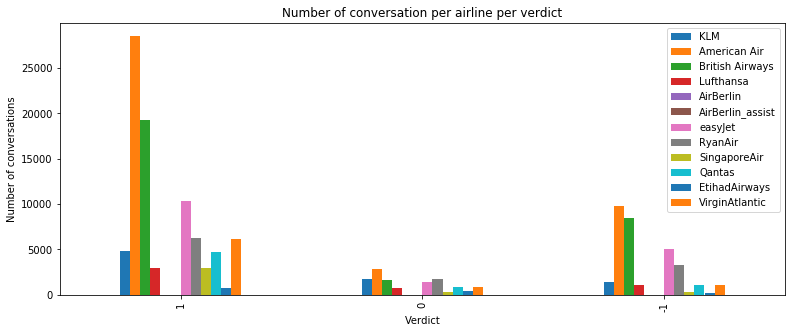

In [247]:
counts = pd.DataFrame()
counts['KLM'] = graph[graph['KLM'] == 1]['verdict'].value_counts()
counts['American Air'] = graph[graph['American Air'] == 1]['verdict'].value_counts()
counts['British Airways'] = graph[graph['British Airways'] == 1]['verdict'].value_counts()
counts['American Air'] = graph[graph['American Air'] == 1]['verdict'].value_counts()
counts['Lufthansa'] = graph[graph['Lufthansa'] == 1]['verdict'].value_counts()
counts['AirBerlin'] = graph[graph['AirBerlin'] == 1]['verdict'].value_counts()
counts['AirBerlin_assist'] = graph[graph['AirBerlin_assist'] == 1]['verdict'].value_counts()
counts['easyJet'] = graph[graph['easyJet'] == 1]['verdict'].value_counts()
counts['RyanAir'] = graph[graph['RyanAir'] == 1]['verdict'].value_counts()
counts['SingaporeAir'] = graph[graph['SingaporeAir'] == 1]['verdict'].value_counts()
counts['Qantas'] = graph[graph['Qantas'] == 1]['verdict'].value_counts()
counts['EtihadAirways'] = graph[graph['EtihadAirways'] == 1]['verdict'].value_counts()
counts['VirginAtlantic'] = graph[graph['VirginAtlantic'] == 1]['verdict'].value_counts()

ax = counts.plot(kind = 'bar', figsize = (13,5))
ax.set_title('Number of conversation per airline per verdict')
ax.set_ylabel('Number of conversations')
ax.set_xlabel('Verdict')
counts
#plt.savefig('Number of conversation per airline per verdict')

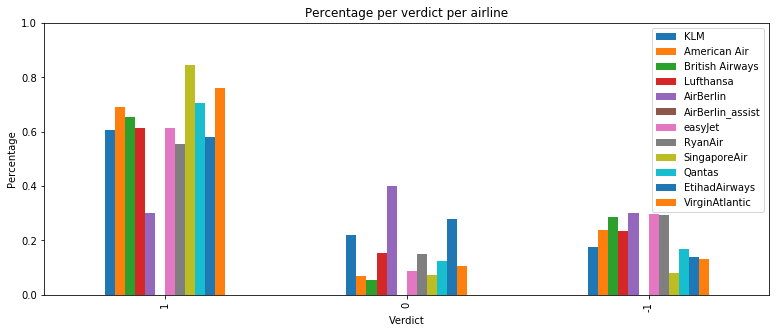

In [248]:
cents = counts.copy()
cents['KLM'] = cents['KLM']/(cents['KLM'].sum())
cents['American Air'] = cents['American Air']/(cents['American Air'].sum())
cents['British Airways'] = cents['British Airways']/(cents['British Airways'].sum())
cents['Lufthansa'] = cents['Lufthansa']/(cents['Lufthansa'].sum())
cents['AirBerlin'] = cents['AirBerlin']/(cents['AirBerlin'].sum())
cents['AirBerlin_assist'] = cents['AirBerlin_assist']/(cents['AirBerlin_assist'].sum())
cents['easyJet'] = cents['easyJet']/(cents['easyJet'].sum())
cents['RyanAir'] = cents['RyanAir']/(cents['RyanAir'].sum())
cents['SingaporeAir'] = cents['SingaporeAir']/(cents['SingaporeAir'].sum())
cents['Qantas'] = cents['Qantas']/(cents['Qantas'].sum())
cents['EtihadAirways'] = cents['EtihadAirways']/(cents['EtihadAirways'].sum())
cents['VirginAtlantic'] = cents['VirginAtlantic']/(cents['VirginAtlantic'].sum())
ax = cents.plot(kind = 'bar', figsize = (13,5))
ax.set_title('Percentage per verdict per airline')
ax.set_ylim(0,1)
ax.set_ylabel('Percentage')
ax.set_xlabel('Verdict')
cents
#plt.savefig('Percentage per verdict per airline')

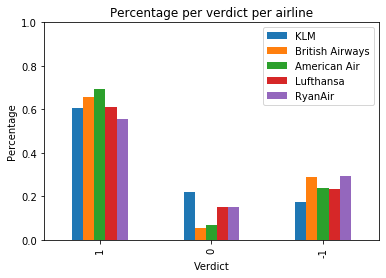

In [249]:
ax = cents[['KLM', 'British Airways', 'American Air','Lufthansa', 'RyanAir']].plot(kind = 'bar')
ax.set_title('Percentage per verdict per airline')
ax.set_ylim(0,1)
ax.set_ylabel('Percentage')
ax.set_xlabel('Verdict')
#plt.savefig('Percentage per verdict per airline partly')

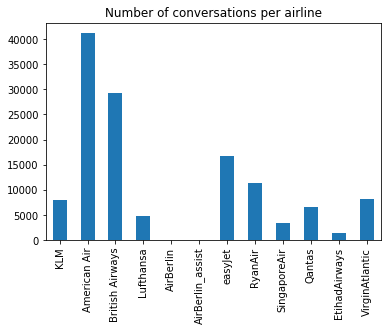

In [252]:
sums = counts.sum()
sums.plot(kind = 'bar', title = 'Number of conversations per airline')
sums
#plt.savefig('Number of conversations per airline')

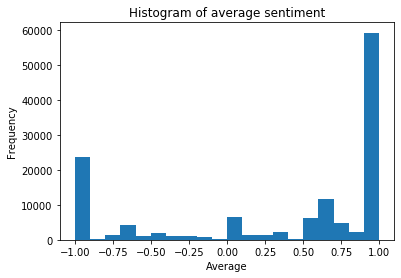

In [253]:
ax = graph['avg'].plot(kind = 'hist', bins = 20, title = 'Histogram of average sentiment')
ax.set_xlabel('Average')
#plt.savefig('Hist of average sentiment ')

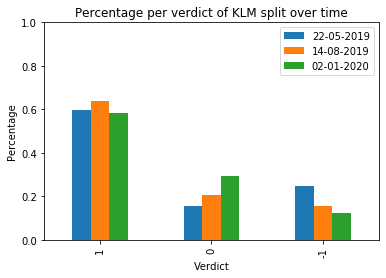

In [254]:
KLM = pd.DataFrame()
KLM['1'] = graph[graph['KLM'] == 1]['verdict'].iloc[0:2683].value_counts()
KLM['2'] = graph[graph['KLM'] == 1]['verdict'].iloc[2683:5367].value_counts()
KLM['3'] = graph[graph['KLM'] == 1]['verdict'].iloc[5367:].value_counts()
#start tweets
# 1131207020789555200 22-05-2019
# 1161723379742846976 14-08-2019
# 1212636352535285760 02-01-2020

KLM['1'] = KLM['1']/(KLM['1'].sum())
KLM['2'] = KLM['2']/(KLM['2'].sum())
KLM['3'] = KLM['3']/(KLM['3'].sum())
KLM = KLM.sort_index(axis=0,ascending=False)

ax = KLM.plot(kind = 'bar')
ax.set_title('Percentage per verdict of KLM split over time')
# conversation list is based on time of start tweet
ax.legend(['22-05-2019', '14-08-2019', '02-01-2020' ]);
ax.set_ylim(0,1)
ax.set_ylabel('Percentage')
ax.set_xlabel('Verdict')
#plt.savefig('KLM split over time')